Optical properties of responsive hybrid Au@polymer nanoparticles
========

Must change title eventually

Supporting information - Collapsed shell reference state
--------

Abstract
--------

The Au@PNIPAM collapsed shells (at high temperature) can be treated as (nearly) solid shells. Here the UV-vis and SLS data (where available) is compared to Mie theory.

# Initialize analysis

## Initialize computational/python framework

In [1]:
%run header

Loading import modules ...
  ... math, cmath (local)
  ... os, sys, types, importlib
  ... time, datetime
  ... ipyparallel as ipp
  ... numpy as np
  ... scipy as sp
      scipy.special (local, for Bessel functions)
      scipy.interpolate as interpolate
      scipy.signal as signal
  ... matplotlib
      matplotlib.pyplot as plt
      matplotlib.cm as cm
      matplotlib.pylab as pylab
  ... sympy
  ... peakutils
Defining fundamental constants ...
  ... Avogadro's number: 'AvogadroN'
  ... speed of light: 'cumfs','cnmfs'
  ... Planck's constant: 'heVfs','hbareVfs'
  ... electron rest mass: 'eMass0eVnmfs'
  ... permittivity of free space: 'eps0enmV'
Loading analysis codes ... 
  ... refractive index functions loaded:
       Au, Ag, SiO2, ITO, ZnO, H2O, 
       ethanol, CS2, benzene, toluene, 
       chloroform, methanol, butanol, 
       propanol
  ... Mie functions loaded
Ready player one.


In [2]:
%run header_parallel
%px %run -i header parallel

Initializing cluster ...
   Client variable 'kernels'
   Cluster Direct View variable 'cluster'
   Variable 'nKernels' = 7
importing os on engine(s)
[stdout:0] 
Loading import modules ...
  ... math, cmath (local)
  ... os, sys, types, importlib
  ... time, datetime
  ... ipyparallel as ipp
  ... numpy as np
  ... scipy as sp
      scipy.special (local, for Bessel functions)
      scipy.interpolate as interpolate
      scipy.signal as signal
  ... parallel kernel, skipping matplotlib
  ... sympy
  ... peakutils
Defining fundamental constants ...
  ... Avogadro's number: 'AvogadroN'
  ... speed of light: 'cumfs','cnmfs'
  ... Planck's constant: 'heVfs','hbareVfs'
  ... electron rest mass: 'eMass0eVnmfs'
  ... permittivity of free space: 'eps0enmV'
Loading analysis codes ... 
  ... refractive index functions loaded:
       Au, Ag, SiO2, ITO, ZnO, H2O, 
       ethanol, CS2, benzene, toluene, 
       chloroform, methanol, butanol, 
       propanol
  ... Mie functions loaded
Ready player on

## Import UV-vis, DLS, SLS data

In [3]:
%run header_import_data

Loading import modules ...
  ... math, cmath (local)
  ... os, sys, types, importlib
  ... time, datetime
  ... ipyparallel as ipp
  ... numpy as np
  ... scipy as sp
      scipy.special (local, for Bessel functions)
      scipy.interpolate as interpolate
      scipy.signal as signal
  ... matplotlib
      matplotlib.pyplot as plt
      matplotlib.cm as cm
      matplotlib.pylab as pylab
  ... sympy
  ... peakutils
Defining fundamental constants ...
  ... Avogadro's number: 'AvogadroN'
  ... speed of light: 'cumfs','cnmfs'
  ... Planck's constant: 'heVfs','hbareVfs'
  ... electron rest mass: 'eMass0eVnmfs'
  ... permittivity of free space: 'eps0enmV'
Loading analysis codes ... 
  ... refractive index functions loaded:
       Au, Ag, SiO2, ITO, ZnO, H2O, 
       ethanol, CS2, benzene, toluene, 
       chloroform, methanol, butanol, 
       propanol
  ... Mie functions loaded
Ready player one.
Import and organize data
Linear PNIPAM: 
Importing data in folder data_20160905 ...
  * Au-linP

## Peak Analysis, data: Power law baseline for scattering correction

### Core spectrum analysis (in water)

#### Core spectrum without power law baseline

In [4]:
threshold = 0.25
wlExpectednm = 525
dwlExpectednm = 35
nPeaks = 1
wlMin0nm, wlMax0nm = wlExpectednm-2*dwlExpectednm, wlExpectednm+2*dwlExpectednm
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier = "_lspr-core-peaks"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'Rcore-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('Bare cores only')
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('  * peaks detected: \n    wl-nm (interp),\t [wl-nm,  ext]')

lsprPeakWLnmCoreList = []
for sampleNum in range(2):
    sampleType = (['L-Core_D=','X-Core_D='][sampleNum]) + str(int(round(2*coreRnms[sampleNum]))) + '-nm'
    print('   - Core #',sampleNum,'(',
          sampleType,
          ')')
    subdataArray = spectraCores[sampleNum]
    selection = ((subdataArray[:,0] >= wlMin0nm) 
                 & (subdataArray[:,0] <= wlMax0nm)
                 )
    subdataArray = subdataArray[selection]
    minDist = int(subdataArray.size/(nPeaks+1))
    x, y = subdataArray[:,0], subdataArray[:,1]
    indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
    xPeaks = x[indexes]
    anArray = (np.array([xPeaks, indexes])).T
    selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
    indexes = (anArray[selection][:,1]).tolist()
    xPeaks = x[indexes]
    if (len(indexes) > 0): 
        result = subdataArray[indexes[0]]
        xPeaks = peakutils.interpolate(x, y, indexes)
        print('   ', round(100*xPeaks[0])/100,',\t\t',  
              (np.round(100*result)/100).tolist())
        result = [xPeaks[0], coreRnms[sampleNum]]
        lsprPeakWLnmCoreList.append(result)

#filename = folder + timestamp + identifier + exportFormat
#np.savetxt(filename, lsprPeakWLnmCoreList, delimiter='\t', header=datHeader, fmt='%.2f')
#print('     + saved to', filename) 
lsprPeakWLnmCoreArray = np.asarray(lsprPeakWLnmCoreList)
print("  * output array \"lsprPeakWLnmCoreArray\" format: \n    [ peak-wl-nm, Rcore-nm]")


LSPR peak wavelengths
Bare cores only
  * looking for one peak at 525 nm 
    - in the range [ 490 , 560 ] nm
  * peaks detected: 
    wl-nm (interp),	 [wl-nm,  ext]
   - Core # 0 ( L-Core_D=17-nm )
    519.72 ,		 [519.0, 1.1]
   - Core # 1 ( X-Core_D=13-nm )
    517.55 ,		 [518.0, 1.44]
  * output array "lsprPeakWLnmCoreArray" format: 
    [ peak-wl-nm, Rcore-nm]


#### Power law baseline of core spectrum, for later correction

In [5]:
threshold = 0.25
wlScatnm = 400
wlExpectednm = 525
dwlExpectednm = 25
x0base = wlExpectednm
nPeaks = 1
wlMin0nm, wlMax0nm = 400, 800
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier = "_lspr-core-peaks_baseline-powr"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'wl-orig-nm', 'Rcore-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('Bare cores only')
print('  * power law baseline fit')
print('    - of the form ybase = k*(x/x0)^n')
print('    - using log-log/linear fitting with x0 =',x0base)
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('    - baseline correction range [', wlMin0nm, ',', wlMax0nm, '] nm')
print('Peaks detected: \n    wl-nm (interp),\t [wl-nm, ext], \t (orig wl-nm),\t gamma Ref')

lsprPowrPeakWLnmCoreList = []
lsprPowrBaselineCoreList = []
lsprPowrBaselineCorenkList = []
lsprPowrGammaCoreRefList = []

for sampleNum in range(2):
    sampleType = (['L-Core_D=','X-Core_D='][sampleNum]) + str(int(round(2*coreRnms[sampleNum]))) + '-nm'
    print('  * Core #',sampleNum,'(', sampleType, ')', end="")
    
    subdataArray = spectraCores[sampleNum]
    selection = ((subdataArray[:,0] >= wlMin0nm) 
                 & (subdataArray[:,0] <= wlMax0nm)
                 )
    subdataArray = subdataArray[selection]
    minDist = int(subdataArray.size/(nPeaks+1))
    
    x, y = subdataArray[:,0], subdataArray[:,1]
    yOrig = y
    logx, logy = np.log(x/x0base), np.log(y)
    dlogx = min(np.diff(logx))
    loglogx = np.arange(min(logx), max(logx) + dlogx, dlogx)
    loglogy = np.interp(loglogx, logx, logy)
    
    loglogyLinBase = peakutils.baseline(loglogy, 1)
    logyLinBase = np.interp(logx, loglogx, loglogyLinBase)
    loglogfit = np.polyfit(logx, logyLinBase, 1)
    basePowrn, baseCoeffk = loglogfit[0], np.exp(loglogfit[1])
    print('\t{baseline n =', '{0:.2f}'.format(basePowrn),', k =', '{0:.1f}'.format(baseCoeffk),'}')
    
    yPowrBase = (np.exp(logyLinBase))
    y = y - yPowrBase
    
    indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
    xPeaks = x[indexes]
    anArray = (np.array([xPeaks, indexes])).T
    selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
    indexes = (anArray[selection][:,1]).tolist()
    xPeaks = x[indexes]
    if (len(indexes) > 0): 
        result = subdataArray[indexes[0]]
        xPeaks = peakutils.interpolate(x, y, indexes)

        xPeak = xPeaks[0]
        xPeakOrig = lsprPeakWLnmCoreList[sampleNum][0]
        select = (np.abs(x-xPeak) < 0.55)
        subdataArrayPeak = subdataArray[select][0]
        select = (np.abs(x-wlScatnm) < 0.55)
        subdataArrayScat = subdataArray[select][0]
        gammaCoreRef = subdataArrayPeak[1]/subdataArrayScat[1]

        print('   ', round(100*xPeaks[0])/100,',\t',  
              (np.round(100*subdataArrayPeak[:])/100).tolist(),
              '\t (',round(100*xPeakOrig)/100,')',
              '\t',(np.round(100*subdataArrayScat[:])/100).tolist(),
              '\t {0:.3f} '.format(gammaCoreRef))
        
        
        result = [xPeaks[0], lsprPeakWLnmCoreList[sampleNum][0], coreRnms[sampleNum]]
        lsprPowrPeakWLnmCoreList.append(result)

        resultGamma = [result[0], subdataArrayPeak[1], subdataArrayScat[1], 
                       gammaCoreRef, result[-1]]
        lsprPowrGammaCoreRefList.append(resultGamma)

        lsprPowrBaselineCoreList.append([x, yOrig, y[indexes][0], y, yPowrBase])
        lsprPowrBaselineCorenkList.append([x0base, basePowrn, baseCoeffk])

filename = folder + timestamp + identifier + exportFormat
#np.savetxt(filename, lsprPowrPeakWLnmCoreList, delimiter='\t', header=datHeader, fmt='%.2f')
#print('     + saved to', filename) 
print('variable: \t lsprPowrPeakWLnmCoreList')
print("  * output array format: \n    [ peak-wl-nm, orig-peak-wl-nm, Rcore-nm ]")
print('variable: \t lsprPowrBaselineCoreList')
print("  * output array format: \n    [ wl-nm-data, ext-data, peak-corr-ext",
      "ext-corrected-data, baseline-correction-data]")
print('  * wavelength range: [',lsprPowrBaselineCoreList[0][0][0],',', 
      lsprPowrBaselineCoreList[0][0][-1],'] x (',len(lsprPowrBaselineCoreList[0][0]), 'values)')
print('variable: \t lsprPowrBaselineCorenkList')
print("  * output array format: \n    [ x0, n, k ]")
print('variable: \t lsprPowrGammaCoreRefList')
print("  * output array format: \n    [ peak-wl-nm, ext-peak, ext-"+str(wlScatnm)+"-nm, gamma-core-Ref, Rcore-nm ]")


LSPR peak wavelengths
Bare cores only
  * power law baseline fit
    - of the form ybase = k*(x/x0)^n
    - using log-log/linear fitting with x0 = 525
  * looking for one peak at 525 nm 
    - in the range [ 500 , 550 ] nm
    - baseline correction range [ 400 , 800 ] nm
Peaks detected: 
    wl-nm (interp),	 [wl-nm, ext], 	 (orig wl-nm),	 gamma Ref
  * Core # 0 ( L-Core_D=17-nm )	{baseline n = -4.74 , k = 0.2 }
    521.21 ,	 [521.0, 1.1] 	 ( 519.72 ) 	 [400.0, 0.67] 	 1.634 
  * Core # 1 ( X-Core_D=13-nm )	{baseline n = -4.40 , k = 0.3 }
    519.74 ,	 [520.0, 1.44] 	 ( 517.55 ) 	 [400.0, 0.95] 	 1.509 
variable: 	 lsprPowrPeakWLnmCoreList
  * output array format: 
    [ peak-wl-nm, orig-peak-wl-nm, Rcore-nm ]
variable: 	 lsprPowrBaselineCoreList
  * output array format: 
    [ wl-nm-data, ext-data, peak-corr-ext ext-corrected-data, baseline-correction-data]
  * wavelength range: [ 400.0 , 800.0 ] x ( 401 values)
variable: 	 lsprPowrBaselineCorenkList
  * output array format: 
    [ x0,

### Core-shell

In [6]:
threshold = 0.25
wlExpectednm = 525
dwlExpectednm = 25
wlScatnm = 400
x0base = wlExpectednm
nPeaks = 1
wlMin0nm, wlMax0nm = 400, 800
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier0 = "lspr-peaks_baseline-powr"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'orig-wl-nm', 'temp-C', 'Rh-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('Core-shell nanoparticles')
print('  * power law baseline fit')
print('    - of the form ybase = k*(x/x0)^n')
print('    - using log-log/linear fitting with x0 =',x0base)
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('    - baseline correction range [', wlMin0nm, ',', wlMax0nm, '] nm')
print('Peaks detected: \n    wl-nm,\t [wl-nm, ext, T-C, Rh-nm], \t (orig wl-nm)',
     '\t [wl-nm, ext, T-C, Rh-nm]', '\t gamma')

lsprPowrPeakWLnmList = []
lsprPowrBaselineList = []
lsprPowrBaselinenkList = []
lsprPowrBaselineExpvsScaPrmList = []
lsprPowrGammaList = []
x = []

for sampleNum in range(6):
    sampleType = (['L-Thn','L-Med','L-Thk','X-Thn','X-Med','X-Thk'][sampleNum])
    print(' * Sample #',sampleNum,'(', sampleType, ')')
    lsprPeakWLnmSubList = []
    indexT = 0
    coreNum = 0
    if sampleNum >= 3: coreNum = 1
    gammaCoreRef = lsprPowrGammaCoreRefList[coreNum][-2]
    
    for T in spectraTemps[sampleNum]:
        selection = ((dataArray[:,-1] == sampleNum) 
                     & (dataArray[:,-3] == T)
                     & (dataArray[:,0] >= wlMin0nm) 
                     & (dataArray[:,0] <= wlMax0nm)
                     )
        subdataArray = dataArray[selection]
        minDist = int(subdataArray.size/(nPeaks+1))
        
        x, y = subdataArray[:,0], subdataArray[:,1]
        yOrig = y
        logx, logy = np.log(x/x0base), np.log(y)
        dlogx = min(np.diff(logx))
        loglogx = np.arange(min(logx), max(logx) + dlogx, dlogx)
        loglogy = np.interp(loglogx, logx, logy - min(logy))

        loglogyLinBase = peakutils.baseline(loglogy, 1)
        logyLinBase = np.interp(logx, loglogx, loglogyLinBase) + min(logy)
        loglogfit = np.polyfit(logx, logyLinBase, 1)
        basePowrn0, baseCoeffk0 = loglogfit[0], np.exp(loglogfit[1])
    
        yPowrBase = (np.exp(logyLinBase))
        y = y - yPowrBase
        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = (anArray[selection][:,1]).tolist()
        # if no peaks:
        if (len(indexes) == 0): 
            selection = (x >= wlMinnm) & (x <= wlMaxnm)
            xzoom, yzoom = x[selection], y[selection]
            indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
            indexes = indexeszoom + (wlMinnm - wlMin0nm)
        xPeaks = x[indexes]
                
        selection = ( (lsprPowrBaselineCoreList[coreNum][0] >= wlMin0nm)
                     & (lsprPowrBaselineCoreList[coreNum][0] <= wlMax0nm)
                     )
        yCorePowrBase = np.asarray(lsprPowrBaselineCoreList[coreNum][-1])[selection]
        yCorePeak = lsprPowrBaselineCoreList[coreNum][2]
        scaling = 1*y[indexes][0]/yCorePeak
        y = y + yCorePowrBase*scaling
        
        # fit [(base) - (core base)] to power law
        yPowrBaseTotal = yPowrBase - yCorePowrBase*scaling
        logy = np.log(yPowrBaseTotal)
        if min(yPowrBaseTotal) > 0: 
            logy = np.log(yPowrBaseTotal)
            loglogfit = np.polyfit(logx, logy, 1)
        else: loglogfit = [0, 0]
        basePowrn, baseCoeffk = loglogfit[0], np.exp(loglogfit[1])
        
        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = (anArray[selection][:,1]).tolist()
        # if no peaks:
        if (len(indexes) == 0): 
            selection = (x >= wlMinnm) & (x <= wlMaxnm)
            xzoom, yzoom = x[selection], y[selection]
            indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
            indexes = indexeszoom + (wlMinnm - wlMin0nm)
        xPeaks = x[indexes]

        # iterate 
        for i in range(20):
            oldScaling = scaling
            scaling = 1*(y[indexes[0]] - yCorePowrBase[indexes[0]]*scaling)/yCorePeak
            if ( abs(1-oldScaling/scaling) < 0.000001 ): break
            
            y = yOrig - yPowrBase + yCorePowrBase*scaling
            indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
            xPeaks = x[indexes]
            anArray = (np.array([xPeaks, indexes])).T
            selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
            indexes = (anArray[selection][:,1]).tolist()
            # if no peaks:
            if (len(indexes) == 0): 
                selection = (x >= wlMinnm) & (x <= wlMaxnm)
                xzoom, yzoom = x[selection], y[selection]
                indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
                indexes = indexeszoom + (wlMinnm - wlMin0nm)

        if (len(indexes) > 0): 
            result = subdataArray[indexes[0]]
            Rhnm = result[-2]
            xPeaks = peakutils.interpolate(x, y, indexes)
            indexT = indexT + 1
            
            xPeak = xPeaks[0]
            
            select = (np.abs(x-xPeak) < 0.51)
            subdataArrayPeak = subdataArray[select][0]
            select = (np.abs(x-wlScatnm) < 0.51)
            subdataArrayScat = subdataArray[select][0]
            gamma = subdataArrayPeak[1]/subdataArrayScat[1]
            gamma = gamma/gammaCoreRef
            
            print('   ', round(100*xPeaks[0])/100,',\t',  
                  (np.round(100*subdataArrayPeak[0:-1])/100).tolist(),
                  '\t',(np.round(100*subdataArrayScat[0:-1])/100).tolist(),
                  '\t {0:.3f} '.format(gamma))
            
            result = [xPeaks[0], gamma, result[-3], result[-2], int(result[-1])]
            lsprPowrPeakWLnmList.append(result)

            resultGamma = [result[0], subdataArrayPeak[1], subdataArrayScat[1], 
                           gamma, result[-3], result[-2], int(result[-1])]
            lsprPowrGammaList.append(resultGamma)

            lsprPowrBaselineList.append([x, yOrig, scaling, y, yPowrBase, 
                                         yPowrBase-yCorePowrBase*scaling])
            lsprPowrBaselinenkList.append([x0base, basePowrn0, baseCoeffk0])
            result = [xPeaks[0], result[-3], result[-2]]
            lsprPeakWLnmSubList.append(result)
            
            scatParam = 2*pi*Rhnm/(xPeaks[0]/1.35)
            lsprPowrBaselineExpvsScaPrmList.append([scatParam, basePowrn])
            
    if len(lsprPeakWLnmSubList) == 0: lsprPeakWLnmSubList.append( [0,0,0] )
    lsprPeakWLnmSubList = np.asarray(lsprPeakWLnmSubList)
    identifier = '_' + identifier0 + '_' + str(sampleNum) + '-' + sampleType
    #filename = folder + timestamp + identifier + exportFormat
    #np.savetxt(filename, lsprPeakWLnmSubList, delimiter='\t', header=datHeader, fmt='%.2f')
    #print('      + saved to', filename) 

lsprPowrPeakWLnmArray = np.asarray(lsprPowrPeakWLnmList)
lsprPowrScatGammaArray = np.asarray(lsprPowrGammaList)

print('variable: \t lsprPowrPeakWLnmArray')
print("  * output array format: \n    [ peak-wl-nm, gamma, temp-C, Rh-nm, sample-# ]")
print("    - sample-# = [0,...,5] \n      for [lin-Thin, lin-Med., lin-Long, X-Thin, X-Med., X-Long]")
print('variable: \t lsprPowrBaselineList')
print("  * output array format: \n",
      "   [ wl-nm-data, ext-orig-data, ext-scaling-factor, ext-corrected-data,",
      "baseline-correction-no-core-data, baseline-correction-data]")
print('  * wavelength range: [',x[0],',',x[-1],'] x (',len(x), 'values)')
print('variable: \t lsprPowrBaselinenkList')
print("  * output array format: \n    [ x0, n0, k0 ]")
print('variable: \t lsprPowrBaselineExpvsScaPrmList')
print("  * output array format: \n    [ ScatParam, n-exponent ]")
print('variable: \t lsprPowrScatGammaArray')
print("  * output array format: \n    [ peak-wl-nm, ext-peak, ext-"+str(wlScatnm)+"-nm, gamma, temp-C, Rh-nm, sample-# ]")
print("    - sample-# = [0,...,5] \n      for [lin-Thin, lin-Med., lin-Long, X-Thin, X-Med., X-Long]")


LSPR peak wavelengths
Core-shell nanoparticles
  * power law baseline fit
    - of the form ybase = k*(x/x0)^n
    - using log-log/linear fitting with x0 = 525
  * looking for one peak at 525 nm 
    - in the range [ 500 , 550 ] nm
    - baseline correction range [ 400 , 800 ] nm
Peaks detected: 
    wl-nm,	 [wl-nm, ext, T-C, Rh-nm], 	 (orig wl-nm) 	 [wl-nm, ext, T-C, Rh-nm] 	 gamma
 * Sample # 0 ( L-Thn )
    523.33 ,	 [523.0, 0.69, 15.0, 24.77] 	 [400.0, 0.41, 15.0, 24.77] 	 1.034 
    523.62 ,	 [524.0, 0.69, 20.0, 23.19] 	 [400.0, 0.41, 20.0, 23.19] 	 1.032 
    523.91 ,	 [524.0, 0.69, 25.0, 23.8] 	 [400.0, 0.41, 25.0, 23.8] 	 1.032 
    524.18 ,	 [524.0, 0.69, 27.0, 23.82] 	 [400.0, 0.41, 27.0, 23.82] 	 1.034 
    524.1 ,	 [524.0, 0.7, 29.0, 23.4] 	 [400.0, 0.41, 29.0, 23.4] 	 1.035 
    524.46 ,	 [524.0, 0.7, 31.0, 21.81] 	 [400.0, 0.41, 31.0, 21.81] 	 1.037 
    524.47 ,	 [524.0, 0.7, 33.0, 20.67] 	 [400.0, 0.41, 33.0, 20.67] 	 1.037 
    524.57 ,	 [525.0, 0.7, 35.0, 20.93] 	 [40

C:\Users\fit\Anaconda3\lib\site-packages\ipykernel\__main__.py:90: RuntimeWarning: invalid value encountered in log


	 [400.0, 0.62, 44.61, 55.41] 	 0.711 
    526.31 ,	 [526.0, 0.67, 48.46, 52.53] 	 [400.0, 0.63, 48.46, 52.53] 	 0.702 
    526.55 ,	 [527.0, 0.67, 52.31, 50.99] 	 [400.0, 0.64, 52.31, 50.99] 	 0.700 
    526.72 ,	 [527.0, 0.67, 56.16, 50.99] 	 [400.0, 0.64, 56.16, 50.99] 	 0.698 
 * Sample # 4 ( X-Med )
    525.43 ,	 [525.0, 0.26, 7.65, 144.22] 	 [400.0, 0.4, 7.65, 144.22] 	 0.432 
    525.46 ,	 [525.0, 0.27, 9.96, 143.8] 	 [400.0, 0.41, 9.96, 143.8] 	 0.431 
    525.51 ,	 [526.0, 0.26, 13.81, 142.45] 	 [400.0, 0.41, 13.81, 142.45] 	 0.430 
    525.63 ,	 [526.0, 0.27, 17.66, 137.13] 	 [400.0, 0.41, 17.66, 137.13] 	 0.428 
    525.77 ,	 [526.0, 0.27, 21.51, 133.86] 	 [400.0, 0.42, 21.51, 133.86] 	 0.426 
    526.01 ,	 [526.0, 0.27, 25.36, 129.83] 	 [400.0, 0.42, 25.36, 129.83] 	 0.420 
    526.12 ,	 [526.0, 0.27, 27.67, 125.59] 	 [400.0, 0.44, 27.67, 125.59] 	 0.417 
    526.2 ,	 [526.0, 0.28, 28.44, 123.41] 	 [400.0, 0.44, 28.44, 123.41] 	 0.416 
    526.22 ,	 [526.0, 0.28, 29.21, 121

# Mie theory: Au-polymer core-shells in water

## Notes

* Refractive index of gold using:
  - experimental tabulated data from Johnson & Christ (1972) with electron confinement effects (Bohren & Huffman 1998, Ch. 12).
* Refractive index of shell at sampling wavelength of $\lambda_{\mathrm{SLS}}=632.8$ nm. For all other wavelengths, the refractive index dispersion is based on water: $$n(\lambda) = n_{\mathrm{H2O}}(\lambda) + [n_{\mathrm{shell}} - n_{\mathrm{H2O}}(\lambda_{\mathrm{SLS}})]$$
  - Two refractive indexes for swollen and collapsed: $n = 1.35$ & $n = 1.42$.
* Use hydrodynamic radius from DLS, sample along each temperature curve. 
  - monodisperse
* Calculate core-shell and core + shell configurations.

## Computation: Extinction cross section

### First computation setup

#### Input parameter ranges

In [7]:
print("Input parameters for computation")
print("================================")

##-- parameter limits --##
# Max Mie expansion order
lmax = 5
# Wavelength range (vacuum)
wlMinnm, wlMaxnm, dwlnm = 300, 900, 1
wlListnm = np.arange(wlMinnm, wlMaxnm + 0.5*dwlnm, dwlnm)


# Core size
rCorenm = np.mean(coreRnms)


# Shell refractive index 
# (at 632.8 nm, dispersion modeled on water)
nmed = ri.nH2O(632.8).real
dnShellMin, dnShellMax = np.round(1.20 - nmed,2), np.round(1.58 - nmed,2)
nShellMin, nShellMax, dnShell = nmed + dnShellMin, nmed + dnShellMax, .01
nShellList = np.arange(nShellMin, nShellMax + dnShell, dnShell)
print('* Shell refractive indexes based on water and extended.')


# Shell size, based on Rh from DLS
rShellListnm = []
rsPerSample = 7
# Set up sweep ranges
print('* Shell radii based on collapsed/swollen state radius from DLS.')
for sampleNum in range(6): 
    coreRnm = coreRnms[0]
    if sampleNum > 2: coreRnm = coreRnms[1]
    rListnm = []
    RhMinnm = (rCorenm/coreRnm)*np.mean(np.sort(spectraRhnms[sampleNum])[:2])
    RhMaxnm = (rCorenm/coreRnm)*np.mean(np.sort(spectraRhnms[sampleNum])[-2:])
    rMinnm = 0.75*RhMinnm
    rMaxnm = 1.25*RhMaxnm
    RhMinnm = np.round(RhMinnm)
    RhMaxnm = np.round(RhMaxnm)
    
    rounding = .5
    if rMaxnm > 20:  rounding = 1
    if rMaxnm > 50:  rounding = 2
    if rMaxnm > 100: rounding = 5
    if rMaxnm > 200: rounding = 10
    def generalRound(x):
        precision = -1*int(round(log(rounding,10).real))
        return np.around(rounding*np.around(x/rounding), precision)
    rMaxnm = generalRound( rMaxnm + rounding )
    rMinnm = generalRound( rMinnm - rounding )
    drnm = generalRound( (rMaxnm - rMinnm)/(rsPerSample - 1) )
    rListnm = np.arange(rMinnm, rMaxnm, drnm)
    rListnm = np.concatenate((
        rListnm, 
        np.linspace(RhMinnm - 1, RhMinnm + 1, 3),
        np.linspace(RhMaxnm - 1, RhMaxnm + 1, 3)
        ))
    rListnm = ( np.unique(rListnm) ).tolist()
    for rnm in rListnm: 
        rShellListnm.append(rnm)
rShellListnm = np.unique(np.array(rShellListnm))
rShellMinnm, rShellMaxnm = min(rShellListnm), max(rShellListnm)


# report
np.set_printoptions(precision=3)
print('''\
* Mie expansion poles     = \"lmax\"         <= {0}
* vacuum wavelengths (nm) = \"wlListnm\"     =  [{2[0]:.1f} - {2[1]:.1f}] x {3:.1f}  ({4})
* shell RI (n_shell)      = \"nShellList\"   =  [{6[0]:.3f} - {6[1]:.3f}] x {7:.3f}  ({8})
* shell radius (nm)       = \"rShellListnm\" =  [{9[0]:.1f} - {9[1]:.1f}]  ({10})
                             shell-to-core =  [{13[0]:.2f} - {13[1]:.2f}]  
* core radius (nm)        = \"rCorenm\"  =  {12}
'''.format(lmax, 
           100*0, 
           wlListnm[[0,-1]], dwlnm, len(wlListnm), 
           0, 
           nShellList[[0,-1]], dnShell, len(nShellList), 
           rShellListnm[[0,-1]], len(rShellListnm), 
           0,
           rCorenm,
           rShellListnm[[0,-1]]/rCorenm
          )
)

Input parameters for computation
* Shell refractive indexes based on water and extended.
* Shell radii based on collapsed/swollen state radius from DLS.
* Mie expansion poles     = "lmax"         <= 5
* vacuum wavelengths (nm) = "wlListnm"     =  [300.0 - 900.0] x 1.0  (601)
* shell RI (n_shell)      = "nShellList"   =  [1.202 - 1.592] x 0.010  (40)
* shell radius (nm)       = "rShellListnm" =  [11.0 - 260.0]  (58)
                             shell-to-core =  [1.46 - 34.44]  
* core radius (nm)        = "rCorenm"  =  7.55



#### Input parameter array and computation algorithm definition

In [8]:
print('''\
Set up computation algorithm
============================ \
''')

# contruct parameter list
paramList = []
for rShellnm in rShellListnm:
    for nShell in nShellList:
        for wlnm in wlListnm:
            paramList.append([
                    lmax, wlnm, 
                    nShell, 
                    rShellnm, 
                    rCorenm
                ])
paramArray = np.asarray(paramList)
# remove duplicate entries
def uniqueRows(a):
    b = np.ascontiguousarray(a).view(np.dtype((np.void, a.dtype.itemsize * a.shape[1])))
    _, idx = np.unique(b, return_index=True)
    unique_a = np.unique(b).view(a.dtype).reshape(-1, a.shape[1])
    return unique_a
paramArray = uniqueRows(paramArray)
Nsims = len(paramArray)

print('''\
* Input variable
    - \"paramArray\" = Mie theory calculated SLS curve
    - type:\t{0}
    - size:\t{1}
* \"calcAtom\" input: 
    [   lmax, wlnm, 
        nShell, 
        rShellnm, 
        rCorenm  ] 
'''.format(type(paramArray), np.shape(np.asarray(paramArray)) )
     )


# Independent computing unit
def calcAtom(params):
    [   lmax, wlnm, 
        nShell, 
        rShellnm, 
        rCorenm
    ] = params
    lmax = int(lmax)
    
    # Au cores, J&C
    nAu = ri.nAuSc(wlnm, (4/3)*rCorenm)
    # Medium RI = water
    nmed = ( ri.nH2O(wlnm) ).real
    nmedRef = ( ri.nH2O(632.8) ).real
    # Shell RI, dispersion modeled on water
    nshell = np.real( nmed + (nShell - nmedRef) ).tolist()
    # wavenumber
    knm = 2*pi/wlnm
    
    ## extinction cross section functions 
    # monodisperse, core-shell
    def CExtMonoF(nAu, rcorenm, rshellnm):
        ns = [nAu, nshell, nmed] 
        Rnms = [rcorenm, rshellnm]
        Cext = mie.Cext(lmax, ns, Rnms, knm)
        return Cext
    # monodisperse, core only
    def CExtCoreMonoF(nAu, rcorenm, rshellnm):
        ns = [nAu, nshell] # medium with RI dispersion
        Rnms = [rcorenm]
        Cext = mie.Cext(lmax, ns, Rnms, knm)
        return Cext
    # monodisperse, shell only
    def CExtShellMonoF(nAu, rcorenm, rshellnm):
        ns = [nshell, nmed] 
        Rnms = [rshellnm]
        Cext = mie.Cext(lmax, ns, Rnms, knm)
        return Cext
    
    # Computations
    CextMono = CExtMonoF(nAu, rCorenm, rShellnm)
    CextCoreMono = CExtCoreMonoF(nAu, rCorenm, rShellnm)
    CextShellMono = CExtShellMonoF(nAu, rCorenm, rShellnm)
    
    return [
        wlnm, 
        nShell, 
        rShellnm,  
        rCorenm, 
        CextMono, 
        CextCoreMono, CextShellMono 
    ]

# distribute atom definition to parallel kernels
cluster.push(dict(
        calcAtom = calcAtom
    ))

print('''\
* \"calcAtom\" output: 
    [   wlnm, 
        nShell, 
        rShellnm,  
        rCorenm, 
        CextMono (core-shell),  
        CextCoreMono, CextShellMono, 
    ] \
''')


Set up computation algorithm
* Input variable
    - "paramArray" = Mie theory calculated SLS curve
    - type:	<class 'numpy.ndarray'>
    - size:	(1394320, 5)
* "calcAtom" input: 
    [   lmax, wlnm, 
        nShell, 
        rShellnm, 
        rCorenm  ] 

* "calcAtom" output: 
    [   wlnm, 
        nShell, 
        rShellnm,  
        rCorenm, 
        CextMono (core-shell),  
        CextCoreMono, CextShellMono, 
    ] 


#### Test and time algorithm

In [10]:
print('''\
Test algorithm  
============== \
''')

testN = 15
testParamArray = paramArray[ np.random.randint(len(paramArray), size=testN) ]
testParam = testParamArray[0]
print('''\
* timing {2} computations 
  ({1:%Y-%m-%d %H:%M:%S}) ... \
'''.format(testParam, datetime.datetime.now(), testN ), end='')

startSec = time.time()
testReturnArray = np.asarray( list( map(calcAtom, testParamArray) ) )
endSec = time.time()
dtSec = endSec - startSec
atomTimeSec = dtSec/testN
testReturn = testReturnArray[0]
print(''' done ({1:%Y-%m-%d %H:%M:%S})
    - time elapsed          =  {2:.5e} sec
    - time per computation  =  {3:.5e} sec
* using params
    [   {4[0]:.0f}, {4[1]:.1f}, 
        {4[2]:.3f}, 
        {4[3]:.1f},  
        {4[4]:.1f}  ] 
* returns
    [   {0[0]:.1f},  
        {0[1]:.3f}, 
        {0[2]:.1f}, 
        {0[3]:.1f}, 
        {0[4]:.5e}, 
        {0[5]:.5e}, {0[6]:.5e}  ] \
'''.format(testReturn, datetime.datetime.now(), dtSec, atomTimeSec, testParam))

Ncluster = nKernels
estRunTimeSec = atomTimeSec*Nsims/Ncluster
m, s = divmod(estRunTimeSec, 60)
h, m = divmod(m, 60)
print('''\
* Estimated run time
    {0} computations
      @ {1:.5e} sec/comp
      distributed over {2} engines 
    = {3:.3f} sec  =  {4:0>2.0f}:{5:0>2.0f}:{6:0>2.0f} (h:m:s) \
'''.format(Nsims, atomTimeSec, Ncluster, estRunTimeSec, h, m, s))
estRunTimeSec = atomTimeSec*Nsims/4
m, s = divmod(estRunTimeSec, 60)
h, m = divmod(m, 60)
print('''\
* Virtual cores may not speed up computation!
    Assuming 3.5 \'real\' cores
    = {3:.3f} sec  =  {4:0>2.0f}:{5:0>2.0f}:{6:0>2.0f} (h:m:s)
'''.format(Nsims, atomTimeSec, Ncluster, estRunTimeSec, h, m, s))


Test algorithm  
* timing 15 computations 
  (2017-03-21 13:06:23) ...  done (2017-03-21 13:06:23)
    - time elapsed          =  3.12557e-02 sec
    - time per computation  =  2.08371e-03 sec
* using params
    [   5, 367.0, 
        1.312, 
        41.0,  
        7.5  ] 
* returns
    [   367.0,  
        1.312, 
        41.0, 
        7.5, 
        1.00568e+02, 
        1.01567e+02, 7.75958e-01  ] 
* Estimated run time
    1394320 computations
      @ 2.08371e-03 sec/comp
      distributed over 7 engines 
    = 415.052 sec  =  00:06:55 (h:m:s) 
* Virtual cores may not speed up computation!
    Assuming 3.5 'real' cores
    = 726.341 sec  =  00:12:06 (h:m:s)



### Run & save

#### Run full computation

In [11]:
print("Compute over all parameters")
print("===========================")

# Loop over parameters
print('* Computing ({:%Y-%m-%d %H:%M:%S}) ... '.format(datetime.datetime.now()), end='')
startSec = time.time()

calcMapList = list(cluster.map_sync(calcAtom, paramArray))

endSec = time.time()
print('done ({:%Y-%m-%d %H:%M:%S})'.format(datetime.datetime.now()))
dtSec = endSec - startSec
m, s = divmod(dtSec, 60)
h, m = divmod(m, 60)

calcMapArray = np.asarray(calcMapList)
Ncalcs = calcMapArray.shape[0]

mieCextCoreShellArray = calcMapArray

print('''\
    - Run time = {0:.3f} sec  =  {4:0>2.0f}:{5:0>2.0f}:{6:0>2.2f} (h:m:s)
    - Time per simulation instance = {1:.3e} sec
* Return variable
    - \"mieCextCoreShellArray\" = Mie theory calculated extinction spectrum
    - type:\t{2}
    - size:\t{3}
'''.format(dtSec, dtSec*Ncluster/Ncalcs, 
           type(mieCextCoreShellArray), 
           np.shape(np.asarray(mieCextCoreShellArray)),
           h, m, s
          )
     )

Compute over all parameters
* Computing (2017-03-21 13:06:49) ... done (2017-03-21 13:12:43)
    - Run time = 353.589 sec  =  00:05:53.59 (h:m:s)
    - Time per simulation instance = 1.775e-03 sec
* Return variable
    - "mieCextCoreShellArray" = Mie theory calculated extinction spectrum
    - type:	<class 'numpy.ndarray'>
    - size:	(1394320, 7)



#### Save results to file

In [15]:
print('''\
Save result to file  
=================== 
* Saving variable:\t\"mieCextCoreShellArray\" \
''')
timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.npy'
filename = ("npy/" + timestamp 
            + "_mie-Cext_core-shell_part0" 
            + exportFormat
            )
print('* To file:\t\t'+filename)
print('* Initiating ({:%Y-%m-%d %H:%M:%S}) ... '.format(datetime.datetime.now()), end='')
np.save(filename, mieCextCoreShellArray)
print('done ({:%Y-%m-%d %H:%M:%S})'.format(datetime.datetime.now()))

Save result to file  
* Saving variable:	"mieCextCoreShellArray" 
* To file:		npy/20170321_mie-Cext_core-shell_part0.npy
* Initiating (2017-03-21 13:21:08) ... done (2017-03-21 13:21:10)


### Load computations

In [16]:
print('''\
Load computation from file  
========================== \
''')
filename = 'npy/20170321_mie-Cext_core-shell_part0.npy'

print('* Importing file:\t'+filename)
print('* As variable:\t\t\"mieCextCoreShellArray\"')
print('* Initiating ({:%Y-%m-%d %H:%M:%S}) ... '.format(datetime.datetime.now()), end='')
mieCextCoreShellArray = np.load(filename)
print('done ({:%Y-%m-%d %H:%M:%S})'.format(datetime.datetime.now()))

Load computation from file  
* Importing file:	npy/20170321_mie-Cext_core-shell_part0.npy
* As variable:		"mieCextCoreShellArray"
* Initiating (2017-03-21 13:21:18) ... done (2017-03-21 13:21:18)


## Differences between cross sections

### Difference between core-shell and core + shell

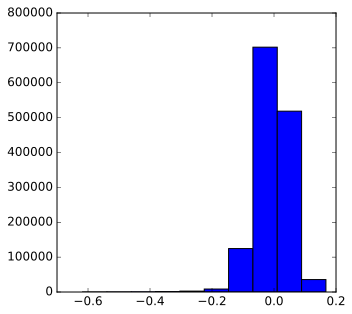

[-0.618  0.167]


In [12]:
pylab.cla()

dCextRel = 1 - (mieCextCoreShellArray[:,-2] + mieCextCoreShellArray[:,-1])/mieCextCoreShellArray[:,-3]
pylab.hist(dCextRel )
pylab.show()
print(np.sort(dCextRel)[[0,-1]])

Displaying ... 


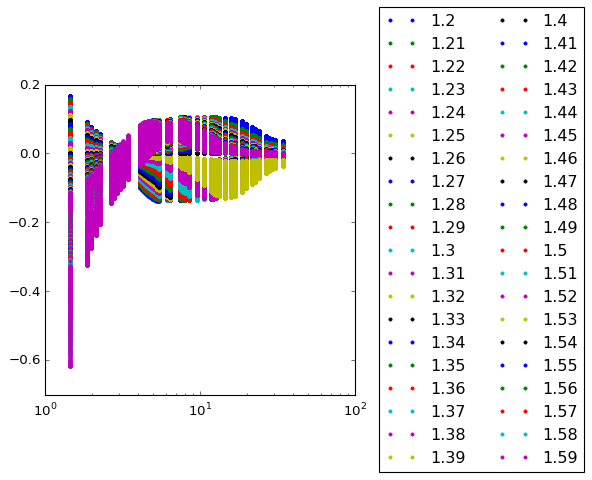

In [13]:
for nShell in nShellList:
    coreNum = 0
    if sampleNum > 2: coreNum = 1
    select = ((mieCextCoreShellArray[:,1] == nShell))
    subset = mieCextCoreShellArray[select]
    sort = np.argsort(subset[:,2])
    subset = subset[sort]
    rCorenm = subset[0,3]
    label = str(np.round(nShell,2))
    dCextRel = 1 - (subset[:,-2] + subset[:,-1])/subset[:,-3]
    pylab.semilogx(subset[:,2]/subset[:,3], dCextRel, '.', label=label)

print('Displaying ... ')
%config InlineBackend.figure_format = 'png'
pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=2)
pylab.show()
%config InlineBackend.figure_format = 'svg'

Displaying ... 


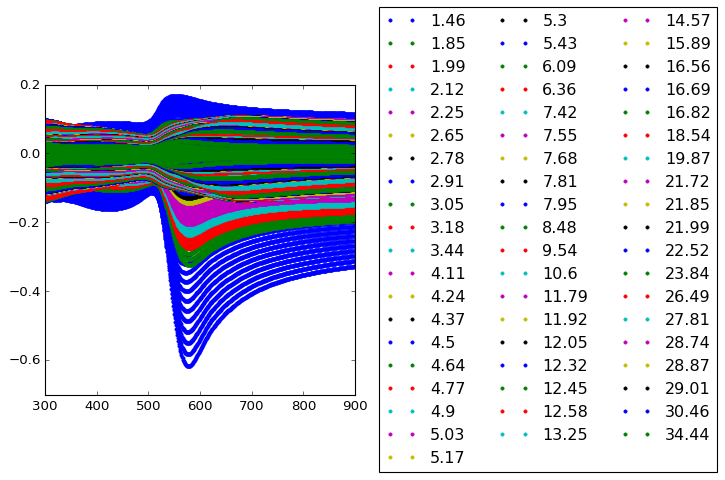

In [14]:
for rShellnm in rShellListnm:
    coreNum = 0
    if sampleNum > 2: coreNum = 1
    select = ((mieCextCoreShellArray[:,2] == rShellnm))
    subset = mieCextCoreShellArray[select]
    rCorenm = subset[0,3]
    label = str(np.round(rShellnm/rCorenm,2))
    dCextRel = 1 - (subset[:,-2] + subset[:,-1])/subset[:,-3]
    pylab.plot(subset[:,0], dCextRel, '.', label=label)

print('Displaying ... ')
%config InlineBackend.figure_format = 'png'
pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=3)
pylab.show()
%config InlineBackend.figure_format = 'svg'

# Peak Analysis: Power law baseline for scattering correction

## Peak analysis

### Core spectrum analysis (in water)

#### Core spectrum without power law baseline

LSPR peak wavelengths
Bare cores only
  * looking for one peak at 535 nm 
    - in the range [ 510 , 560 ] nm
  * peaks detected: 
    wl-nm (interp),	 [wl-nm,  ext]
   -  7.55-nm
    523.17 ,		 [ 523.    150.96]


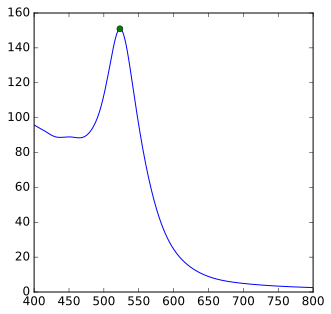

  * output array "lsprMiePeakWLnmCoreArray"format: 
    [ peak-wl-nm, Rcore-nm]


In [29]:
exportFlag = False
threshold = 0.25
wlExpectednm = 535
dwlExpectednm = 25
nPeaks = 1
wlMin0nm, wlMax0nm = 400, 800
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier = "_lspr-core-peaks"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'Rcore-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('Bare cores only')
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('  * peaks detected: \n    wl-nm (interp),\t [wl-nm,  ext]')

lsprMiePeakWLnmCoreList = []

nMedium = ri.nH2O(632.8).real
nShell = nShellList[np.argsort(np.abs(nShellList-nMedium))][0]
rShellnm = rShellListnm[0]
sampleType = str(rCorenm) + '-nm'
print('   - ',
      sampleType
      )

subdataArray = mieCextCoreShellArray
selection = (
    (subdataArray[:,0] >= wlMin0nm) 
    & (subdataArray[:,0] <= wlMax0nm) 
    & (subdataArray[:,1] == nShell)
    & (subdataArray[:,2] == rShellnm)
)
subdataArray = subdataArray[selection]
sort = np.argsort(subdataArray[:,0])
subdataArray = subdataArray[sort]
minDist = int(subdataArray[:,0].size/(nPeaks+1))

x, y = subdataArray[:,0], subdataArray[:,-2]
sort = np.argsort(x)
x, y = x[sort], y[sort]
pylab.plot(x,y,'-')

indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
xPeaks = x[indexes]
pylab.plot(x[indexes],y[indexes],'o')

anArray = (np.array([xPeaks, indexes])).T
select = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
indexes = (anArray[select][:,1]).tolist()
xPeaks = x[indexes]

if (len(indexes) > 0): 
    result = [x[indexes[0]], y[indexes[0]]]
    xPeaks = peakutils.interpolate(x, y, ind=indexes)
    print('   ', ( round(100*xPeaks[0])/100 ),',\t\t',  
          np.round(100*np.array(result))/100 )
    result = [xPeaks[0], rCorenm]
    lsprMiePeakWLnmCoreList.append(result)

pylab.show()
filename = folder + timestamp + identifier + exportFormat
if (exportFlag):
    np.savetxt(filename, lsprPeakWLnmCoreList, delimiter='\t', header=datHeader, fmt='%.2f')
    print('     + saved to', filename) 
lsprMiePeakWLnmCoreArray = np.asarray(lsprMiePeakWLnmCoreList)
print("  * output array \"lsprMiePeakWLnmCoreArray\"format: \n    [ peak-wl-nm, Rcore-nm]")


#### Power law baseline of core spectrum, for later correction

LSPR peak wavelengths
Bare cores only
  * power law baseline fit
    - of the form ybase = k*(x/x0)^n
    - using log-log/linear fitting with x0 = 525
  * looking for one peak at 525 nm 
    - in the range [ 500 , 550 ] nm
    - baseline correction range [ 400 , 800 ] nm
Peaks detected: 
    wl-nm (interp),	 [wl-nm, ext], 	 (orig wl-nm),	 gamma-Ref
  *  7.55-nm	{baseline n = -5.46 , k = 23.7 }
    524.25 ,		 [ 524.    126.95] 	 ( 523.17 ) ,	  1.57471208051


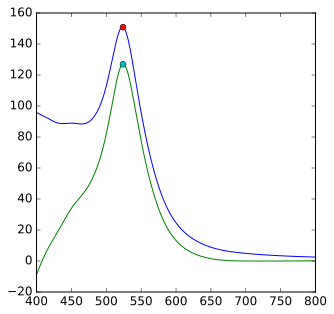

variable: 	 lsprMiePowrPeakWLnmCoreArray
  * output array format: 
    [ peak-wl-nm, orig-peak-wl-nm, Rcore-nm, gamma-Ref ]
variable: 	 lsprMiePowrBaselineCoreList
  * output array format: 
    [ wl-nm-data, ext-data, peak-corr-ext ext-corrected-data, baseline-correction-data]
  * wavelength range: [ 400.0 , 800.0 ] x ( 401 values)
variable: 	 lsprMiePowrBaselineCorenkList
  * output array format: 
    [ x0, n, k ]


In [30]:
exportFlag = False
threshold = 0.25
wlExpectednm = 525
dwlExpectednm = 25
wlScatnm = 400
x0base = wlExpectednm
nPeaks = 1
wlMin0nm, wlMax0nm = 400, 800
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier = "_mie_lspr-core-peaks_baseline-powr"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'wl-orig-nm', 'Rcore-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('Bare cores only')
print('  * power law baseline fit')
print('    - of the form ybase = k*(x/x0)^n')
print('    - using log-log/linear fitting with x0 =',x0base)
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('    - baseline correction range [', wlMin0nm, ',', wlMax0nm, '] nm')
print('Peaks detected: \n    wl-nm (interp),\t [wl-nm, ext], \t (orig wl-nm),\t gamma-Ref')

lsprMiePowrPeakWLnmCoreList = []
lsprMiePowrBaselineCoreList = []
lsprMiePowrBaselineCorenkList = []

nMedium = ri.nH2O(632.8).real
nShell = nShellList[np.argsort(np.abs(nShellList-nMedium))][0]
rShellnm = rShellListnm[0]
sampleType = str(rCorenm) + '-nm'
print('  * ', sampleType, end="")

subdataArray = mieCextCoreShellArray
selection = (
    (subdataArray[:,0] >= wlMin0nm) 
    & (subdataArray[:,0] <= wlMax0nm) 
    & (subdataArray[:,1] == nShell)
    & (subdataArray[:,2] == rShellnm)
)
subdataArray = subdataArray[selection]
sort = np.argsort(subdataArray[:,0])
subdataArray = subdataArray[sort]
minDist = int(subdataArray[:,0].size/(nPeaks+1))

x, y = subdataArray[:,0], subdataArray[:,-2]
sort = np.argsort(x)
x, y = x[sort], y[sort]
yOrig = y
logx, logy = np.log(x/x0base), np.log(y)
dlogx = min(np.abs(np.diff(logx)))
loglogx = np.arange(min(logx), max(logx) + 0.5*dlogx, dlogx)
loglogy = np.interp(loglogx, logx, logy)

loglogyLinBase = peakutils.baseline(loglogy, 1)
logyLinBase = np.interp(logx, loglogx, loglogyLinBase)
loglogfit = np.polyfit(logx, logyLinBase, 1)
basePowrn, baseCoeffk = loglogfit[0], np.exp(loglogfit[1])
print('\t{baseline n =', '{0:.2f}'.format(basePowrn),', k =', '{0:.1f}'.format(baseCoeffk),'}')

yPowrBase = (np.exp(logyLinBase))
y = y - yPowrBase
pylab.plot(x,yOrig,'-')
pylab.plot(x,y,'-')

indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
xPeaks = x[indexes]
anArray = (np.array([xPeaks, indexes])).T
selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
indexes = (anArray[selection][:,1]).tolist()
xPeaks = x[indexes]
if (len(indexes) > 0): 
    result = [ x[indexes[0]], y[indexes[0]] ]
    pylab.plot(x[indexes],yOrig[indexes],'o')
    pylab.plot(x[indexes],y[indexes],'o')
    xPeaks = peakutils.interpolate(x, y, ind=indexes)

    xPeak = xPeaks[0]
    select = (np.abs(x-xPeak) < 0.55)
    subdataPeak = yOrig[select][0]
    select = (np.abs(x-wlScatnm) < 0.55)
    subdataScat = yOrig[select][0]
    gammaCoreRef = subdataPeak/subdataScat

    print('   ', round(100*xPeak)/100,',\t\t',  
          np.round(100*np.array(result))/100,
          '\t (', round(100*lsprMiePeakWLnmCoreList[0][0])/100,')',
          ',\t ', gammaCoreRef
          )

    result = [xPeak, lsprPeakWLnmCoreList[0][0], rCorenm, gammaCoreRef]

    lsprMiePowrPeakWLnmCoreList.append(result)
    lsprMiePowrBaselineCoreList.append([x, yOrig, y[indexes][0], y, yPowrBase])
    lsprMiePowrBaselineCorenkList.append([x0base, basePowrn, baseCoeffk])

pylab.show()
if (exportFlag):
    filename = folder + timestamp + identifier + exportFormat
    np.savetxt(filename, lsprMiePowrPeakWLnmCoreList, delimiter='\t', header=datHeader, fmt='%.2f')
    print('     + saved to', filename) 

lsprMiePowrPeakWLnmCoreArray = np.array(lsprMiePowrPeakWLnmCoreList)
print('variable: \t lsprMiePowrPeakWLnmCoreArray')
print("  * output array format: \n    [ peak-wl-nm, orig-peak-wl-nm, Rcore-nm, gamma-Ref ]")

print('variable: \t lsprMiePowrBaselineCoreList')
print("  * output array format: \n    [ wl-nm-data, ext-data, peak-corr-ext",
      "ext-corrected-data, baseline-correction-data]")

print('  * wavelength range: [',lsprMiePowrBaselineCoreList[0][0][0],',', 
      lsprMiePowrBaselineCoreList[0][0][-1],'] x (',len(lsprMiePowrBaselineCoreList[0][0]), 'values)')
print('variable: \t lsprMiePowrBaselineCorenkList')
print("  * output array format: \n    [ x0, n, k ]")


### Core-shell spectrum analysis

#### Hard sphere

LSPR peak wavelengths
Core-shell nanoparticles
  * power law baseline fit
    - of the form ybase = k*(x/x0)^n
    - using log-log/linear fitting with x0 = 535
  * looking for one peak at 535 nm 
    - in the range [ 515 , 555 ] nm
    - baseline correction range [ 400 , 800 ] nm
Peaks detected: 
    wl-nm,	 [wl-nm, ext, rShell-nm, nShell] 	 (n0, k0) 	 scal. 	 (n, k) 	 gamma
    518.8 ,	 [519.0, 115.94, 11.0, 1.2] 	 (-5.63, 17.236)	 0.762 	 (0.00, 1.00) 	 0.908
    517.83 ,	 [518.0, 108.68, 14.0, 1.2] 	 (-5.67, 16.328)	 0.713 	 (0.00, 1.00) 	 0.891
    517.67 ,	 [518.0, 107.4, 15.0, 1.2] 	 (-5.68, 16.158)	 0.704 	 (0.00, 1.00) 	 0.889
    517.54 ,	 [518.0, 106.4, 16.0, 1.2] 	 (-5.68, 16.021)	 0.698 	 (0.00, 1.00) 	 0.886
    517.44 ,	 [518.0, 105.59, 17.0, 1.2] 	 (-5.69, 15.908)	 0.693 	 (0.00, 1.00) 	 0.885
    517.25 ,	 [518.0, 103.86, 20.0, 1.2] 	 (-5.69, 15.674)	 0.681 	 (0.00, 1.00) 	 0.883
    517.2 ,	 [518.0, 103.42, 21.0, 1.2] 	 (-5.69, 15.625)	 0.678 	 (0.00, 1.00) 	 0.883
   

C:\Users\fit\Anaconda3\lib\site-packages\ipykernel\__main__.py:93: RuntimeWarning: invalid value encountered in log


    517.11 ,	 [517.0, 102.66, 23.0, 1.2] 	 (-5.69, 15.569)	 0.672 	 (0.00, 1.00) 	 0.881
    517.09 ,	 [517.0, 102.27, 24.0, 1.2] 	 (-5.69, 15.602)	 0.669 	 (0.00, 1.00) 	 0.880
    517.04 ,	 [517.0, 101.65, 26.0, 1.2] 	 (-5.67, 15.657)	 0.665 	 (-8.97, 1.24) 	 0.877
    516.94 ,	 [517.0, 100.17, 31.0, 1.2] 	 (-5.58, 16.318)	 0.656 	 (-6.35, 2.25) 	 0.858
    516.92 ,	 [517.0, 99.87, 32.0, 1.2] 	 (-5.55, 16.576)	 0.654 	 (-6.03, 2.57) 	 0.852
    516.9 ,	 [517.0, 99.57, 33.0, 1.2] 	 (-5.51, 16.889)	 0.652 	 (-5.75, 2.93) 	 0.844
    516.89 ,	 [517.0, 99.26, 34.0, 1.2] 	 (-5.47, 17.263)	 0.650 	 (-5.50, 3.35) 	 0.836
    516.87 ,	 [517.0, 98.95, 35.0, 1.2] 	 (-5.42, 17.704)	 0.648 	 (-5.29, 3.84) 	 0.827
    516.85 ,	 [517.0, 98.63, 36.0, 1.2] 	 (-5.37, 18.220)	 0.646 	 (-5.10, 4.39) 	 0.817
    516.84 ,	 [517.0, 98.24, 37.0, 1.2] 	 (-5.32, 18.858)	 0.643 	 (-4.95, 5.07) 	 0.805
    516.82 ,	 [517.0, 97.91, 38.0, 1.2] 	 (-5.26, 19.544)	 0.641 	 (-4.81, 5.79) 	 0.793
    516.81 ,	 [517.0

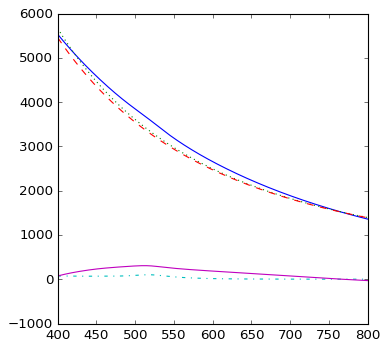

	* Warning *: large scattering cross section:  [ 515.     353.918  150.       1.202]


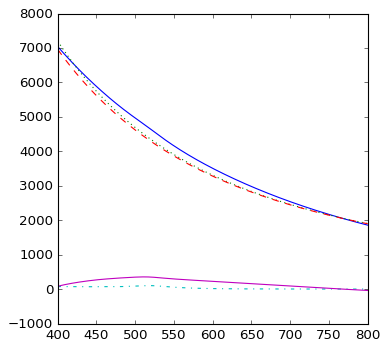

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 429.515]) 164.0 1.2021058963738431]


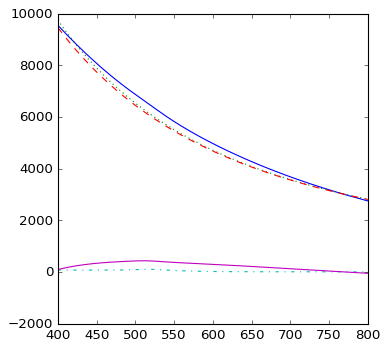

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 435.899]) 165.0 1.2021058963738431]


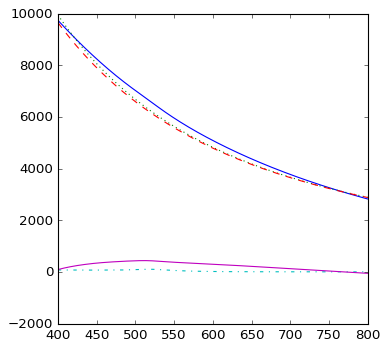

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 442.485]) 166.0 1.2021058963738431]


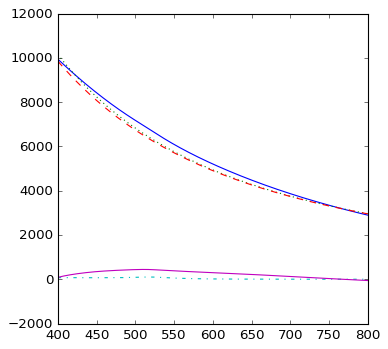

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 471.197]) 170.0 1.2021058963738431]


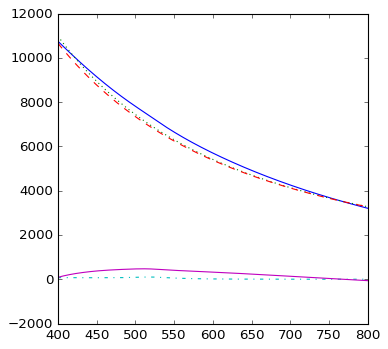

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 582.327]) 180.0 1.2021058963738431]


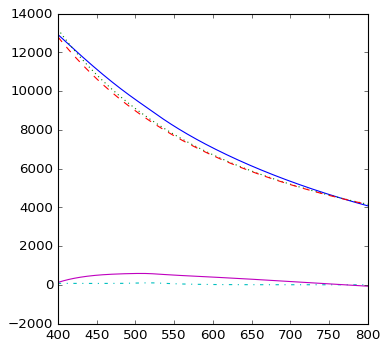

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 988.205]) 200.0 1.2021058963738431]


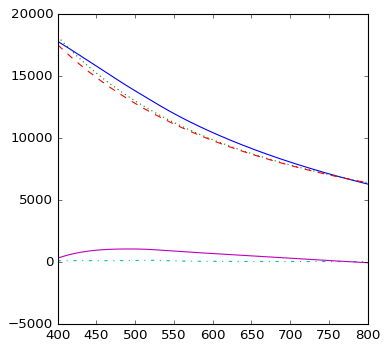

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1310.044]) 210.0 1.2021058963738431]


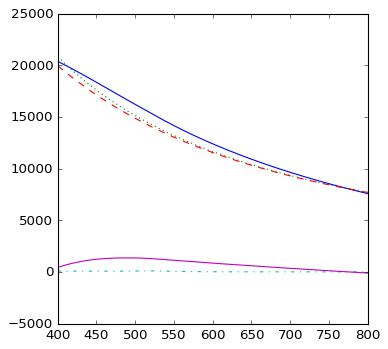

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1562.786]) 217.0 1.2021058963738431]


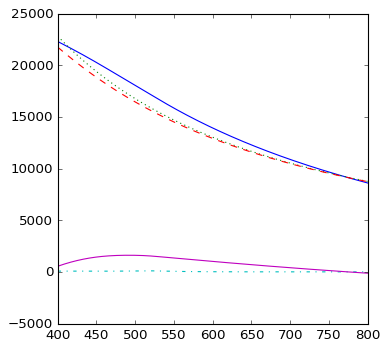

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1600.969]) 218.0 1.2021058963738431]


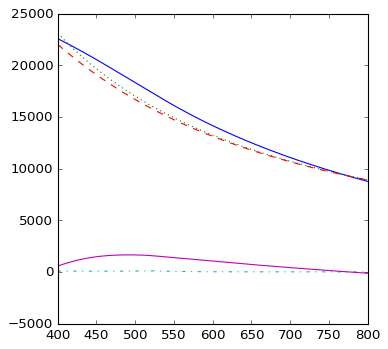

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1639.566]) 219.0 1.2021058963738431]


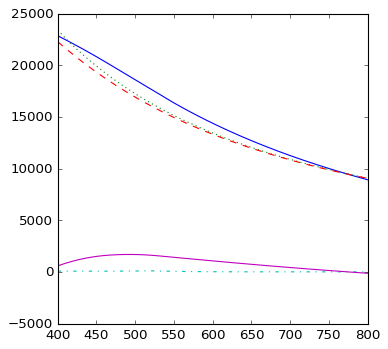

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 2107.79]) 230.0 1.2021058963738431]


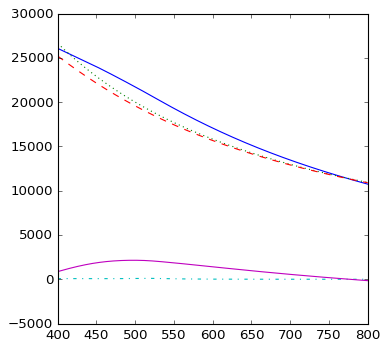

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 3037.445]) 260.0 1.2021058963738431]


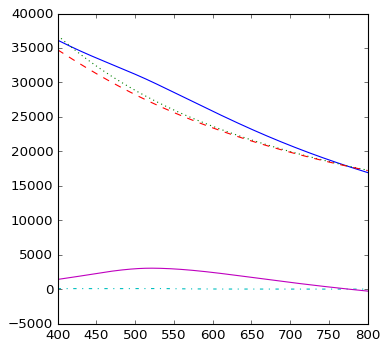

    519.14 ,	 [519.0, 118.54, 11.0, 1.21] 	 (-5.62, 17.549)	 0.779 	 (0.00, 1.00) 	 0.915
    518.25 ,	 [519.0, 111.69, 14.0, 1.21] 	 (-5.66, 16.698)	 0.734 	 (0.00, 1.00) 	 0.899
    518.08 ,	 [518.0, 110.48, 15.0, 1.21] 	 (-5.66, 16.537)	 0.724 	 (0.00, 1.00) 	 0.896
    517.96 ,	 [518.0, 109.54, 16.0, 1.21] 	 (-5.67, 16.407)	 0.718 	 (0.00, 1.00) 	 0.895
    517.87 ,	 [518.0, 108.77, 17.0, 1.21] 	 (-5.67, 16.300)	 0.713 	 (0.00, 1.00) 	 0.894
    517.68 ,	 [518.0, 107.14, 20.0, 1.21] 	 (-5.68, 16.072)	 0.703 	 (0.00, 1.00) 	 0.892
    517.64 ,	 [518.0, 106.73, 21.0, 1.21] 	 (-5.68, 16.021)	 0.700 	 (0.00, 1.00) 	 0.891
    517.6 ,	 [518.0, 106.36, 22.0, 1.21] 	 (-5.67, 15.982)	 0.698 	 (0.00, 1.00) 	 0.891
    517.57 ,	 [518.0, 106.02, 23.0, 1.21] 	 (-5.67, 15.957)	 0.695 	 (0.00, 1.00) 	 0.890
    517.54 ,	 [518.0, 105.7, 24.0, 1.21] 	 (-5.67, 15.945)	 0.693 	 (0.00, 1.00) 	 0.889
    517.5 ,	 [518.0, 105.1, 26.0, 1.21] 	 (-5.66, 15.975)	 0.689 	 (0.00, 1.00) 	 0.886
    517.41 ,	 

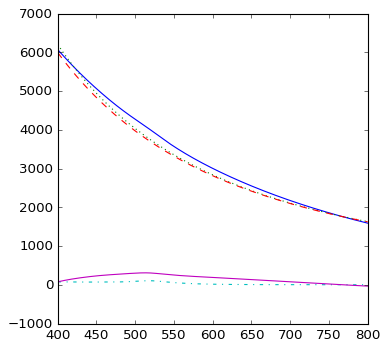

	* Warning *: large scattering cross section:  [ 515.     370.947  164.       1.212]


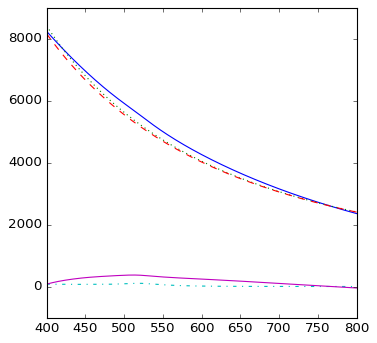

	* Warning *: large scattering cross section:  [ 515.     376.449  165.       1.212]


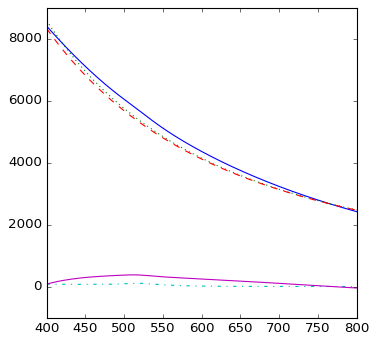

	* Warning *: large scattering cross section:  [ 515.     382.164  166.       1.212]


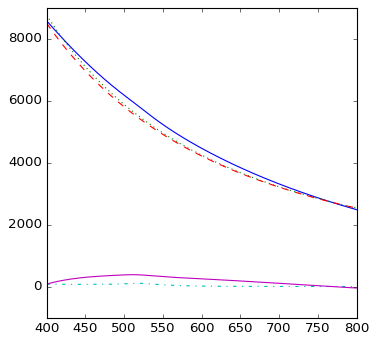

	* Warning *: large scattering cross section:  [ 515.     407.459  170.       1.212]


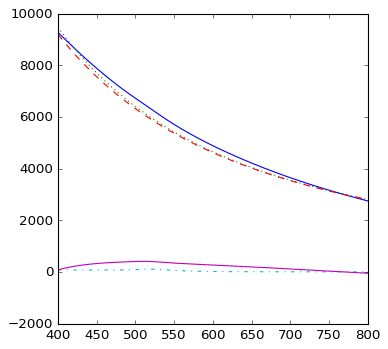

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 507.825]) 180.0 1.2121058963738431]


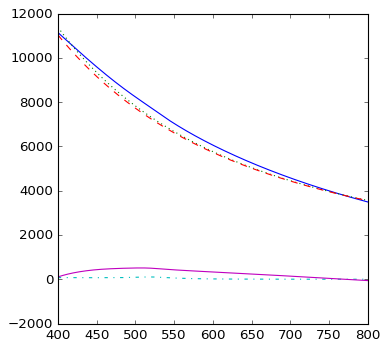

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 881.237]) 200.0 1.2121058963738431]


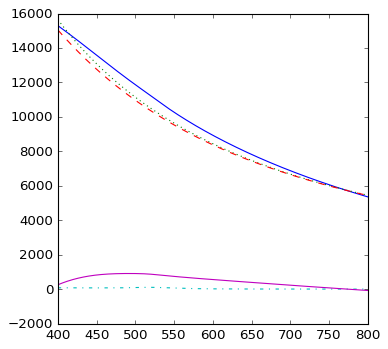

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1172.419]) 210.0 1.2121058963738431]


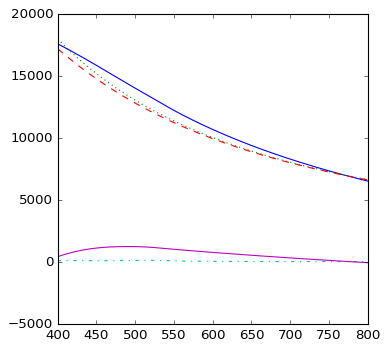

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1396.873]) 217.0 1.2121058963738431]


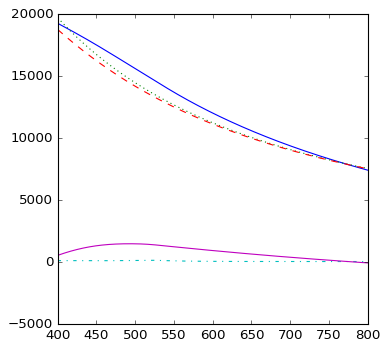

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1430.395]) 218.0 1.2121058963738431]


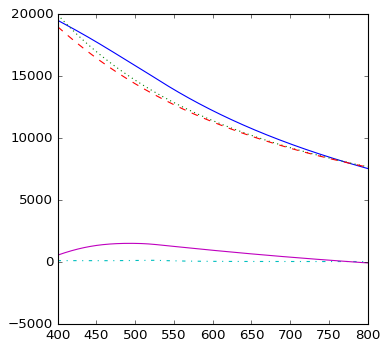

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1464.179]) 219.0 1.2121058963738431]


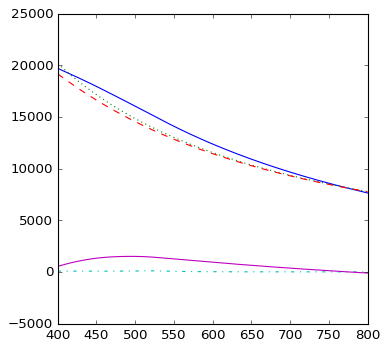

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1865.745]) 230.0 1.2121058963738431]


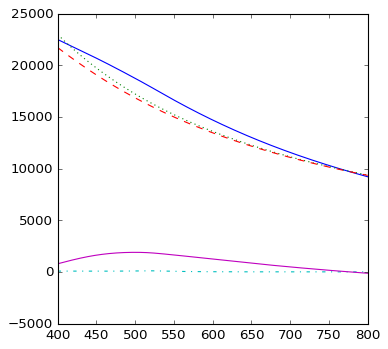

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 2596.134]) 260.0 1.2121058963738431]


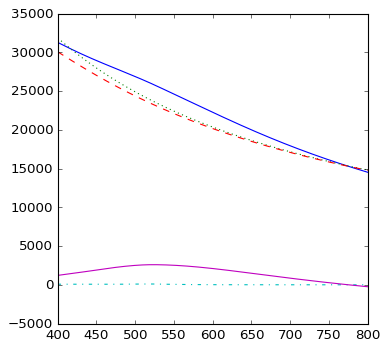

    519.49 ,	 [520.0, 121.19, 11.0, 1.22] 	 (-5.61, 17.862)	 0.798 	 (0.00, 1.00) 	 0.922
    518.65 ,	 [519.0, 114.79, 14.0, 1.22] 	 (-5.64, 17.070)	 0.754 	 (0.00, 1.00) 	 0.907
    518.5 ,	 [519.0, 113.64, 15.0, 1.22] 	 (-5.64, 16.919)	 0.747 	 (0.00, 1.00) 	 0.904
    518.4 ,	 [519.0, 112.74, 16.0, 1.22] 	 (-5.65, 16.797)	 0.741 	 (0.00, 1.00) 	 0.903
    518.31 ,	 [519.0, 112.01, 17.0, 1.22] 	 (-5.65, 16.696)	 0.736 	 (0.00, 1.00) 	 0.902
    518.12 ,	 [518.0, 110.46, 20.0, 1.22] 	 (-5.66, 16.476)	 0.724 	 (0.00, 1.00) 	 0.900
    518.08 ,	 [518.0, 110.07, 21.0, 1.22] 	 (-5.66, 16.424)	 0.722 	 (0.00, 1.00) 	 0.900
    518.05 ,	 [518.0, 109.72, 22.0, 1.22] 	 (-5.66, 16.383)	 0.720 	 (0.00, 1.00) 	 0.899
    518.02 ,	 [518.0, 109.4, 23.0, 1.22] 	 (-5.66, 16.353)	 0.717 	 (0.00, 1.00) 	 0.899
    517.99 ,	 [518.0, 109.1, 24.0, 1.22] 	 (-5.66, 16.335)	 0.715 	 (0.00, 1.00) 	 0.898
    517.95 ,	 [518.0, 108.55, 26.0, 1.22] 	 (-5.65, 16.342)	 0.712 	 (0.00, 1.00) 	 0.896
    517.87 ,	 

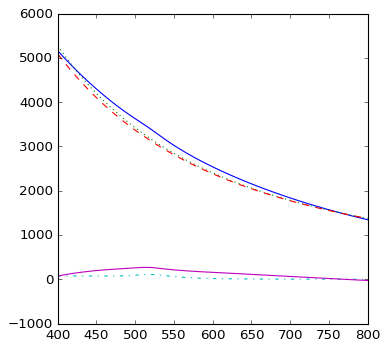

	* Warning *: large scattering cross section:  [ 515.     319.996  164.       1.222]


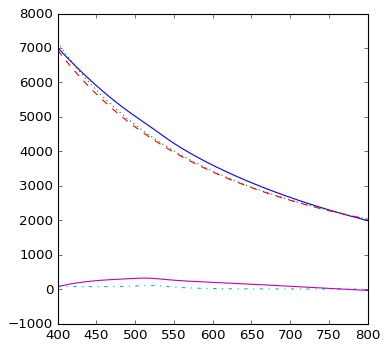

	* Warning *: large scattering cross section:  [ 515.     324.755  165.       1.222]


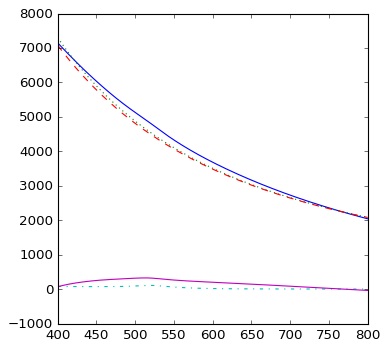

	* Warning *: large scattering cross section:  [ 515.     329.729  166.       1.222]


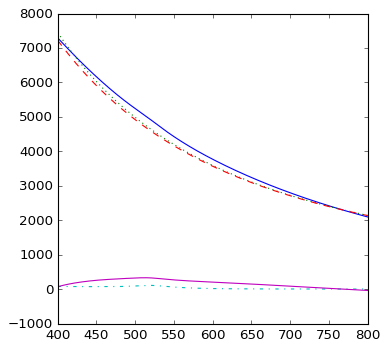

	* Warning *: large scattering cross section:  [ 515.     352.066  170.       1.222]


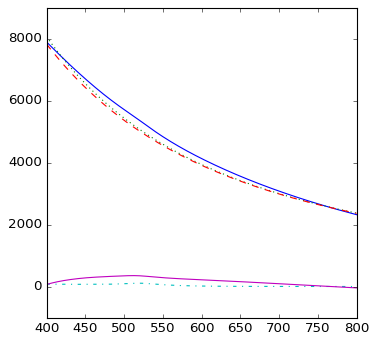

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 442.395]) 180.0 1.2221058963738431]


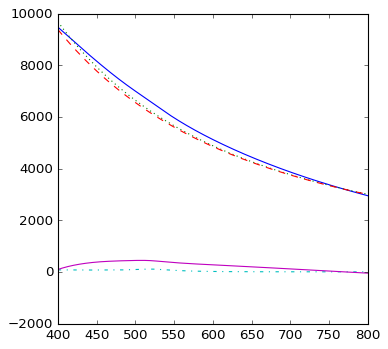

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 781.202]) 200.0 1.2221058963738431]


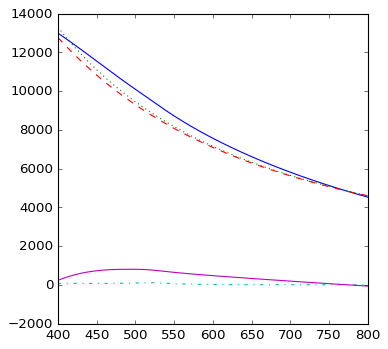

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1039.631]) 210.0 1.2221058963738431]


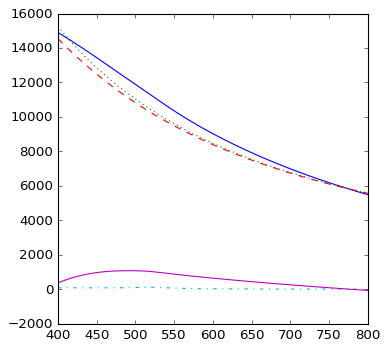

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1234.676]) 217.0 1.2221058963738431]


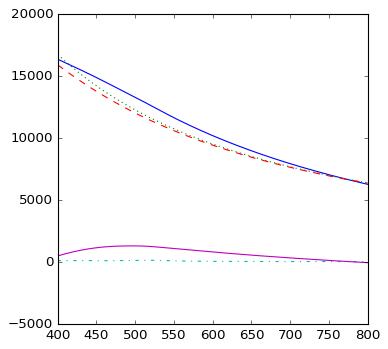

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1280.648]) 218.0 1.2221058963738431]


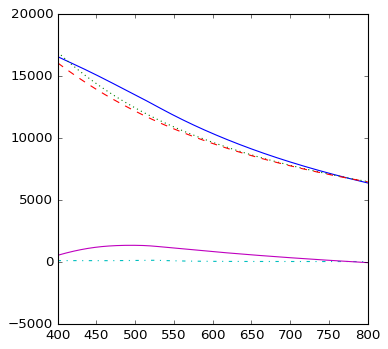

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1309.859]) 219.0 1.2221058963738431]


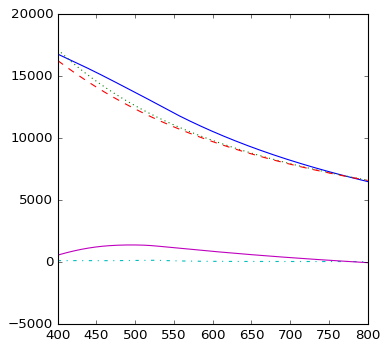

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1628.702]) 230.0 1.2221058963738431]


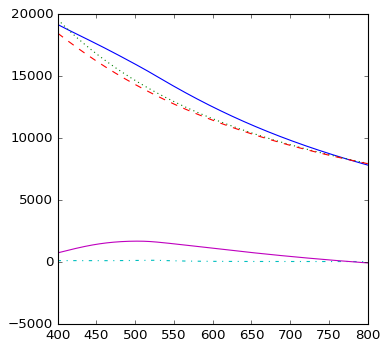

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 2185.891]) 260.0 1.2221058963738431]


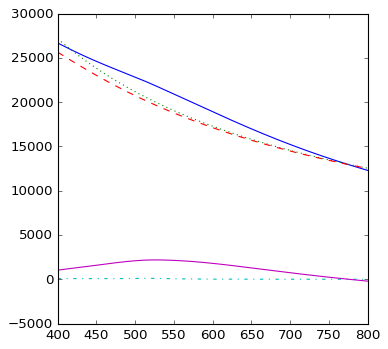

    519.81 ,	 [520.0, 123.86, 11.0, 1.23] 	 (-5.59, 18.175)	 0.815 	 (0.00, 1.00) 	 0.929
    519.04 ,	 [519.0, 117.89, 14.0, 1.23] 	 (-5.62, 17.444)	 0.774 	 (0.00, 1.00) 	 0.915
    518.91 ,	 [519.0, 116.83, 15.0, 1.23] 	 (-5.63, 17.304)	 0.768 	 (0.00, 1.00) 	 0.913
    518.81 ,	 [519.0, 116.0, 16.0, 1.23] 	 (-5.63, 17.190)	 0.762 	 (0.00, 1.00) 	 0.911
    518.73 ,	 [519.0, 115.33, 17.0, 1.23] 	 (-5.64, 17.095)	 0.758 	 (0.00, 1.00) 	 0.910
    518.58 ,	 [519.0, 113.88, 20.0, 1.23] 	 (-5.64, 16.885)	 0.748 	 (0.00, 1.00) 	 0.909
    518.54 ,	 [519.0, 113.52, 21.0, 1.23] 	 (-5.64, 16.834)	 0.746 	 (0.00, 1.00) 	 0.908
    518.51 ,	 [519.0, 113.19, 22.0, 1.23] 	 (-5.64, 16.792)	 0.744 	 (0.00, 1.00) 	 0.908
    518.49 ,	 [519.0, 112.89, 23.0, 1.23] 	 (-5.64, 16.759)	 0.742 	 (0.00, 1.00) 	 0.907
    518.46 ,	 [519.0, 112.6, 24.0, 1.23] 	 (-5.64, 16.736)	 0.740 	 (0.00, 1.00) 	 0.907
    518.42 ,	 [519.0, 112.08, 26.0, 1.23] 	 (-5.63, 16.724)	 0.736 	 (0.00, 1.00) 	 0.905
    518.35 ,

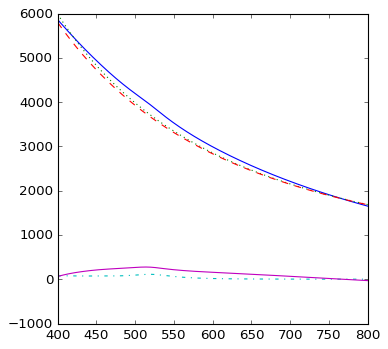

	* Warning *: large scattering cross section:  [ 516.     279.968  165.       1.232]


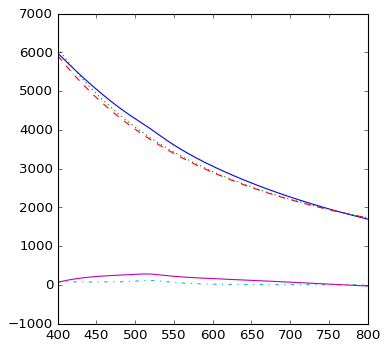

	* Warning *: large scattering cross section:  [ 516.     284.272  166.       1.232]


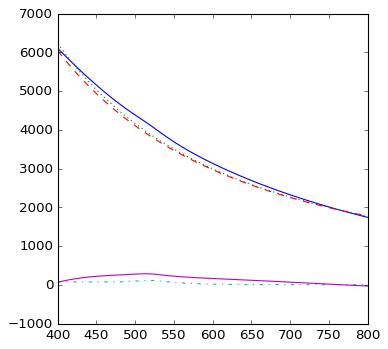

	* Warning *: large scattering cross section:  [ 516.     303.858  170.       1.232]


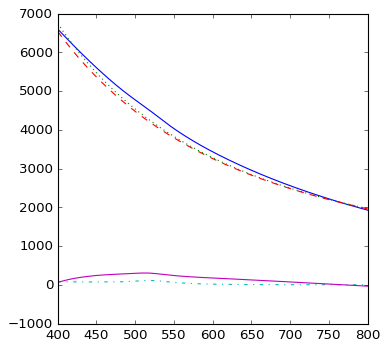

	* Warning *: large scattering cross section:  [ 516.     384.008  180.       1.232]


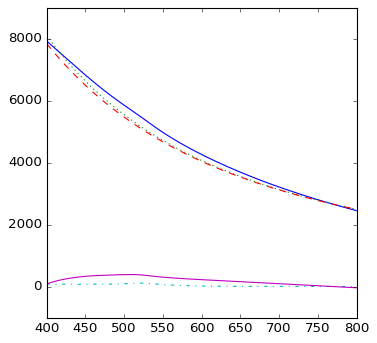

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 684.539]) 200.0 1.2321058963738432]


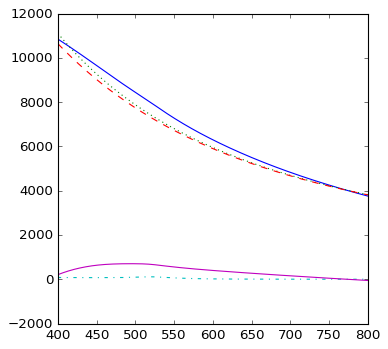

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 908.226]) 210.0 1.2321058963738432]


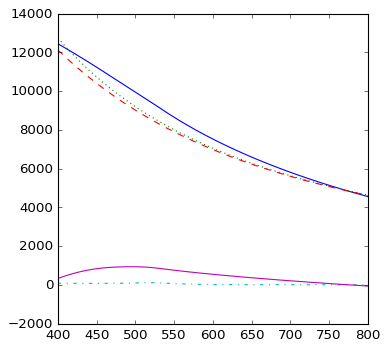

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1087.674]) 217.0 1.2321058963738432]


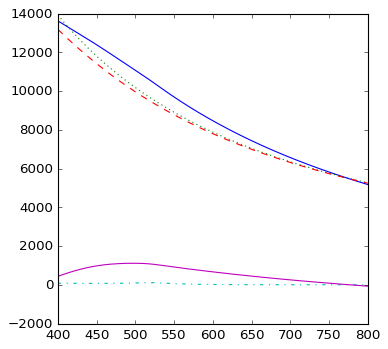

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1112.016]) 218.0 1.2321058963738432]


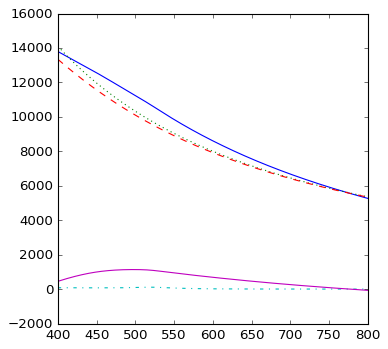

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1136.386]) 219.0 1.2321058963738432]


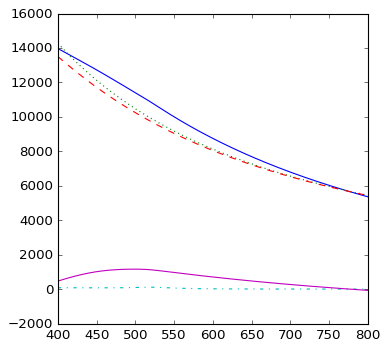

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1396.721]) 230.0 1.2321058963738432]


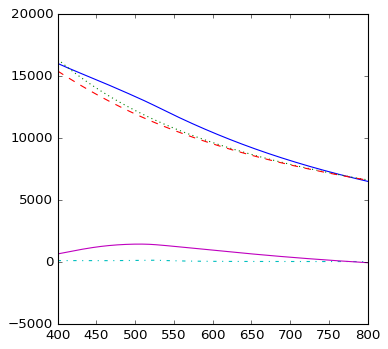

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 527.]) array([ 1809.251]) 260.0 1.2321058963738432]


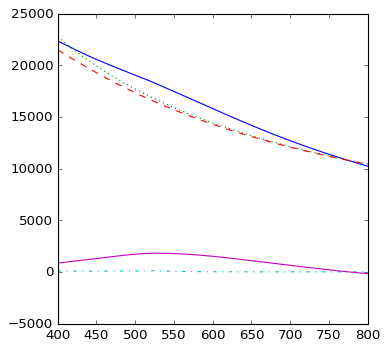

    520.14 ,	 [520.0, 126.51, 11.0, 1.24] 	 (-5.58, 18.487)	 0.833 	 (0.00, 1.00) 	 0.936
    519.46 ,	 [520.0, 121.05, 14.0, 1.24] 	 (-5.61, 17.820)	 0.797 	 (0.00, 1.00) 	 0.922
    519.35 ,	 [520.0, 120.06, 15.0, 1.24] 	 (-5.61, 17.692)	 0.790 	 (0.00, 1.00) 	 0.921
    519.26 ,	 [520.0, 119.28, 16.0, 1.24] 	 (-5.61, 17.587)	 0.785 	 (0.00, 1.00) 	 0.919
    519.16 ,	 [519.0, 118.66, 17.0, 1.24] 	 (-5.62, 17.499)	 0.779 	 (0.00, 1.00) 	 0.919
    519.02 ,	 [519.0, 117.34, 20.0, 1.24] 	 (-5.62, 17.301)	 0.771 	 (0.00, 1.00) 	 0.917
    518.99 ,	 [519.0, 117.0, 21.0, 1.24] 	 (-5.62, 17.251)	 0.769 	 (0.00, 1.00) 	 0.917
    518.96 ,	 [519.0, 116.7, 22.0, 1.24] 	 (-5.62, 17.209)	 0.767 	 (0.00, 1.00) 	 0.917
    518.93 ,	 [519.0, 116.42, 23.0, 1.24] 	 (-5.62, 17.174)	 0.765 	 (0.00, 1.00) 	 0.917
    518.91 ,	 [519.0, 116.16, 24.0, 1.24] 	 (-5.62, 17.147)	 0.763 	 (0.00, 1.00) 	 0.916
    518.88 ,	 [519.0, 115.68, 26.0, 1.24] 	 (-5.62, 17.120)	 0.760 	 (0.00, 1.00) 	 0.915
    518.8 ,	

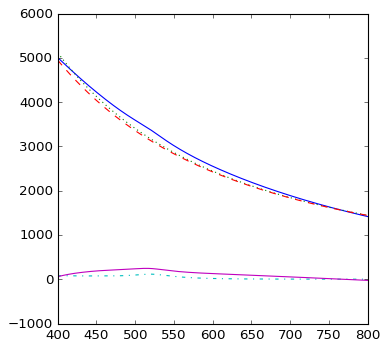

	* Warning *: large scattering cross section:  [ 515.     263.492  170.       1.242]


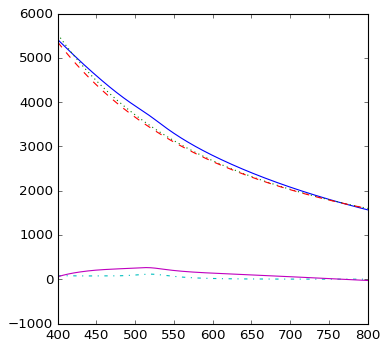

	* Warning *: large scattering cross section:  [ 515.     334.458  180.       1.242]


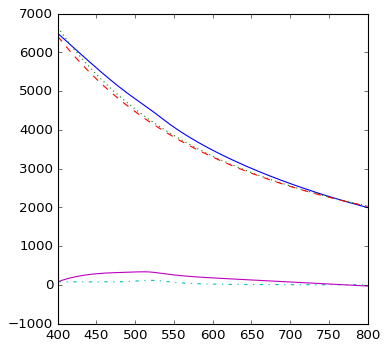

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 606.886]) 200.0 1.2421058963738432]


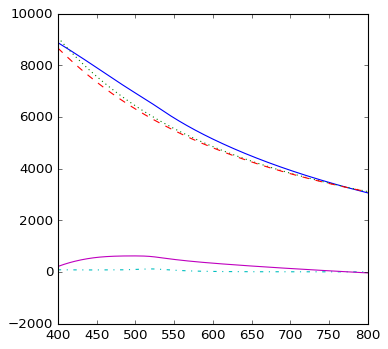

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 786.968]) 210.0 1.2421058963738432]


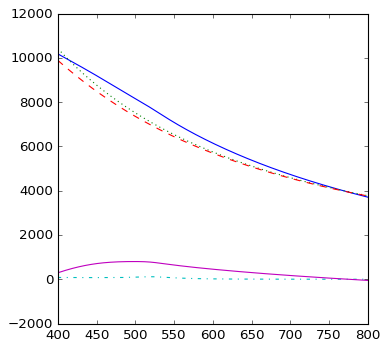

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 934.883]) 217.0 1.2421058963738432]


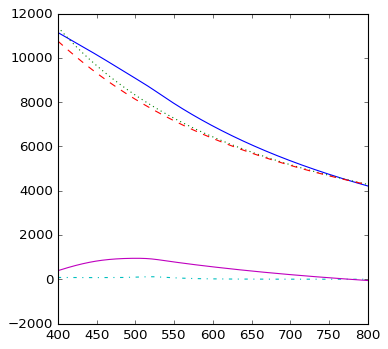

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 954.622]) 218.0 1.2421058963738432]


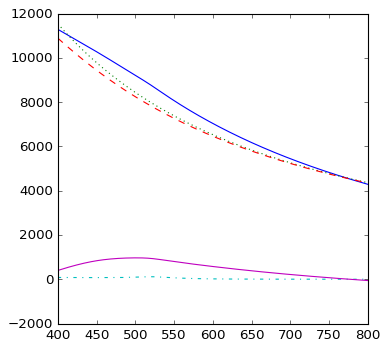

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 974.302]) 219.0 1.2421058963738432]


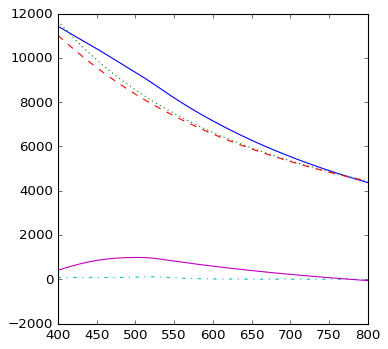

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1179.115]) 230.0 1.2421058963738432]


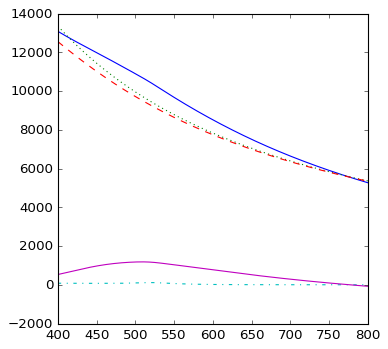

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1447.882]) 260.0 1.2421058963738432]


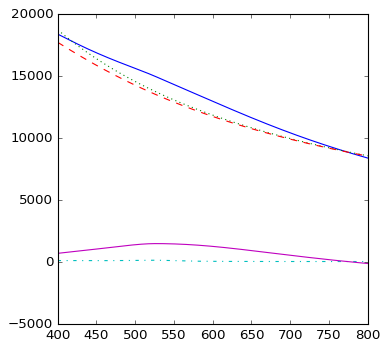

    520.49 ,	 [521.0, 129.21, 11.0, 1.25] 	 (-5.56, 18.800)	 0.852 	 (0.00, 1.00) 	 0.942
    519.86 ,	 [520.0, 124.26, 14.0, 1.25] 	 (-5.59, 18.198)	 0.818 	 (0.00, 1.00) 	 0.931
    519.75 ,	 [520.0, 123.37, 15.0, 1.25] 	 (-5.59, 18.082)	 0.812 	 (0.00, 1.00) 	 0.929
    519.67 ,	 [520.0, 122.66, 16.0, 1.25] 	 (-5.60, 17.986)	 0.807 	 (0.00, 1.00) 	 0.928
    519.61 ,	 [520.0, 122.09, 17.0, 1.25] 	 (-5.60, 17.906)	 0.804 	 (0.00, 1.00) 	 0.927
    519.48 ,	 [520.0, 120.87, 20.0, 1.25] 	 (-5.61, 17.723)	 0.796 	 (0.00, 1.00) 	 0.926
    519.45 ,	 [520.0, 120.56, 21.0, 1.25] 	 (-5.61, 17.675)	 0.794 	 (0.00, 1.00) 	 0.926
    519.43 ,	 [520.0, 120.28, 22.0, 1.25] 	 (-5.61, 17.633)	 0.792 	 (0.00, 1.00) 	 0.926
    519.41 ,	 [520.0, 120.02, 23.0, 1.25] 	 (-5.61, 17.597)	 0.790 	 (0.00, 1.00) 	 0.925
    519.39 ,	 [520.0, 119.78, 24.0, 1.25] 	 (-5.61, 17.568)	 0.788 	 (0.00, 1.00) 	 0.925
    519.36 ,	 [520.0, 119.34, 26.0, 1.25] 	 (-5.61, 17.529)	 0.786 	 (0.00, 1.00) 	 0.925
    519.29

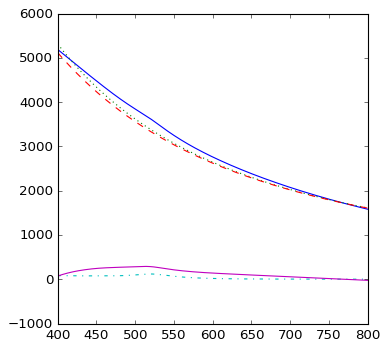

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 518.973]) 200.0 1.2521058963738432]


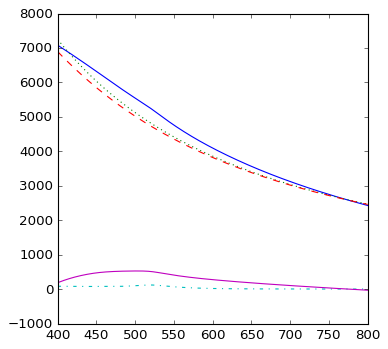

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 674.508]) 210.0 1.2521058963738432]


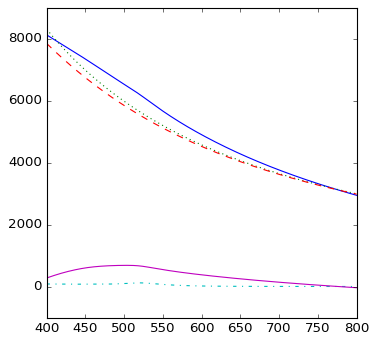

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 784.065]) 217.0 1.2521058963738432]


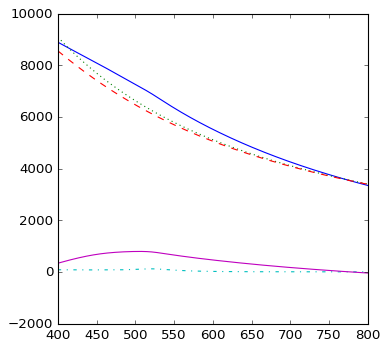

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 799.572]) 218.0 1.2521058963738432]


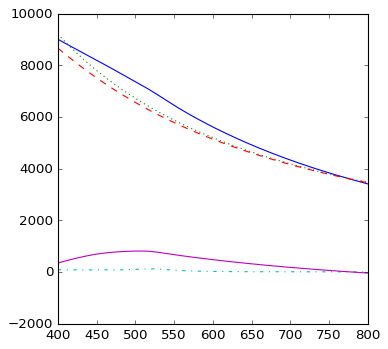

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 814.973]) 219.0 1.2521058963738432]


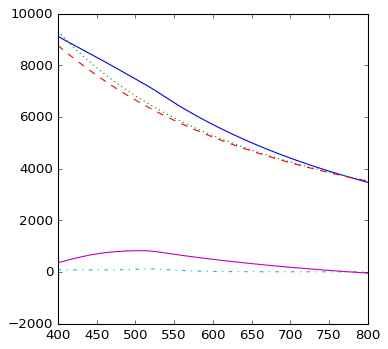

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 960.215]) 230.0 1.2521058963738432]


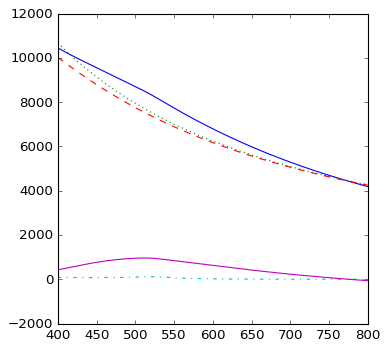

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1147.916]) 260.0 1.2521058963738432]


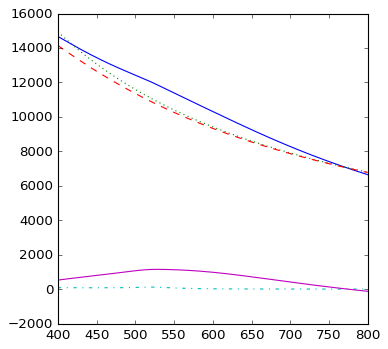

    520.82 ,	 [521.0, 131.92, 11.0, 1.26] 	 (-5.55, 19.111)	 0.870 	 (0.00, 1.00) 	 0.950
    520.26 ,	 [520.0, 127.47, 14.0, 1.26] 	 (-5.57, 18.578)	 0.839 	 (0.00, 1.00) 	 0.939
    520.17 ,	 [520.0, 126.68, 15.0, 1.26] 	 (-5.58, 18.474)	 0.834 	 (0.00, 1.00) 	 0.938
    520.09 ,	 [520.0, 126.05, 16.0, 1.26] 	 (-5.58, 18.389)	 0.830 	 (0.00, 1.00) 	 0.937
    520.04 ,	 [520.0, 125.55, 17.0, 1.26] 	 (-5.58, 18.317)	 0.826 	 (0.00, 1.00) 	 0.936
    519.92 ,	 [520.0, 124.46, 20.0, 1.26] 	 (-5.59, 18.149)	 0.819 	 (0.00, 1.00) 	 0.935
    519.9 ,	 [520.0, 124.18, 21.0, 1.26] 	 (-5.59, 18.105)	 0.817 	 (0.00, 1.00) 	 0.935
    519.88 ,	 [520.0, 123.93, 22.0, 1.26] 	 (-5.59, 18.065)	 0.816 	 (0.00, 1.00) 	 0.935
    519.86 ,	 [520.0, 123.71, 23.0, 1.26] 	 (-5.59, 18.029)	 0.814 	 (0.00, 1.00) 	 0.935
    519.84 ,	 [520.0, 123.49, 24.0, 1.26] 	 (-5.59, 17.998)	 0.813 	 (0.00, 1.00) 	 0.935
    519.81 ,	 [520.0, 123.1, 26.0, 1.26] 	 (-5.59, 17.953)	 0.810 	 (0.00, 1.00) 	 0.935
    519.75 ,

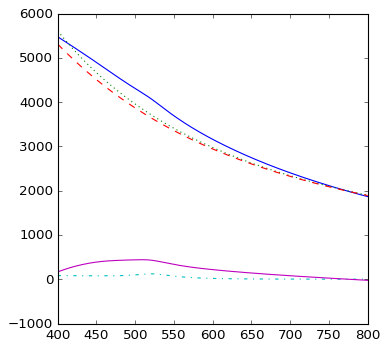

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 560.506]) 210.0 1.2621058963738432]


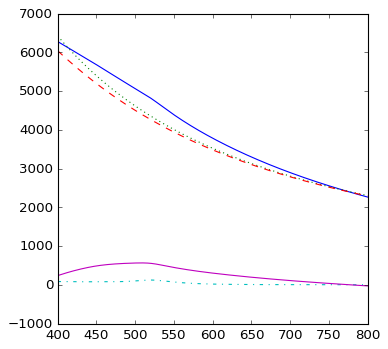

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 644.185]) 217.0 1.2621058963738432]


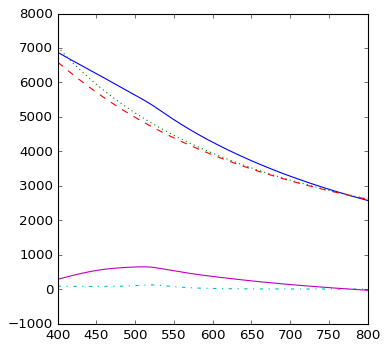

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 655.841]) 218.0 1.2621058963738432]


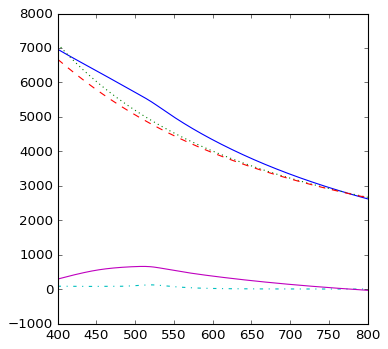

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 667.376]) 219.0 1.2621058963738432]


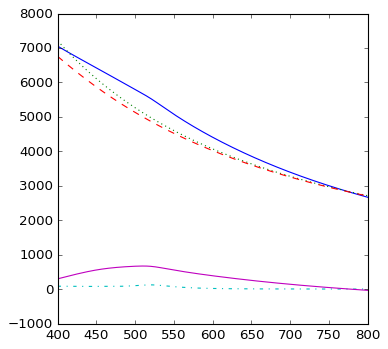

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 772.625]) 230.0 1.2621058963738432]


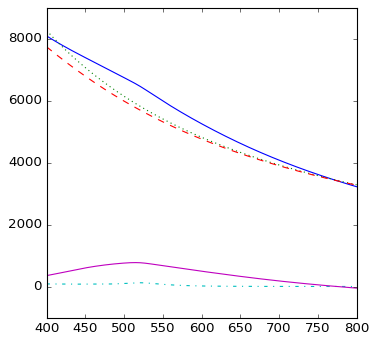

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 527.]) array([ 886.596]) 260.0 1.2621058963738432]


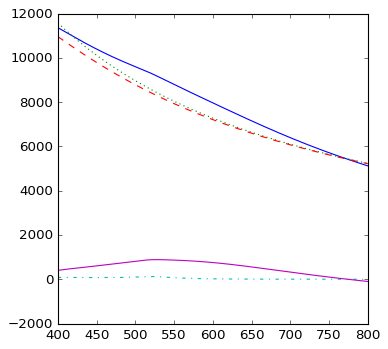

    521.15 ,	 [521.0, 134.62, 11.0, 1.27] 	 (-5.53, 19.422)	 0.887 	 (0.00, 1.00) 	 0.957
    520.68 ,	 [521.0, 130.77, 14.0, 1.27] 	 (-5.55, 18.959)	 0.862 	 (0.00, 1.00) 	 0.948
    520.6 ,	 [521.0, 130.07, 15.0, 1.27] 	 (-5.56, 18.869)	 0.858 	 (0.00, 1.00) 	 0.946
    520.54 ,	 [521.0, 129.51, 16.0, 1.27] 	 (-5.56, 18.794)	 0.854 	 (0.00, 1.00) 	 0.945
    520.49 ,	 [521.0, 129.06, 17.0, 1.27] 	 (-5.56, 18.731)	 0.851 	 (0.00, 1.00) 	 0.945
    520.39 ,	 [521.0, 128.09, 20.0, 1.27] 	 (-5.57, 18.581)	 0.845 	 (0.00, 1.00) 	 0.944
    520.37 ,	 [521.0, 127.84, 21.0, 1.27] 	 (-5.57, 18.541)	 0.843 	 (0.00, 1.00) 	 0.944
    520.35 ,	 [521.0, 127.62, 22.0, 1.27] 	 (-5.57, 18.504)	 0.842 	 (0.00, 1.00) 	 0.944
    520.34 ,	 [521.0, 127.42, 23.0, 1.27] 	 (-5.57, 18.470)	 0.840 	 (0.00, 1.00) 	 0.944
    520.32 ,	 [521.0, 127.23, 24.0, 1.27] 	 (-5.57, 18.439)	 0.839 	 (0.00, 1.00) 	 0.944
    520.3 ,	 [521.0, 126.88, 26.0, 1.27] 	 (-5.57, 18.389)	 0.837 	 (0.00, 1.00) 	 0.944
    520.23 ,

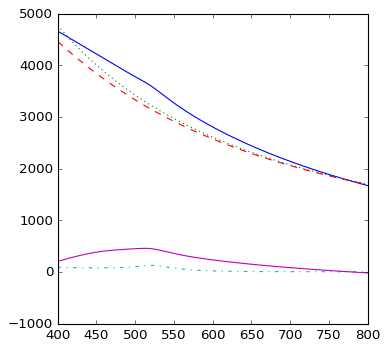

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 515.4]) 217.0 1.2721058963738432]


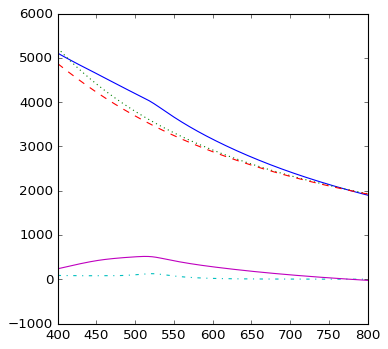

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 523.72]) 218.0 1.2721058963738432]


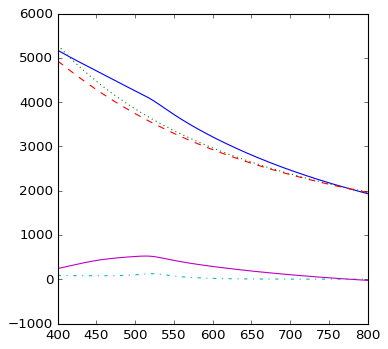

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 531.912]) 219.0 1.2721058963738432]


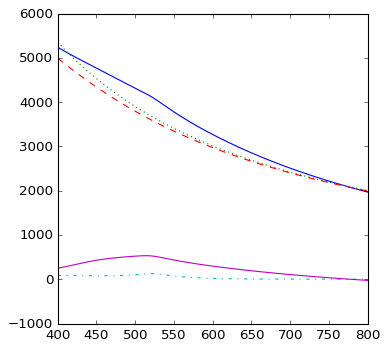

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 603.853]) 230.0 1.2721058963738432]


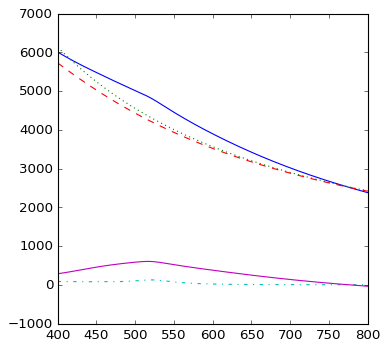

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 666.042]) 260.0 1.2721058963738432]


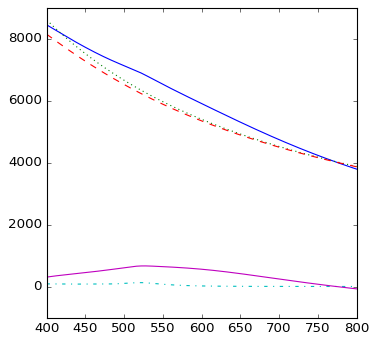

    521.5 ,	 [522.0, 137.34, 11.0, 1.28] 	 (-5.52, 19.733)	 0.907 	 (0.00, 1.00) 	 0.964
    521.08 ,	 [521.0, 134.08, 14.0, 1.28] 	 (-5.54, 19.342)	 0.884 	 (0.00, 1.00) 	 0.956
    521.01 ,	 [521.0, 133.48, 15.0, 1.28] 	 (-5.54, 19.265)	 0.880 	 (0.00, 1.00) 	 0.955
    520.96 ,	 [521.0, 133.01, 16.0, 1.28] 	 (-5.54, 19.202)	 0.877 	 (0.00, 1.00) 	 0.954
    520.92 ,	 [521.0, 132.63, 17.0, 1.28] 	 (-5.54, 19.148)	 0.874 	 (0.00, 1.00) 	 0.954
    520.84 ,	 [521.0, 131.81, 20.0, 1.28] 	 (-5.55, 19.019)	 0.869 	 (0.00, 1.00) 	 0.953
    520.82 ,	 [521.0, 131.6, 21.0, 1.28] 	 (-5.55, 18.983)	 0.868 	 (0.00, 1.00) 	 0.953
    520.8 ,	 [521.0, 131.42, 22.0, 1.28] 	 (-5.55, 18.949)	 0.866 	 (0.00, 1.00) 	 0.953
    520.79 ,	 [521.0, 131.24, 23.0, 1.28] 	 (-5.55, 18.918)	 0.865 	 (0.00, 1.00) 	 0.953
    520.78 ,	 [521.0, 131.08, 24.0, 1.28] 	 (-5.55, 18.889)	 0.864 	 (0.00, 1.00) 	 0.953
    520.76 ,	 [521.0, 130.79, 26.0, 1.28] 	 (-5.55, 18.839)	 0.862 	 (0.00, 1.00) 	 0.954
    520.72 ,	

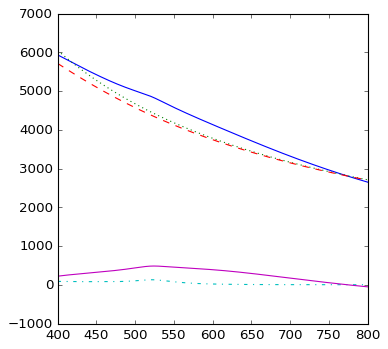

    524.67 ,	 [524.0, 484.48, 260.0, 1.28] 	 (-1.16, 4317.831)	 3.208 	 (-1.09, 4225.79) 	 0.516
    521.82 ,	 [522.0, 140.1, 11.0, 1.29] 	 (-5.51, 20.042)	 0.925 	 (0.00, 1.00) 	 0.971
    521.51 ,	 [522.0, 137.41, 14.0, 1.29] 	 (-5.52, 19.726)	 0.908 	 (0.00, 1.00) 	 0.965
    521.45 ,	 [522.0, 136.92, 15.0, 1.29] 	 (-5.52, 19.664)	 0.904 	 (0.00, 1.00) 	 0.964
    521.41 ,	 [522.0, 136.53, 16.0, 1.29] 	 (-5.52, 19.612)	 0.902 	 (0.00, 1.00) 	 0.963
    521.38 ,	 [522.0, 136.21, 17.0, 1.29] 	 (-5.53, 19.567)	 0.900 	 (0.00, 1.00) 	 0.963
    521.29 ,	 [521.0, 135.54, 20.0, 1.29] 	 (-5.53, 19.460)	 0.893 	 (0.00, 1.00) 	 0.962
    521.27 ,	 [521.0, 135.37, 21.0, 1.29] 	 (-5.53, 19.430)	 0.892 	 (0.00, 1.00) 	 0.962
    521.26 ,	 [521.0, 135.22, 22.0, 1.29] 	 (-5.53, 19.401)	 0.891 	 (0.00, 1.00) 	 0.962
    521.25 ,	 [521.0, 135.08, 23.0, 1.29] 	 (-5.53, 19.374)	 0.890 	 (0.00, 1.00) 	 0.963
    521.24 ,	 [521.0, 134.95, 24.0, 1.29] 	 (-5.53, 19.348)	 0.890 	 (0.00, 1.00) 	 0.963
    

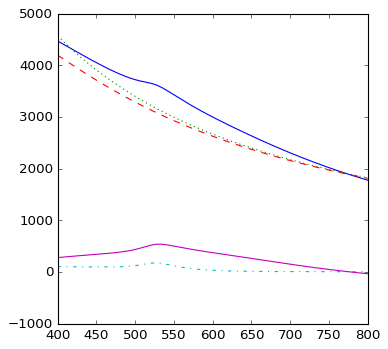

    531.25 ,	 [531.0, 536.8, 230.0, 1.38] 	 (-1.33, 3105.181)	 3.596 	 (-1.23, 3004.12) 	 0.511
	* Warning *: large scattering cross section:  [ 531.     522.426  260.       1.382]


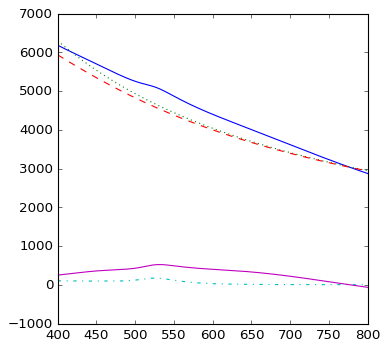

    531.68 ,	 [531.0, 522.43, 260.0, 1.38] 	 (-1.10, 4579.448)	 3.500 	 (-1.03, 4478.42) 	 0.519
    525.19 ,	 [525.0, 167.73, 11.0, 1.39] 	 (-5.36, 23.073)	 1.113 	 (0.00, 1.00) 	 1.045
    525.74 ,	 [526.0, 172.31, 14.0, 1.39] 	 (-5.34, 23.594)	 1.146 	 (0.00, 1.00) 	 1.056
    525.83 ,	 [526.0, 173.19, 15.0, 1.39] 	 (-5.34, 23.702)	 1.151 	 (0.00, 1.00) 	 1.058
    525.91 ,	 [526.0, 173.89, 16.0, 1.39] 	 (-5.33, 23.794)	 1.156 	 (0.00, 1.00) 	 1.059
    525.97 ,	 [526.0, 174.46, 17.0, 1.39] 	 (-5.33, 23.875)	 1.160 	 (0.00, 1.00) 	 1.060
    526.08 ,	 [526.0, 175.69, 20.0, 1.39] 	 (-5.32, 24.088)	 1.168 	 (0.00, 1.00) 	 1.060
    526.11 ,	 [526.0, 176.01, 21.0, 1.39] 	 (-5.32, 24.157)	 1.170 	 (0.00, 1.00) 	 1.059
    526.13 ,	 [526.0, 176.29, 22.0, 1.39] 	 (-5.32, 24.227)	 1.172 	 (0.00, 1.00) 	 1.059
    526.15 ,	 [526.0, 176.55, 23.0, 1.39] 	 (-5.32, 24.301)	 1.174 	 (0.00, 1.00) 	 1.058
    526.16 ,	 [526.0, 176.8, 24.0, 1.39] 	 (-5.31, 24.378)	 1.175 	 (0.00, 1.00) 	 1.057
    

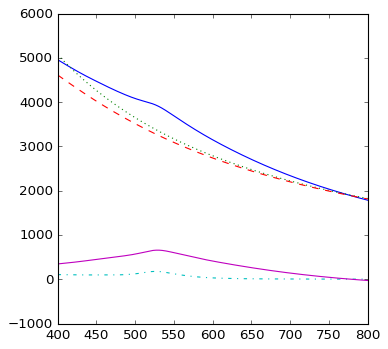

    528.99 ,	 [529.0, 657.63, 210.0, 1.39] 	 (-1.48, 3301.977)	 4.392 	 (-1.37, 3180.57) 	 0.502
	* Warning *: large scattering cross section:  [ 530.     682.303  217.       1.392]


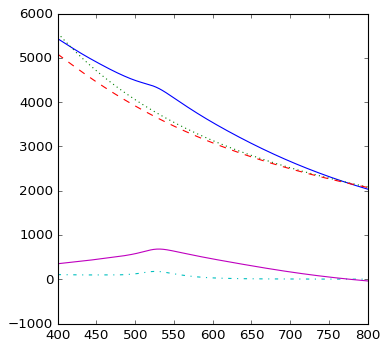

    530.64 ,	 [530.0, 682.3, 217.0, 1.39] 	 (-1.42, 3684.208)	 4.563 	 (-1.31, 3557.10) 	 0.503
	* Warning *: large scattering cross section:  [ 531.     685.591  218.       1.392]


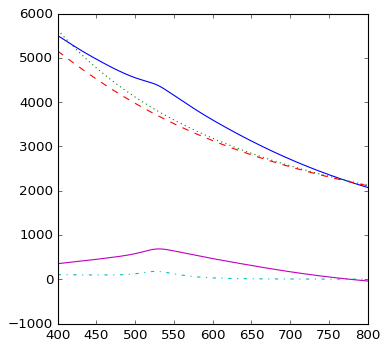

    530.9 ,	 [531.0, 685.59, 218.0, 1.39] 	 (-1.41, 3740.344)	 4.593 	 (-1.31, 3612.46) 	 0.504
	* Warning *: large scattering cross section:  [ 531.     688.64   219.       1.392]


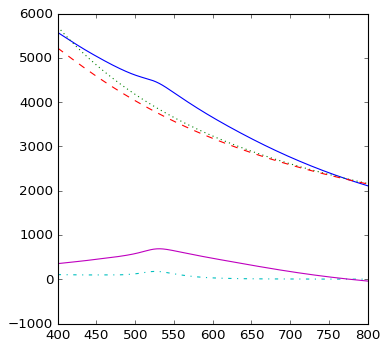

    531.13 ,	 [531.0, 688.64, 219.0, 1.39] 	 (-1.40, 3797.030)	 4.613 	 (-1.30, 3668.41) 	 0.504
	* Warning *: large scattering cross section:  [ 533.     706.553  230.       1.392]


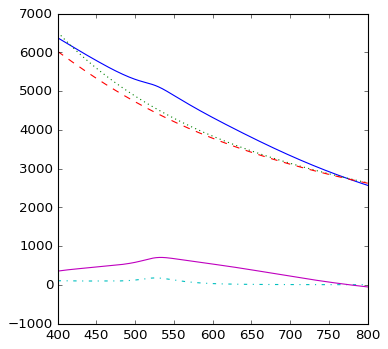

    533.4 ,	 [533.0, 706.55, 230.0, 1.39] 	 (-1.31, 4456.430)	 4.747 	 (-1.22, 4322.68) 	 0.506
	* Warning *: large scattering cross section:  [ 533.     692.598  260.       1.392]


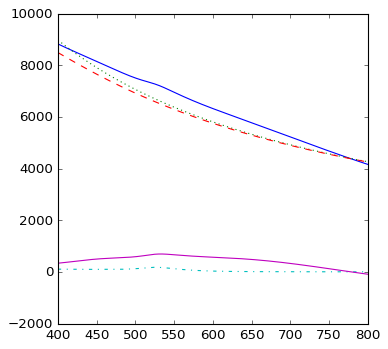

    533.14 ,	 [533.0, 692.6, 260.0, 1.39] 	 (-1.07, 6568.813)	 4.654 	 (-1.01, 6434.22) 	 0.517
    525.55 ,	 [526.0, 170.47, 11.0, 1.4] 	 (-5.35, 23.368)	 1.133 	 (0.00, 1.00) 	 1.053
    526.17 ,	 [526.0, 175.91, 14.0, 1.4] 	 (-5.32, 23.980)	 1.169 	 (0.00, 1.00) 	 1.066
    526.28 ,	 [526.0, 176.93, 15.0, 1.4] 	 (-5.32, 24.107)	 1.176 	 (0.00, 1.00) 	 1.067
    526.37 ,	 [526.0, 177.74, 16.0, 1.4] 	 (-5.31, 24.215)	 1.181 	 (0.00, 1.00) 	 1.069
    526.44 ,	 [526.0, 178.4, 17.0, 1.4] 	 (-5.31, 24.311)	 1.186 	 (0.00, 1.00) 	 1.069
    526.6 ,	 [527.0, 179.86, 20.0, 1.4] 	 (-5.30, 24.566)	 1.198 	 (0.00, 1.00) 	 1.070
    526.63 ,	 [527.0, 180.24, 21.0, 1.4] 	 (-5.30, 24.649)	 1.200 	 (0.00, 1.00) 	 1.069
    526.65 ,	 [527.0, 180.59, 22.0, 1.4] 	 (-5.30, 24.734)	 1.203 	 (0.00, 1.00) 	 1.069
    526.68 ,	 [527.0, 180.9, 23.0, 1.4] 	 (-5.29, 24.823)	 1.205 	 (0.00, 1.00) 	 1.068
    526.7 ,	 [527.0, 181.2, 24.0, 1.4] 	 (-5.29, 24.918)	 1.207 	 (0.00, 1.00) 	 1.067
    526.73 ,	 [527.

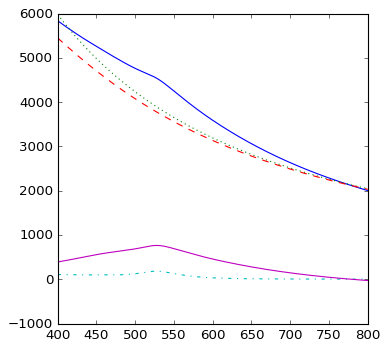

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 847.965]) 210.0 1.4021058963738433]


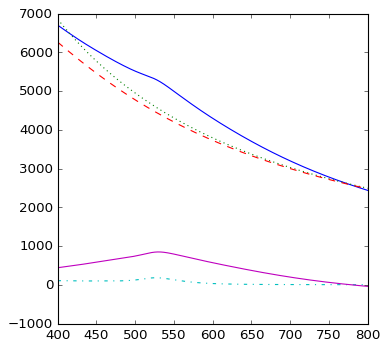

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 885.765]) 217.0 1.4021058963738433]


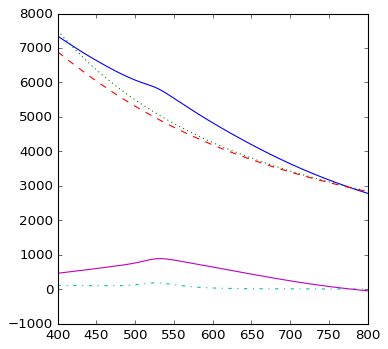

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 889.756]) 218.0 1.4021058963738433]


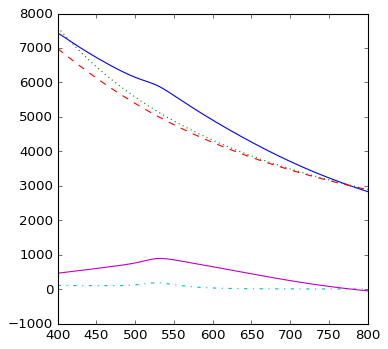

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 893.392]) 219.0 1.4021058963738433]


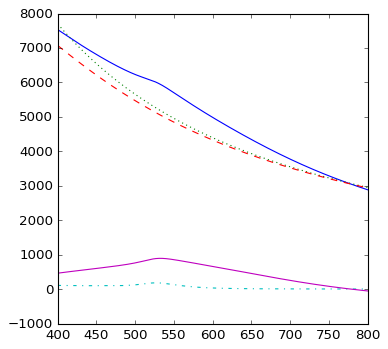

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 535.]) array([ 914.206]) 230.0 1.4021058963738433]


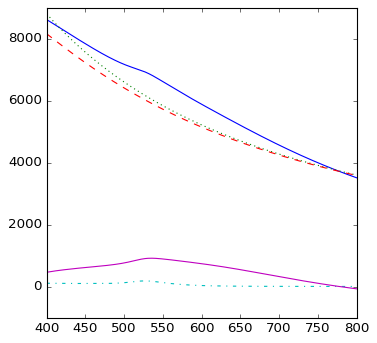

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 882.597]) 260.0 1.4021058963738433]


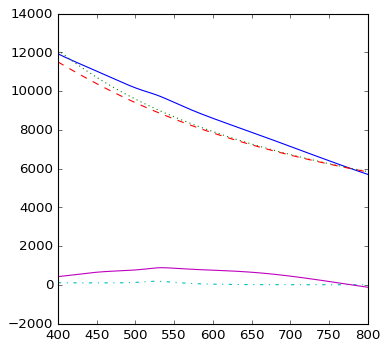

    525.89 ,	 [526.0, 173.26, 11.0, 1.41] 	 (-5.33, 23.660)	 1.152 	 (0.00, 1.00) 	 1.061
    526.63 ,	 [527.0, 179.48, 14.0, 1.41] 	 (-5.30, 24.365)	 1.195 	 (0.00, 1.00) 	 1.075
    526.76 ,	 [527.0, 180.68, 15.0, 1.41] 	 (-5.30, 24.511)	 1.203 	 (0.00, 1.00) 	 1.077
    526.86 ,	 [527.0, 181.64, 16.0, 1.41] 	 (-5.29, 24.637)	 1.210 	 (0.00, 1.00) 	 1.079
    526.94 ,	 [527.0, 182.42, 17.0, 1.41] 	 (-5.29, 24.748)	 1.215 	 (0.00, 1.00) 	 1.080
    527.1 ,	 [527.0, 184.13, 20.0, 1.41] 	 (-5.28, 25.045)	 1.226 	 (0.00, 1.00) 	 1.080
    527.13 ,	 [527.0, 184.56, 21.0, 1.41] 	 (-5.28, 25.143)	 1.229 	 (0.00, 1.00) 	 1.079
    527.16 ,	 [527.0, 184.95, 22.0, 1.41] 	 (-5.28, 25.244)	 1.232 	 (0.00, 1.00) 	 1.079
    527.19 ,	 [527.0, 185.31, 23.0, 1.41] 	 (-5.27, 25.350)	 1.234 	 (0.00, 1.00) 	 1.077
    527.21 ,	 [527.0, 185.65, 24.0, 1.41] 	 (-5.27, 25.463)	 1.236 	 (0.00, 1.00) 	 1.076
    527.25 ,	 [527.0, 186.28, 26.0, 1.41] 	 (-5.26, 25.719)	 1.240 	 (0.00, 1.00) 	 1.073
    527.33 

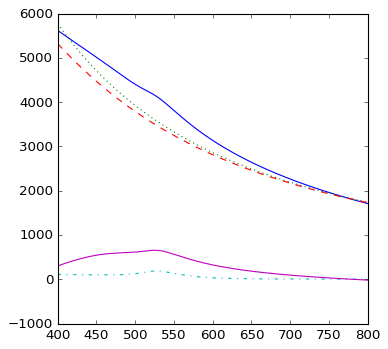

    524.55 ,	 [525.0, 655.2, 180.0, 1.41] 	 (-1.73, 3490.061)	 4.347 	 (-1.64, 3373.40) 	 0.470
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 965.96]) 200.0 1.4121058963738433]


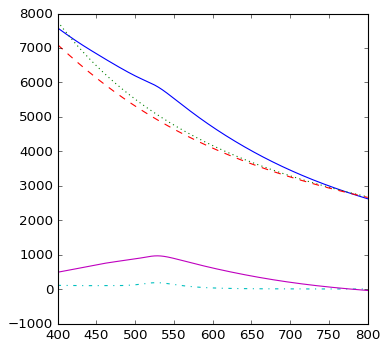

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 1068.052]) 210.0 1.4121058963738433]


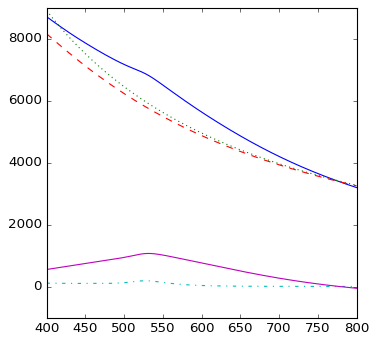

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 1112.167]) 217.0 1.4121058963738433]


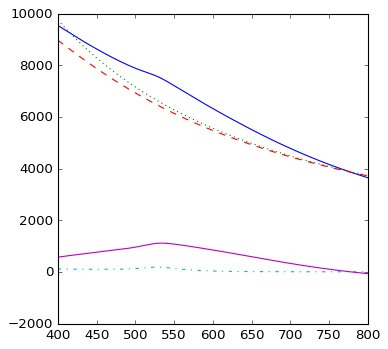

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 1116.714]) 218.0 1.4121058963738433]


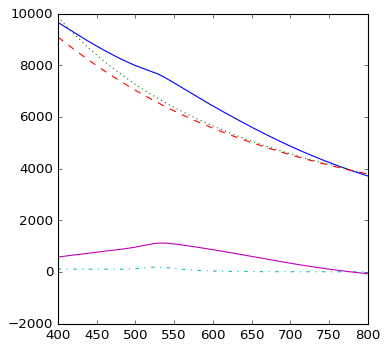

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 1120.808]) 219.0 1.4121058963738433]


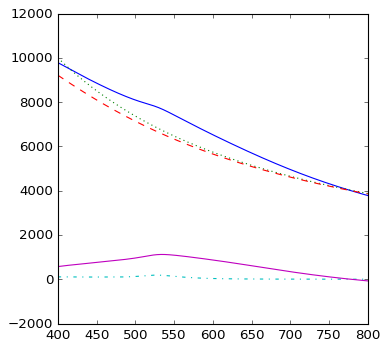

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 1142.358]) 230.0 1.4121058963738433]


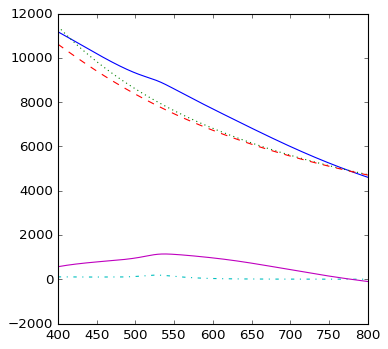

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 535.]) array([ 1098.673]) 260.0 1.4121058963738433]


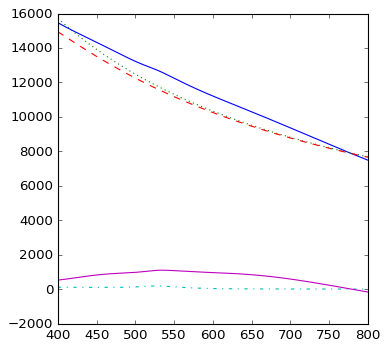

    526.23 ,	 [526.0, 176.01, 11.0, 1.42] 	 (-5.32, 23.951)	 1.170 	 (0.00, 1.00) 	 1.068
    527.07 ,	 [527.0, 183.11, 14.0, 1.42] 	 (-5.29, 24.748)	 1.219 	 (0.00, 1.00) 	 1.085
    527.22 ,	 [527.0, 184.45, 15.0, 1.42] 	 (-5.28, 24.915)	 1.228 	 (0.00, 1.00) 	 1.087
    527.33 ,	 [527.0, 185.53, 16.0, 1.42] 	 (-5.27, 25.058)	 1.235 	 (0.00, 1.00) 	 1.089
    527.42 ,	 [527.0, 186.4, 17.0, 1.42] 	 (-5.27, 25.185)	 1.241 	 (0.00, 1.00) 	 1.090
    527.63 ,	 [528.0, 188.34, 20.0, 1.42] 	 (-5.26, 25.526)	 1.256 	 (0.00, 1.00) 	 1.090
    527.67 ,	 [528.0, 188.85, 21.0, 1.42] 	 (-5.26, 25.639)	 1.260 	 (0.00, 1.00) 	 1.089
    527.7 ,	 [528.0, 189.3, 22.0, 1.42] 	 (-5.25, 25.756)	 1.263 	 (0.00, 1.00) 	 1.088
    527.73 ,	 [528.0, 189.72, 23.0, 1.42] 	 (-5.25, 25.880)	 1.265 	 (0.00, 1.00) 	 1.087
    527.76 ,	 [528.0, 190.11, 24.0, 1.42] 	 (-5.24, 26.013)	 1.268 	 (0.00, 1.00) 	 1.086
    527.8 ,	 [528.0, 190.83, 26.0, 1.42] 	 (-5.23, 26.315)	 1.273 	 (0.00, 1.00) 	 1.081
    527.89 ,	 

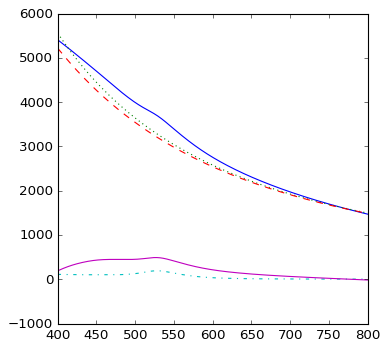

    525.94 ,	 [526.0, 490.43, 164.0, 1.42] 	 (-1.90, 3203.595)	 3.259 	 (-1.82, 3117.81) 	 0.437
	* Warning *: large scattering cross section:  [ 526.     507.244  165.       1.422]


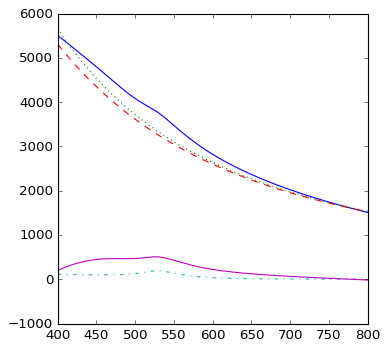

    525.68 ,	 [526.0, 507.24, 165.0, 1.42] 	 (-1.88, 3272.765)	 3.371 	 (-1.81, 3183.96) 	 0.439
	* Warning *: large scattering cross section:  [ 526.     524.605  166.       1.422]


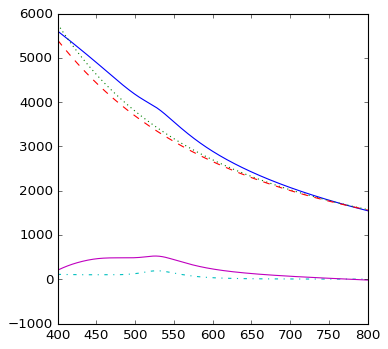

    525.44 ,	 [526.0, 524.61, 166.0, 1.42] 	 (-1.87, 3342.752)	 3.487 	 (-1.80, 3250.81) 	 0.443
	* Warning *: large scattering cross section:  [ 525.     605.138  170.       1.422]


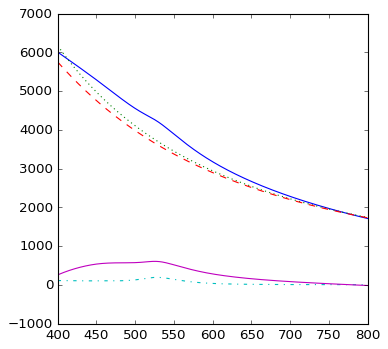

    524.47 ,	 [525.0, 605.14, 170.0, 1.42] 	 (-1.83, 3626.142)	 4.015 	 (-1.75, 3519.63) 	 0.452
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 822.369]) 180.0 1.4221058963738433]


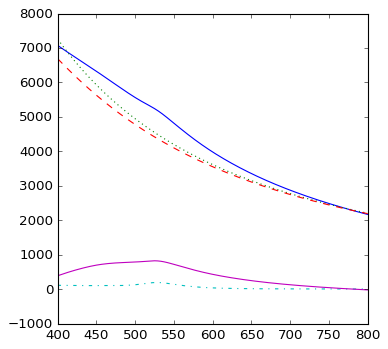

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 1198.365]) 200.0 1.4221058963738433]


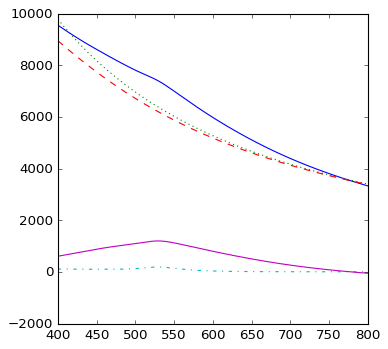

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 1317.704]) 210.0 1.4221058963738433]


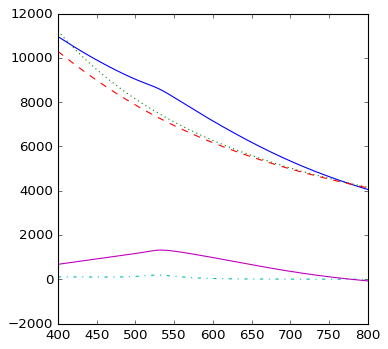

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 1367.246]) 217.0 1.4221058963738433]


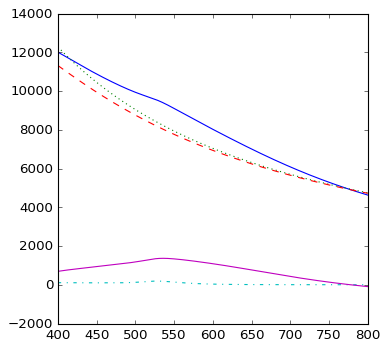

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 1372.21]) 218.0 1.4221058963738433]


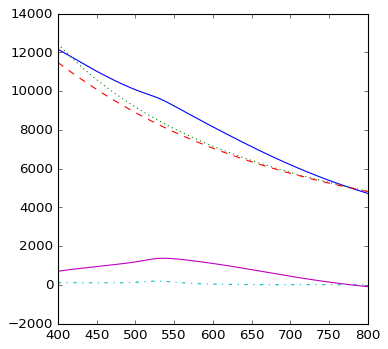

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 1376.657]) 219.0 1.4221058963738433]


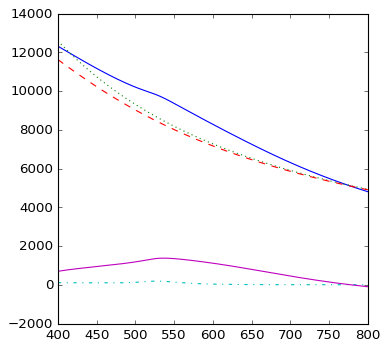

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 540.]) array([ 1397.775]) 230.0 1.4221058963738433]


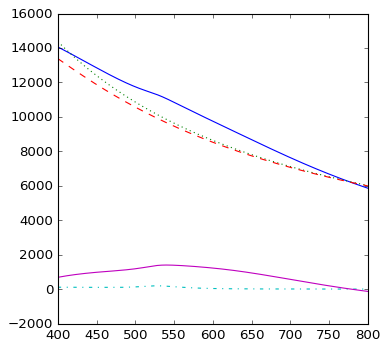

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 535.]) array([ 1340.701]) 260.0 1.4221058963738433]


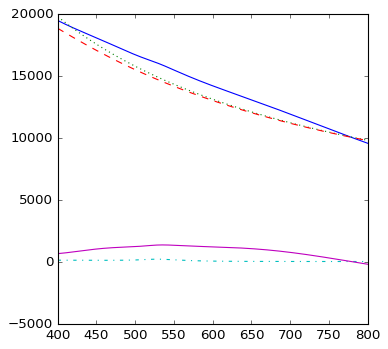

    526.59 ,	 [527.0, 178.73, 11.0, 1.43] 	 (-5.31, 24.240)	 1.190 	 (0.00, 1.00) 	 1.076
    527.53 ,	 [528.0, 186.67, 14.0, 1.43] 	 (-5.27, 25.131)	 1.245 	 (0.00, 1.00) 	 1.094
    527.7 ,	 [528.0, 188.21, 15.0, 1.43] 	 (-5.26, 25.318)	 1.255 	 (0.00, 1.00) 	 1.097
    527.83 ,	 [528.0, 189.44, 16.0, 1.43] 	 (-5.26, 25.478)	 1.264 	 (0.00, 1.00) 	 1.099
    527.93 ,	 [528.0, 190.45, 17.0, 1.43] 	 (-5.25, 25.621)	 1.270 	 (0.00, 1.00) 	 1.100
    528.14 ,	 [528.0, 192.63, 20.0, 1.43] 	 (-5.24, 26.008)	 1.285 	 (0.00, 1.00) 	 1.100
    528.19 ,	 [528.0, 193.19, 21.0, 1.43] 	 (-5.23, 26.137)	 1.288 	 (0.00, 1.00) 	 1.100
    528.23 ,	 [528.0, 193.7, 22.0, 1.43] 	 (-5.23, 26.272)	 1.292 	 (0.00, 1.00) 	 1.098
    528.26 ,	 [528.0, 194.17, 23.0, 1.43] 	 (-5.23, 26.414)	 1.295 	 (0.00, 1.00) 	 1.097
    528.29 ,	 [528.0, 194.6, 24.0, 1.43] 	 (-5.22, 26.568)	 1.298 	 (0.00, 1.00) 	 1.095
    528.34 ,	 [528.0, 195.41, 26.0, 1.43] 	 (-5.21, 26.919)	 1.303 	 (0.00, 1.00) 	 1.090
    528.44 ,	

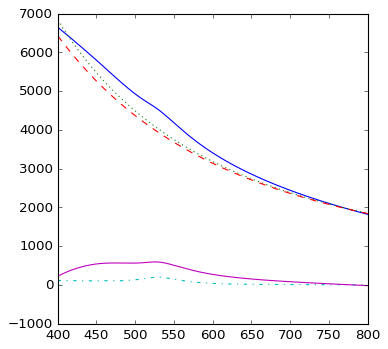

    525.03 ,	 [526.0, 590.73, 164.0, 1.43] 	 (-1.89, 3949.365)	 3.927 	 (-1.82, 3846.03) 	 0.439
	* Warning *: large scattering cross section:  [ 525.     619.271  165.       1.432]


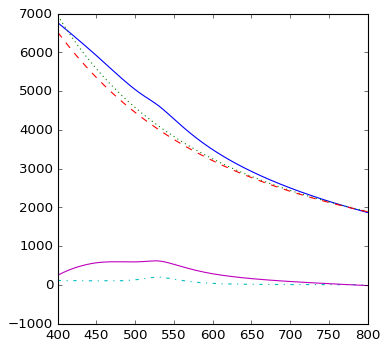

    524.54 ,	 [525.0, 619.27, 165.0, 1.43] 	 (-1.87, 4029.234)	 4.109 	 (-1.80, 3920.81) 	 0.442
	* Warning *: large scattering cross section:  [ 525.     642.126  166.       1.432]


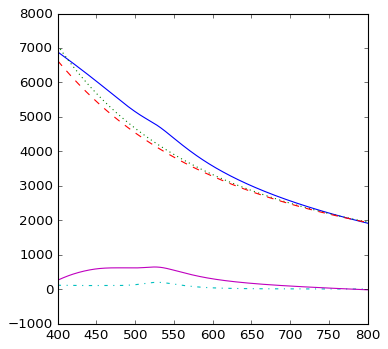

    524.25 ,	 [525.0, 642.13, 166.0, 1.43] 	 (-1.86, 4115.214)	 4.261 	 (-1.79, 4002.67) 	 0.444
	* Warning *: large scattering cross section:  [ 524.     739.174  170.       1.432]


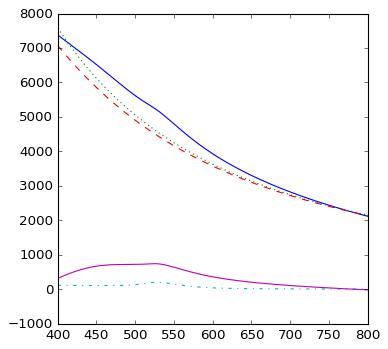

    523.27 ,	 [524.0, 739.17, 170.0, 1.43] 	 (-1.82, 4469.480)	 4.896 	 (-1.74, 4339.38) 	 0.454
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 1012.189]) 180.0 1.4321058963738433]


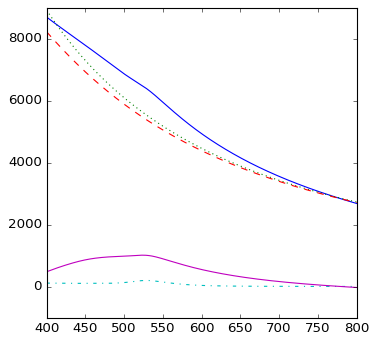

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 1460.896]) 200.0 1.4321058963738433]


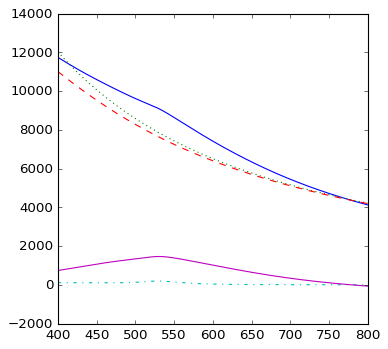

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 535.]) array([ 1596.323]) 210.0 1.4321058963738433]


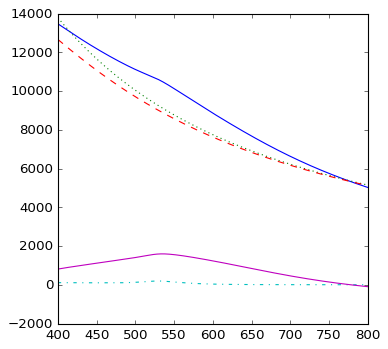

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 538.]) array([ 1650.414]) 217.0 1.4321058963738433]


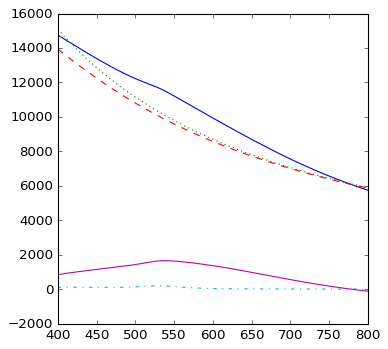

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 538.]) array([ 1655.631]) 218.0 1.4321058963738433]


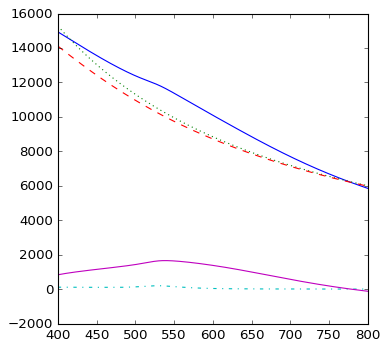

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 1660.362]) 219.0 1.4321058963738433]


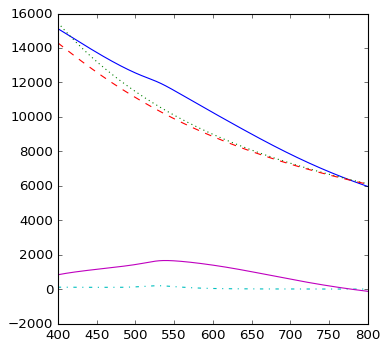

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 543.]) array([ 1678.085]) 230.0 1.4321058963738433]


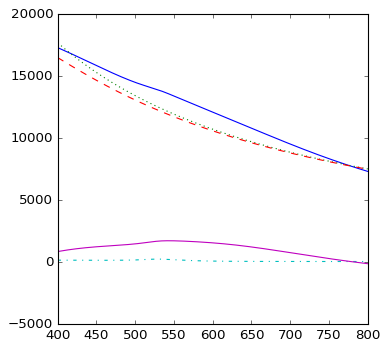

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 1608.912]) 260.0 1.4321058963738433]


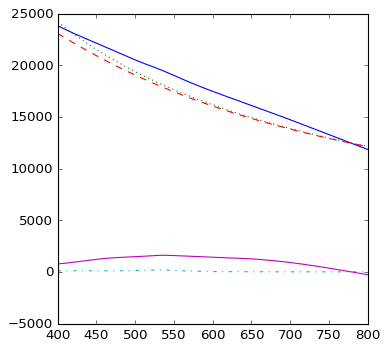

    526.94 ,	 [527.0, 181.51, 11.0, 1.44] 	 (-5.29, 24.526)	 1.209 	 (0.00, 1.00) 	 1.084
    527.98 ,	 [528.0, 190.31, 14.0, 1.44] 	 (-5.25, 25.512)	 1.269 	 (0.00, 1.00) 	 1.104
    528.17 ,	 [528.0, 192.0, 15.0, 1.44] 	 (-5.24, 25.719)	 1.280 	 (0.00, 1.00) 	 1.107
    528.32 ,	 [528.0, 193.34, 16.0, 1.44] 	 (-5.24, 25.898)	 1.289 	 (0.00, 1.00) 	 1.109
    528.43 ,	 [528.0, 194.44, 17.0, 1.44] 	 (-5.23, 26.057)	 1.297 	 (0.00, 1.00) 	 1.110
    528.68 ,	 [529.0, 196.89, 20.0, 1.44] 	 (-5.22, 26.491)	 1.315 	 (0.00, 1.00) 	 1.111
    528.74 ,	 [529.0, 197.52, 21.0, 1.44] 	 (-5.21, 26.637)	 1.320 	 (0.00, 1.00) 	 1.110
    528.78 ,	 [529.0, 198.09, 22.0, 1.44] 	 (-5.21, 26.789)	 1.323 	 (0.00, 1.00) 	 1.108
    528.82 ,	 [529.0, 198.62, 23.0, 1.44] 	 (-5.20, 26.952)	 1.327 	 (0.00, 1.00) 	 1.106
    528.85 ,	 [529.0, 199.11, 24.0, 1.44] 	 (-5.20, 27.127)	 1.330 	 (0.00, 1.00) 	 1.104
    528.91 ,	 [529.0, 200.03, 26.0, 1.44] 	 (-5.18, 27.530)	 1.336 	 (0.00, 1.00) 	 1.098
    529.02 

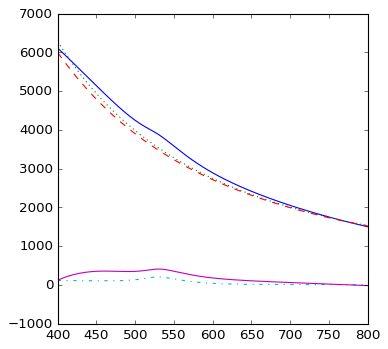

    529.85 ,	 [530.0, 406.29, 150.0, 1.44] 	 (-2.04, 3467.728)	 2.718 	 (-1.99, 3397.46) 	 0.403
	* Warning *: large scattering cross section:  [ 524.     718.45   164.       1.442]


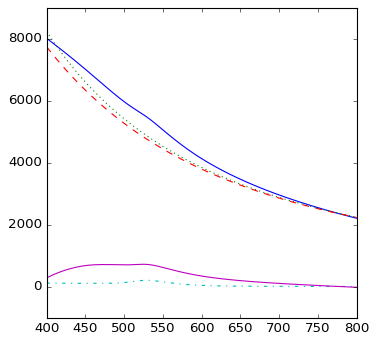

    523.39 ,	 [524.0, 718.45, 164.0, 1.44] 	 (-1.88, 4767.483)	 4.758 	 (-1.81, 4641.86) 	 0.442
	* Warning *: large scattering cross section:  [ 524.     746.751  165.       1.442]


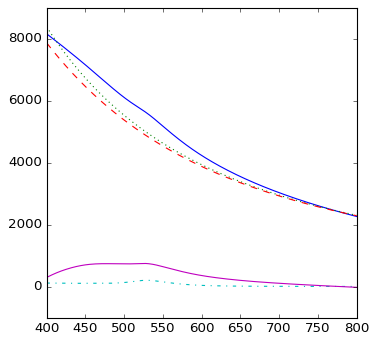

    523.01 ,	 [524.0, 746.75, 165.0, 1.44] 	 (-1.87, 4869.980)	 4.946 	 (-1.79, 4739.29) 	 0.444
	* Warning *: large scattering cross section:  [ 524.     775.746  166.       1.442]


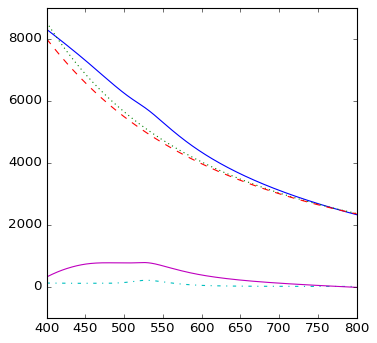

    522.68 ,	 [524.0, 775.75, 166.0, 1.44] 	 (-1.86, 4973.707)	 5.138 	 (-1.78, 4837.81) 	 0.447
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 897.767]) 170.0 1.4421058963738433]


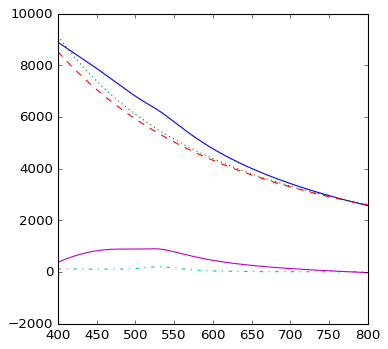

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 1231.514]) 180.0 1.4421058963738433]


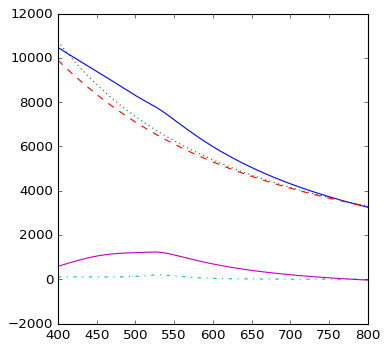

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 1753.394]) 200.0 1.4421058963738433]


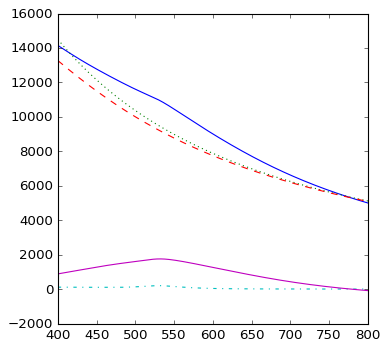

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 1903.394]) 210.0 1.4421058963738433]


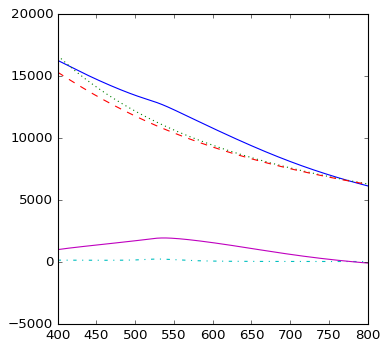

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 540.]) array([ 1960.984]) 217.0 1.4421058963738433]


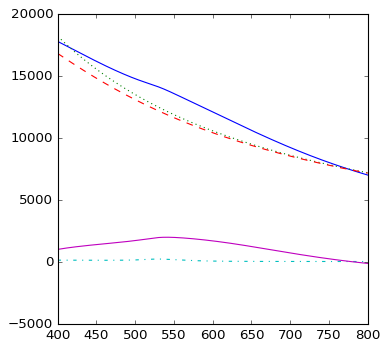

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 541.]) array([ 1966.443]) 218.0 1.4421058963738433]


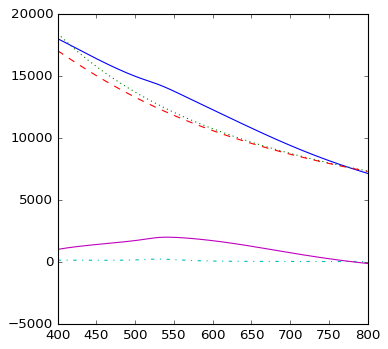

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 541.]) array([ 1971.186]) 219.0 1.4421058963738433]


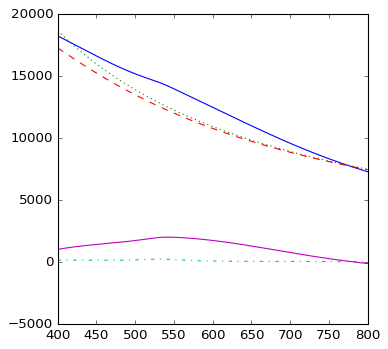

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 2007.284]) 230.0 1.4421058963738433]


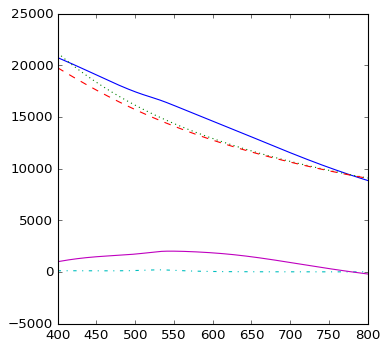

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 1903.565]) 260.0 1.4421058963738433]


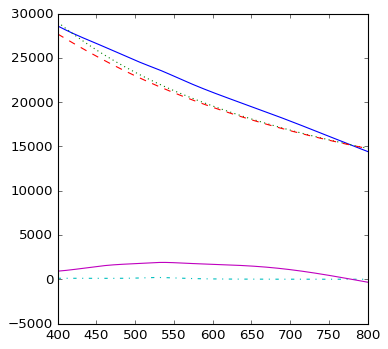

    527.28 ,	 [527.0, 184.23, 11.0, 1.45] 	 (-5.28, 24.810)	 1.227 	 (0.00, 1.00) 	 1.091
    528.44 ,	 [528.0, 193.88, 14.0, 1.45] 	 (-5.23, 25.891)	 1.293 	 (0.00, 1.00) 	 1.114
    528.67 ,	 [529.0, 195.75, 15.0, 1.45] 	 (-5.22, 26.120)	 1.308 	 (0.00, 1.00) 	 1.117
    528.83 ,	 [529.0, 197.26, 16.0, 1.45] 	 (-5.22, 26.316)	 1.318 	 (0.00, 1.00) 	 1.120
    528.96 ,	 [529.0, 198.5, 17.0, 1.45] 	 (-5.21, 26.492)	 1.326 	 (0.00, 1.00) 	 1.121
    529.22 ,	 [529.0, 201.19, 20.0, 1.45] 	 (-5.19, 26.975)	 1.344 	 (0.00, 1.00) 	 1.121
    529.27 ,	 [529.0, 201.87, 21.0, 1.45] 	 (-5.19, 27.137)	 1.348 	 (0.00, 1.00) 	 1.120
    529.32 ,	 [529.0, 202.5, 22.0, 1.45] 	 (-5.18, 27.309)	 1.353 	 (0.00, 1.00) 	 1.118
    529.37 ,	 [529.0, 203.07, 23.0, 1.45] 	 (-5.18, 27.492)	 1.356 	 (0.00, 1.00) 	 1.116
    529.4 ,	 [529.0, 203.61, 24.0, 1.45] 	 (-5.17, 27.690)	 1.360 	 (0.00, 1.00) 	 1.113
    529.47 ,	 [529.0, 204.61, 26.0, 1.45] 	 (-5.16, 28.148)	 1.367 	 (0.00, 1.00) 	 1.107
    529.6 ,	 

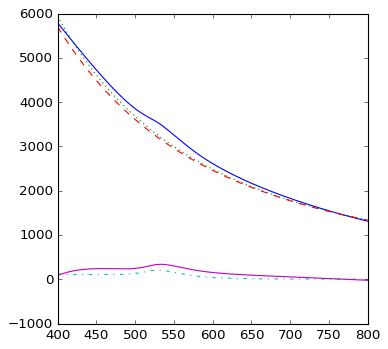

    533.41 ,	 [533.0, 337.85, 140.0, 1.45] 	 (-2.15, 3179.262)	 2.270 	 (-2.10, 3121.22) 	 0.383
	* Warning *: large scattering cross section:  [ 530.     464.18   150.       1.452]


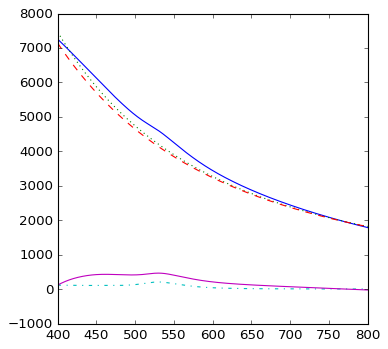

    529.57 ,	 [530.0, 464.18, 150.0, 1.45] 	 (-2.04, 4127.726)	 3.105 	 (-1.99, 4047.43) 	 0.403
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 862.258]) 164.0 1.4521058963738434]


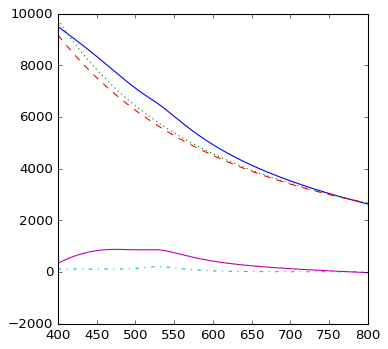

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 897.557]) 165.0 1.4521058963738434]


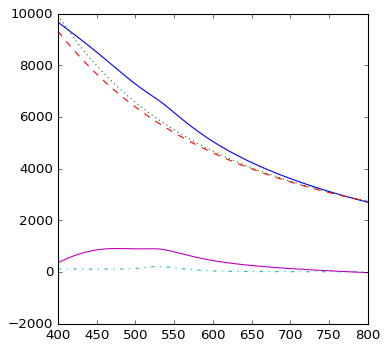

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 933.574]) 166.0 1.4521058963738434]


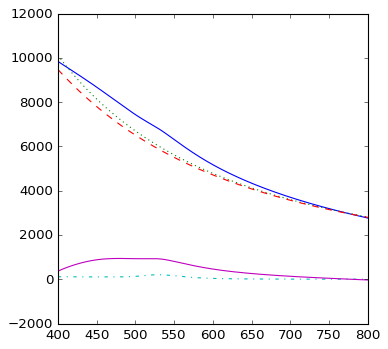

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 1093.831]) 170.0 1.4521058963738434]


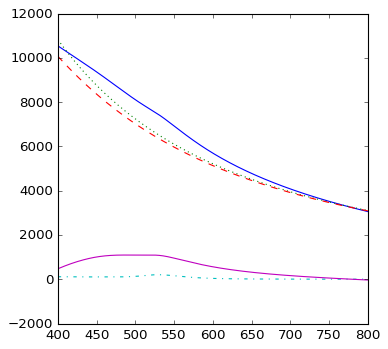

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 1481.538]) 180.0 1.4521058963738434]


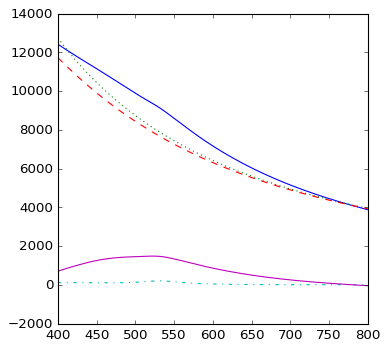

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 2075.306]) 200.0 1.4521058963738434]


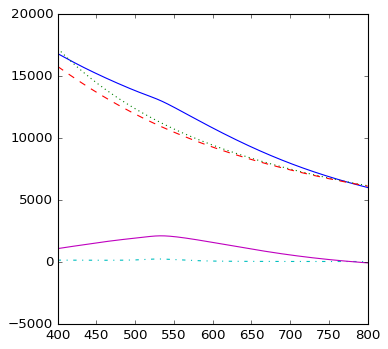

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 2238.275]) 210.0 1.4521058963738434]


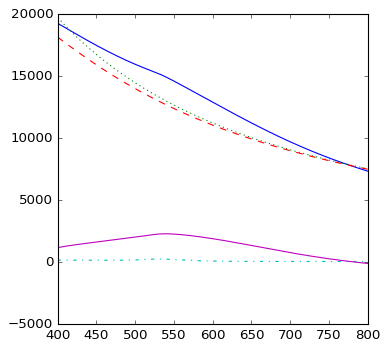

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 543.]) array([ 2298.352]) 217.0 1.4521058963738434]


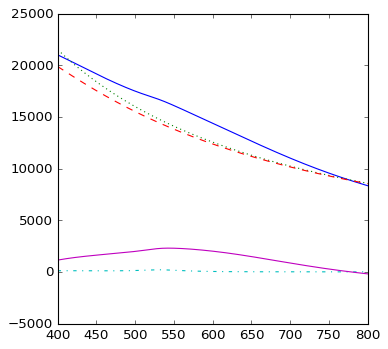

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 2301.531]) 218.0 1.4521058963738434]


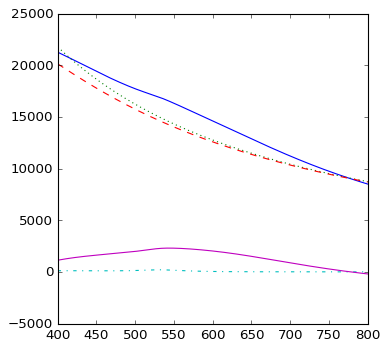

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 2306.347]) 219.0 1.4521058963738434]


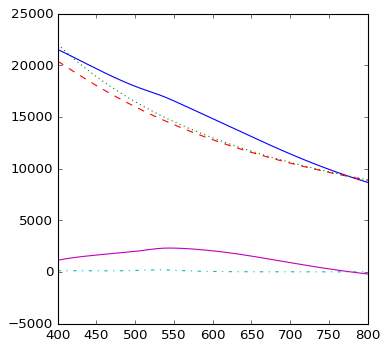

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 549.]) array([ 2342.897]) 230.0 1.4521058963738434]


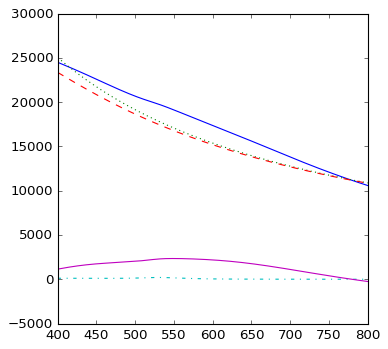

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 2255.334]) 260.0 1.4521058963738434]


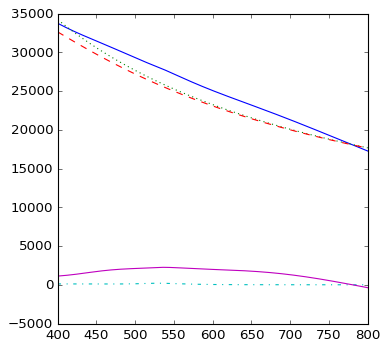

    527.65 ,	 [528.0, 186.93, 11.0, 1.46] 	 (-5.26, 25.092)	 1.247 	 (0.00, 1.00) 	 1.099
    528.92 ,	 [529.0, 197.51, 14.0, 1.46] 	 (-5.21, 26.269)	 1.319 	 (0.00, 1.00) 	 1.124
    529.15 ,	 [529.0, 199.55, 15.0, 1.46] 	 (-5.20, 26.518)	 1.333 	 (0.00, 1.00) 	 1.127
    529.33 ,	 [529.0, 201.16, 16.0, 1.46] 	 (-5.20, 26.733)	 1.344 	 (0.00, 1.00) 	 1.130
    529.47 ,	 [529.0, 202.49, 17.0, 1.46] 	 (-5.19, 26.927)	 1.352 	 (0.00, 1.00) 	 1.131
    529.78 ,	 [530.0, 205.46, 20.0, 1.46] 	 (-5.17, 27.458)	 1.375 	 (0.00, 1.00) 	 1.131
    529.84 ,	 [530.0, 206.23, 21.0, 1.46] 	 (-5.17, 27.639)	 1.380 	 (0.00, 1.00) 	 1.130
    529.89 ,	 [530.0, 206.93, 22.0, 1.46] 	 (-5.16, 27.830)	 1.384 	 (0.00, 1.00) 	 1.128
    529.94 ,	 [530.0, 207.57, 23.0, 1.46] 	 (-5.16, 28.034)	 1.389 	 (0.00, 1.00) 	 1.126
    529.98 ,	 [530.0, 208.17, 24.0, 1.46] 	 (-5.15, 28.257)	 1.393 	 (0.00, 1.00) 	 1.123
    530.05 ,	 [530.0, 209.28, 26.0, 1.46] 	 (-5.13, 28.773)	 1.400 	 (0.00, 1.00) 	 1.115
    530.19

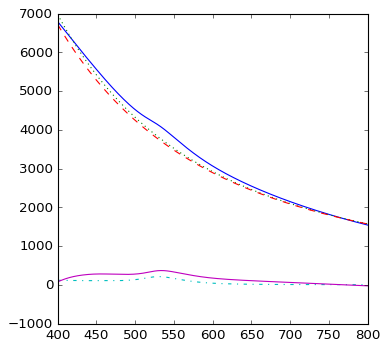

    533.92 ,	 [534.0, 368.01, 140.0, 1.46] 	 (-2.15, 3735.643)	 2.477 	 (-2.10, 3672.37) 	 0.380
	* Warning *: large scattering cross section:  [ 529.     540.98   150.       1.462]


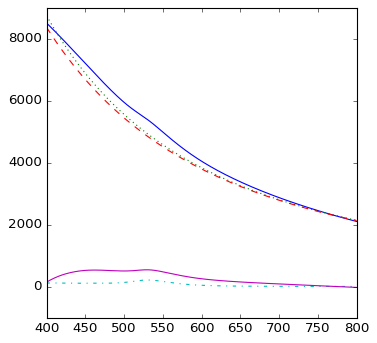

    528.81 ,	 [529.0, 540.98, 150.0, 1.46] 	 (-2.03, 4839.114)	 3.613 	 (-1.98, 4745.55) 	 0.404
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 519.]) array([ 1031.709]) 164.0 1.4621058963738434]


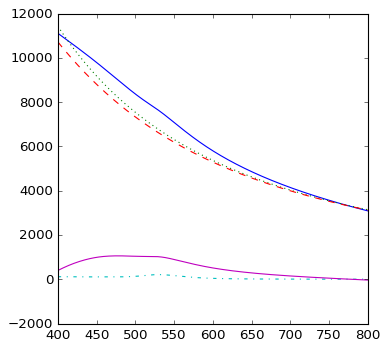

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 518.]) array([ 1072.981]) 165.0 1.4621058963738434]


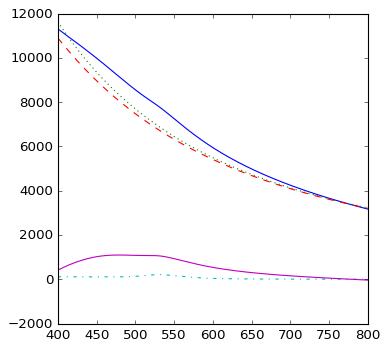

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 1106.428]) 166.0 1.4621058963738434]


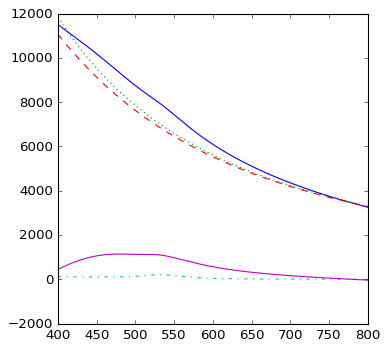

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 1296.431]) 170.0 1.4621058963738434]


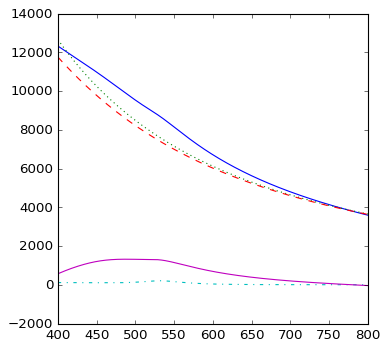

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 1762.878]) 180.0 1.4621058963738434]


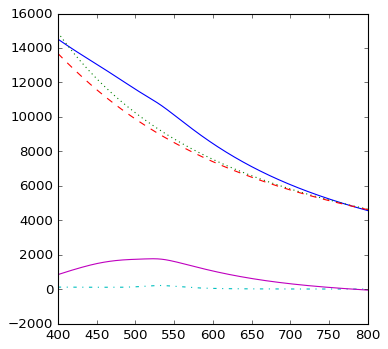

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 535.]) array([ 2426.218]) 200.0 1.4621058963738434]


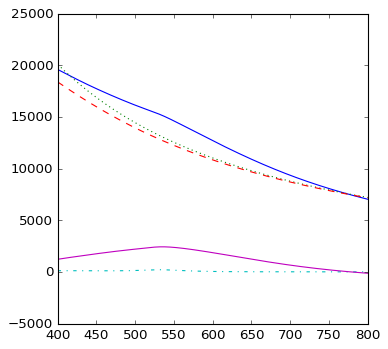

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 541.]) array([ 2600.218]) 210.0 1.4621058963738434]


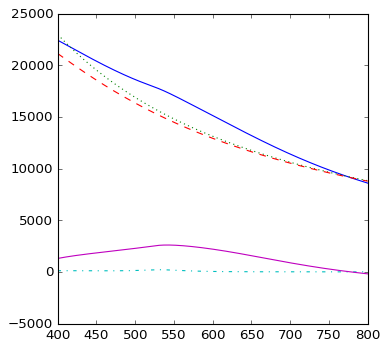

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 2685.992]) 217.0 1.4621058963738434]


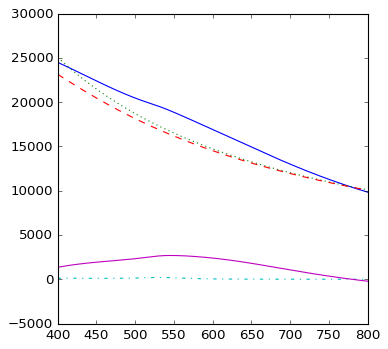

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 2691.682]) 218.0 1.4621058963738434]


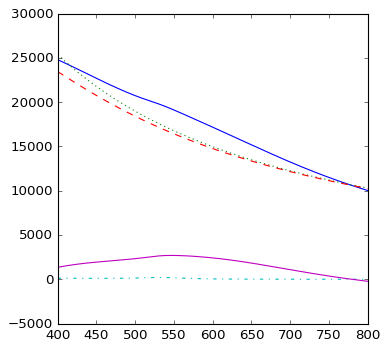

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 2696.591]) 219.0 1.4621058963738434]


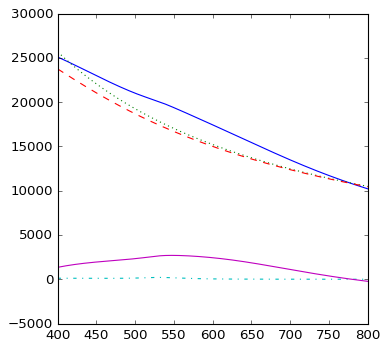

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 551.]) array([ 2702.104]) 230.0 1.4621058963738434]


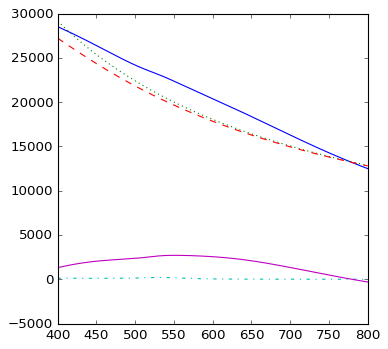

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 2609.065]) 260.0 1.4621058963738434]


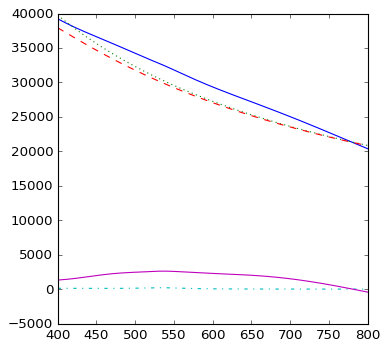

    528.0 ,	 [528.0, 189.66, 11.0, 1.47] 	 (-5.25, 25.372)	 1.265 	 (0.00, 1.00) 	 1.107
    529.39 ,	 [529.0, 201.08, 14.0, 1.47] 	 (-5.19, 26.645)	 1.343 	 (0.00, 1.00) 	 1.133
    529.66 ,	 [530.0, 203.28, 15.0, 1.47] 	 (-5.18, 26.915)	 1.360 	 (0.00, 1.00) 	 1.138
    529.86 ,	 [530.0, 205.08, 16.0, 1.47] 	 (-5.17, 27.149)	 1.372 	 (0.00, 1.00) 	 1.140
    530.01 ,	 [530.0, 206.55, 17.0, 1.47] 	 (-5.17, 27.360)	 1.382 	 (0.00, 1.00) 	 1.142
    530.33 ,	 [530.0, 209.75, 20.0, 1.47] 	 (-5.15, 27.942)	 1.403 	 (0.00, 1.00) 	 1.141
    530.4 ,	 [530.0, 210.57, 21.0, 1.47] 	 (-5.14, 28.142)	 1.409 	 (0.00, 1.00) 	 1.140
    530.46 ,	 [530.0, 211.31, 22.0, 1.47] 	 (-5.14, 28.352)	 1.414 	 (0.00, 1.00) 	 1.138
    530.51 ,	 [530.0, 212.0, 23.0, 1.47] 	 (-5.13, 28.579)	 1.418 	 (0.00, 1.00) 	 1.135
    530.57 ,	 [531.0, 212.65, 24.0, 1.47] 	 (-5.12, 28.827)	 1.425 	 (0.00, 1.00) 	 1.132
    530.65 ,	 [531.0, 213.88, 26.0, 1.47] 	 (-5.11, 29.403)	 1.433 	 (0.00, 1.00) 	 1.123
    530.8 ,	 

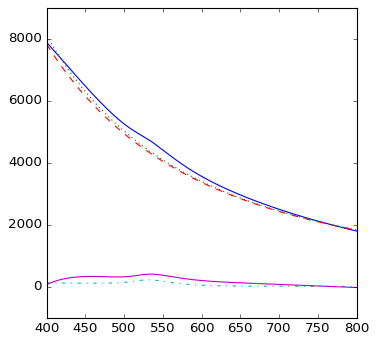

    534.27 ,	 [534.0, 402.0, 140.0, 1.47] 	 (-2.15, 4338.567)	 2.706 	 (-2.11, 4269.41) 	 0.379
	* Warning *: large scattering cross section:  [ 528.     623.185  150.       1.472]


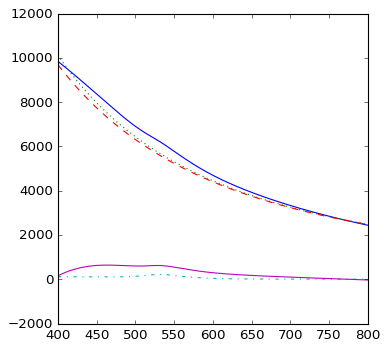

    527.74 ,	 [528.0, 623.19, 150.0, 1.47] 	 (-2.03, 5614.347)	 4.155 	 (-1.98, 5506.60) 	 0.406
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1215.172]) 164.0 1.4721058963738434]


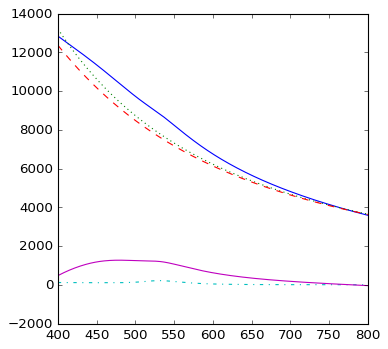

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1278.13]) 165.0 1.4721058963738434]


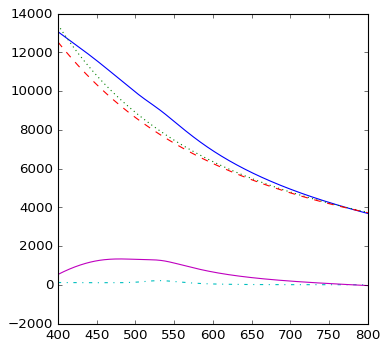

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1329.842]) 166.0 1.4721058963738434]


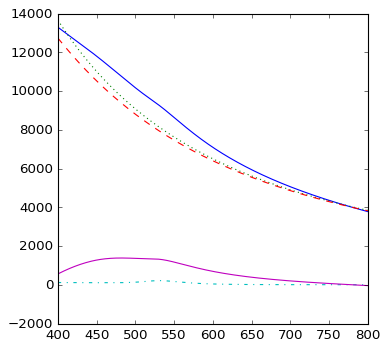

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1542.157]) 170.0 1.4721058963738434]


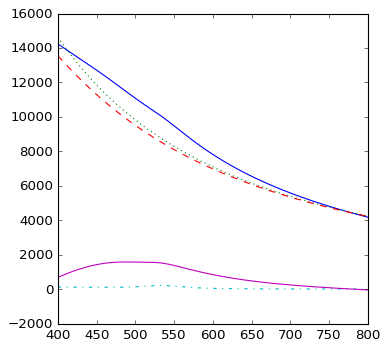

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 2075.925]) 180.0 1.4721058963738434]


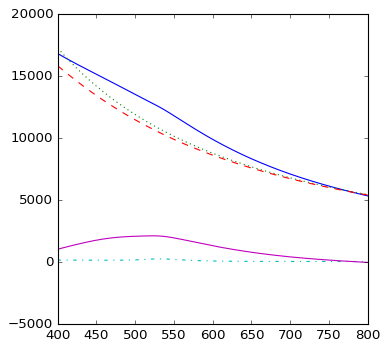

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 2805.382]) 200.0 1.4721058963738434]


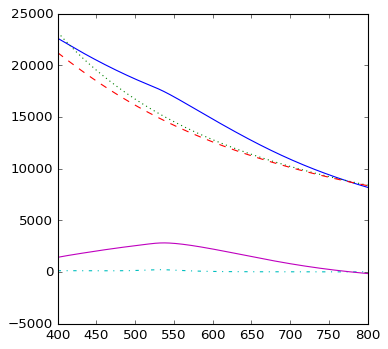

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 3017.596]) 210.0 1.4721058963738434]


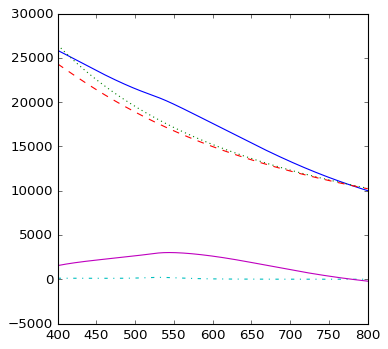

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 549.]) array([ 3078.723]) 217.0 1.4721058963738434]


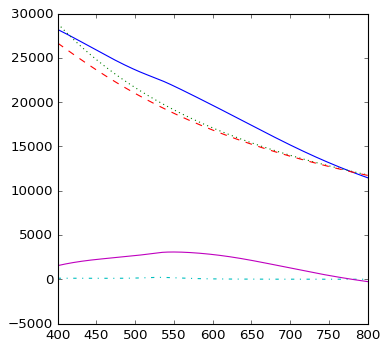

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 549.]) array([ 3083.508]) 218.0 1.4721058963738434]


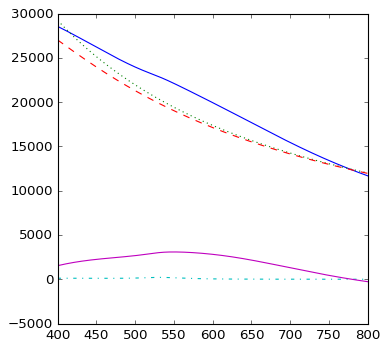

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 550.]) array([ 3087.987]) 219.0 1.4721058963738434]


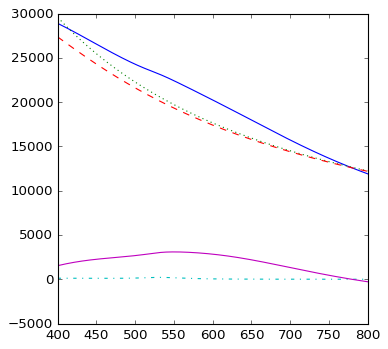

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 2941.353]) 230.0 1.4721058963738434]


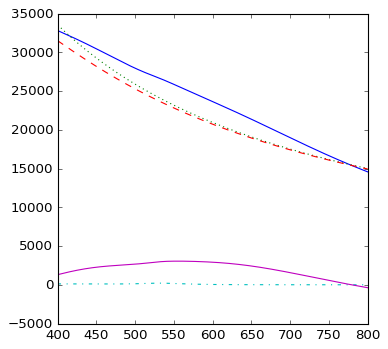

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 2991.212]) 260.0 1.4721058963738434]


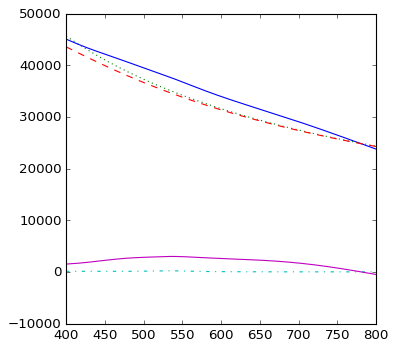

    528.35 ,	 [528.0, 192.33, 11.0, 1.48] 	 (-5.23, 25.649)	 1.283 	 (0.00, 1.00) 	 1.114
    529.88 ,	 [530.0, 204.68, 14.0, 1.48] 	 (-5.17, 27.018)	 1.369 	 (0.00, 1.00) 	 1.143
    530.16 ,	 [530.0, 207.07, 15.0, 1.48] 	 (-5.16, 27.311)	 1.385 	 (0.00, 1.00) 	 1.148
    530.37 ,	 [530.0, 208.96, 16.0, 1.48] 	 (-5.15, 27.563)	 1.398 	 (0.00, 1.00) 	 1.150
    530.56 ,	 [531.0, 210.52, 17.0, 1.48] 	 (-5.15, 27.792)	 1.411 	 (0.00, 1.00) 	 1.152
    530.9 ,	 [531.0, 214.04, 20.0, 1.48] 	 (-5.13, 28.426)	 1.434 	 (0.00, 1.00) 	 1.152
    530.98 ,	 [531.0, 214.94, 21.0, 1.48] 	 (-5.12, 28.644)	 1.440 	 (0.00, 1.00) 	 1.150
    531.05 ,	 [531.0, 215.76, 22.0, 1.48] 	 (-5.12, 28.876)	 1.446 	 (0.00, 1.00) 	 1.148
    531.11 ,	 [531.0, 216.52, 23.0, 1.48] 	 (-5.11, 29.126)	 1.451 	 (0.00, 1.00) 	 1.145
    531.16 ,	 [531.0, 217.23, 24.0, 1.48] 	 (-5.10, 29.400)	 1.456 	 (0.00, 1.00) 	 1.141
    531.24 ,	 [531.0, 218.54, 26.0, 1.48] 	 (-5.08, 30.039)	 1.464 	 (0.00, 1.00) 	 1.131
    531.4 ,

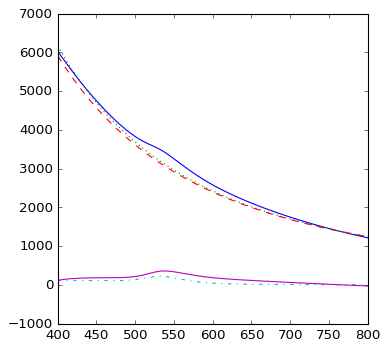

    538.0 ,	 [538.0, 357.53, 125.0, 1.48] 	 (-2.31, 3154.579)	 2.421 	 (-2.26, 3093.71) 	 0.361
	* Warning *: large scattering cross section:  [ 538.     356.35   126.       1.482]


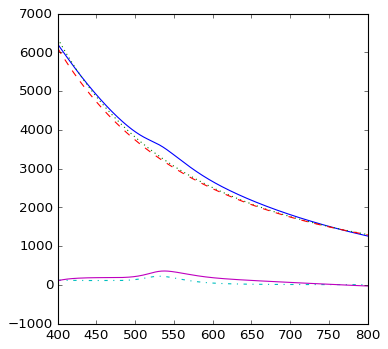

    538.03 ,	 [538.0, 356.35, 126.0, 1.48] 	 (-2.29, 3262.196)	 2.413 	 (-2.25, 3201.47) 	 0.361
	* Warning *: large scattering cross section:  [ 538.     355.483  127.       1.482]


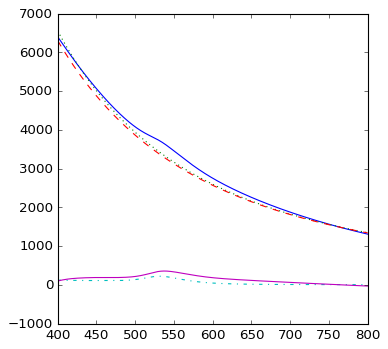

    538.03 ,	 [538.0, 355.48, 127.0, 1.48] 	 (-2.28, 3372.183)	 2.407 	 (-2.24, 3311.55) 	 0.361
	* Warning *: large scattering cross section:  [ 534.     450.551  140.       1.482]


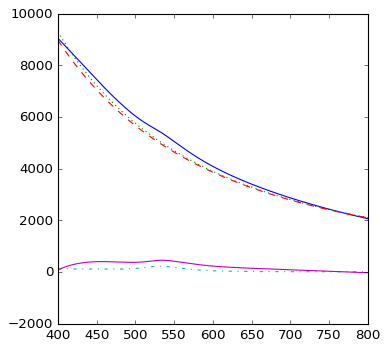

    534.32 ,	 [534.0, 450.55, 140.0, 1.48] 	 (-2.14, 4979.554)	 3.032 	 (-2.11, 4902.01) 	 0.378
	* Warning *: large scattering cross section:  [ 527.     720.212  150.       1.482]


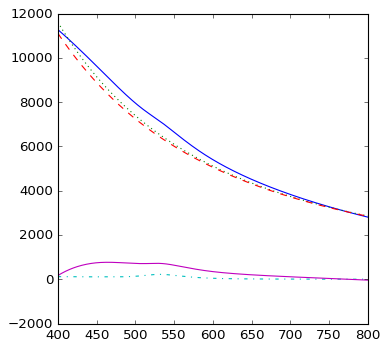

    525.93 ,	 [527.0, 720.21, 150.0, 1.48] 	 (-2.02, 6447.121)	 4.794 	 (-1.97, 6322.74) 	 0.410
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 1455.346]) 164.0 1.4821058963738434]


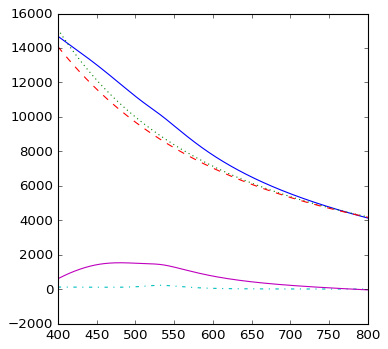

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 1515.527]) 165.0 1.4821058963738434]


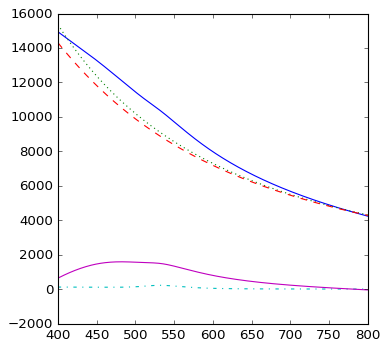

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 1576.351]) 166.0 1.4821058963738434]


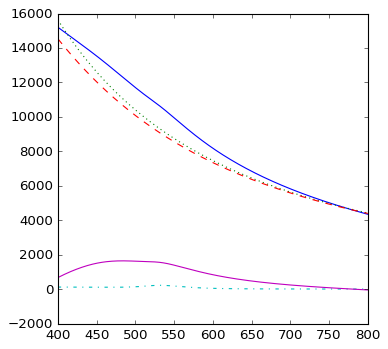

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 1823.342]) 170.0 1.4821058963738434]


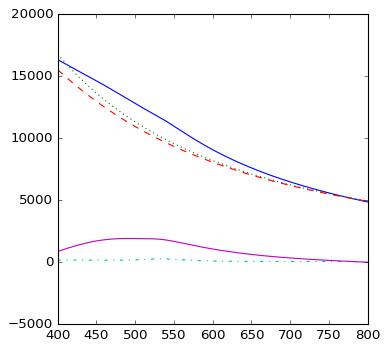

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 2420.594]) 180.0 1.4821058963738434]


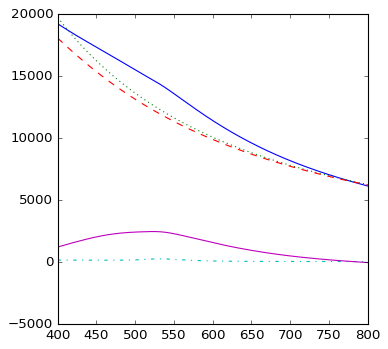

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 3241.213]) 200.0 1.4821058963738434]


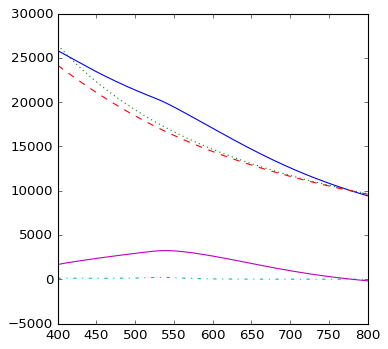

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 3432.755]) 210.0 1.4821058963738434]


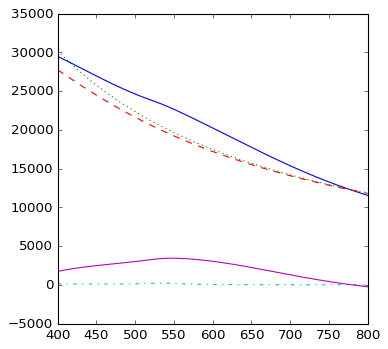

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 552.]) array([ 3495.058]) 217.0 1.4821058963738434]


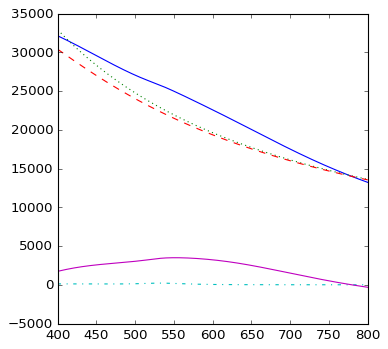

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 552.]) array([ 3499.708]) 218.0 1.4821058963738434]


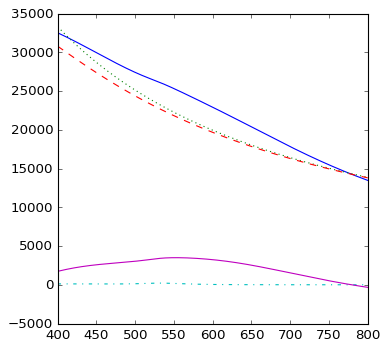

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 553.]) array([ 3502.874]) 219.0 1.4821058963738434]


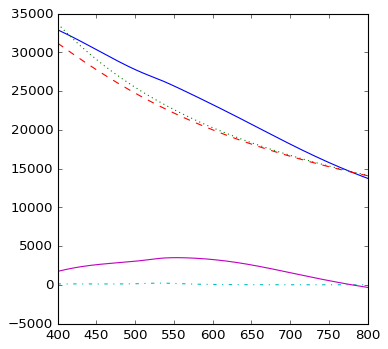

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 3339.127]) 230.0 1.4821058963738434]


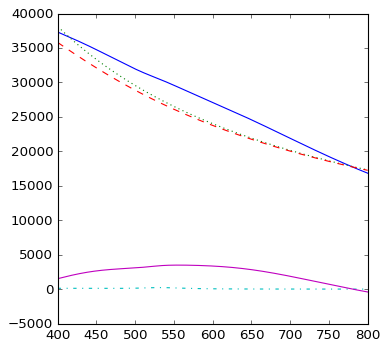

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 3402.61]) 260.0 1.4821058963738434]


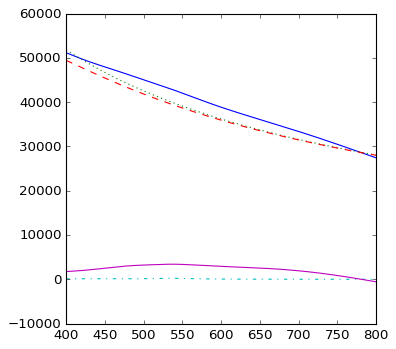

    528.73 ,	 [529.0, 195.01, 11.0, 1.49] 	 (-5.22, 25.923)	 1.303 	 (0.00, 1.00) 	 1.122
    530.36 ,	 [530.0, 208.23, 14.0, 1.49] 	 (-5.16, 27.390)	 1.393 	 (0.00, 1.00) 	 1.153
    530.68 ,	 [531.0, 210.79, 15.0, 1.49] 	 (-5.14, 27.704)	 1.413 	 (0.00, 1.00) 	 1.158
    530.91 ,	 [531.0, 212.87, 16.0, 1.49] 	 (-5.13, 27.976)	 1.426 	 (0.00, 1.00) 	 1.161
    531.1 ,	 [531.0, 214.57, 17.0, 1.49] 	 (-5.13, 28.222)	 1.438 	 (0.00, 1.00) 	 1.163
    531.48 ,	 [531.0, 218.28, 20.0, 1.49] 	 (-5.11, 28.909)	 1.462 	 (0.00, 1.00) 	 1.162
    531.58 ,	 [532.0, 219.24, 21.0, 1.49] 	 (-5.10, 29.147)	 1.472 	 (0.00, 1.00) 	 1.160
    531.65 ,	 [532.0, 220.14, 22.0, 1.49] 	 (-5.09, 29.401)	 1.478 	 (0.00, 1.00) 	 1.157
    531.71 ,	 [532.0, 220.97, 23.0, 1.49] 	 (-5.09, 29.675)	 1.483 	 (0.00, 1.00) 	 1.154
    531.77 ,	 [532.0, 221.74, 24.0, 1.49] 	 (-5.08, 29.975)	 1.488 	 (0.00, 1.00) 	 1.150
    531.86 ,	 [532.0, 223.18, 26.0, 1.49] 	 (-5.06, 30.681)	 1.498 	 (0.00, 1.00) 	 1.139
    532.03 

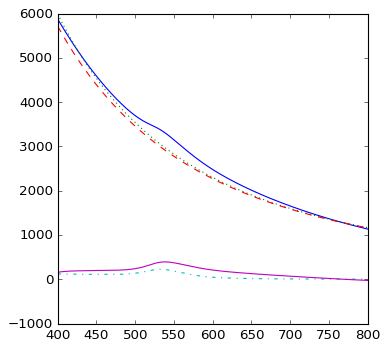

    538.66 ,	 [538.0, 392.7, 120.0, 1.49] 	 (-2.36, 3015.311)	 2.658 	 (-2.31, 2948.72) 	 0.357
	* Warning *: large scattering cross section:  [ 539.     375.07   125.       1.492]


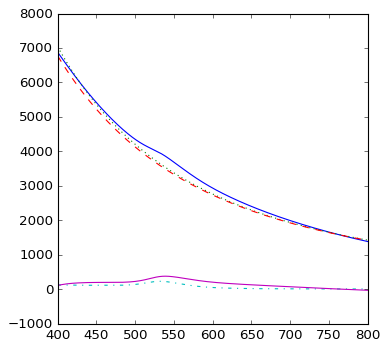

    539.16 ,	 [539.0, 375.07, 125.0, 1.49] 	 (-2.31, 3596.559)	 2.543 	 (-2.26, 3532.63) 	 0.356
	* Warning *: large scattering cross section:  [ 539.     373.884  126.       1.492]


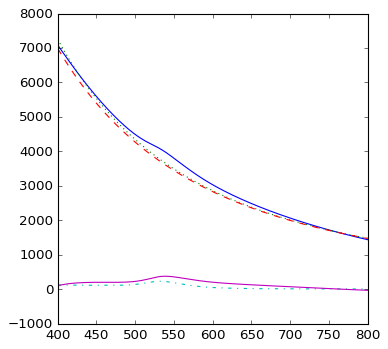

    539.16 ,	 [539.0, 373.88, 126.0, 1.49] 	 (-2.30, 3719.462)	 2.535 	 (-2.25, 3655.67) 	 0.357
	* Warning *: large scattering cross section:  [ 539.     373.145  127.       1.492]


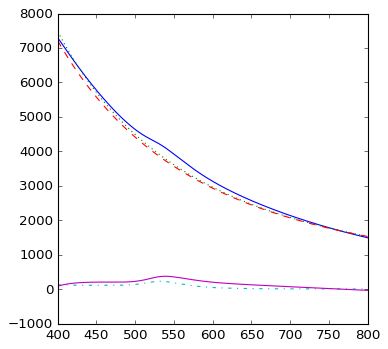

    539.13 ,	 [539.0, 373.14, 127.0, 1.49] 	 (-2.29, 3845.027)	 2.530 	 (-2.25, 3781.31) 	 0.357
	* Warning *: large scattering cross section:  [ 534.     496.534  140.       1.492]


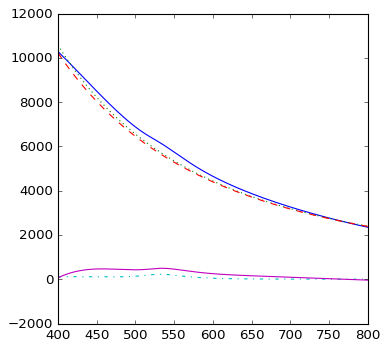

    534.31 ,	 [534.0, 496.53, 140.0, 1.49] 	 (-2.14, 5673.950)	 3.342 	 (-2.11, 5588.47) 	 0.378
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 847.895]) 150.0 1.4921058963738434]


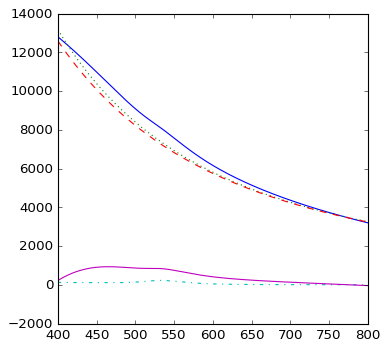

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.4921058963738434]


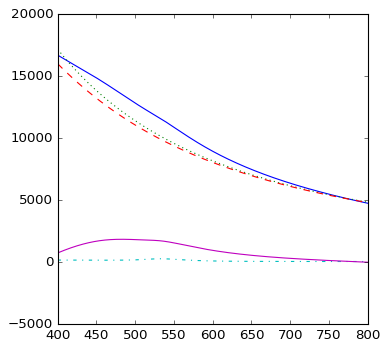

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.4921058963738434]


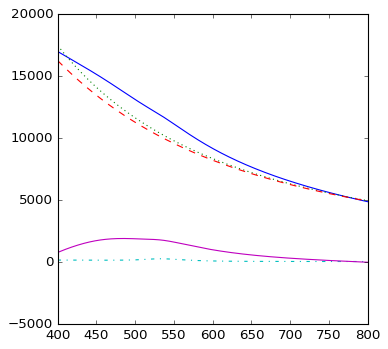

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.4921058963738434]


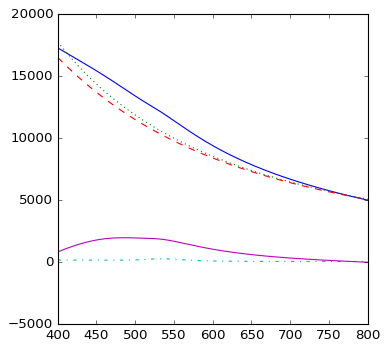

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 2088.701]) 170.0 1.4921058963738434]


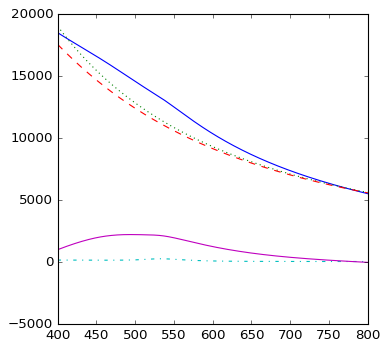

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 2796.634]) 180.0 1.4921058963738434]


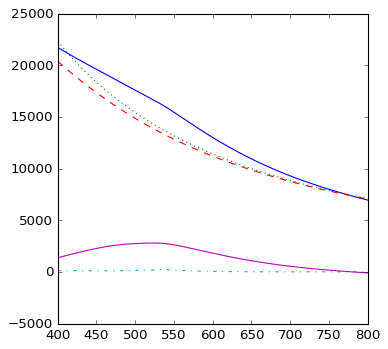

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 541.]) array([ 3679.094]) 200.0 1.4921058963738434]


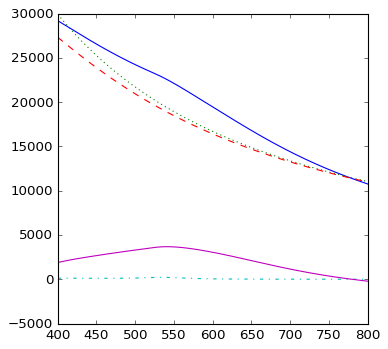

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 549.]) array([ 3875.476]) 210.0 1.4921058963738434]


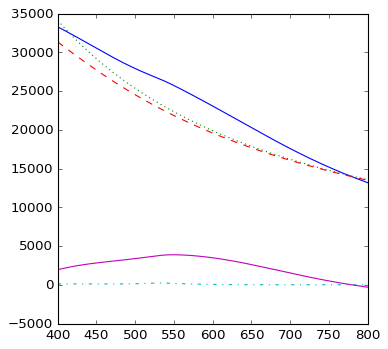

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 3811.804]) 217.0 1.4921058963738434]


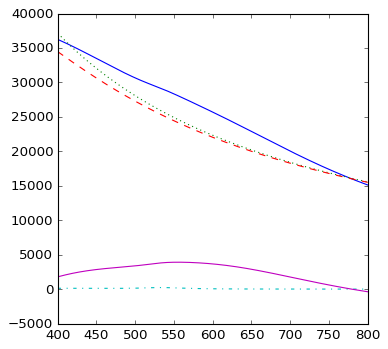

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 3853.658]) 218.0 1.4921058963738434]


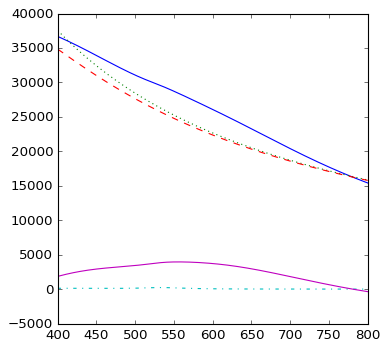

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 3854.19]) 219.0 1.4921058963738434]


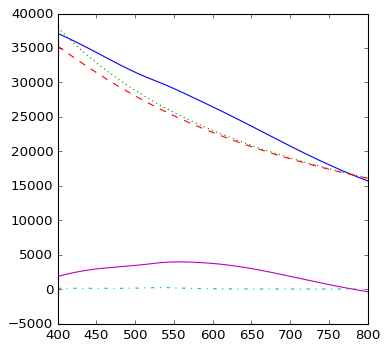

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 3849.667]) 230.0 1.4921058963738434]


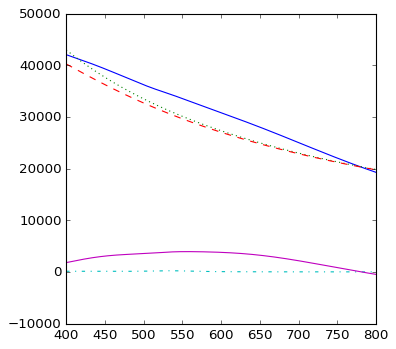

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 3844.228]) 260.0 1.4921058963738434]


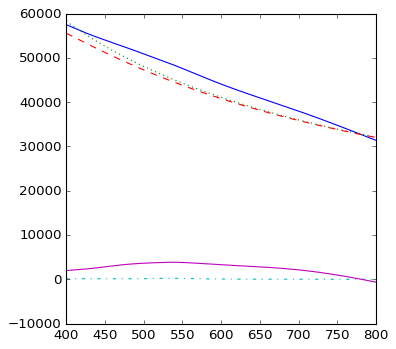

    529.09 ,	 [529.0, 197.69, 11.0, 1.5] 	 (-5.20, 26.196)	 1.321 	 (0.00, 1.00) 	 1.130
    530.87 ,	 [531.0, 211.8, 14.0, 1.5] 	 (-5.14, 27.759)	 1.419 	 (0.00, 1.00) 	 1.163
    531.19 ,	 [531.0, 214.54, 15.0, 1.5] 	 (-5.12, 28.095)	 1.438 	 (0.00, 1.00) 	 1.168
    531.45 ,	 [531.0, 216.71, 16.0, 1.5] 	 (-5.11, 28.386)	 1.452 	 (0.00, 1.00) 	 1.171
    531.67 ,	 [532.0, 218.53, 17.0, 1.5] 	 (-5.11, 28.650)	 1.467 	 (0.00, 1.00) 	 1.173
    532.08 ,	 [532.0, 222.58, 20.0, 1.5] 	 (-5.08, 29.392)	 1.494 	 (0.00, 1.00) 	 1.172
    532.17 ,	 [532.0, 223.62, 21.0, 1.5] 	 (-5.08, 29.650)	 1.501 	 (0.00, 1.00) 	 1.170
    532.25 ,	 [532.0, 224.56, 22.0, 1.5] 	 (-5.07, 29.926)	 1.507 	 (0.00, 1.00) 	 1.167
    532.32 ,	 [532.0, 225.44, 23.0, 1.5] 	 (-5.06, 30.225)	 1.513 	 (0.00, 1.00) 	 1.163
    532.37 ,	 [532.0, 226.25, 24.0, 1.5] 	 (-5.05, 30.553)	 1.518 	 (0.00, 1.00) 	 1.159
    532.47 ,	 [532.0, 227.78, 26.0, 1.5] 	 (-5.03, 31.328)	 1.528 	 (0.00, 1.00) 	 1.147
    532.68 ,	 [533.0, 

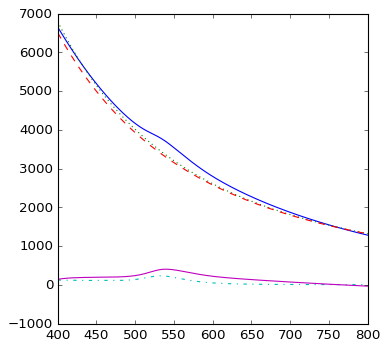

    540.01 ,	 [540.0, 402.98, 120.0, 1.5] 	 (-2.36, 3418.672)	 2.736 	 (-2.31, 3350.23) 	 0.353
	* Warning *: large scattering cross section:  [ 540.     392.413  125.       1.502]


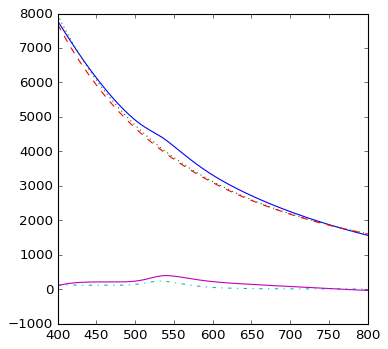

    540.33 ,	 [540.0, 392.41, 125.0, 1.5] 	 (-2.31, 4069.596)	 2.664 	 (-2.27, 4002.63) 	 0.353
	* Warning *: large scattering cross section:  [ 540.     391.343  126.       1.502]


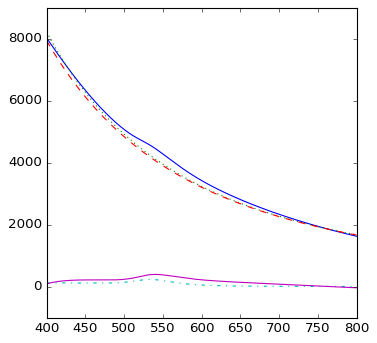

    540.31 ,	 [540.0, 391.34, 126.0, 1.5] 	 (-2.30, 4208.797)	 2.657 	 (-2.26, 4141.96) 	 0.353
	* Warning *: large scattering cross section:  [ 540.     390.887  127.       1.502]


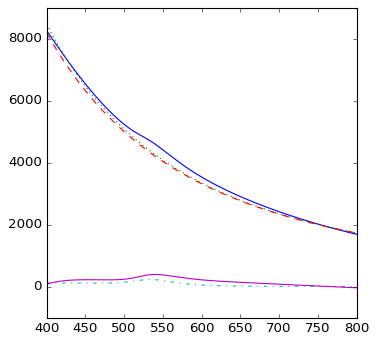

    540.25 ,	 [540.0, 390.89, 127.0, 1.5] 	 (-2.29, 4350.955)	 2.654 	 (-2.25, 4284.13) 	 0.353
	* Warning *: large scattering cross section:  [ 534.     549.667  140.       1.502]


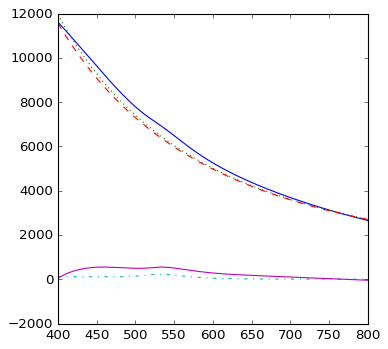

    534.06 ,	 [534.0, 549.67, 140.0, 1.5] 	 (-2.14, 6414.290)	 3.699 	 (-2.10, 6319.66) 	 0.378
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 965.513]) 150.0 1.5021058963738434]


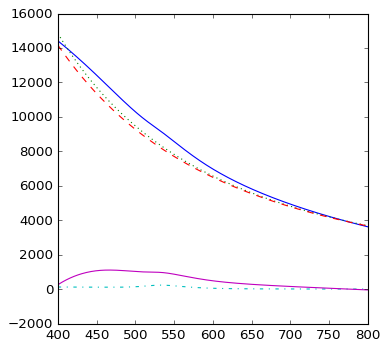

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5021058963738434]


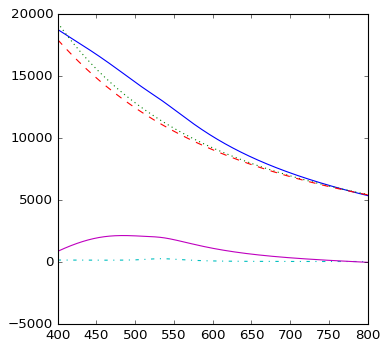

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5021058963738434]


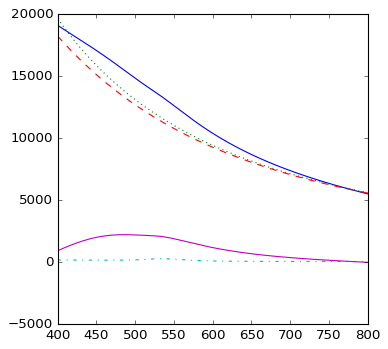

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5021058963738434]


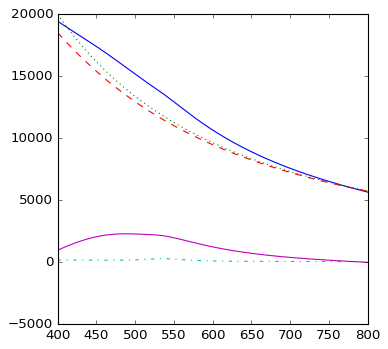

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 2425.723]) 170.0 1.5021058963738434]


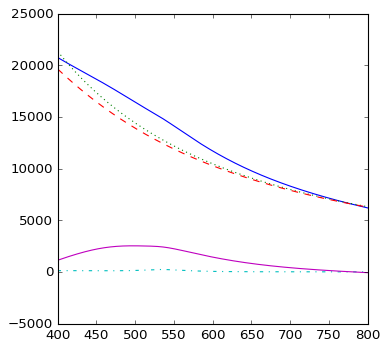

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 3203.62]) 180.0 1.5021058963738434]


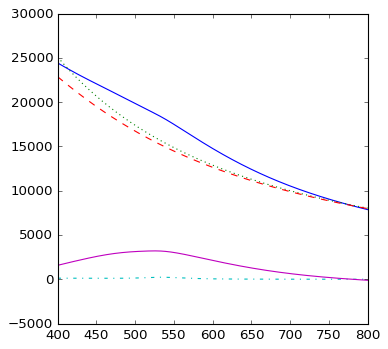

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 543.]) array([ 4143.189]) 200.0 1.5021058963738434]


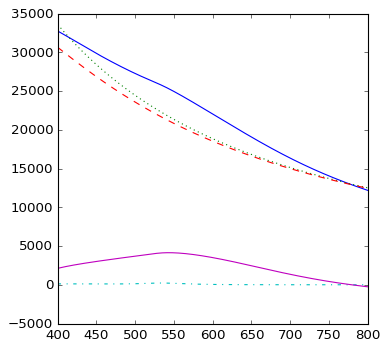

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 552.]) array([ 4341.748]) 210.0 1.5021058963738434]


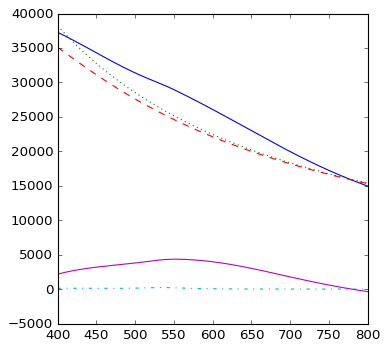

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 4285.562]) 217.0 1.5021058963738434]


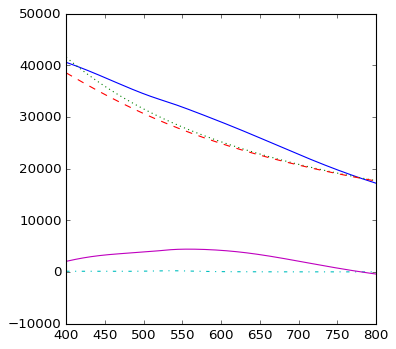

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 4286.349]) 218.0 1.5021058963738434]


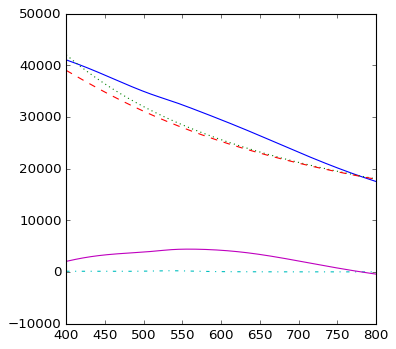

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 4286.836]) 219.0 1.5021058963738434]


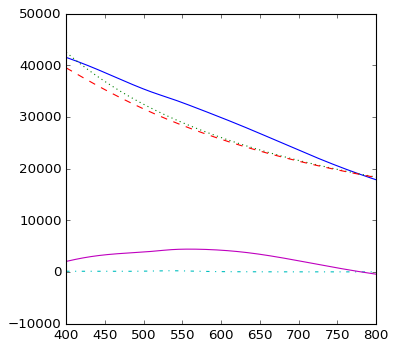

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 4290.73]) 230.0 1.5021058963738434]


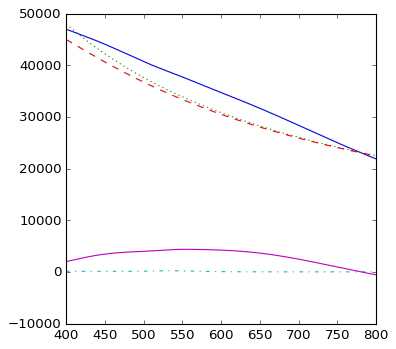

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 538.]) array([ 4317.409]) 260.0 1.5021058963738434]


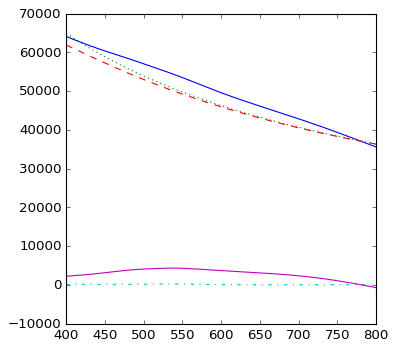

    529.45 ,	 [529.0, 200.31, 11.0, 1.51] 	 (-5.19, 26.465)	 1.338 	 (0.00, 1.00) 	 1.137
    531.36 ,	 [531.0, 215.32, 14.0, 1.51] 	 (-5.12, 28.126)	 1.443 	 (0.00, 1.00) 	 1.173
    531.73 ,	 [532.0, 218.23, 15.0, 1.51] 	 (-5.10, 28.483)	 1.465 	 (0.00, 1.00) 	 1.178
    532.01 ,	 [532.0, 220.6, 16.0, 1.51] 	 (-5.09, 28.795)	 1.480 	 (0.00, 1.00) 	 1.182
    532.23 ,	 [532.0, 222.54, 17.0, 1.51] 	 (-5.09, 29.077)	 1.493 	 (0.00, 1.00) 	 1.183
    532.69 ,	 [533.0, 226.8, 20.0, 1.51] 	 (-5.06, 29.874)	 1.525 	 (0.00, 1.00) 	 1.182
    532.79 ,	 [533.0, 227.93, 21.0, 1.51] 	 (-5.06, 30.153)	 1.532 	 (0.00, 1.00) 	 1.180
    532.87 ,	 [533.0, 228.95, 22.0, 1.51] 	 (-5.05, 30.451)	 1.539 	 (0.00, 1.00) 	 1.177
    532.95 ,	 [533.0, 229.9, 23.0, 1.51] 	 (-5.04, 30.776)	 1.545 	 (0.00, 1.00) 	 1.173
    533.01 ,	 [533.0, 230.79, 24.0, 1.51] 	 (-5.03, 31.134)	 1.551 	 (0.00, 1.00) 	 1.168
    533.12 ,	 [533.0, 232.44, 26.0, 1.51] 	 (-5.01, 31.979)	 1.562 	 (0.00, 1.00) 	 1.155
    533.32 ,	

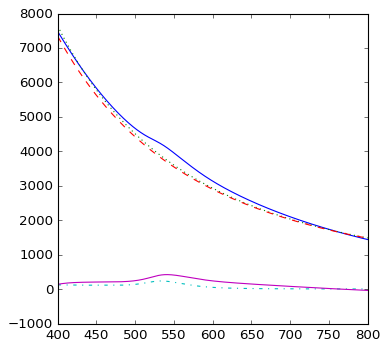

    541.28 ,	 [541.0, 421.04, 120.0, 1.51] 	 (-2.36, 3841.293)	 2.863 	 (-2.32, 3769.71) 	 0.348
	* Warning *: large scattering cross section:  [ 541.     409.625  125.       1.512]


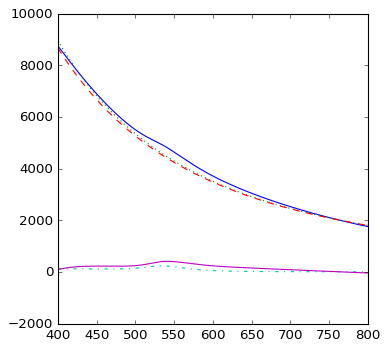

    541.52 ,	 [541.0, 409.62, 125.0, 1.51] 	 (-2.31, 4573.896)	 2.785 	 (-2.28, 4503.91) 	 0.349
	* Warning *: large scattering cross section:  [ 541.     408.835  126.       1.512]


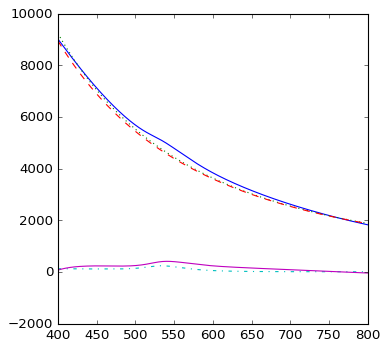

    541.46 ,	 [541.0, 408.84, 126.0, 1.51] 	 (-2.30, 4730.385)	 2.780 	 (-2.27, 4660.48) 	 0.350
	* Warning *: large scattering cross section:  [ 541.     408.864  127.       1.512]


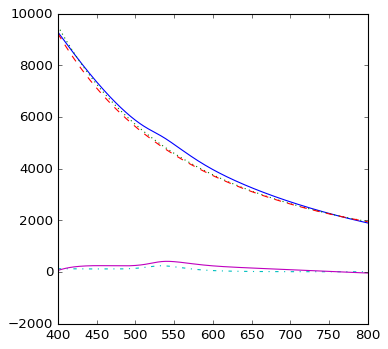

    541.35 ,	 [541.0, 408.86, 127.0, 1.51] 	 (-2.29, 4890.128)	 2.780 	 (-2.26, 4820.16) 	 0.350
	* Warning *: large scattering cross section:  [ 534.     624.75   140.       1.512]


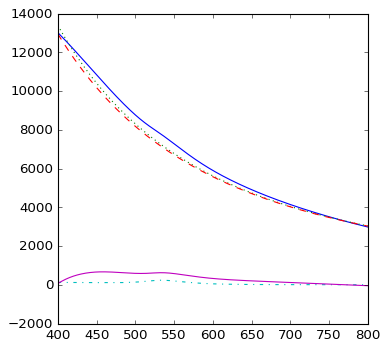

    533.24 ,	 [534.0, 624.75, 140.0, 1.51] 	 (-2.14, 7188.824)	 4.205 	 (-2.10, 7081.30) 	 0.379
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 1120.625]) 150.0 1.5121058963738434]


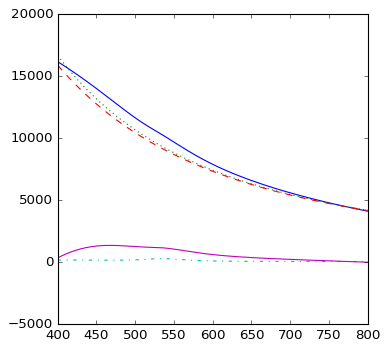

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5121058963738434]


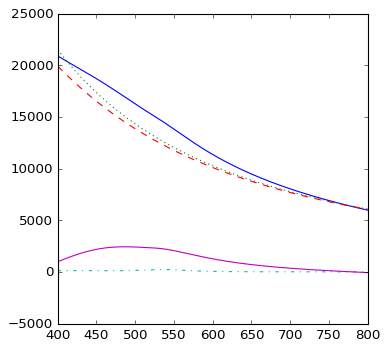

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5121058963738434]


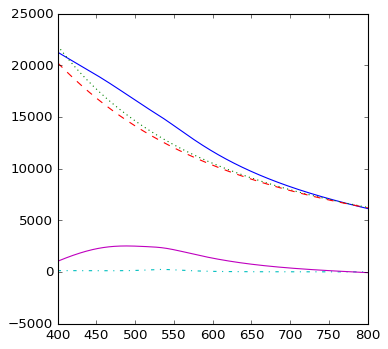

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5121058963738434]


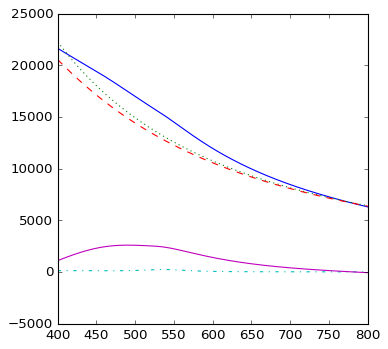

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 2805.329]) 170.0 1.5121058963738434]


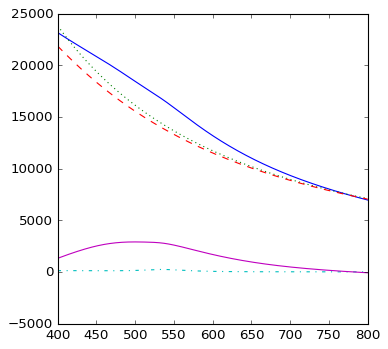

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 527.]) array([ 3641.016]) 180.0 1.5121058963738434]


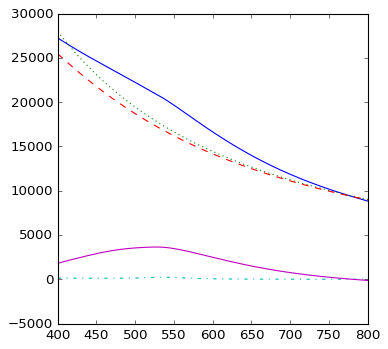

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 4628.46]) 200.0 1.5121058963738434]


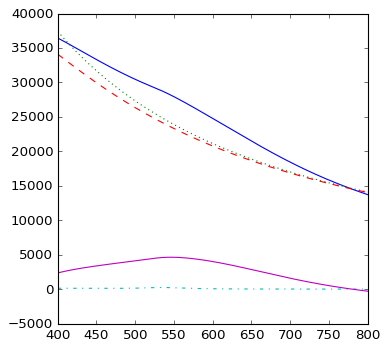

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 4702.887]) 210.0 1.5121058963738434]


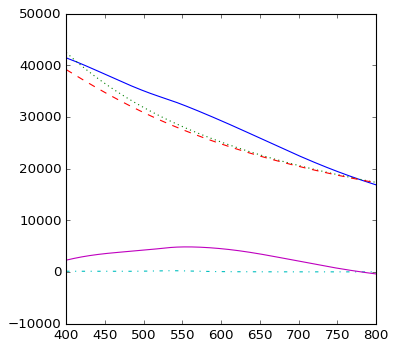

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 4721.833]) 217.0 1.5121058963738434]


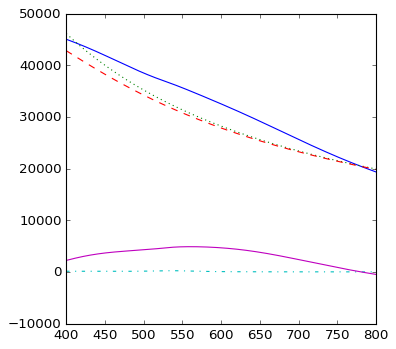

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 4723.06]) 218.0 1.5121058963738434]


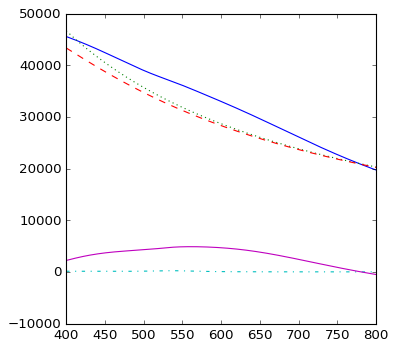

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 4724.188]) 219.0 1.5121058963738434]


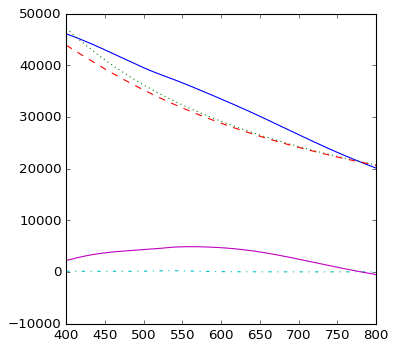

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 553.]) array([ 4856.589]) 230.0 1.5121058963738434]


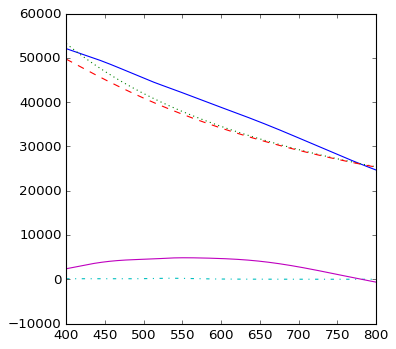

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 4824.005]) 260.0 1.5121058963738434]


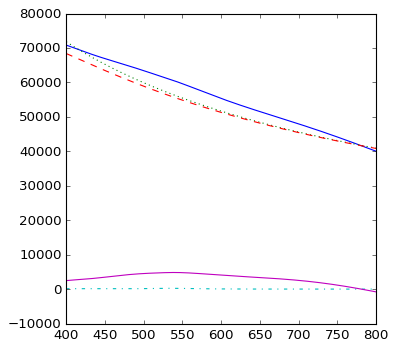

    529.83 ,	 [530.0, 202.96, 11.0, 1.52] 	 (-5.18, 26.732)	 1.358 	 (0.00, 1.00) 	 1.145
    531.88 ,	 [532.0, 218.85, 14.0, 1.52] 	 (-5.10, 28.490)	 1.469 	 (0.00, 1.00) 	 1.183
    532.26 ,	 [532.0, 221.94, 15.0, 1.52] 	 (-5.09, 28.870)	 1.489 	 (0.00, 1.00) 	 1.188
    532.58 ,	 [533.0, 224.4, 16.0, 1.52] 	 (-5.07, 29.201)	 1.508 	 (0.00, 1.00) 	 1.192
    532.82 ,	 [533.0, 226.49, 17.0, 1.52] 	 (-5.06, 29.502)	 1.522 	 (0.00, 1.00) 	 1.194
    533.29 ,	 [533.0, 231.05, 20.0, 1.52] 	 (-5.04, 30.355)	 1.553 	 (0.00, 1.00) 	 1.193
    533.4 ,	 [533.0, 232.22, 21.0, 1.52] 	 (-5.03, 30.655)	 1.561 	 (0.00, 1.00) 	 1.190
    533.49 ,	 [533.0, 233.29, 22.0, 1.52] 	 (-5.02, 30.977)	 1.568 	 (0.00, 1.00) 	 1.186
    533.59 ,	 [534.0, 234.29, 23.0, 1.52] 	 (-5.02, 31.328)	 1.577 	 (0.00, 1.00) 	 1.182
    533.66 ,	 [534.0, 235.24, 24.0, 1.52] 	 (-5.01, 31.716)	 1.584 	 (0.00, 1.00) 	 1.176
    533.78 ,	 [534.0, 237.03, 26.0, 1.52] 	 (-4.98, 32.635)	 1.596 	 (0.00, 1.00) 	 1.162
    534.0 ,	

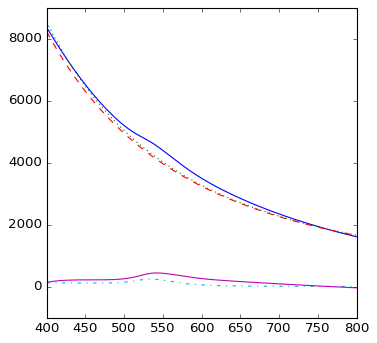

    542.59 ,	 [542.0, 438.57, 120.0, 1.52] 	 (-2.37, 4290.524)	 2.986 	 (-2.33, 4215.86) 	 0.343
	* Warning *: large scattering cross section:  [ 542.     426.823  125.       1.522]


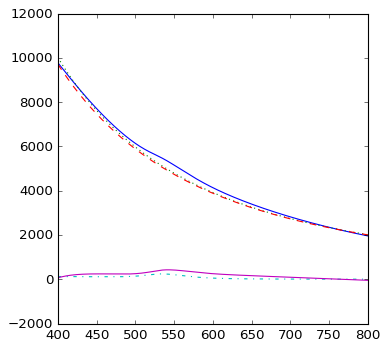

    542.72 ,	 [542.0, 426.82, 125.0, 1.52] 	 (-2.32, 5109.619)	 2.906 	 (-2.28, 5036.60) 	 0.345
	* Warning *: large scattering cross section:  [ 542.     426.532  126.       1.522]


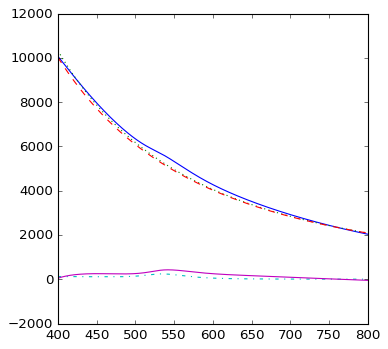

    542.61 ,	 [542.0, 426.53, 126.0, 1.52] 	 (-2.31, 5284.359)	 2.904 	 (-2.27, 5211.33) 	 0.345
	* Warning *: large scattering cross section:  [ 542.     427.303  127.       1.522]


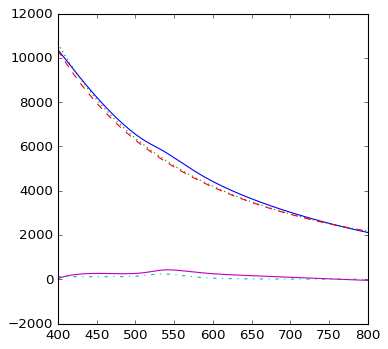

    542.45 ,	 [542.0, 427.3, 127.0, 1.52] 	 (-2.29, 5462.647)	 2.909 	 (-2.26, 5389.44) 	 0.347
	* Warning *: large scattering cross section:  [ 533.     698.818  140.       1.522]


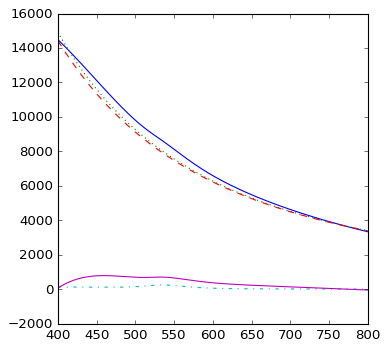

    532.09 ,	 [533.0, 698.82, 140.0, 1.52] 	 (-2.14, 8018.203)	 4.696 	 (-2.10, 7898.02) 	 0.382
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 1315.16]) 150.0 1.5221058963738434]


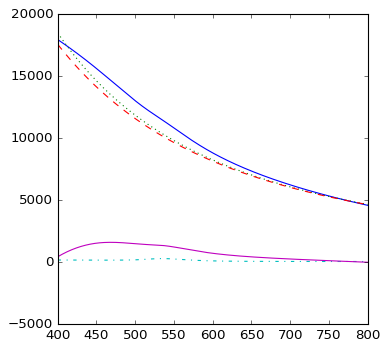

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5221058963738434]


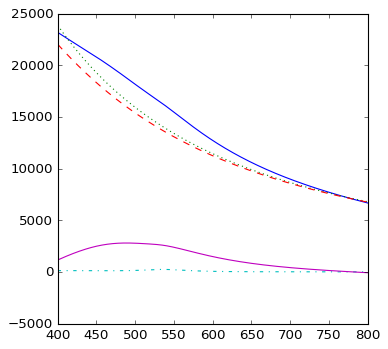

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 2722.137]) 165.0 1.5221058963738434]


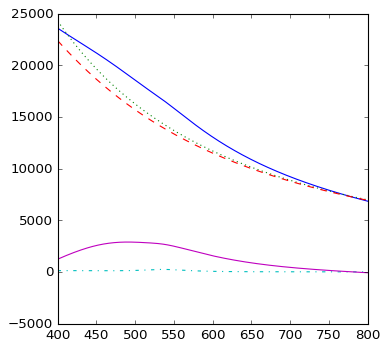

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 2822.719]) 166.0 1.5221058963738434]


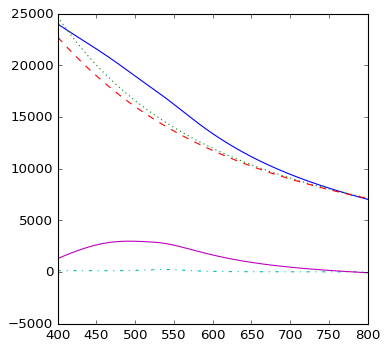

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 3219.955]) 170.0 1.5221058963738434]


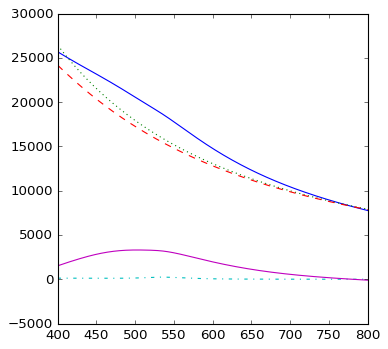

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 4108.262]) 180.0 1.5221058963738434]


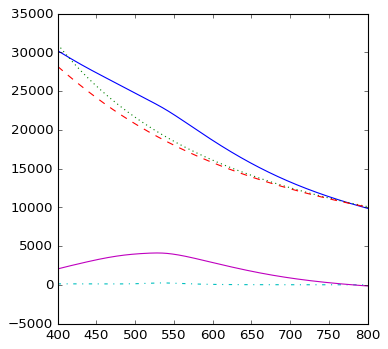

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 548.]) array([ 5185.988]) 200.0 1.5221058963738434]


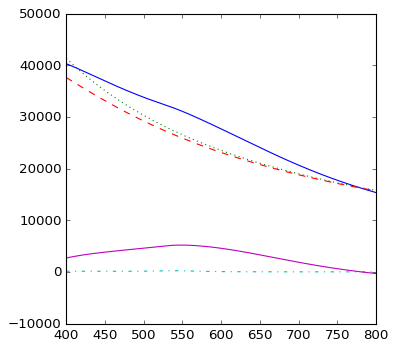

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 5154.049]) 210.0 1.5221058963738434]


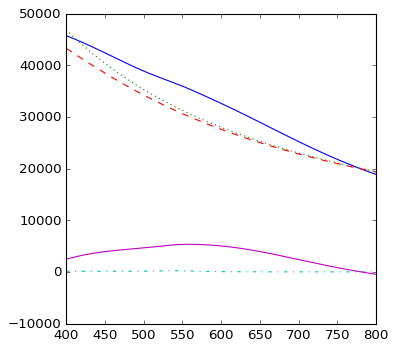

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 5174.898]) 217.0 1.5221058963738434]


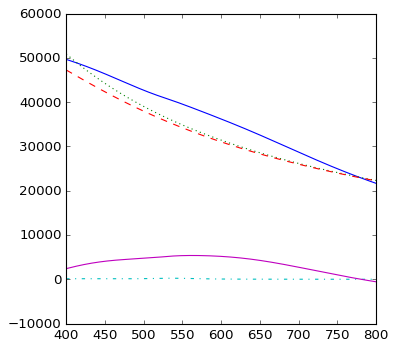

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 5177.349]) 218.0 1.5221058963738434]


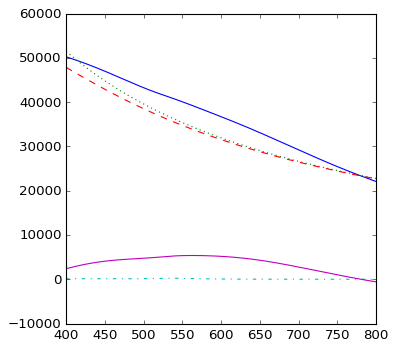

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 5236.055]) 219.0 1.5221058963738434]


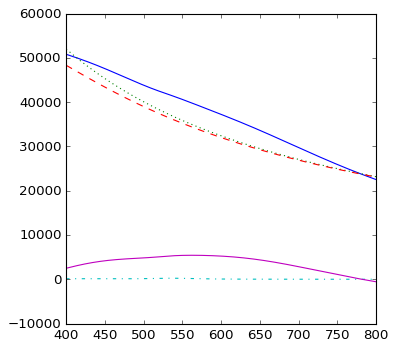

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 551.]) array([ 5399.856]) 230.0 1.5221058963738434]


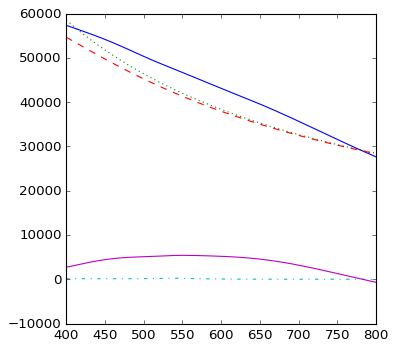

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 540.]) array([ 5366.615]) 260.0 1.5221058963738434]


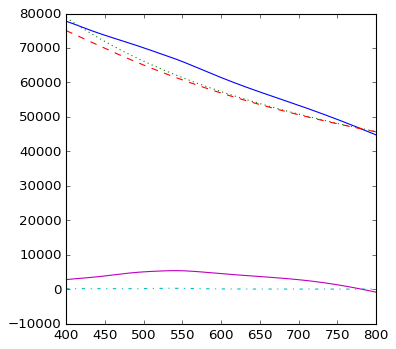

    530.2 ,	 [530.0, 205.57, 11.0, 1.53] 	 (-5.16, 26.996)	 1.375 	 (0.00, 1.00) 	 1.153
    532.39 ,	 [532.0, 222.33, 14.0, 1.53] 	 (-5.08, 28.851)	 1.492 	 (0.00, 1.00) 	 1.192
    532.82 ,	 [533.0, 225.61, 15.0, 1.53] 	 (-5.07, 29.253)	 1.516 	 (0.00, 1.00) 	 1.199
    533.14 ,	 [533.0, 228.26, 16.0, 1.53] 	 (-5.05, 29.604)	 1.534 	 (0.00, 1.00) 	 1.202
    533.4 ,	 [533.0, 230.41, 17.0, 1.53] 	 (-5.04, 29.924)	 1.548 	 (0.00, 1.00) 	 1.204
    533.93 ,	 [534.0, 235.27, 20.0, 1.53] 	 (-5.02, 30.835)	 1.584 	 (0.00, 1.00) 	 1.203
    534.05 ,	 [534.0, 236.53, 21.0, 1.53] 	 (-5.01, 31.157)	 1.592 	 (0.00, 1.00) 	 1.200
    534.15 ,	 [534.0, 237.68, 22.0, 1.53] 	 (-5.00, 31.503)	 1.600 	 (0.00, 1.00) 	 1.196
    534.23 ,	 [534.0, 238.74, 23.0, 1.53] 	 (-4.99, 31.882)	 1.607 	 (0.00, 1.00) 	 1.191
    534.31 ,	 [534.0, 239.74, 24.0, 1.53] 	 (-4.98, 32.301)	 1.614 	 (0.00, 1.00) 	 1.185
    534.43 ,	 [534.0, 241.6, 26.0, 1.53] 	 (-4.96, 33.297)	 1.626 	 (0.00, 1.00) 	 1.169
    534.69 ,	

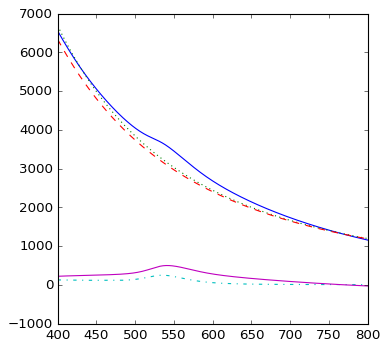

    541.62 ,	 [541.0, 497.71, 110.0, 1.53] 	 (-2.49, 3244.074)	 3.384 	 (-2.43, 3160.28) 	 0.346
	* Warning *: large scattering cross section:  [ 543.     455.547  120.       1.532]


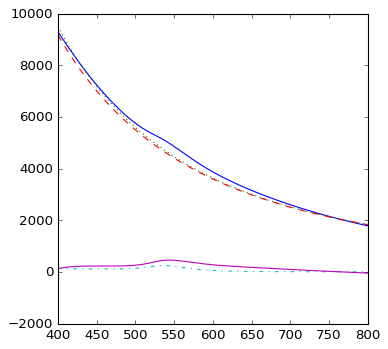

    543.94 ,	 [543.0, 455.55, 120.0, 1.53] 	 (-2.37, 4766.587)	 3.105 	 (-2.33, 4688.92) 	 0.340
	* Warning *: large scattering cross section:  [ 543.     444.185  125.       1.532]


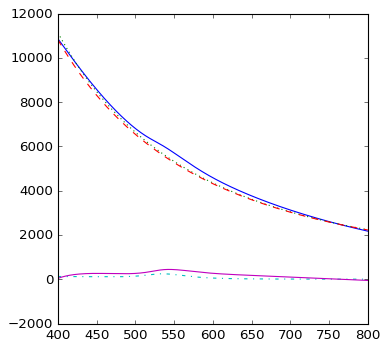

    543.92 ,	 [543.0, 444.19, 125.0, 1.53] 	 (-2.32, 5676.869)	 3.028 	 (-2.29, 5600.79) 	 0.342
	* Warning *: large scattering cross section:  [ 543.     444.663  126.       1.532]


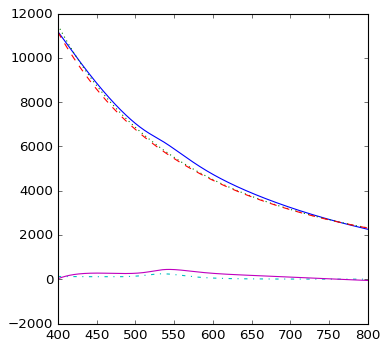

    543.75 ,	 [543.0, 444.66, 126.0, 1.53] 	 (-2.31, 5870.791)	 3.031 	 (-2.28, 5794.57) 	 0.342
	* Warning *: large scattering cross section:  [ 543.     446.487  127.       1.532]


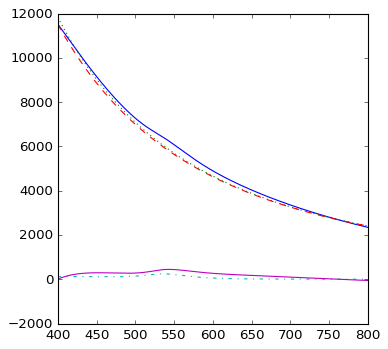

    543.51 ,	 [543.0, 446.49, 127.0, 1.53] 	 (-2.30, 6068.559)	 3.044 	 (-2.27, 5991.98) 	 0.345
	* Warning *: large scattering cross section:  [ 531.     801.468  140.       1.532]


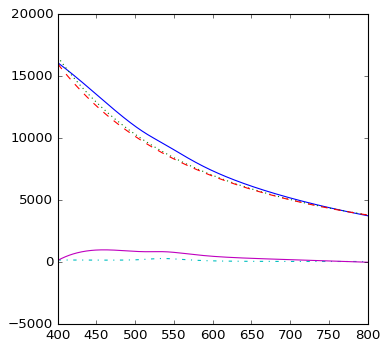

    529.46 ,	 [531.0, 801.47, 140.0, 1.53] 	 (-2.13, 8878.767)	 5.368 	 (-2.09, 8741.14) 	 0.387
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 1535.321]) 150.0 1.5321058963738434]


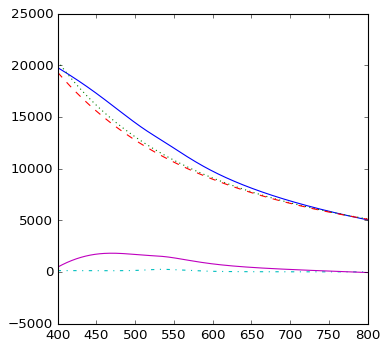

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 3055.988]) 164.0 1.5321058963738434]


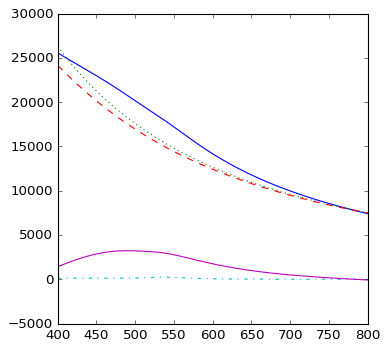

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 3167.534]) 165.0 1.5321058963738434]


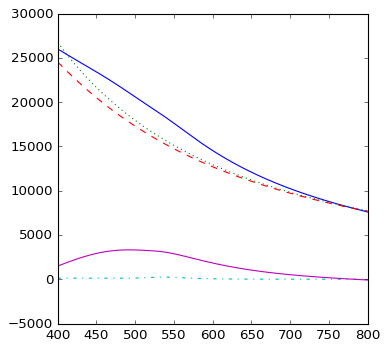

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 3278.522]) 166.0 1.5321058963738434]


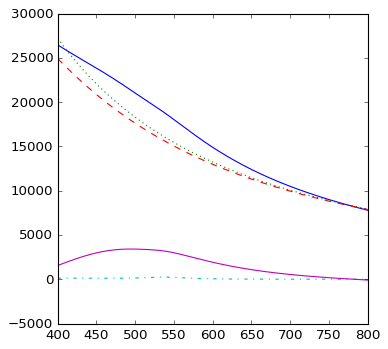

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 3711.376]) 170.0 1.5321058963738434]


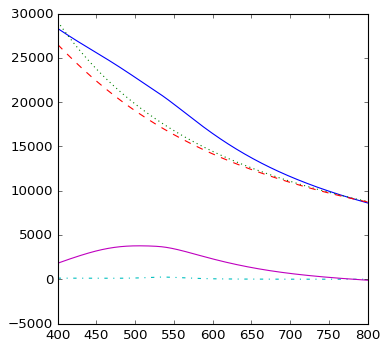

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 4604.617]) 180.0 1.5321058963738434]


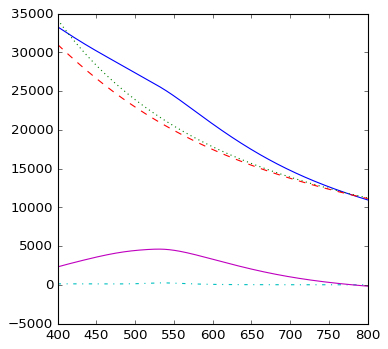

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 551.]) array([ 5728.147]) 200.0 1.5321058963738434]


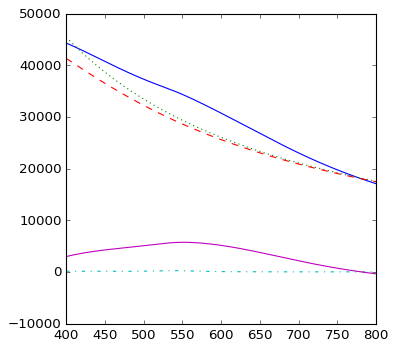

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 5575.168]) 210.0 1.5321058963738434]


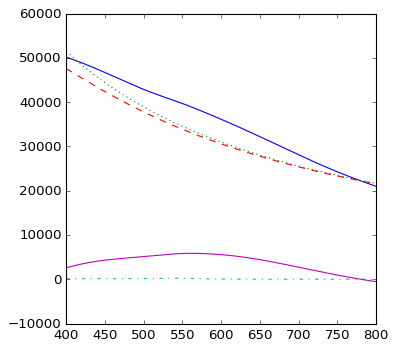

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 5670.737]) 217.0 1.5321058963738434]


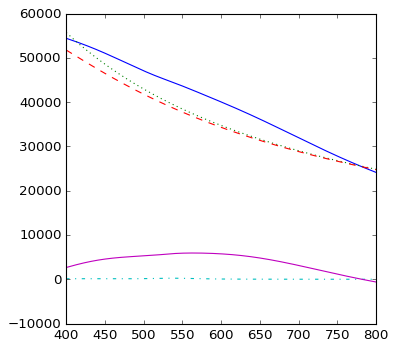

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 5677.031]) 218.0 1.5321058963738434]


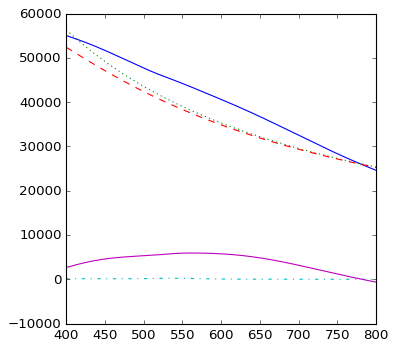

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 5683.709]) 219.0 1.5321058963738434]


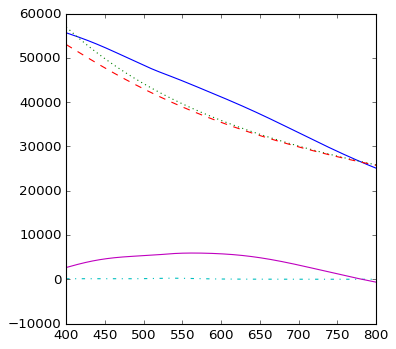

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 548.]) array([ 5914.688]) 230.0 1.5321058963738434]


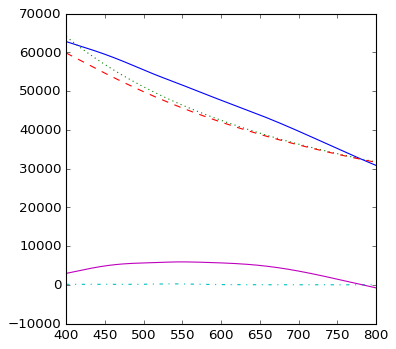

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 542.]) array([ 5948.465]) 260.0 1.5321058963738434]


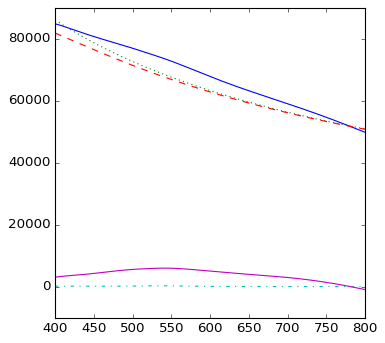

    530.59 ,	 [531.0, 208.12, 11.0, 1.54] 	 (-5.15, 27.258)	 1.395 	 (0.00, 1.00) 	 1.161
    532.93 ,	 [533.0, 225.82, 14.0, 1.54] 	 (-5.06, 29.210)	 1.518 	 (0.00, 1.00) 	 1.203
    533.37 ,	 [533.0, 229.25, 15.0, 1.54] 	 (-5.05, 29.634)	 1.541 	 (0.00, 1.00) 	 1.209
    533.73 ,	 [534.0, 232.02, 16.0, 1.54] 	 (-5.03, 30.006)	 1.562 	 (0.00, 1.00) 	 1.213
    534.01 ,	 [534.0, 234.35, 17.0, 1.54] 	 (-5.02, 30.345)	 1.577 	 (0.00, 1.00) 	 1.215
    534.58 ,	 [535.0, 239.4, 20.0, 1.54] 	 (-5.00, 31.314)	 1.614 	 (0.00, 1.00) 	 1.213
    534.71 ,	 [535.0, 240.76, 21.0, 1.54] 	 (-4.99, 31.659)	 1.623 	 (0.00, 1.00) 	 1.210
    534.81 ,	 [535.0, 241.99, 22.0, 1.54] 	 (-4.98, 32.030)	 1.631 	 (0.00, 1.00) 	 1.206
    534.91 ,	 [535.0, 243.13, 23.0, 1.54] 	 (-4.97, 32.437)	 1.639 	 (0.00, 1.00) 	 1.200
    534.99 ,	 [535.0, 244.21, 24.0, 1.54] 	 (-4.96, 32.888)	 1.646 	 (0.00, 1.00) 	 1.194
    535.12 ,	 [535.0, 246.2, 26.0, 1.54] 	 (-4.93, 33.962)	 1.660 	 (0.00, 1.00) 	 1.177
    535.37 ,

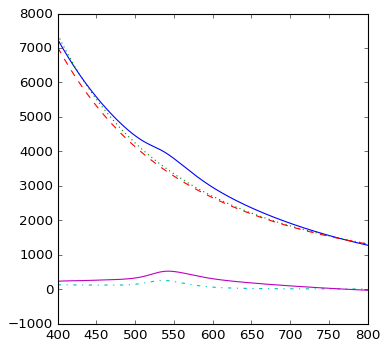

    542.89 ,	 [542.0, 520.8, 110.0, 1.54] 	 (-2.49, 3583.311)	 3.545 	 (-2.43, 3495.50) 	 0.342
	* Warning *: large scattering cross section:  [ 545.     472.092  120.       1.542]


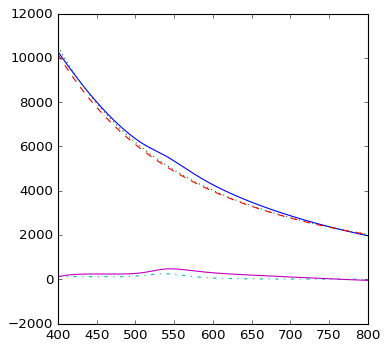

    545.39 ,	 [545.0, 472.09, 120.0, 1.54] 	 (-2.38, 5269.672)	 3.227 	 (-2.34, 5189.08) 	 0.337
	* Warning *: large scattering cross section:  [ 545.     462.     125.       1.542]


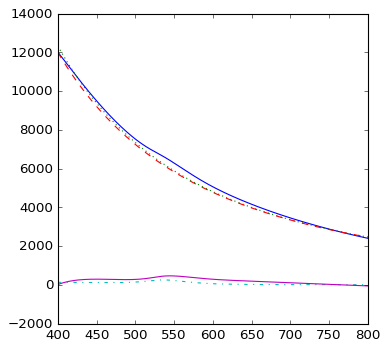

    545.16 ,	 [545.0, 462.0, 125.0, 1.54] 	 (-2.32, 6275.690)	 3.158 	 (-2.29, 6196.46) 	 0.339
	* Warning *: large scattering cross section:  [ 544.     463.532  126.       1.542]


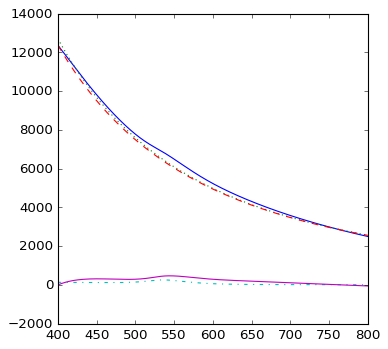

    544.85 ,	 [544.0, 463.53, 126.0, 1.54] 	 (-2.31, 6489.695)	 3.164 	 (-2.28, 6410.15) 	 0.340
	* Warning *: large scattering cross section:  [ 544.     482.244  127.       1.542]


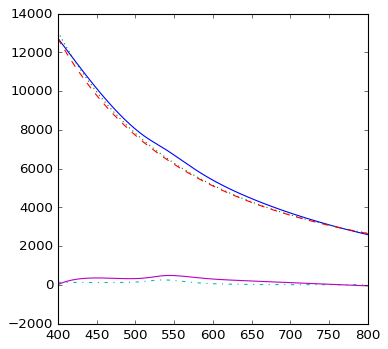

    544.31 ,	 [544.0, 482.24, 127.0, 1.54] 	 (-2.30, 6693.915)	 3.292 	 (-2.27, 6611.13) 	 0.342
	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 140.0 1.5421058963738434]


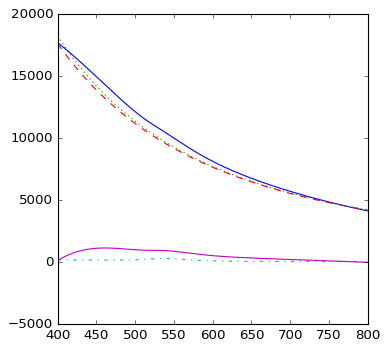

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 1624.07]) 150.0 1.5421058963738434]


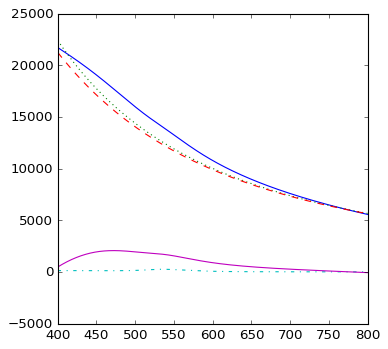

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5421058963738434]


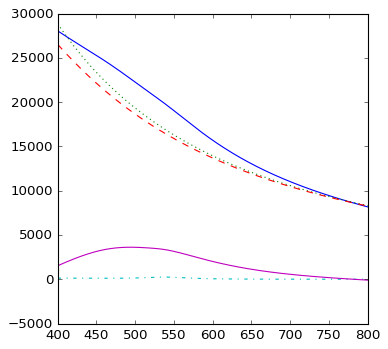

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5421058963738434]


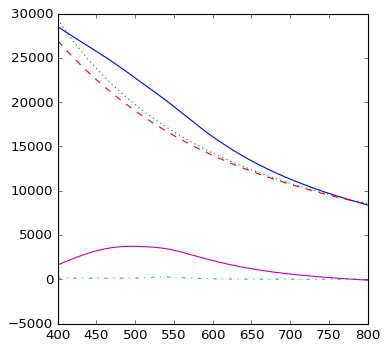

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5421058963738434]


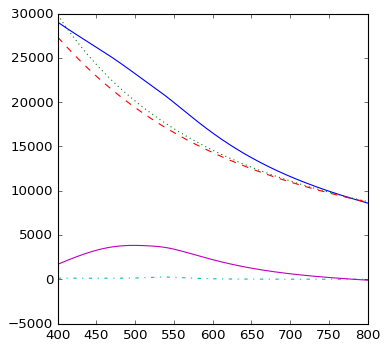

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 170.0 1.5421058963738434]


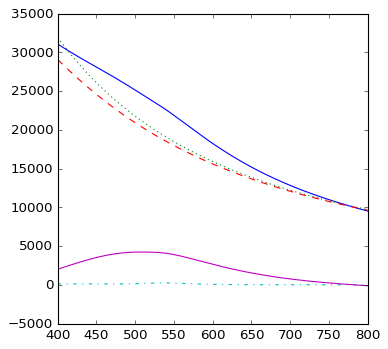

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 5129.336]) 180.0 1.5421058963738434]


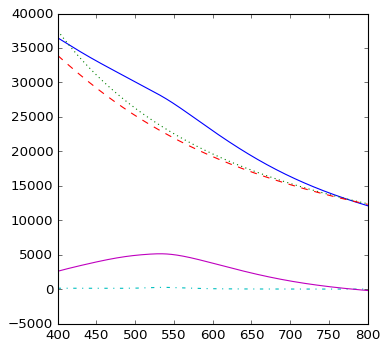

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 554.]) array([ 6291.311]) 200.0 1.5421058963738434]


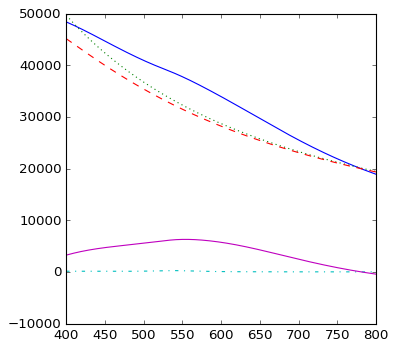

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 6411.077]) 210.0 1.5421058963738434]


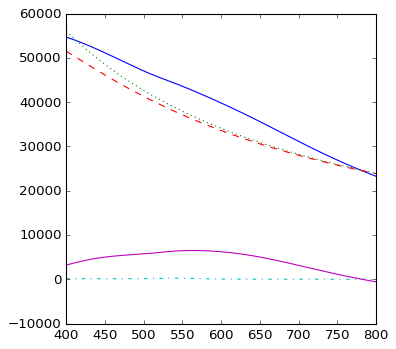

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 6423.76]) 217.0 1.5421058963738434]


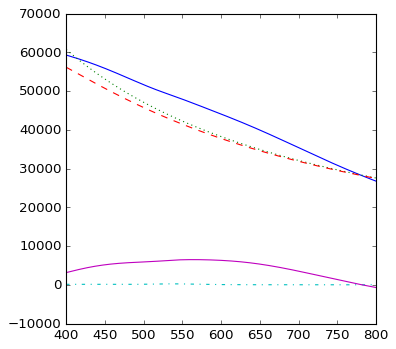

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 6424.388]) 218.0 1.5421058963738434]


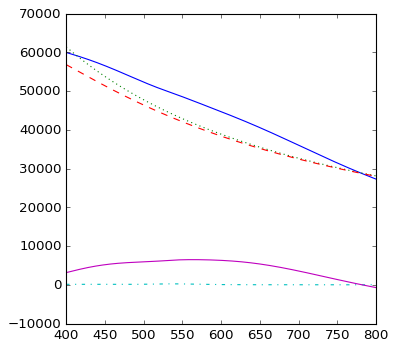

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 6425.056]) 219.0 1.5421058963738434]


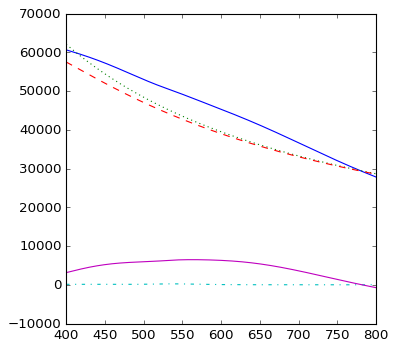

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 6453.395]) 230.0 1.5421058963738434]


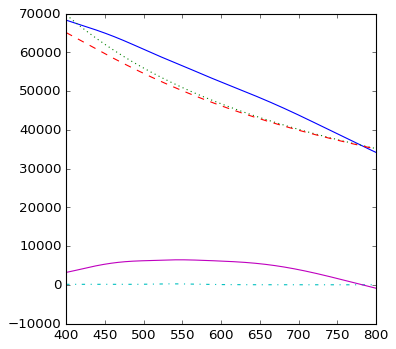

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 543.]) array([ 6573.918]) 260.0 1.5421058963738434]


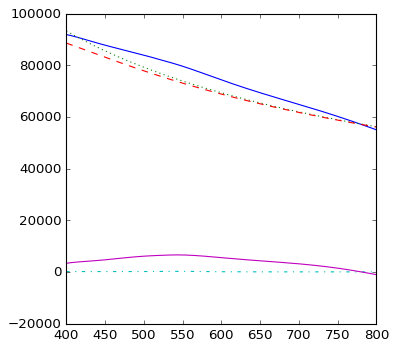

    530.96 ,	 [531.0, 210.73, 11.0, 1.55] 	 (-5.13, 27.517)	 1.412 	 (0.00, 1.00) 	 1.169
    533.46 ,	 [533.0, 229.23, 14.0, 1.55] 	 (-5.04, 29.566)	 1.541 	 (0.00, 1.00) 	 1.212
    533.95 ,	 [534.0, 232.88, 15.0, 1.55] 	 (-5.03, 30.013)	 1.568 	 (0.00, 1.00) 	 1.219
    534.32 ,	 [534.0, 235.8, 16.0, 1.55] 	 (-5.01, 30.405)	 1.587 	 (0.00, 1.00) 	 1.223
    534.63 ,	 [535.0, 238.19, 17.0, 1.55] 	 (-5.00, 30.763)	 1.606 	 (0.00, 1.00) 	 1.226
    535.22 ,	 [535.0, 243.61, 20.0, 1.55] 	 (-4.97, 31.793)	 1.642 	 (0.00, 1.00) 	 1.223
    535.36 ,	 [535.0, 245.0, 21.0, 1.55] 	 (-4.96, 32.160)	 1.651 	 (0.00, 1.00) 	 1.220
    535.48 ,	 [535.0, 246.27, 22.0, 1.55] 	 (-4.96, 32.557)	 1.660 	 (0.00, 1.00) 	 1.215
    535.59 ,	 [536.0, 247.46, 23.0, 1.55] 	 (-4.94, 32.992)	 1.671 	 (0.00, 1.00) 	 1.209
    535.68 ,	 [536.0, 248.6, 24.0, 1.55] 	 (-4.93, 33.476)	 1.678 	 (0.00, 1.00) 	 1.202
    535.83 ,	 [536.0, 250.74, 26.0, 1.55] 	 (-4.91, 34.632)	 1.693 	 (0.00, 1.00) 	 1.184
    536.09 ,	

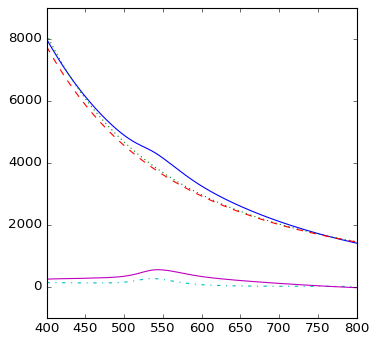

    544.27 ,	 [544.0, 543.6, 110.0, 1.55] 	 (-2.49, 3940.949)	 3.711 	 (-2.44, 3849.18) 	 0.338
	* Warning *: large scattering cross section:  [ 546.     488.19   120.       1.552]


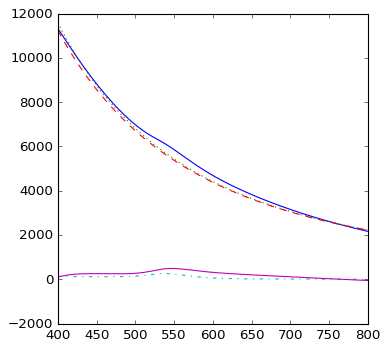

    546.82 ,	 [546.0, 488.19, 120.0, 1.55] 	 (-2.38, 5799.936)	 3.341 	 (-2.34, 5716.47) 	 0.332
	* Warning *: large scattering cross section:  [ 546.     480.573  125.       1.552]


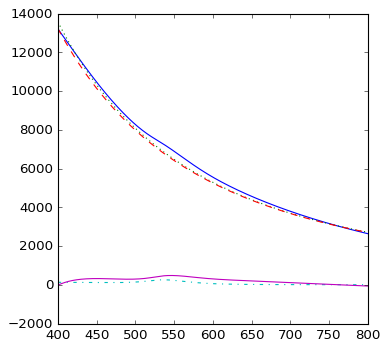

    546.31 ,	 [546.0, 480.57, 125.0, 1.55] 	 (-2.32, 6906.072)	 3.289 	 (-2.30, 6823.56) 	 0.337
	* Warning *: large scattering cross section:  [ 545.     499.835  126.       1.552]


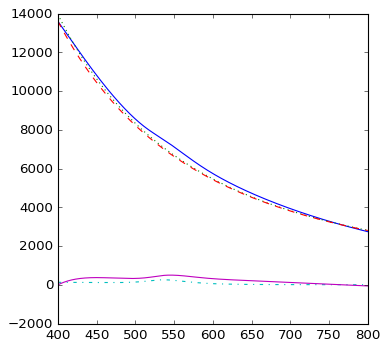

    545.69 ,	 [545.0, 499.84, 126.0, 1.55] 	 (-2.31, 7126.244)	 3.416 	 (-2.28, 7040.39) 	 0.338
	* Warning *: large scattering cross section:  [ 545.     505.708  127.       1.552]


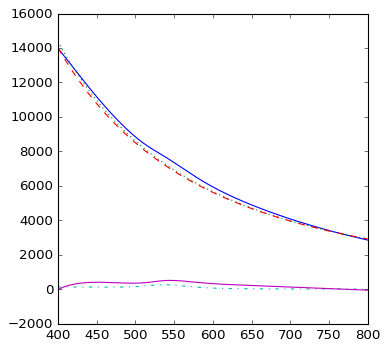

    545.22 ,	 [545.0, 505.71, 127.0, 1.55] 	 (-2.30, 7364.900)	 3.457 	 (-2.27, 7278.00) 	 0.340
	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 140.0 1.5521058963738434]


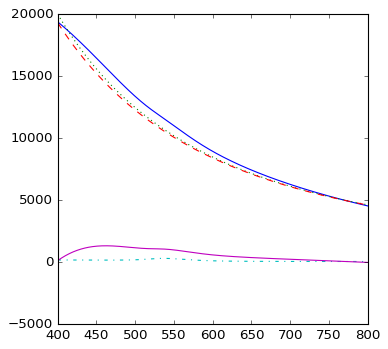

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 1870.526]) 150.0 1.5521058963738434]


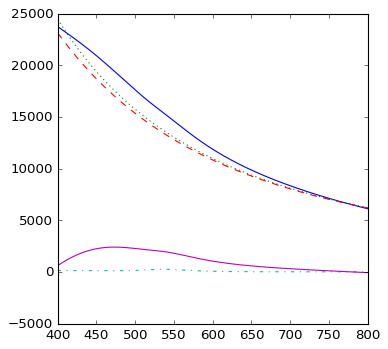

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5521058963738434]


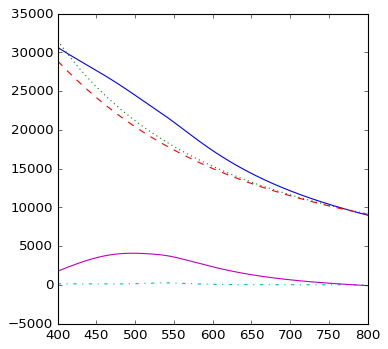

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5521058963738434]


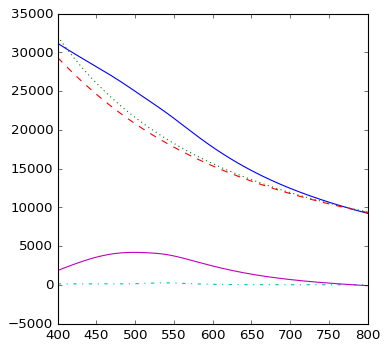

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5521058963738434]


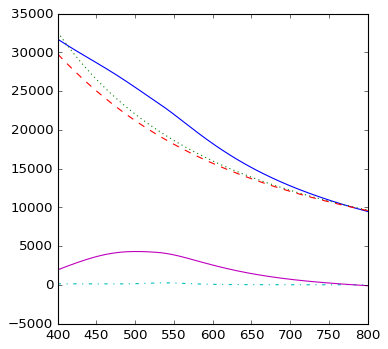

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 170.0 1.5521058963738434]


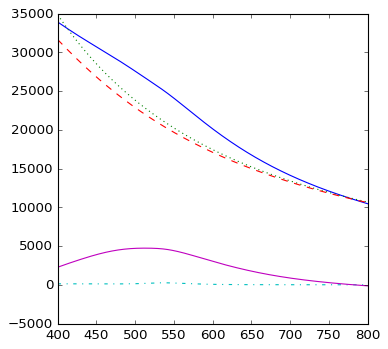

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 5724.933]) 180.0 1.5521058963738434]


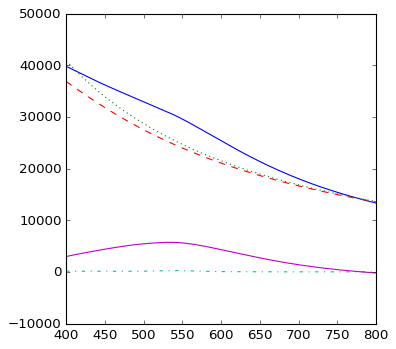

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 6805.375]) 200.0 1.5521058963738434]


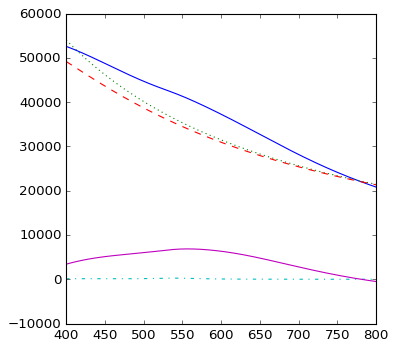

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 6966.513]) 210.0 1.5521058963738434]


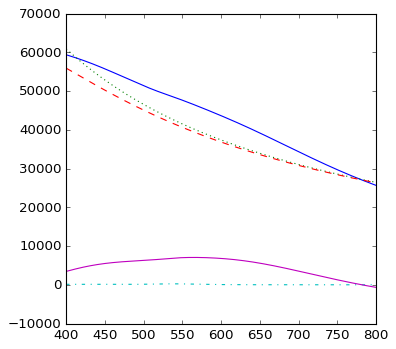

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 6978.165]) 217.0 1.5521058963738434]


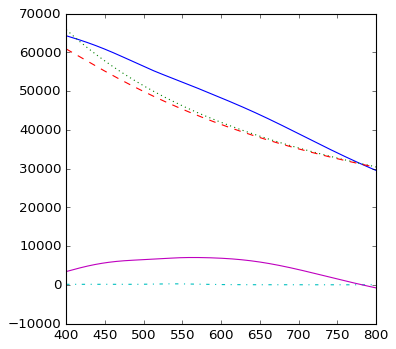

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 6979.516]) 218.0 1.5521058963738434]


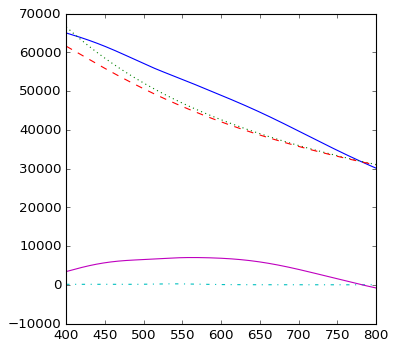

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 7048.9]) 219.0 1.5521058963738434]


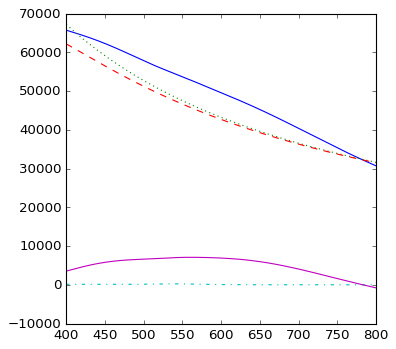

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 7100.637]) 230.0 1.5521058963738434]


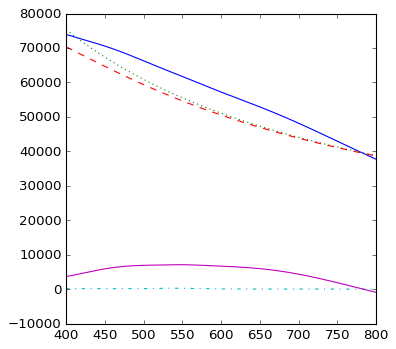

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 7247.45]) 260.0 1.5521058963738434]


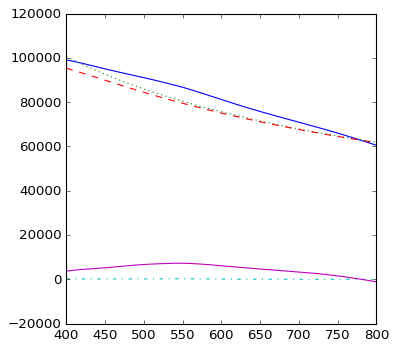

    531.34 ,	 [531.0, 213.25, 11.0, 1.56] 	 (-5.12, 27.772)	 1.429 	 (0.00, 1.00) 	 1.176
    534.01 ,	 [534.0, 232.68, 14.0, 1.56] 	 (-5.02, 29.919)	 1.566 	 (0.00, 1.00) 	 1.223
    534.51 ,	 [534.0, 236.43, 15.0, 1.56] 	 (-5.01, 30.389)	 1.591 	 (0.00, 1.00) 	 1.229
    534.93 ,	 [535.0, 239.54, 16.0, 1.56] 	 (-4.99, 30.802)	 1.615 	 (0.00, 1.00) 	 1.234
    535.24 ,	 [535.0, 242.08, 17.0, 1.56] 	 (-4.98, 31.180)	 1.632 	 (0.00, 1.00) 	 1.236
    535.9 ,	 [536.0, 247.74, 20.0, 1.56] 	 (-4.95, 32.270)	 1.673 	 (0.00, 1.00) 	 1.234
    536.05 ,	 [536.0, 249.22, 21.0, 1.56] 	 (-4.94, 32.661)	 1.683 	 (0.00, 1.00) 	 1.230
    536.17 ,	 [536.0, 250.58, 22.0, 1.56] 	 (-4.93, 33.084)	 1.692 	 (0.00, 1.00) 	 1.225
    536.28 ,	 [536.0, 251.84, 23.0, 1.56] 	 (-4.92, 33.549)	 1.700 	 (0.00, 1.00) 	 1.218
    536.37 ,	 [536.0, 253.02, 24.0, 1.56] 	 (-4.91, 34.067)	 1.708 	 (0.00, 1.00) 	 1.211
    536.53 ,	 [536.0, 255.23, 26.0, 1.56] 	 (-4.88, 35.307)	 1.723 	 (0.00, 1.00) 	 1.191
    536.84 

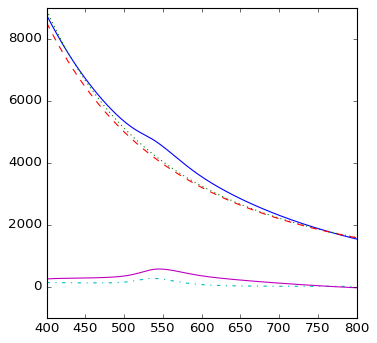

    545.67 ,	 [545.0, 565.9, 110.0, 1.56] 	 (-2.50, 4317.188)	 3.868 	 (-2.44, 4221.51) 	 0.333
	* Warning *: large scattering cross section:  [ 548.     504.022  120.       1.562]


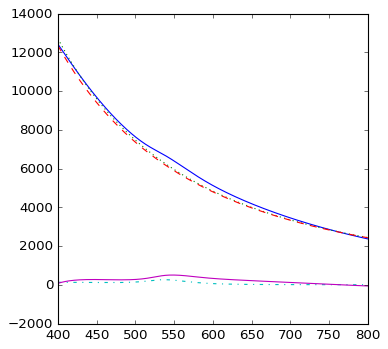

    548.32 ,	 [548.0, 504.02, 120.0, 1.56] 	 (-2.38, 6357.487)	 3.459 	 (-2.35, 6271.18) 	 0.329
	* Warning *: large scattering cross section:  [ 547.     500.232  125.       1.562]


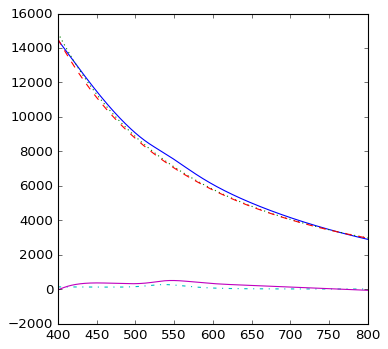

    547.42 ,	 [547.0, 500.23, 125.0, 1.56] 	 (-2.33, 7567.952)	 3.428 	 (-2.30, 7481.96) 	 0.334
	* Warning *: large scattering cross section:  [ 546.     523.031  126.       1.562]


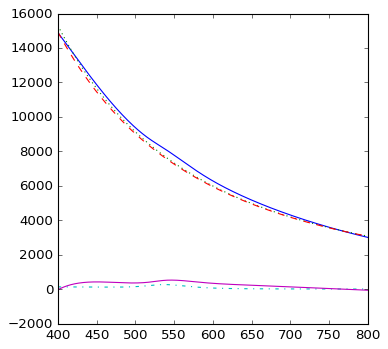

    546.65 ,	 [546.0, 523.03, 126.0, 1.56] 	 (-2.32, 7808.255)	 3.580 	 (-2.29, 7718.33) 	 0.336
	* Warning *: large scattering cross section:  [ 546.     531.414  127.       1.562]


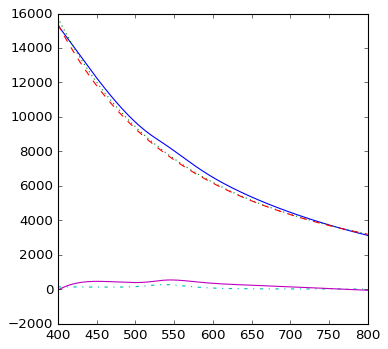

    546.04 ,	 [546.0, 531.41, 127.0, 1.56] 	 (-2.30, 8068.807)	 3.637 	 (-2.28, 7977.40) 	 0.338
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 1108.603]) 140.0 1.5621058963738434]


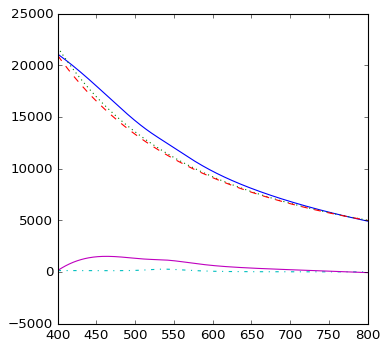

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 2124.779]) 150.0 1.5621058963738434]


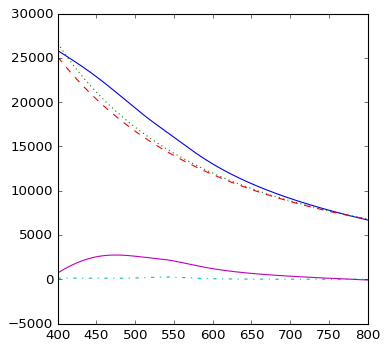

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5621058963738434]


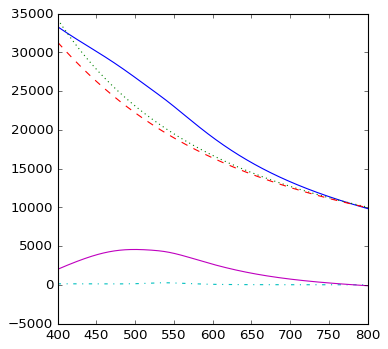

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5621058963738434]


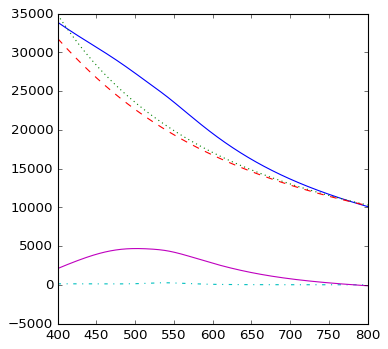

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5621058963738434]


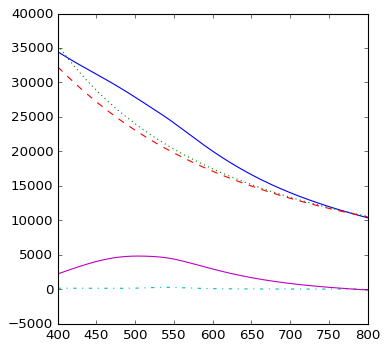

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 5260.923]) 170.0 1.5621058963738434]


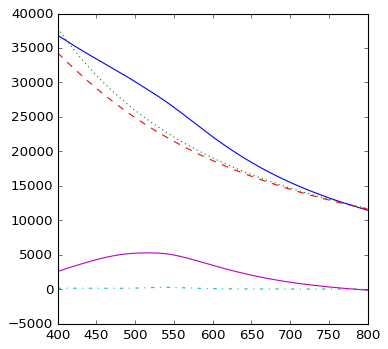

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 6308.27]) 180.0 1.5621058963738434]


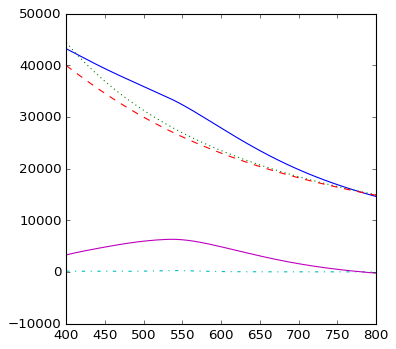

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 7450.311]) 200.0 1.5621058963738434]


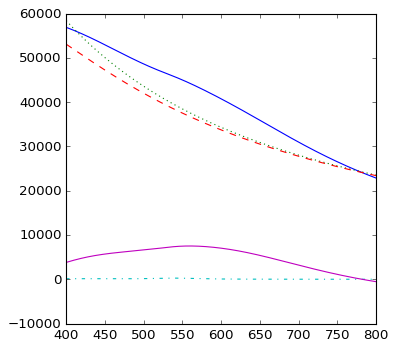

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 7537.994]) 210.0 1.5621058963738434]


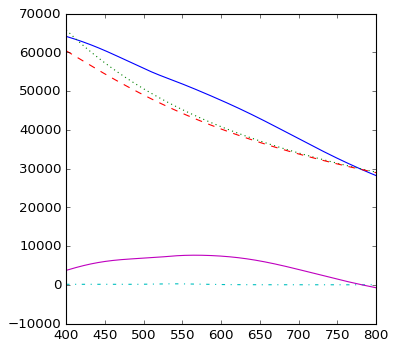

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 7624.435]) 217.0 1.5621058963738434]


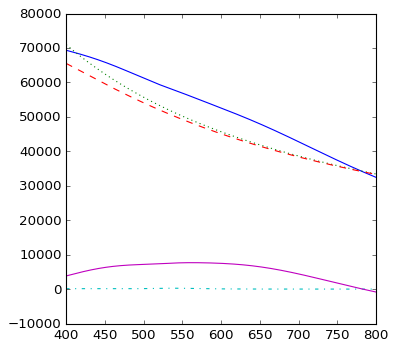

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 7627.582]) 218.0 1.5621058963738434]


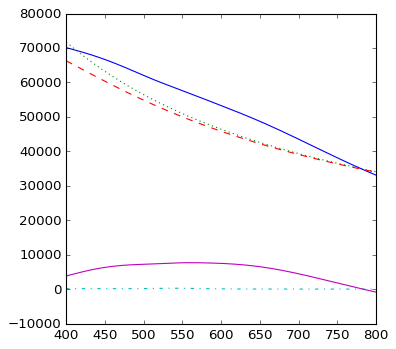

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 7631.152]) 219.0 1.5621058963738434]


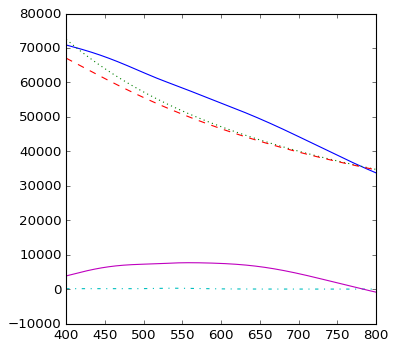

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 542.]) array([ 7714.293]) 230.0 1.5621058963738434]


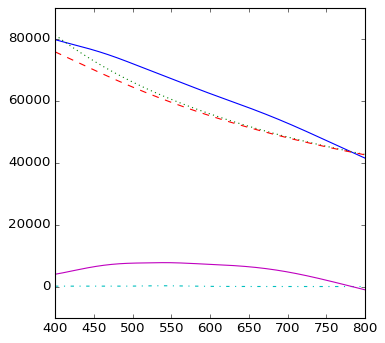

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 7967.048]) 260.0 1.5621058963738434]


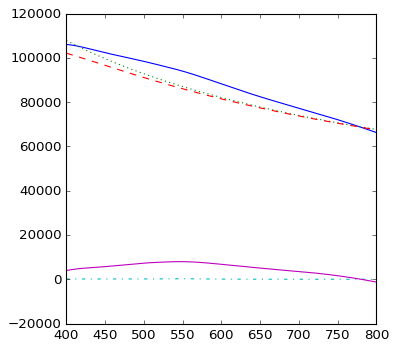

    531.74 ,	 [532.0, 215.78, 11.0, 1.57] 	 (-5.10, 28.026)	 1.448 	 (0.00, 1.00) 	 1.184
    534.58 ,	 [535.0, 236.02, 14.0, 1.57] 	 (-5.01, 30.270)	 1.591 	 (0.00, 1.00) 	 1.232
    535.11 ,	 [535.0, 240.04, 15.0, 1.57] 	 (-4.99, 30.763)	 1.618 	 (0.00, 1.00) 	 1.240
    535.54 ,	 [535.0, 243.2, 16.0, 1.57] 	 (-4.97, 31.196)	 1.639 	 (0.00, 1.00) 	 1.244
    535.89 ,	 [536.0, 245.9, 17.0, 1.57] 	 (-4.96, 31.594)	 1.660 	 (0.00, 1.00) 	 1.247
    536.6 ,	 [537.0, 251.79, 20.0, 1.57] 	 (-4.93, 32.747)	 1.703 	 (0.00, 1.00) 	 1.244
    536.75 ,	 [537.0, 253.37, 21.0, 1.57] 	 (-4.92, 33.161)	 1.713 	 (0.00, 1.00) 	 1.240
    536.89 ,	 [537.0, 254.82, 22.0, 1.57] 	 (-4.91, 33.611)	 1.723 	 (0.00, 1.00) 	 1.234
    537.0 ,	 [537.0, 256.16, 23.0, 1.57] 	 (-4.90, 34.106)	 1.732 	 (0.00, 1.00) 	 1.228
    537.1 ,	 [537.0, 257.41, 24.0, 1.57] 	 (-4.88, 34.659)	 1.740 	 (0.00, 1.00) 	 1.219
    537.27 ,	 [537.0, 259.76, 26.0, 1.57] 	 (-4.85, 35.985)	 1.756 	 (0.00, 1.00) 	 1.198
    537.57 ,	 [

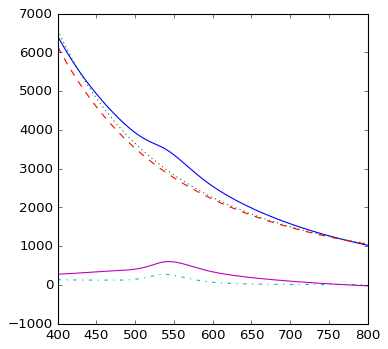

    543.46 ,	 [543.0, 600.02, 100.0, 1.57] 	 (-2.64, 3051.431)	 4.090 	 (-2.56, 2951.44) 	 0.342
	* Warning *: large scattering cross section:  [ 547.     575.087  110.       1.572]


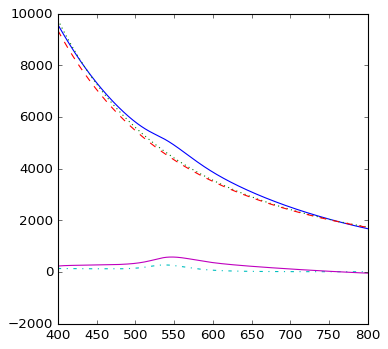

    547.27 ,	 [547.0, 575.09, 110.0, 1.57] 	 (-2.50, 4723.524)	 3.941 	 (-2.45, 4626.12) 	 0.330
	* Warning *: large scattering cross section:  [ 549.     519.719  120.       1.572]


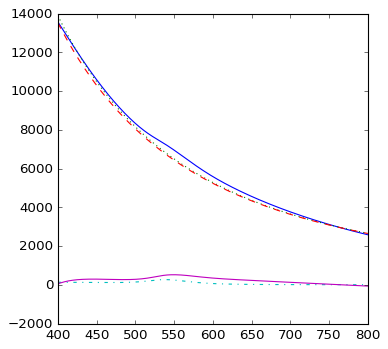

    549.78 ,	 [549.0, 519.72, 120.0, 1.57] 	 (-2.39, 6942.383)	 3.571 	 (-2.36, 6853.25) 	 0.325
	* Warning *: large scattering cross section:  [ 548.     540.204  125.       1.572]


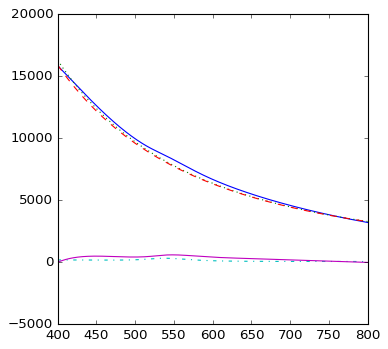

    548.17 ,	 [548.0, 540.2, 125.0, 1.57] 	 (-2.33, 8243.858)	 3.707 	 (-2.30, 8150.91) 	 0.332
	* Warning *: large scattering cross section:  [ 547.     548.475  126.       1.572]


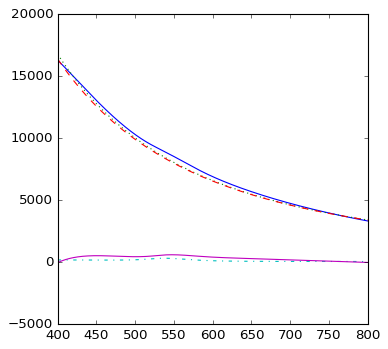

    547.51 ,	 [547.0, 548.48, 126.0, 1.57] 	 (-2.32, 8522.196)	 3.759 	 (-2.29, 8427.80) 	 0.335
	* Warning *: large scattering cross section:  [ 546.     560.221  127.       1.572]


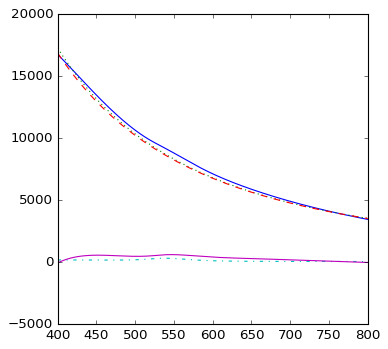

    546.7 ,	 [546.0, 560.22, 127.0, 1.57] 	 (-2.31, 8805.203)	 3.834 	 (-2.28, 8708.77) 	 0.337
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 1245.278]) 140.0 1.5721058963738435]


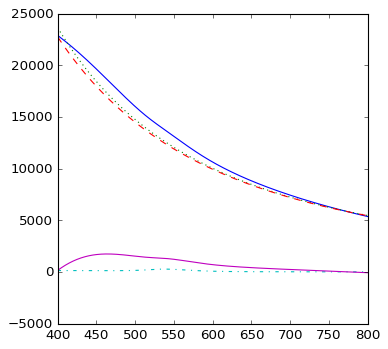

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 2406.608]) 150.0 1.5721058963738435]


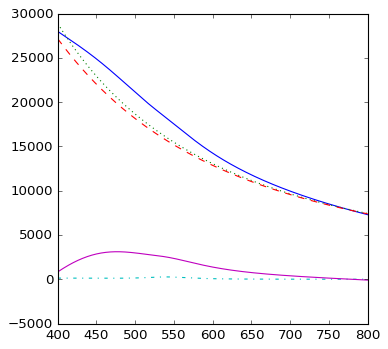

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5721058963738435]


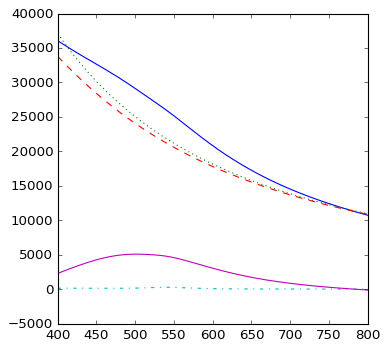

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5721058963738435]


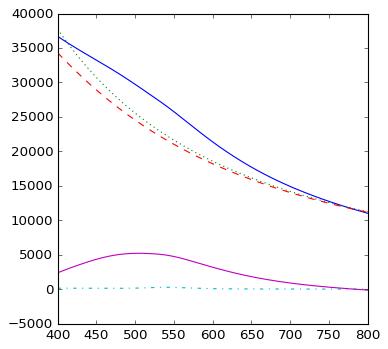

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5721058963738435]


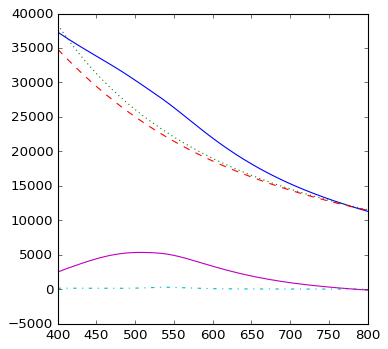

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 519.]) array([ 5819.612]) 170.0 1.5721058963738435]


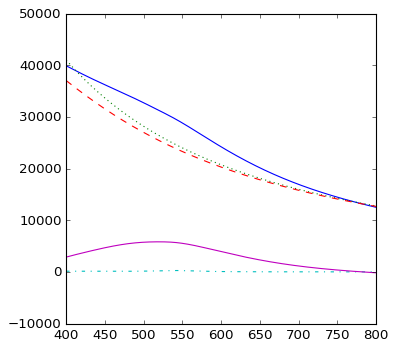

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 6917.614]) 180.0 1.5721058963738435]


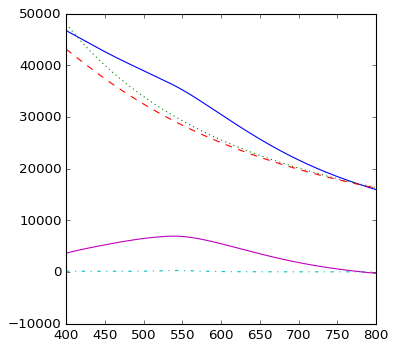

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 8052.47]) 200.0 1.5721058963738435]


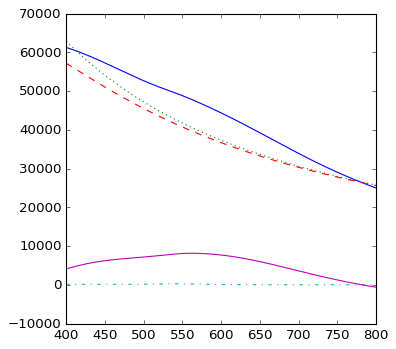

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 8199.536]) 210.0 1.5721058963738435]


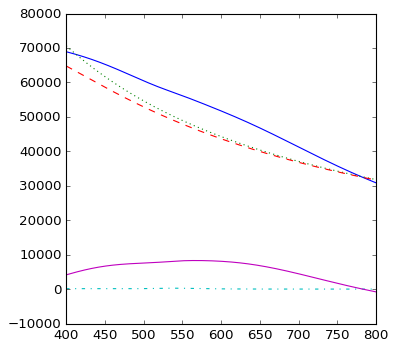

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 8222.902]) 217.0 1.5721058963738435]


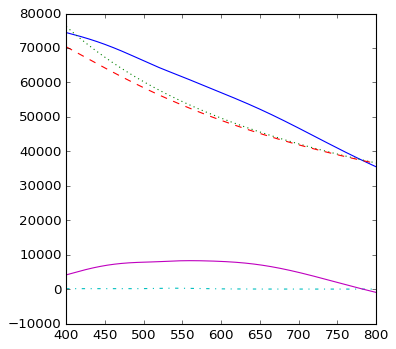

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 8227.786]) 218.0 1.5721058963738435]


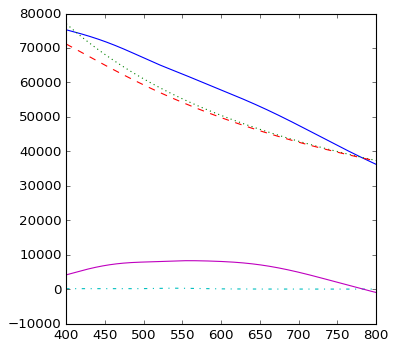

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 8233.365]) 219.0 1.5721058963738435]


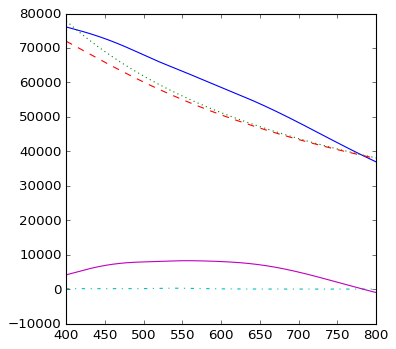

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 8349.183]) 230.0 1.5721058963738435]


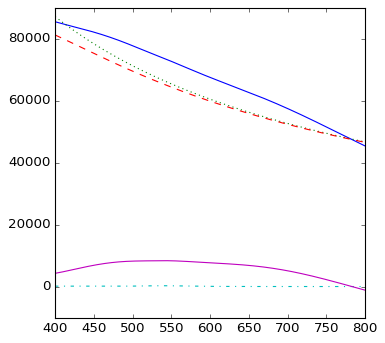

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 548.]) array([ 8751.827]) 260.0 1.5721058963738435]


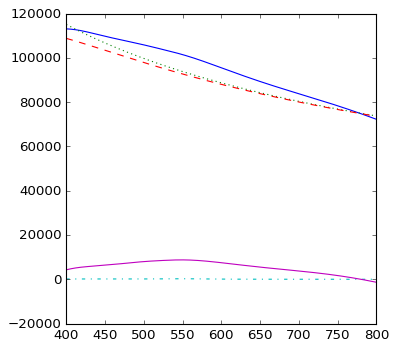

    532.13 ,	 [532.0, 218.29, 11.0, 1.58] 	 (-5.09, 28.276)	 1.465 	 (0.00, 1.00) 	 1.192
    535.13 ,	 [535.0, 239.42, 14.0, 1.58] 	 (-4.99, 30.618)	 1.614 	 (0.00, 1.00) 	 1.242
    535.72 ,	 [536.0, 243.54, 15.0, 1.58] 	 (-4.97, 31.134)	 1.644 	 (0.00, 1.00) 	 1.250
    536.17 ,	 [536.0, 246.92, 16.0, 1.58] 	 (-4.95, 31.589)	 1.667 	 (0.00, 1.00) 	 1.255
    536.53 ,	 [536.0, 249.65, 17.0, 1.58] 	 (-4.94, 32.007)	 1.685 	 (0.00, 1.00) 	 1.257
    537.29 ,	 [537.0, 255.9, 20.0, 1.58] 	 (-4.91, 33.222)	 1.730 	 (0.00, 1.00) 	 1.254
    537.45 ,	 [537.0, 257.51, 21.0, 1.58] 	 (-4.90, 33.661)	 1.741 	 (0.00, 1.00) 	 1.249
    537.62 ,	 [538.0, 258.99, 22.0, 1.58] 	 (-4.88, 34.138)	 1.754 	 (0.00, 1.00) 	 1.244
    537.74 ,	 [538.0, 260.41, 23.0, 1.58] 	 (-4.87, 34.664)	 1.763 	 (0.00, 1.00) 	 1.237
    537.85 ,	 [538.0, 261.74, 24.0, 1.58] 	 (-4.86, 35.252)	 1.772 	 (0.00, 1.00) 	 1.228
    538.03 ,	 [538.0, 264.24, 26.0, 1.58] 	 (-4.83, 36.666)	 1.789 	 (0.00, 1.00) 	 1.205
    538.35 

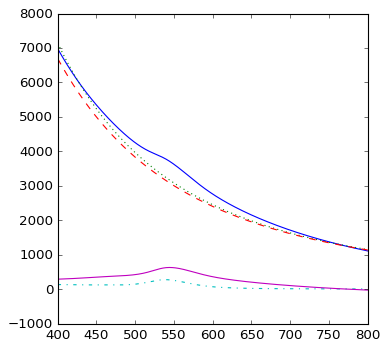

    544.65 ,	 [544.0, 627.9, 100.0, 1.58] 	 (-2.64, 3314.811)	 4.286 	 (-2.57, 3210.03) 	 0.337
	* Warning *: large scattering cross section:  [ 548.     595.694  110.       1.582]


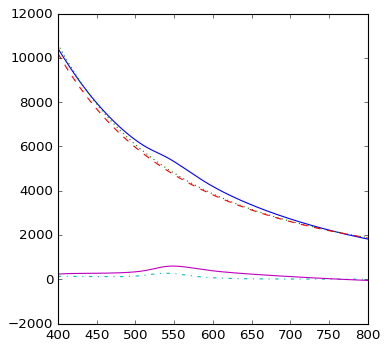

    548.78 ,	 [548.0, 595.69, 110.0, 1.58] 	 (-2.50, 5138.119)	 4.087 	 (-2.45, 5037.07) 	 0.325
	* Warning *: large scattering cross section:  [ 551.     535.578  120.       1.582]


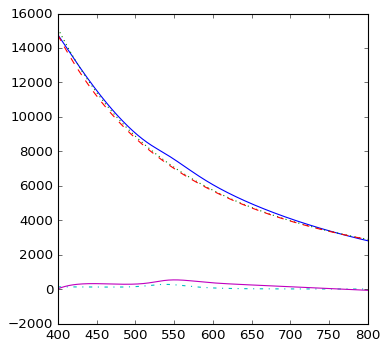

    551.26 ,	 [551.0, 535.58, 120.0, 1.58] 	 (-2.39, 7554.623)	 3.689 	 (-2.36, 7462.64) 	 0.323
	* Warning *: large scattering cross section:  [ 549.     565.293  125.       1.582]


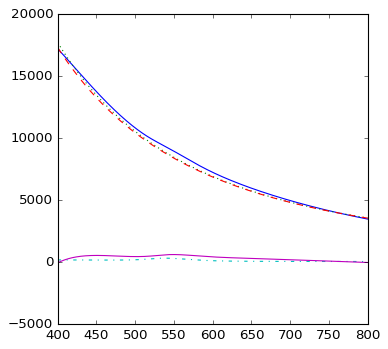

    549.06 ,	 [549.0, 565.29, 125.0, 1.58] 	 (-2.33, 8966.365)	 3.884 	 (-2.31, 8869.00) 	 0.331
	* Warning *: large scattering cross section:  [ 548.     577.036  126.       1.582]


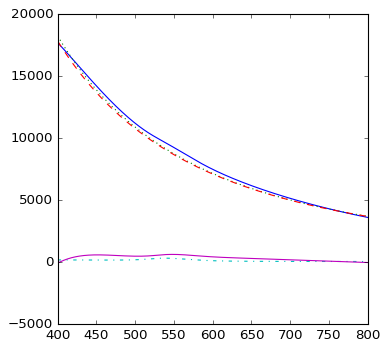

    548.23 ,	 [548.0, 577.04, 126.0, 1.58] 	 (-2.32, 9267.544)	 3.960 	 (-2.29, 9168.14) 	 0.333
	* Warning *: large scattering cross section:  [ 547.     612.671  127.       1.582]


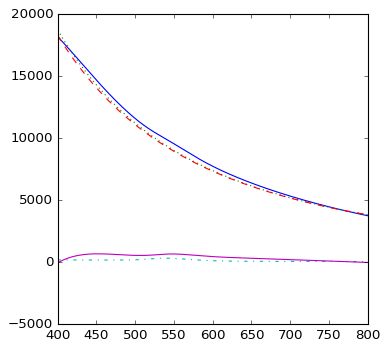

    546.93 ,	 [547.0, 612.67, 127.0, 1.58] 	 (-2.31, 9555.433)	 4.199 	 (-2.28, 9449.91) 	 0.336
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 1431.512]) 140.0 1.5821058963738435]


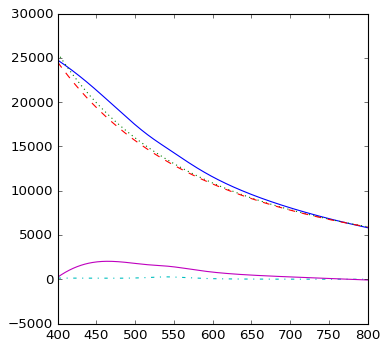

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 2764.704]) 150.0 1.5821058963738435]


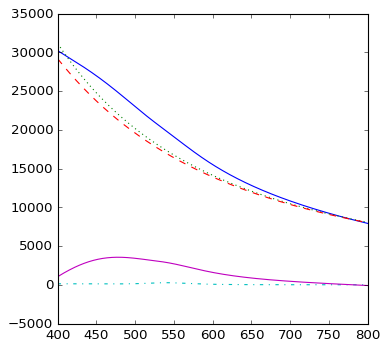

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5821058963738435]


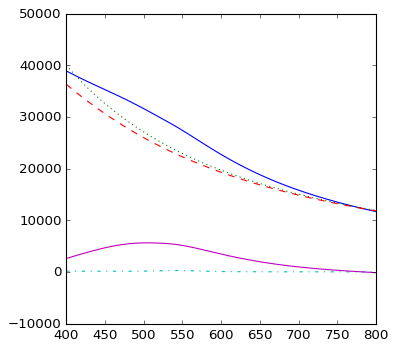

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5821058963738435]


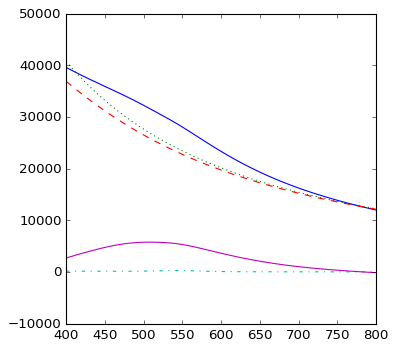

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5821058963738435]


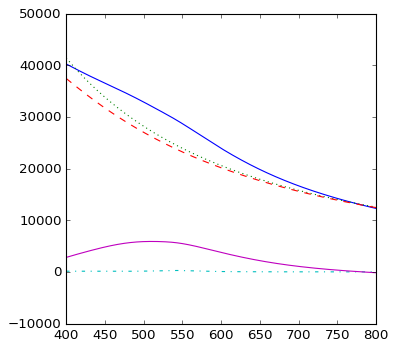

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 6407.727]) 170.0 1.5821058963738435]


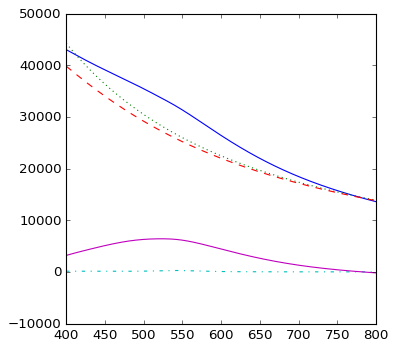

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 541.]) array([ 7552.313]) 180.0 1.5821058963738435]


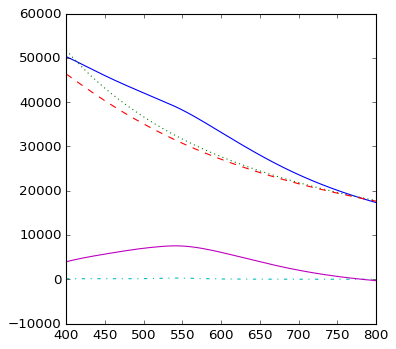

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 8651.544]) 200.0 1.5821058963738435]


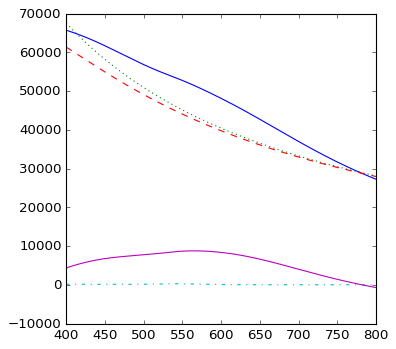

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 8795.075]) 210.0 1.5821058963738435]


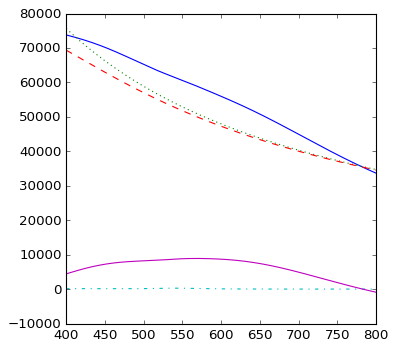

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 8913.143]) 217.0 1.5821058963738435]


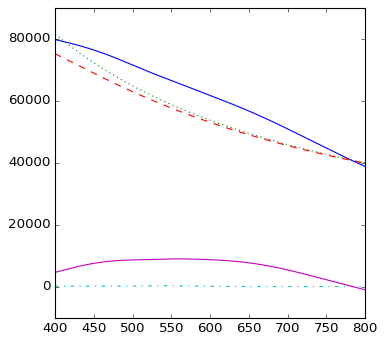

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 8922.036]) 218.0 1.5821058963738435]


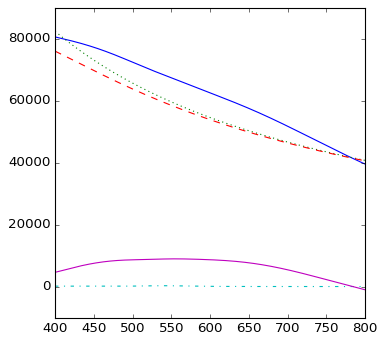

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 553.]) array([ 8938.575]) 219.0 1.5821058963738435]


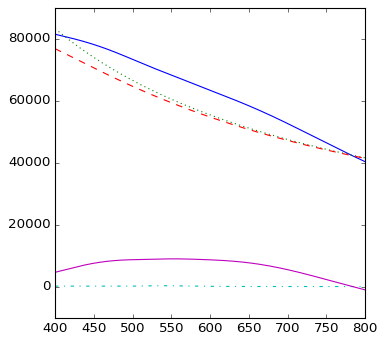

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 9106.161]) 230.0 1.5821058963738435]


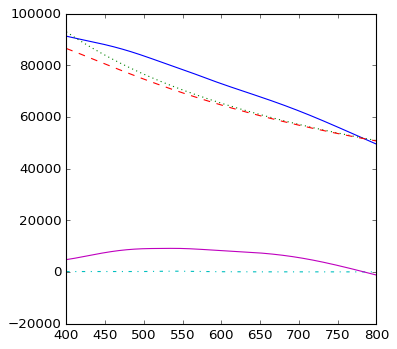

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 550.]) array([ 9701.542]) 260.0 1.5821058963738435]


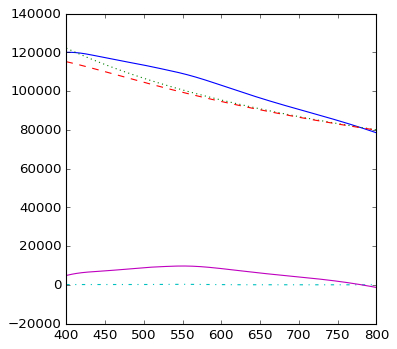

    532.52 ,	 [532.0, 220.72, 11.0, 1.59] 	 (-5.08, 28.523)	 1.481 	 (0.00, 1.00) 	 1.199
    535.72 ,	 [536.0, 242.72, 14.0, 1.59] 	 (-4.97, 30.963)	 1.639 	 (0.00, 1.00) 	 1.252
    536.32 ,	 [536.0, 247.05, 15.0, 1.59] 	 (-4.95, 31.503)	 1.668 	 (0.00, 1.00) 	 1.260
    536.83 ,	 [537.0, 250.54, 16.0, 1.59] 	 (-4.93, 31.978)	 1.694 	 (0.00, 1.00) 	 1.265
    537.21 ,	 [537.0, 253.45, 17.0, 1.59] 	 (-4.92, 32.417)	 1.713 	 (0.00, 1.00) 	 1.268
    538.02 ,	 [538.0, 259.94, 20.0, 1.59] 	 (-4.88, 33.695)	 1.760 	 (0.00, 1.00) 	 1.264
    538.2 ,	 [538.0, 261.65, 21.0, 1.59] 	 (-4.87, 34.159)	 1.771 	 (0.00, 1.00) 	 1.259
    538.35 ,	 [538.0, 263.21, 22.0, 1.59] 	 (-4.86, 34.664)	 1.782 	 (0.00, 1.00) 	 1.253
    538.48 ,	 [538.0, 264.66, 23.0, 1.59] 	 (-4.85, 35.222)	 1.792 	 (0.00, 1.00) 	 1.245
    538.59 ,	 [538.0, 266.02, 24.0, 1.59] 	 (-4.84, 35.846)	 1.801 	 (0.00, 1.00) 	 1.236
    538.81 ,	 [539.0, 268.66, 26.0, 1.59] 	 (-4.80, 37.351)	 1.822 	 (0.00, 1.00) 	 1.211
    539.16 

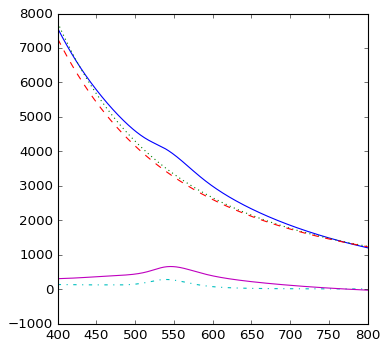

    545.93 ,	 [546.0, 655.84, 100.0, 1.59] 	 (-2.64, 3590.057)	 4.489 	 (-2.57, 3480.46) 	 0.333
	* Warning *: large scattering cross section:  [ 550.     615.787  110.       1.592]


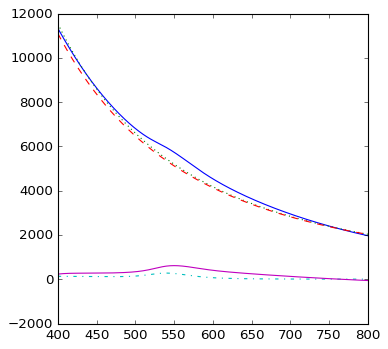

    550.37 ,	 [550.0, 615.79, 110.0, 1.59] 	 (-2.51, 5571.890)	 4.236 	 (-2.46, 5467.27) 	 0.321
	* Warning *: large scattering cross section:  [ 552.     551.736  120.       1.592]


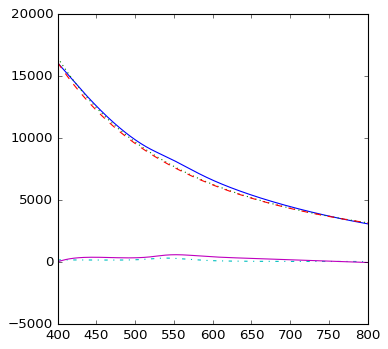

    552.68 ,	 [552.0, 551.74, 120.0, 1.59] 	 (-2.40, 8194.115)	 3.805 	 (-2.37, 8099.23) 	 0.319
	* Warning *: large scattering cross section:  [ 550.     593.527  125.       1.592]


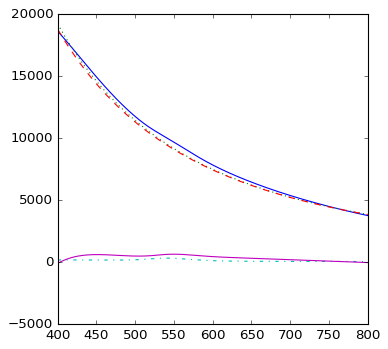

    549.82 ,	 [550.0, 593.53, 125.0, 1.59] 	 (-2.33, 9719.199)	 4.083 	 (-2.31, 9616.88) 	 0.329
	* Warning *: large scattering cross section:  [ 548.     630.08   126.       1.592]


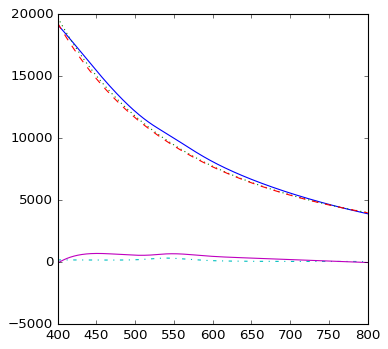

    548.45 ,	 [548.0, 630.08, 126.0, 1.59] 	 (-2.32, 10024.685)	 4.323 	 (-2.29, 9916.10) 	 0.333
	* Warning *: large scattering cross section:  [ 547.     651.982  127.       1.592]


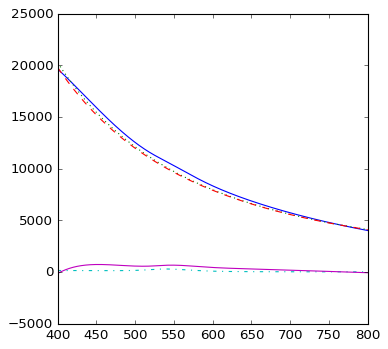

    547.22 ,	 [547.0, 651.98, 127.0, 1.59] 	 (-2.31, 10353.730)	 4.468 	 (-2.28, 10241.39) 	 0.337
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 1621.578]) 140.0 1.5921058963738435]


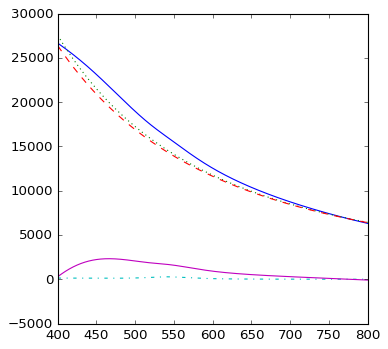

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 3135.657]) 150.0 1.5921058963738435]


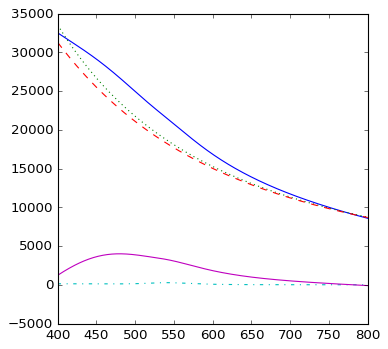

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5921058963738435]


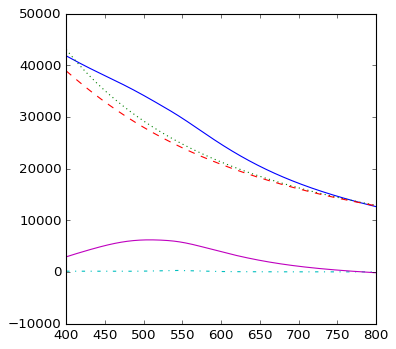

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5921058963738435]


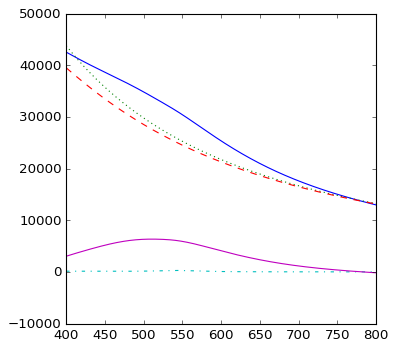

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5921058963738435]


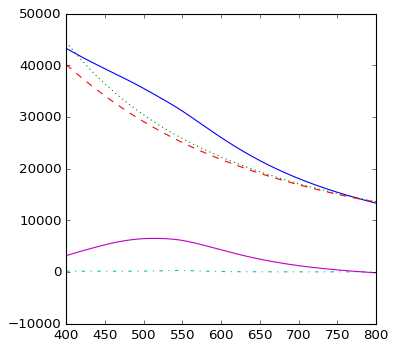

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 7025.644]) 170.0 1.5921058963738435]


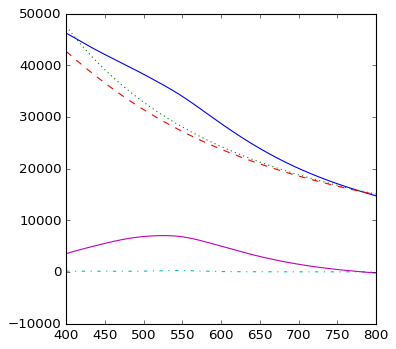

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 543.]) array([ 8211.099]) 180.0 1.5921058963738435]


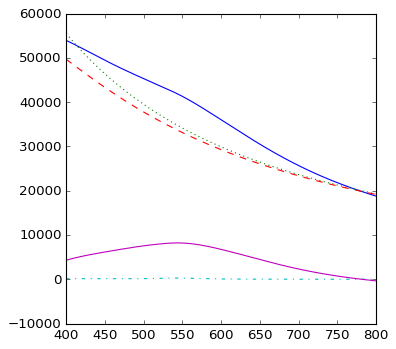

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 9337.24]) 200.0 1.5921058963738435]


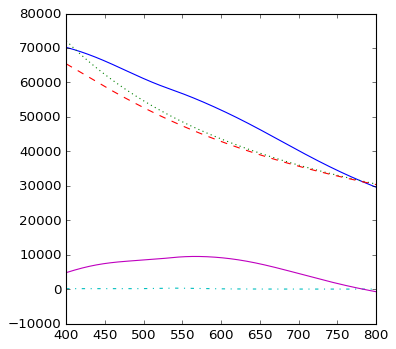

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 9487.979]) 210.0 1.5921058963738435]


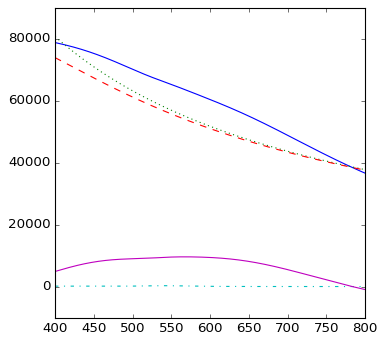

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 553.]) array([ 9562.63]) 217.0 1.5921058963738435]


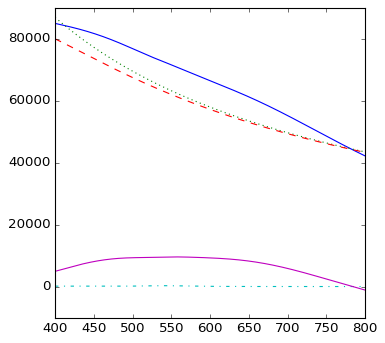

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 551.]) array([ 9570.5]) 218.0 1.5921058963738435]


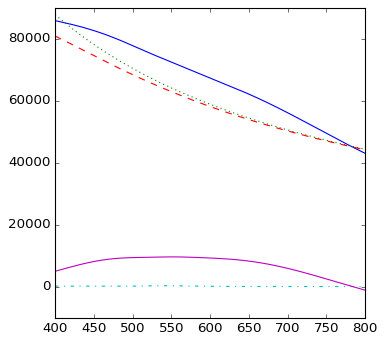

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 549.]) array([ 9581.933]) 219.0 1.5921058963738435]


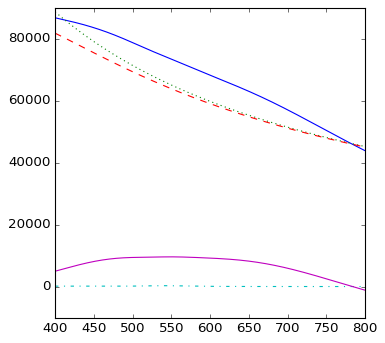

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 9821.969]) 230.0 1.5921058963738435]


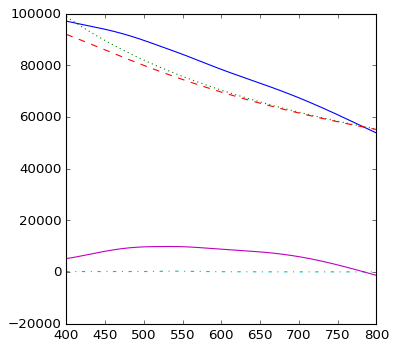

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 552.]) array([ 10730.323]) 260.0 1.5921058963738435]


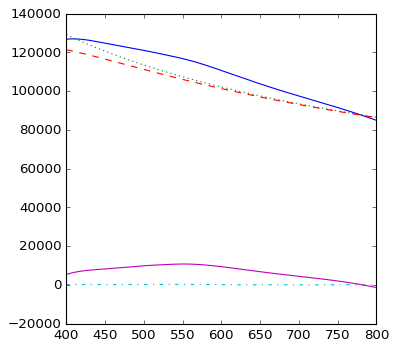

variable: 	 lsprMiePowrPeakWLnmArray
  * output array format: 
    [ peak-wl-nm, gamma, rShell-nm, nShell ]
variable: 	 lsprMiePowrBaselineList
  * output array format: 
    [ wl-nm-data, ext-orig-data, ext-scaling-factor, ext-corrected-data, baseline-correction-no-core-data, baseline-correction-data]
  * wavelength range: [ 400.0 , 800.0 ] x ( 401 values)
variable: 	 lsprMiePowrBaselinenkList
  * output array format: 
    [ x0, n0, k0 ]


In [32]:
threshold = .25
wlExpectednm = 535
dwlExpectednm = 20
wlScatnm = 400
x0base = wlExpectednm
nPeaks = 1
wlMin0nm, wlMax0nm = 400, 800
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm


%config InlineBackend.figure_format = 'png'
%config InlineBackend.rc = {'figure.figsize': (3.5, 3.5)}

print('LSPR peak wavelengths')
print('=====================')
print('Core-shell nanoparticles')
print('  * power law baseline fit')
print('    - of the form ybase = k*(x/x0)^n')
print('    - using log-log/linear fitting with x0 =',x0base)
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('    - baseline correction range [', wlMin0nm, ',', wlMax0nm, '] nm')
print('Peaks detected: \n    wl-nm,\t [wl-nm, ext, rShell-nm, nShell]',
     '\t (n0, k0)', '\t scal.',  '\t (n, k)', '\t gamma')

lsprMiePowrPeakWLnmList = []
lsprMiePowrBaselineList = []
lsprMiePowrBaselinenkList = []
x = []

gammaCoreRef = lsprMiePowrPeakWLnmCoreList[0][-1]


for nShell in nShellList:
    lsprPeakWLnmSubList = []
    for rShellnm in rShellListnm:
        xPeakPrev = wlExpectednm
        if len(lsprPeakWLnmSubList) > 0: xPeakPrev = lsprPeakWLnmSubList[-1][0]
        subdataArray = mieCextCoreShellArray
        selection = (
            (subdataArray[:,0] >= wlMin0nm) 
            & (subdataArray[:,0] <= wlMax0nm) 
            & (subdataArray[:,1] == nShell)
            & (subdataArray[:,2] == rShellnm)
        )
        subdataArray = subdataArray[selection]
        sort = np.argsort(subdataArray[:,0])
        subdataArray = subdataArray[sort]
        minDist = int(subdataArray[:,0].size/(nPeaks+1))

        x, y = subdataArray[:,0], subdataArray[:,-3]
        yCore = subdataArray[:,-2]
        yOrig = y

        logx, logy = np.log(x/x0base), np.log(y)
        dlogx = min(np.abs(np.diff(logx)))
        loglogx = np.arange(min(logx), max(logx) + dlogx, dlogx)
        logy0base = 1.01*min(logy)
        loglogy = np.interp(loglogx, logx, logy - logy0base)

        loglogyLinBase = peakutils.baseline(loglogy, 1)
        logyLinBase = np.interp(logx, loglogx, loglogyLinBase) + logy0base
        loglogfit = np.polyfit(logx, logyLinBase, 1)
        basePowrn0, baseCoeffk0 = loglogfit[0], np.exp(loglogfit[1])

        yPowrBase = (np.exp(logyLinBase))
        y = y - yPowrBase
        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = anArray[selection][:,1].astype(int)
        # if no peaks:
        if (len(indexes) == 0): 
            selection = (x >= wlMinnm) & (x <= wlMaxnm)
            xzoom, yzoom = x[selection], y[selection]
            indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
            indexes = indexeszoom + int(wlMinnm - wlMin0nm)
            if (len(indexes) == 0): 
                indexes = np.argsort(np.abs(x - xPeakPrev))[[0]]
        xPeaks = x[indexes]

        selection = ( (x >= wlMin0nm)
                     & (x <= wlMax0nm)
                     )
        yCorePowrBase = np.asarray(lsprMiePowrBaselineCoreList[0][-1])[selection]
        yCorePeak = lsprMiePowrBaselineCoreList[0][2]
        scaling = 1*y[indexes][0]/yCorePeak
        y = y + yCorePowrBase*scaling

        # fit [(base) - (core base)] to power law
        yPowrBaseTotal = yPowrBase - yCorePowrBase*scaling
        logy = np.log(yPowrBaseTotal)
        if min(yPowrBaseTotal) > 0: 
            logy = np.log(yPowrBaseTotal)
            loglogfit = np.polyfit(logx, logy, 1)
        else: loglogfit = [0, 0]
        basePowrn, baseCoeffk = loglogfit[0], np.exp(loglogfit[1])

        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = anArray[selection][:,1].astype(int)
        # if no peaks:
        if (len(indexes) == 0): 
            selection = (x >= wlMinnm) & (x <= wlMaxnm)
            xzoom, yzoom = x[selection], y[selection]
            indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
            indexes = indexeszoom + int(wlMinnm - wlMin0nm)
            if (len(indexes) == 0): 
                indexes = np.argsort(np.abs(x - xPeakPrev))[[0]]
        xPeaks = x[indexes]

        # iterate 
        for i in range(3):
            oldScaling = scaling
            scaling = 1*(y[indexes[0]] - yCorePowrBase[indexes[0]]*scaling)/yCorePeak
            if ( abs(1-oldScaling/scaling) < 0.01 ): break

            y = yOrig - yPowrBase + yCorePowrBase*scaling
            indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
            xPeaks = x[indexes]
            anArray = (np.array([xPeaks, indexes])).T
            selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
            indexes = anArray[selection][:,1].astype(int)
            # if no peaks:
            if (len(indexes) == 0): 
                selection = (x >= wlMinnm) & (x <= wlMaxnm)
                xzoom, yzoom = x[selection], y[selection]
                indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
                indexes = indexeszoom + (wlMinnm - wlMin0nm)
            if (len(indexes) == 0): break

        yCoreMax = max(yCore)
        yMax = max(y)
        result = np.array([ x[indexes], y[indexes], rShellnm, nShell ])
        if ( (len(indexes) > 0) & (yMax/yCoreMax < 4) ): 
            result = np.array([ x[indexes[0]], y[indexes[0]], rShellnm, nShell ])
            
            # problems with large scattering cross sections
            if (baseCoeffk0 > 3e3): 
                print('\t* Warning *: large scattering cross section: ', result )
                pylab.cla()
                pylab.plot(x,yOrig,'-')
                pylab.plot(x,yPowrBase,':')
                pylab.plot(x,yPowrBase-yCorePowrBase*scaling,'--')
                pylab.plot(x, yCore, '-.')
                pylab.plot(x,y,'-')
                pylab.show()

            xPeaks = peakutils.interpolate(x, y, ind=indexes)
            xPeak = xPeaks[0]
            if ( (xPeak < wlMaxnm) & (xPeak > wlMinnm) ):
                select = (np.abs(x-xPeak) < 0.55)
                yPeak = yOrig[select][0]
                select = (np.abs(x-wlScatnm) < 0.55)
                yScat = yOrig[select][0]
                gamma = (yPeak/yScat)/gammaCoreRef

                print('   ', round(100*xPeak)/100,',\t',  
                      (np.round(100*result[:])/100).tolist(),
                      '\t ({0:.2f}, {1:.3f})\t {2:.3f}'.format(basePowrn0, baseCoeffk0, scaling),
                      '\t ({0:.2f}, {1:.2f})'.format(basePowrn, baseCoeffk),
                      '\t {0:.3f}'.format(gamma)
                     )

                result = [xPeak, gamma, rShellnm, nShell]
                lsprMiePowrPeakWLnmList.append(result)
                lsprMiePowrBaselineList.append([x, yOrig, scaling, y, yPowrBase, 
                                             yPowrBase-yCorePowrBase*scaling])
                lsprMiePowrBaselinenkList.append([x0base, basePowrn0, baseCoeffk0])
                result = [xPeaks[0], result[-3], result[-2]]
                lsprPeakWLnmSubList.append(result)

        else: # if no peaks detected
            if (len(indexes) > 0): 
                print('\t* Error *: large difference between bare-core and subtracted core-shell models: ', result )
            else: print('\t* Error *: no peaks detected in range: ', result )
            pylab.cla()
            pylab.plot(x,yOrig,'-')
            pylab.plot(x,yPowrBase,':')
            pylab.plot(x,yPowrBase-yCorePowrBase*scaling,'--')
            pylab.plot(x, yCore, '-.')
            pylab.plot(x,y,'-')
            pylab.show()


if len(lsprPeakWLnmSubList) == 0: lsprPeakWLnmSubList.append( [0,0,0] )
lsprPeakWLnmSubList = np.asarray(lsprPeakWLnmSubList)

lsprMiePowrPeakWLnmArray = np.asarray(lsprMiePowrPeakWLnmList)
print('variable: \t lsprMiePowrPeakWLnmArray')
print("  * output array format: \n    [ peak-wl-nm, gamma, rShell-nm, nShell ]")
print('variable: \t lsprMiePowrBaselineList')
print("  * output array format: \n",
      "   [ wl-nm-data, ext-orig-data, ext-scaling-factor, ext-corrected-data,",
      "baseline-correction-no-core-data, baseline-correction-data]")
print('  * wavelength range: [',x[0],',',x[-1],'] x (',len(x), 'values)')
print('variable: \t lsprMiePowrBaselinenkList')
print("  * output array format: \n    [ x0, n0, k0 ]")

%config InlineBackend.figure_format = 'svg'
%config InlineBackend.rc = {'font.size': 12, 'figure.figsize': (5.0, 5.0), 'figure.facecolor': 'white', 'savefig.dpi': 72, 'figure.subplot.bottom': 0.125, 'figure.edgecolor': 'white'}


### Core spectrum analysis, in shell-like homogeneous medium = 'bare-core' model

#### Core spectrum without power law baseline

In [74]:
threshold = .25
wlExpectednm = 535
dwlExpectednm = 13
wlScatnm = 400
x0base = wlExpectednm
nPeaks = 1
wlMin0nm, wlMax0nm = 400, 800
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier0 = "lspr-peaks_baseline-powr"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'orig-wl-nm', 'temp-C', 'Rh-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('Core-shell nanoparticles')
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('    - baseline correction range [', wlMin0nm, ',', wlMax0nm, '] nm')
print('Peaks detected: \n    wl-nm,\t [wl-nm, ext, nShell]',
      '\t gamma')

lsprMieCorePeakWLnmList = []
x = []

gammaCoreRef = lsprMiePowrPeakWLnmCoreList[0][-1]

for nShell in nShellList:
    lsprPeakWLnmSubList = []
    for rShellnm in rShellListnm[[0]]:
        xPeakPrev = wlExpectednm
        if len(lsprPeakWLnmSubList) > 0: xPeakPrev = lsprPeakWLnmSubList[-1][0]
        subdataArray = mieCextCoreShellArray
        selection = (
            (subdataArray[:,0] >= wlMin0nm) 
            & (subdataArray[:,0] <= wlMax0nm) 
            & (subdataArray[:,1] == nShell)
            & (subdataArray[:,2] == rShellnm)
        )
        subdataArray = subdataArray[selection]
        sort = np.argsort(subdataArray[:,0])
        subdataArray = subdataArray[sort]
        minDist = int(subdataArray[:,0].size/(nPeaks+1))

        x, y = subdataArray[:,0], subdataArray[:,-2]

        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = anArray[selection][:,1].astype(int)
        # if no peaks:
        if (len(indexes) == 0): 
            selection = (x >= wlMinnm) & (x <= wlMaxnm)
            xzoom, yzoom = x[selection], y[selection]
            indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
            indexes = indexeszoom + int(wlMinnm - wlMin0nm)
            if (len(indexes) == 0): 
                indexes = np.argsort(np.abs(x - xPeakPrev))[[0]]
        xPeaks = x[indexes]

        if (len(indexes) > 0): 
            result = np.array([ x[indexes[0]], y[indexes[0]], nShell ])
            xPeaks = peakutils.interpolate(x, y, ind=indexes)

            xPeak = xPeaks[0]
            select = (np.abs(x-xPeak) < 0.55)
            yPeak = y[select][0]
            select = (np.abs(x-wlScatnm) < 0.55)
            yScat = y[select][0]
            gamma = (yPeak/yScat)/gammaCoreRef

            print('   ', round(100*xPeak)/100,',\t',  
                  (np.round(100*result[:])/100).tolist(),
                  '\t {0:.3f}'.format(gamma)
                 )

            result = [xPeak, result[1], gamma, nShell]
            lsprMieCorePeakWLnmList.append(result)
            result = [xPeaks[0], result[-3], result[-2]]
            lsprPeakWLnmSubList.append(result)

        else: # if no peaks detected
            print('\t* Error *: no peaks detected in range', (rShellnm, nShell) )
            pylab.cla()
            pylab.plot(x,yOrig,'-')
            pylab.plot(x,yPowrBase,':')
            pylab.plot(x,yPowrBase-yCorePowrBase*scaling,'--')
            pylab.plot(x,y,'-')
            pylab.show()
            
    if len(lsprPeakWLnmSubList) == 0: lsprPeakWLnmSubList.append( [0,0,0] )
    lsprPeakWLnmSubList = np.asarray(lsprPeakWLnmSubList)
    identifier = '_' + identifier0 + '_' + str(sampleNum) + '-' + sampleType
    filename = folder + timestamp + identifier + exportFormat
    #np.savetxt(filename, lsprPeakWLnmSubList, delimiter='\t', header=datHeader, fmt='%.2f')
    #print('      + saved to', filename) 

lsprMieCorePeakWLnmArray = np.asarray(lsprMieCorePeakWLnmList)
print('variable: \t lsprMieCorePeakWLnmArray')
print("  * output array format: \n    [ peak-wl-nm, CextAtPeak-nm2, gamma, nShell ]")


LSPR peak wavelengths
Core-shell nanoparticles
  * looking for one peak at 535 nm 
    - in the range [ 522 , 548 ] nm
    - baseline correction range [ 400 , 800 ] nm
Peaks detected: 
    wl-nm,	 [wl-nm, ext, nShell] 	 gamma
    503.33 ,	 [535.0, 80.66, 1.2] 	 0.777
    505.05 ,	 [535.0, 84.06, 1.21] 	 0.799
    506.68 ,	 [535.0, 87.58, 1.22] 	 0.821
    508.23 ,	 [535.0, 91.23, 1.23] 	 0.833
    509.69 ,	 [535.0, 95.01, 1.24] 	 0.856
    511.09 ,	 [535.0, 98.92, 1.25] 	 0.870
    512.41 ,	 [535.0, 102.96, 1.26] 	 0.884
    513.68 ,	 [535.0, 107.13, 1.27] 	 0.906
    514.88 ,	 [535.0, 111.43, 1.28] 	 0.920
    516.04 ,	 [535.0, 115.87, 1.29] 	 0.935
    517.14 ,	 [535.0, 120.44, 1.3] 	 0.949
    518.19 ,	 [535.0, 125.15, 1.31] 	 0.963
    522.67 ,	 [523.0, 146.75, 1.32] 	 0.989
    523.17 ,	 [523.0, 150.96, 1.33] 	 1.000
    523.69 ,	 [524.0, 155.24, 1.34] 	 1.012
    524.2 ,	 [524.0, 159.6, 1.35] 	 1.023
    524.74 ,	 [525.0, 164.03, 1.36] 	 1.035
    525.26 ,	 [525.0, 168.52, 1.37] 

### Shell spectrum analysis, without core = 'empty shell' model

#### Hard sphere

In [75]:
wlScatnm = 400
wlMin0nm, wlMax0nm = 400, 800
printFlag = False

print('Scattering power-law fit')
print('=====================')
print('Empty-shell nanoparticles')
print('  * power law baseline fit')
print('    - of the form ybase = y0*(x/x0)^k')
print('    - using log-log/linear fitting')
print('    - baseline fit range [', wlMin0nm, ',', wlMax0nm, '] nm')
if (printFlag):
    print('Baseline parameters:') 
    print('\t', '[rShell-nm, nShell, x0-nm]',
         '\t', '[y0, k, y0/x0^k]', '\t', 'gamma')

lsprMieShellPowrBaselineList = []
x = []

gammaCoreRef = lsprMiePowrPeakWLnmCoreList[0][-1]

for nShell in nShellList:
    
    select = (lsprMieCorePeakWLnmArray[:, -1] == nShell)
    x0 = lsprMieCorePeakWLnmArray[select][0,0]
    
    for rShellnm in rShellListnm:
        
        subdataArray = mieCextCoreShellArray
        select = (
            (subdataArray[:,0] >= wlMin0nm) 
            & (subdataArray[:,0] <= wlMax0nm) 
            & (subdataArray[:,1] == nShell)
            & (subdataArray[:,2] == rShellnm)
        )
        subdataArray = subdataArray[select]
        sort = np.argsort(subdataArray[:,0])
        subdataArray = subdataArray[sort]

        x, y = subdataArray[:,0], subdataArray[:,-3]

        logx, logy = np.log(x/x0), np.log(y)
        k, logy0 = np.polyfit(logx, logy, 1)
        y0 = np.exp(logy0)
        C0 = y0/(x0**k)

        select = (np.abs(x-x0) <= 0.5)
        yPeak = y[select][0]
        select = (np.abs(x-wlScatnm) <= 0.5)
        yScat = y[select][0]
        gamma = (yPeak/yScat)/gammaCoreRef
        
        if (printFlag):
            print( '\t', '[{0:.2f}, {1:.2f}, {2:.2f}]'.format(rShellnm, nShell, x0),
                   ' \t', '[{0:.3e}, {1:.2f}, {2:.3e}]'.format(y0, k, C0), 
                   '\t', '{0:.3f}'.format(gamma) )

        result = [nShell, rShellnm, x0, y0, C0, k, gamma]
        lsprMieShellPowrBaselineList.append(result)


lsprMieShellPowrBaselineArray = np.array(lsprMieShellPowrBaselineList)
print('variable: \n\t lsprMieShellPowrBaselineArray')
print("  * output array format: \n\t",
      "[ nShell, rShell-nm, x0, y0, C0, k, gamma ]")

Scattering power-law fit
Empty-shell nanoparticles
  * power law baseline fit
    - of the form ybase = y0*(x/x0)^k
    - using log-log/linear fitting
    - baseline fit range [ 400 , 800 ] nm
variable: 
	 lsprMieShellPowrBaselineArray
  * output array format: 
	 [ nShell, rShell-nm, x0, y0, C0, k, gamma ]


### Peak adjusted core-shell spectrum

There is a known discrepancy between J&C peak positions and experiment. This uses 'bare-cores' and 'empty-shells' with different refractive indexes to simulate the correct spectrum. 

#### Difference in peak position between Mie theory with J&C and experiment for bare cores in water ($\Delta\lambda_0$)

In [196]:
mieWL0nm = lsprMiePeakWLnmCoreArray[0,0]
expWL0nm = np.mean(lsprPeakWLnmCoreArray[:,0])
dWL0nm = mieWL0nm - expWL0nm
print('(mieWL0nm, expWL0nm, dWL0nm) = ',(mieWL0nm, expWL0nm, dWL0nm))

(mieWL0nm, expWL0nm, dWL0nm) =  (523.16651621268647, 518.63441748824675, 4.5320987244397202)


#### Extrapolate RI difference ($\Delta\lambda_0 \rightarrow \Delta n_{\mathrm{Mie}}$)

$\Delta n_{\mathrm{Mie}} = n_{\mathrm{bare-core}} - n_{\mathrm{empty-shell}}$

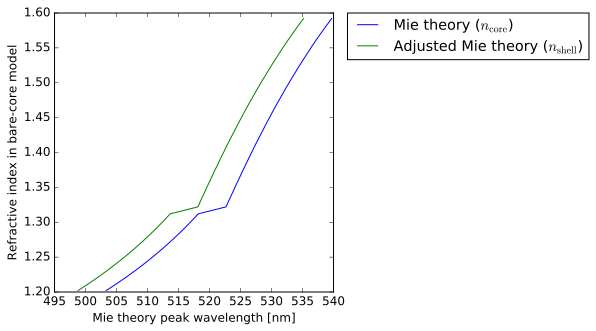

In [93]:
pylab.cla()

x, y = lsprMieCorePeakWLnmArray.T[[0,-1]]
pylab.plot(x,y, label='Mie theory ($n_{\mathrm{core}}$)')

x = x - dWL0nm
pylab.plot(x, y, label='Adjusted Mie theory ($n_{\mathrm{shell}}$)')

pylab.xlabel('Mie theory peak wavelength [nm]')
pylab.ylabel('Refractive index in bare-core model')
pylab.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
pylab.show()

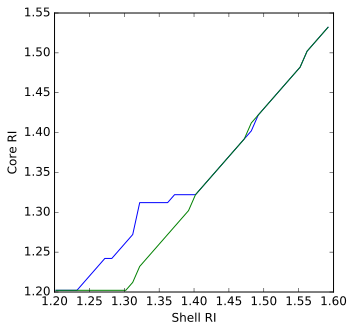

In [190]:
x, y = [], []
imask, jmask = [], []
for elem in lsprMieCorePeakWLnmArray:
    shellWL0nm, Cext0, gamma, nShell = elem
    i = np.arange(len(nShellList))[np.argsort(np.abs(nShell - nShellList))][0]
    coreWL0nm = shellWL0nm - dWL0nm
    sort = np.argsort(np.abs(lsprMieCorePeakWLnmArray[:,0] - coreWL0nm))
    nCore = lsprMieCorePeakWLnmArray[sort][0,-1]
    j = np.arange(len(nShellList))[np.argsort(np.abs(nCore - nShellList))][0]
    x.append(nShell), y.append(nCore)
    imask.append(i), jmask.append(j)
pylab.plot(x, y)

shellIndexArray = np.array(imask).astype(int)
coreIndexArray = np.array(jmask).astype(int)

select = ( (coreIndexArray > 0) & (nShellList > 1.4)  )
fit = np.polyfit(shellIndexArray[select], coreIndexArray[select], 1)
f = np.poly1d(fit)
def g (i): 
    result = f(i)
    if f(i) < 0: result = 0
    return result
coreIndexArray = np.round(np.array([g(i) for i in shellIndexArray])).astype(int)
yfit = [nShellList[j] for j in coreIndexArray]

pylab.plot(x, yfit)


pylab.xlabel('Shell RI')
pylab.ylabel('Core RI')
pylab.show()


#### Build core-shell model from shell and adjusted core

In [193]:
# adjusted core-shells in water

print('''\
Adjusted core-shell model
=====================
* Empty-shell nanoparticles
* Bare-cores with different RI
* Fixes known peak position error with J&C cores
* Building ({:%Y-%m-%d %H:%M:%S}) ...  \
'''.format(datetime.datetime.now()))

subArray = mieCextCoreShellArray

select = (mieCextCoreShellArray[:,2] == rShellListnm[0])
coreArray = mieCextCoreShellArray[select]

def mapToAdjMie(elem):
    wlnm, nShell, rShellnm, rCorenm, CextCoreShell0, CextShellCore, CextShell = elem

    i = np.where(nShellList == nShell)[0][0]
    CextShellCoreMax = lsprMieCorePeakWLnmArray[i,1]
    
    j = (coreIndexArray[i])
    nCore = nShellList[j]
    CextCoreCoreMax = lsprMieCorePeakWLnmArray[j,1]
    scaling = CextShellCoreMax/CextCoreCoreMax
    
    i = np.where((coreArray[:,0] == wlnm) & (coreArray[:,1] == nCore))[0][0]
    CextCore = scaling*coreArray[i,-2]
    
    elem = [
        wlnm, nShell, rShellnm, nCore, rCorenm, scaling, CextCore, CextShell + CextCore
    ]

    return elem

mieAdjCextCoreShellArray = np.array(list(map(mapToAdjMie, subArray)))

print('''      ... done ({2:%Y-%m-%d %H:%M:%S}).
  + variable
    - \"mieAdjCextCoreShellArray\" = adjusted core-shell model to fix J&C error
    - type:\t{0}
    - size:\t{1} 
    - element structure:\t[ wl-nm, nShell, rShell-nm, nCore, rCore-nm, scaling, CextCore-nm2, CextCoreShell-nm2 ] \
'''.format(
    type(mieAdjCextCoreShellArray), 
    np.shape(np.asarray(mieAdjCextCoreShellArray)), 
    datetime.datetime.now()
)
     )


Adjusted core-shell model
* Empty-shell nanoparticles
* Bare-cores with different RI
* Fixes known peak position error with J&C cores
* Building (2017-03-21 19:58:20) ...  
      ... done (2017-03-21 19:59:58).
  + variable
    - "mieAdjCextCoreShellArray" = adjusted core-shell model to fix J&C error
    - type:	<class 'numpy.ndarray'>
    - size:	(1394320, 8) 
    - element structure:	[ wl-nm, nShell, rShell-nm, nCore, rCore-nm, scaling, CextCore-nm2, CextCoreShell-nm2 ] 


#### Core-shell spectrum analysis

LSPR peak wavelengths
Core-shell nanoparticles
  * power law baseline fit
    - of the form ybase = k*(x/x0)^n
    - using log-log/linear fitting with x0 = 535
  * looking for one peak at 535 nm 
    - in the range [ 515 , 555 ] nm
    - baseline correction range [ 400 , 800 ] nm
Peaks detected: 
    wl-nm,	 [wl-nm, ext, rShell-nm, nShell] 	 (n0, k0) 	 scal. 	 (n, k) 	 gamma
    516.93 ,	 [517.0, 100.6, 11.0, 1.2] 	 (-5.72, 15.400)	 0.659 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 100.6, 14.0, 1.2] 	 (-5.72, 15.414)	 0.659 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 100.6, 15.0, 1.2] 	 (-5.72, 15.423)	 0.659 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 100.6, 16.0, 1.2] 	 (-5.71, 15.436)	 0.659 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 100.6, 17.0, 1.2] 	 (-5.71, 15.453)	 0.659 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 100.58, 20.0, 1.2] 	 (-5.70, 15.546)	 0.658 	 (0.00, 1.00) 	 0.866
    516.93 ,	 [517.0, 100.58, 21.0, 1.2] 	 (-5.70, 15.595)	 0.658 	 (-9.40, 1.29) 	 0.865
   

C:\Users\fit\Anaconda3\lib\site-packages\ipykernel\__main__.py:92: RuntimeWarning: invalid value encountered in log


[517.0, 100.57, 22.0, 1.2] 	 (-5.69, 15.658)	 0.658 	 (-8.84, 1.39) 	 0.863
    516.94 ,	 [517.0, 100.55, 23.0, 1.2] 	 (-5.68, 15.736)	 0.658 	 (-8.36, 1.50) 	 0.862
    516.94 ,	 [517.0, 100.54, 24.0, 1.2] 	 (-5.67, 15.833)	 0.658 	 (-7.93, 1.62) 	 0.860
    516.94 ,	 [517.0, 100.5, 26.0, 1.2] 	 (-5.64, 16.093)	 0.658 	 (-7.18, 1.93) 	 0.854
    516.95 ,	 [517.0, 100.34, 31.0, 1.2] 	 (-5.52, 17.322)	 0.657 	 (-5.78, 3.25) 	 0.829
    516.95 ,	 [517.0, 100.29, 32.0, 1.2] 	 (-5.48, 17.705)	 0.656 	 (-5.57, 3.65) 	 0.822
    516.95 ,	 [517.0, 100.23, 33.0, 1.2] 	 (-5.44, 18.146)	 0.656 	 (-5.38, 4.10) 	 0.814
    516.96 ,	 [517.0, 100.11, 34.0, 1.2] 	 (-5.40, 18.693)	 0.655 	 (-5.22, 4.66) 	 0.805
    516.97 ,	 [517.0, 100.05, 35.0, 1.2] 	 (-5.35, 19.271)	 0.655 	 (-5.07, 5.24) 	 0.796
    516.97 ,	 [517.0, 99.98, 36.0, 1.2] 	 (-5.30, 19.927)	 0.654 	 (-4.93, 5.89) 	 0.785
    516.98 ,	 [517.0, 99.91, 37.0, 1.2] 	 (-5.24, 20.668)	 0.654 	 (-4.80, 6.63) 	 0.774
    516.98 ,	 [517.0, 99.83

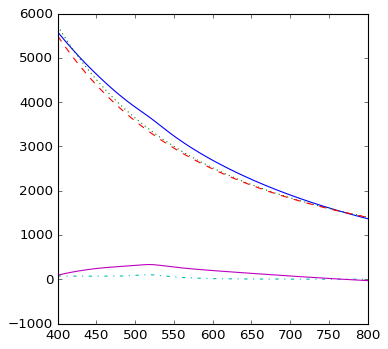

    516.71 ,	 [517.0, 333.07, 140.0, 1.2] 	 (-2.03, 3173.117)	 2.180 	 (-1.98, 3116.60) 	 0.418
	* Warning *: large scattering cross section:  [ 517.      381.9202  150.        1.2021]


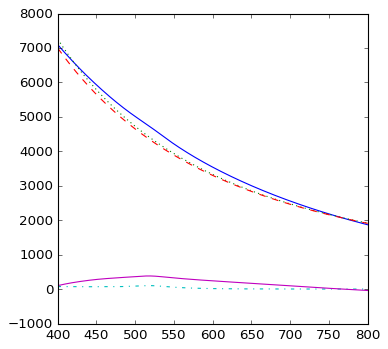

    517.07 ,	 [517.0, 381.92, 150.0, 1.2] 	 (-1.92, 4149.901)	 2.499 	 (-1.88, 4084.35) 	 0.425
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 458.7348]) 164.0 1.2021058963738431]


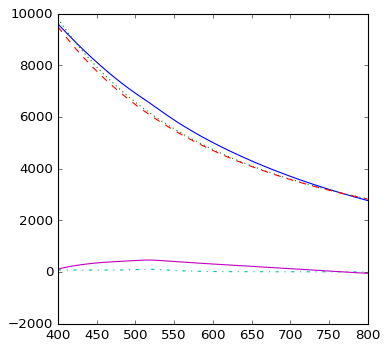

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 465.14]) 165.0 1.2021058963738431]


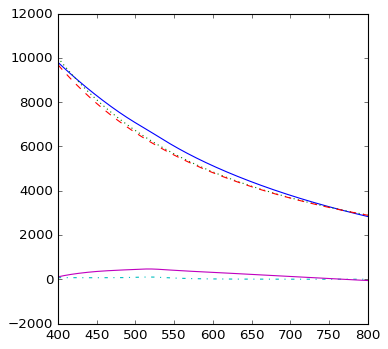

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 471.7393]) 166.0 1.2021058963738431]


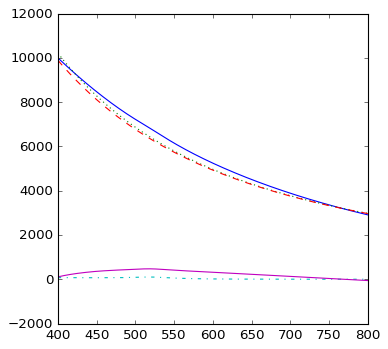

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 500.3902]) 170.0 1.2021058963738431]


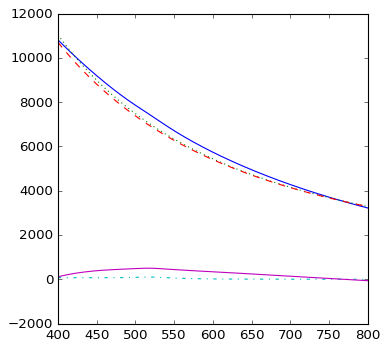

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 610.6002]) 180.0 1.2021058963738431]


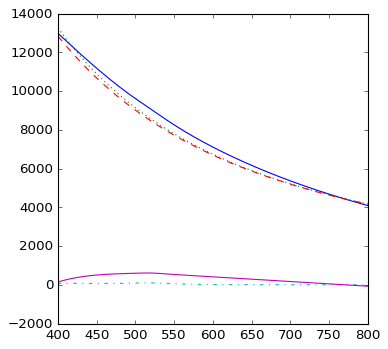

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1011.4752]) 200.0 1.2021058963738431]


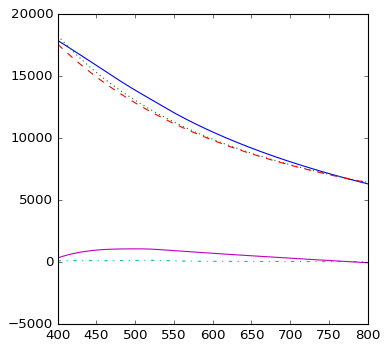

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1330.2604]) 210.0 1.2021058963738431]


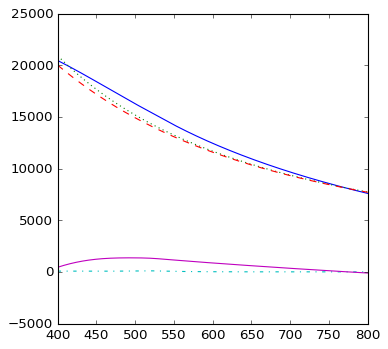

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1581.4591]) 217.0 1.2021058963738431]


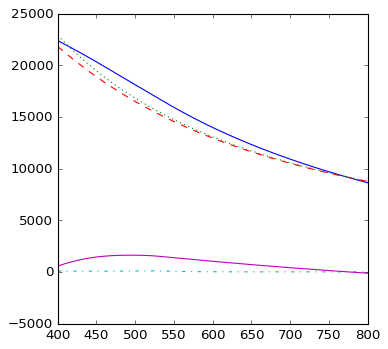

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1619.484]) 218.0 1.2021058963738431]


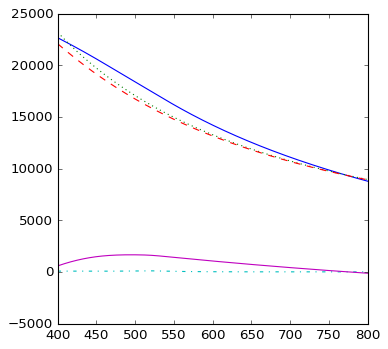

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1657.9443]) 219.0 1.2021058963738431]


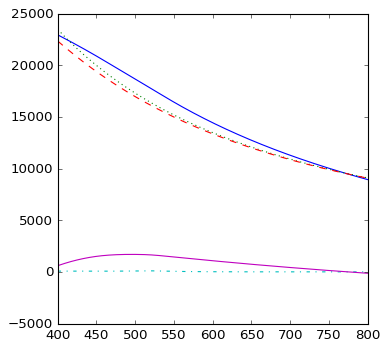

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 2126.0042]) 230.0 1.2021058963738431]


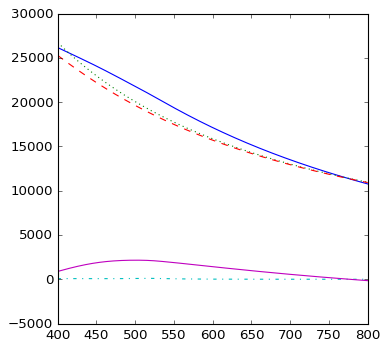

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 3075.5993]) 260.0 1.2021058963738431]


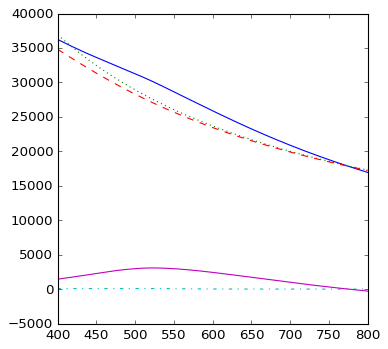

    516.93 ,	 [517.0, 104.84, 11.0, 1.21] 	 (-5.72, 16.049)	 0.686 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 104.84, 14.0, 1.21] 	 (-5.72, 16.060)	 0.686 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 104.84, 15.0, 1.21] 	 (-5.72, 16.068)	 0.686 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 104.84, 16.0, 1.21] 	 (-5.72, 16.079)	 0.686 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 104.84, 17.0, 1.21] 	 (-5.71, 16.094)	 0.686 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 104.83, 20.0, 1.21] 	 (-5.71, 16.172)	 0.686 	 (0.00, 1.00) 	 0.867
    516.93 ,	 [517.0, 104.82, 21.0, 1.21] 	 (-5.70, 16.215)	 0.686 	 (-9.93, 1.28) 	 0.866
    516.93 ,	 [517.0, 104.81, 22.0, 1.21] 	 (-5.70, 16.268)	 0.686 	 (-9.24, 1.37) 	 0.865
    516.94 ,	 [517.0, 104.8, 23.0, 1.21] 	 (-5.69, 16.335)	 0.686 	 (-8.72, 1.47) 	 0.863
    516.94 ,	 [517.0, 104.79, 24.0, 1.21] 	 (-5.68, 16.417)	 0.686 	 (-8.27, 1.58) 	 0.861
    516.94 ,	 [517.0, 104.76, 26.0, 1.21] 	 (-5.66, 16.639)	 0.686 	 (-7.49, 1.86) 	 0.857
    51

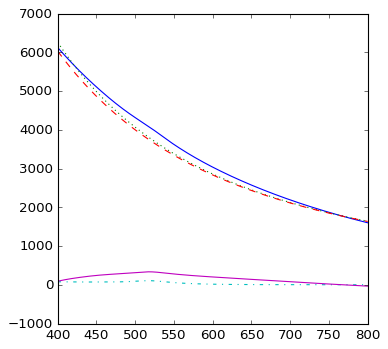

    517.29 ,	 [518.0, 335.26, 150.0, 1.21] 	 (-1.93, 3568.715)	 2.198 	 (-1.89, 3511.23) 	 0.424
	* Warning *: large scattering cross section:  [ 517.      398.3974  164.        1.2121]


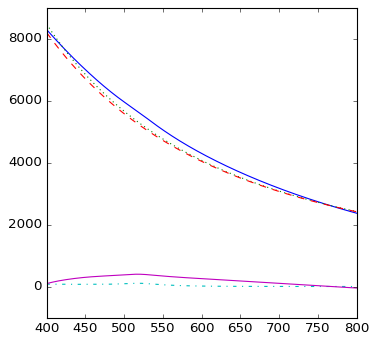

    517.01 ,	 [517.0, 398.4, 164.0, 1.21] 	 (-1.81, 5006.650)	 2.607 	 (-1.77, 4937.44) 	 0.433
	* Warning *: large scattering cross section:  [ 517.      403.8888  165.        1.2121]


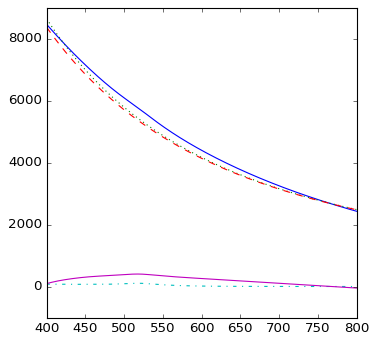

    516.93 ,	 [517.0, 403.89, 165.0, 1.21] 	 (-1.80, 5121.379)	 2.643 	 (-1.76, 5051.16) 	 0.434
	* Warning *: large scattering cross section:  [ 517.      409.5811  166.        1.2121]


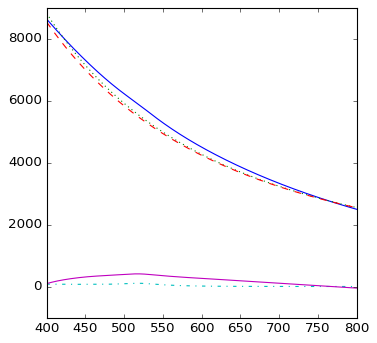

    516.84 ,	 [517.0, 409.58, 166.0, 1.21] 	 (-1.79, 5237.725)	 2.680 	 (-1.75, 5166.46) 	 0.435
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 434.6806]) 170.0 1.2121058963738431]


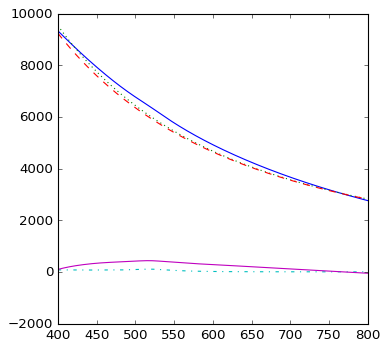

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 533.8876]) 180.0 1.2121058963738431]


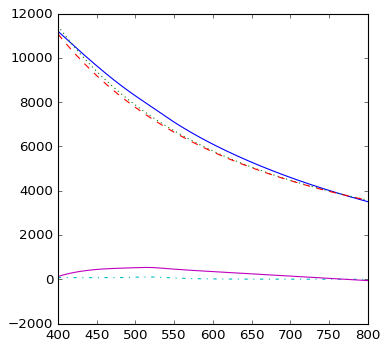

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 902.42]) 200.0 1.2121058963738431]


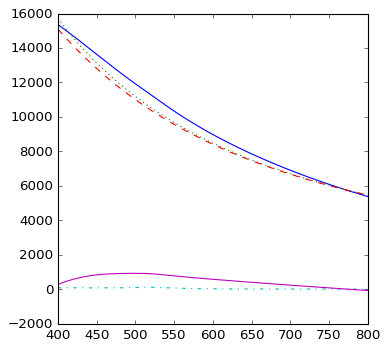

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1190.9893]) 210.0 1.2121058963738431]


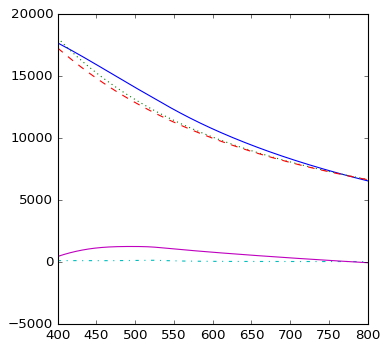

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1414.3]) 217.0 1.2121058963738431]


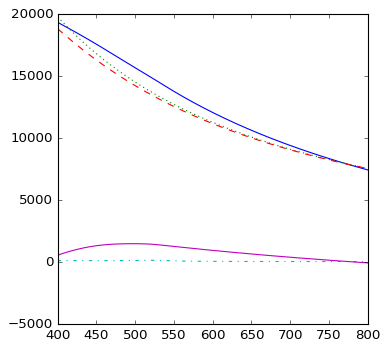

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1447.7289]) 218.0 1.2121058963738431]


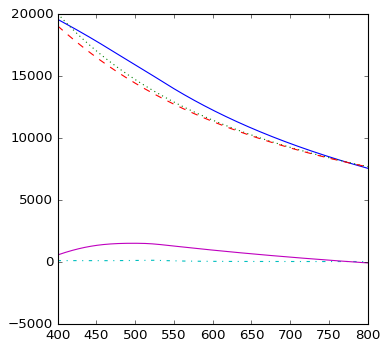

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1481.4378]) 219.0 1.2121058963738431]


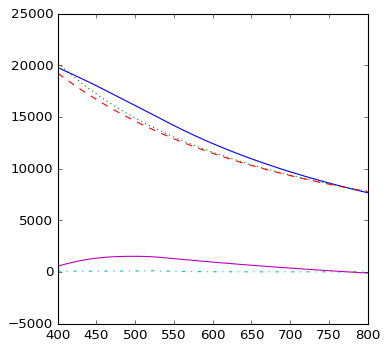

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1883.5811]) 230.0 1.2121058963738431]


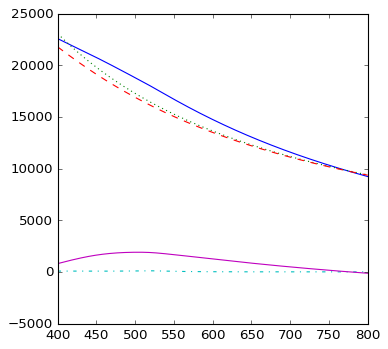

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 2633.4663]) 260.0 1.2121058963738431]


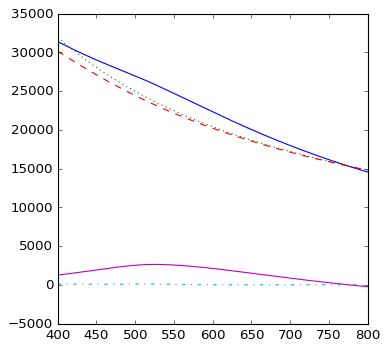

    516.93 ,	 [517.0, 109.24, 11.0, 1.22] 	 (-5.72, 16.721)	 0.715 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 109.24, 14.0, 1.22] 	 (-5.72, 16.730)	 0.715 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 109.24, 15.0, 1.22] 	 (-5.72, 16.737)	 0.715 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 109.23, 16.0, 1.22] 	 (-5.72, 16.746)	 0.715 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 109.23, 17.0, 1.22] 	 (-5.72, 16.758)	 0.715 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 109.22, 20.0, 1.22] 	 (-5.71, 16.824)	 0.715 	 (0.00, 1.00) 	 0.867
    516.93 ,	 [517.0, 109.22, 21.0, 1.22] 	 (-5.71, 16.860)	 0.715 	 (0.00, 1.00) 	 0.866
    516.93 ,	 [517.0, 109.21, 22.0, 1.22] 	 (-5.70, 16.905)	 0.715 	 (-9.75, 1.35) 	 0.866
    516.93 ,	 [517.0, 109.2, 23.0, 1.22] 	 (-5.69, 16.961)	 0.715 	 (-9.14, 1.45) 	 0.864
    516.94 ,	 [517.0, 109.19, 24.0, 1.22] 	 (-5.69, 17.030)	 0.715 	 (-8.66, 1.55) 	 0.863
    516.94 ,	 [517.0, 109.16, 26.0, 1.22] 	 (-5.67, 17.217)	 0.715 	 (-7.84, 1.79) 	 0.859
    516

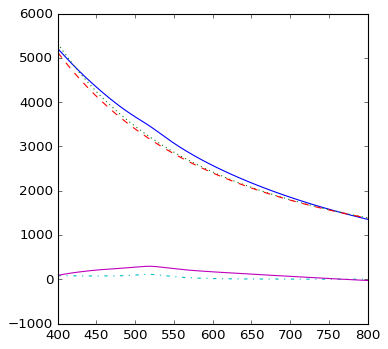

    517.42 ,	 [518.0, 293.98, 150.0, 1.22] 	 (-1.94, 3027.528)	 1.928 	 (-1.90, 2977.18) 	 0.424
	* Warning *: large scattering cross section:  [ 517.      345.7065  164.        1.2221]


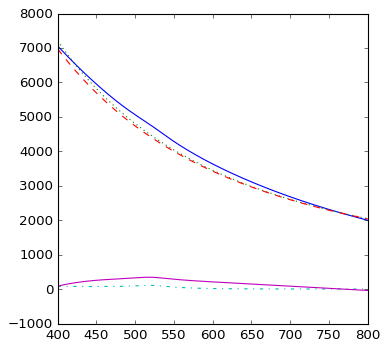

    516.97 ,	 [517.0, 345.71, 164.0, 1.22] 	 (-1.82, 4248.366)	 2.262 	 (-1.78, 4188.41) 	 0.433
	* Warning *: large scattering cross section:  [ 517.      350.4246  165.        1.2221]


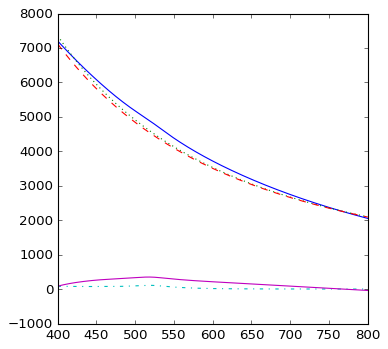

    516.88 ,	 [517.0, 350.42, 165.0, 1.22] 	 (-1.81, 4345.754)	 2.293 	 (-1.77, 4284.93) 	 0.433
	* Warning *: large scattering cross section:  [ 517.      355.3475  166.        1.2221]


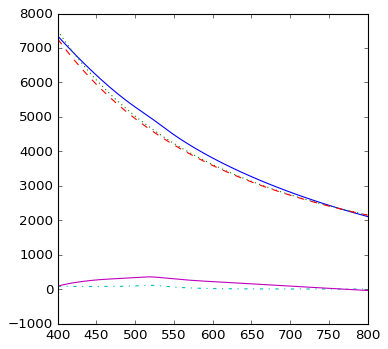

    516.79 ,	 [517.0, 355.35, 166.0, 1.22] 	 (-1.80, 4444.510)	 2.325 	 (-1.76, 4382.79) 	 0.434
	* Warning *: large scattering cross section:  [ 517.      377.3915  170.        1.2221]


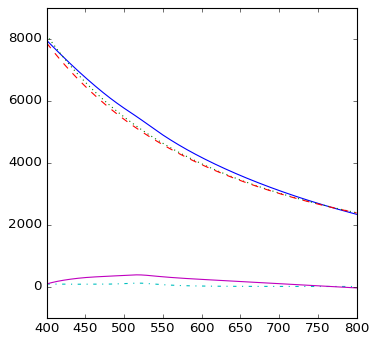

    516.29 ,	 [517.0, 377.39, 170.0, 1.22] 	 (-1.77, 4853.196)	 2.470 	 (-1.73, 4787.45) 	 0.439
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 466.7784]) 180.0 1.2221058963738431]


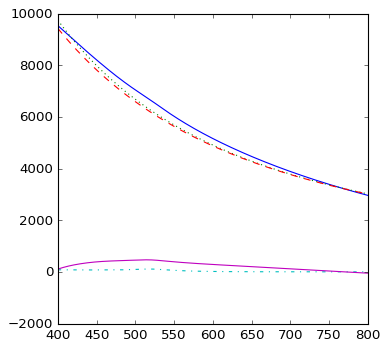

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 802.4534]) 200.0 1.2221058963738431]


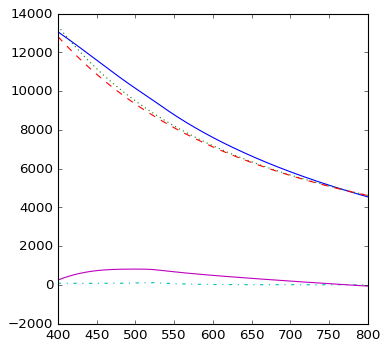

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1059.4429]) 210.0 1.2221058963738431]


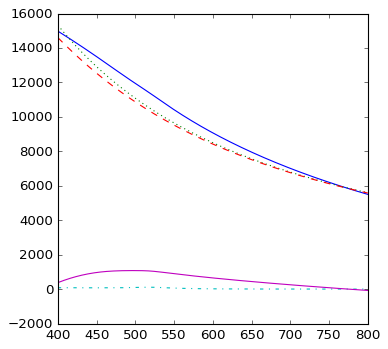

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1253.9182]) 217.0 1.2221058963738431]


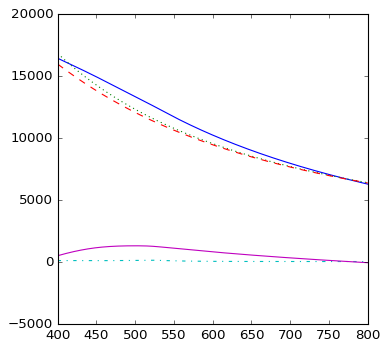

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1282.6557]) 218.0 1.2221058963738431]


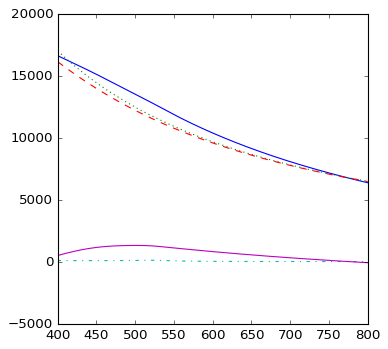

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1329.0023]) 219.0 1.2221058963738431]


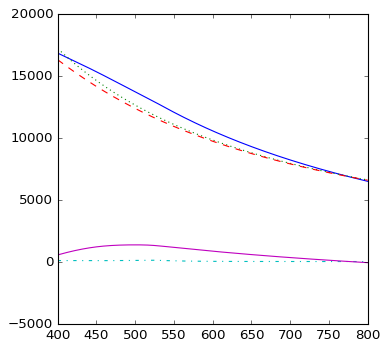

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1648.6729]) 230.0 1.2221058963738431]


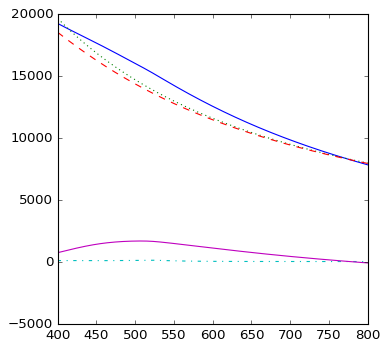

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 2220.8791]) 260.0 1.2221058963738431]


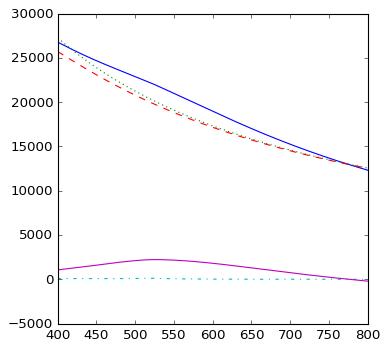

    516.93 ,	 [517.0, 113.79, 11.0, 1.23] 	 (-5.72, 17.417)	 0.745 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 113.79, 14.0, 1.23] 	 (-5.72, 17.425)	 0.745 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 113.79, 15.0, 1.23] 	 (-5.72, 17.430)	 0.745 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 113.79, 16.0, 1.23] 	 (-5.72, 17.438)	 0.745 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 113.79, 17.0, 1.23] 	 (-5.72, 17.448)	 0.745 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 113.78, 20.0, 1.23] 	 (-5.71, 17.502)	 0.745 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 113.77, 21.0, 1.23] 	 (-5.71, 17.532)	 0.745 	 (0.00, 1.00) 	 0.867
    516.93 ,	 [517.0, 113.77, 22.0, 1.23] 	 (-5.70, 17.569)	 0.745 	 (0.00, 1.00) 	 0.866
    516.93 ,	 [517.0, 113.76, 23.0, 1.23] 	 (-5.70, 17.615)	 0.745 	 (-9.66, 1.42) 	 0.865
    516.93 ,	 [517.0, 113.75, 24.0, 1.23] 	 (-5.69, 17.672)	 0.745 	 (-9.10, 1.51) 	 0.864
    516.94 ,	 [517.0, 113.73, 26.0, 1.23] 	 (-5.68, 17.826)	 0.744 	 (-8.23, 1.73) 	 0.861
    516

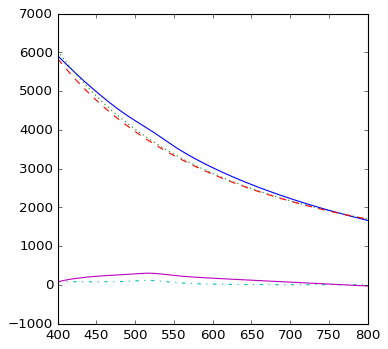

    516.93 ,	 [517.0, 300.22, 164.0, 1.23] 	 (-1.83, 3546.598)	 1.965 	 (-1.79, 3494.61) 	 0.432
	* Warning *: large scattering cross section:  [ 517.      304.2767  165.        1.2321]


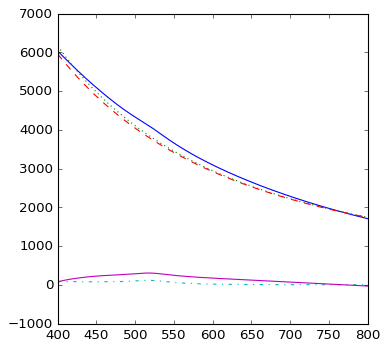

    516.84 ,	 [517.0, 304.28, 165.0, 1.23] 	 (-1.82, 3627.861)	 1.991 	 (-1.78, 3575.14) 	 0.433
	* Warning *: large scattering cross section:  [ 517.      308.5337  166.        1.2321]


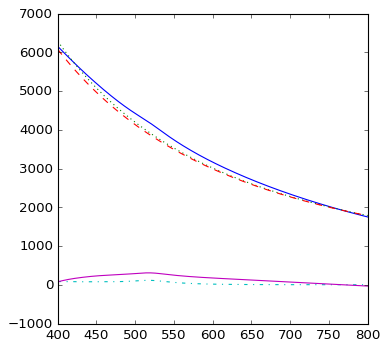

    516.73 ,	 [517.0, 308.53, 166.0, 1.23] 	 (-1.81, 3710.258)	 2.019 	 (-1.78, 3656.76) 	 0.434
	* Warning *: large scattering cross section:  [ 517.      327.851   170.        1.2321]


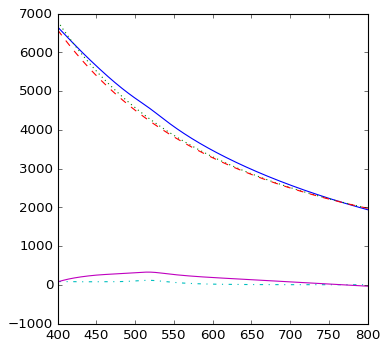

    516.22 ,	 [517.0, 327.85, 170.0, 1.23] 	 (-1.78, 4051.171)	 2.146 	 (-1.74, 3994.16) 	 0.438
	* Warning *: large scattering cross section:  [ 516.      407.4574  180.        1.2321]


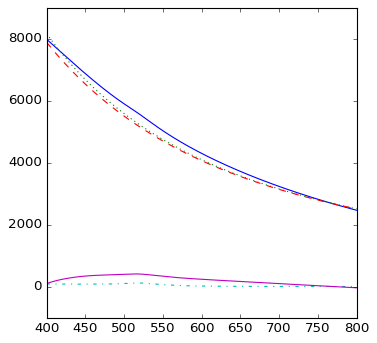

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 706.4652]) 200.0 1.2321058963738432]


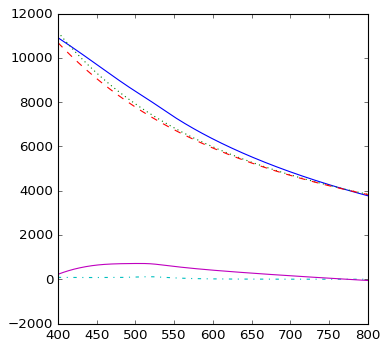

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 929.5077]) 210.0 1.2321058963738432]


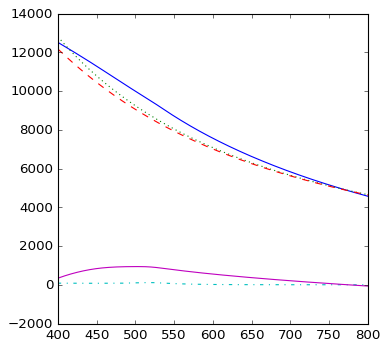

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1108.6895]) 217.0 1.2321058963738432]


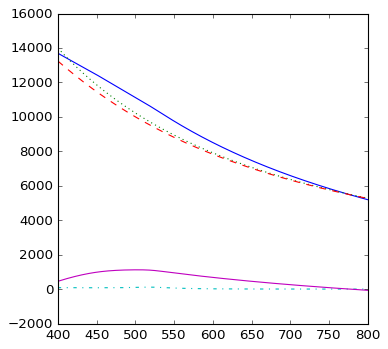

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1133.0031]) 218.0 1.2321058963738432]


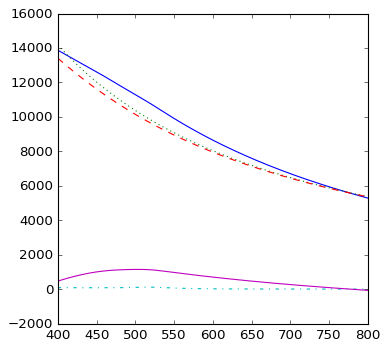

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1157.3456]) 219.0 1.2321058963738432]


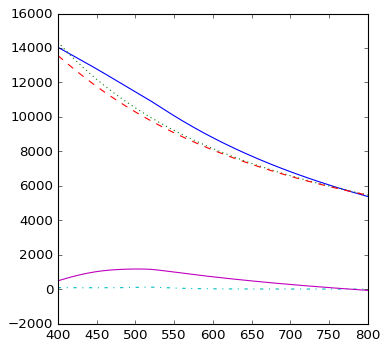

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1418.0868]) 230.0 1.2321058963738432]


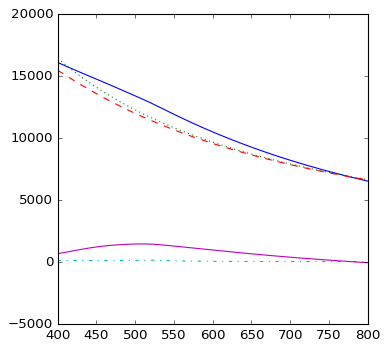

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1842.0881]) 260.0 1.2321058963738432]


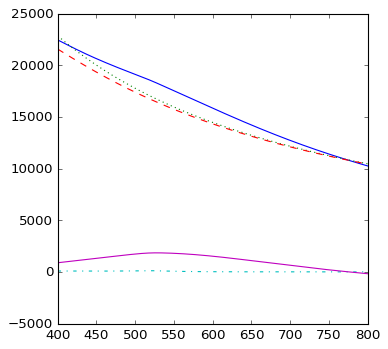

    516.93 ,	 [517.0, 118.5, 11.0, 1.24] 	 (-5.72, 18.137)	 0.776 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 118.5, 14.0, 1.24] 	 (-5.72, 18.144)	 0.776 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 118.5, 15.0, 1.24] 	 (-5.72, 18.148)	 0.776 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 118.5, 16.0, 1.24] 	 (-5.72, 18.154)	 0.776 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 118.5, 17.0, 1.24] 	 (-5.72, 18.162)	 0.776 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 118.49, 20.0, 1.24] 	 (-5.71, 18.206)	 0.776 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 118.49, 21.0, 1.24] 	 (-5.71, 18.230)	 0.776 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 118.48, 22.0, 1.24] 	 (-5.71, 18.260)	 0.776 	 (0.00, 1.00) 	 0.867
    516.93 ,	 [517.0, 118.48, 23.0, 1.24] 	 (-5.70, 18.298)	 0.776 	 (0.00, 1.00) 	 0.866
    516.93 ,	 [517.0, 118.47, 24.0, 1.24] 	 (-5.70, 18.344)	 0.776 	 (-9.66, 1.48) 	 0.865
    516.94 ,	 [517.0, 118.45, 26.0, 1.24] 	 (-5.69, 18.469)	 0.775 	 (-8.67, 1.67) 	 0.863
    516.94 ,	

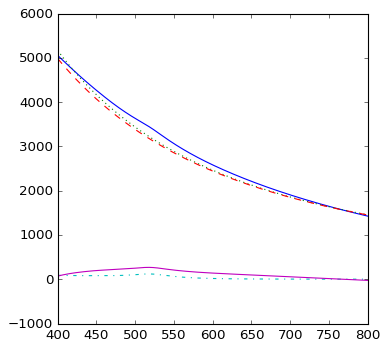

    516.7 ,	 [517.0, 268.58, 166.0, 1.24] 	 (-1.83, 3037.037)	 1.758 	 (-1.79, 2990.54) 	 0.434
	* Warning *: large scattering cross section:  [ 517.      285.3977  170.        1.2421]


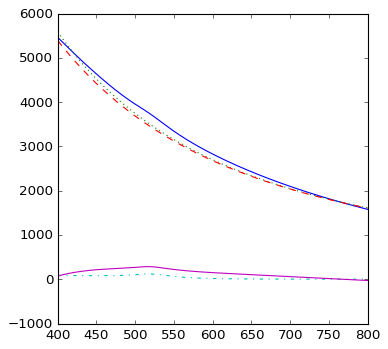

    516.2 ,	 [517.0, 285.4, 170.0, 1.24] 	 (-1.79, 3315.581)	 1.868 	 (-1.75, 3266.03) 	 0.439
	* Warning *: large scattering cross section:  [ 516.      355.3069  180.        1.2421]


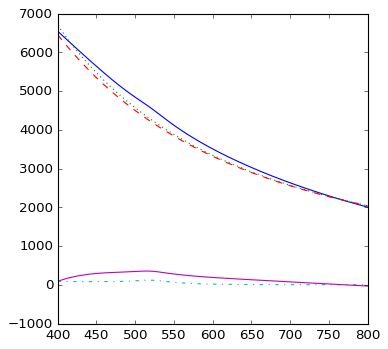

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 615.6807]) 200.0 1.2421058963738432]


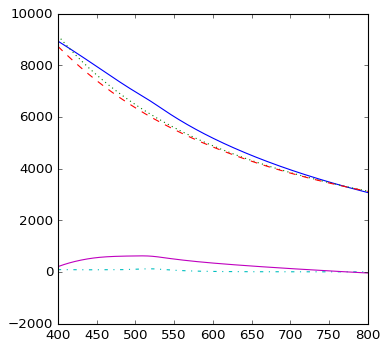

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 804.1681]) 210.0 1.2421058963738432]


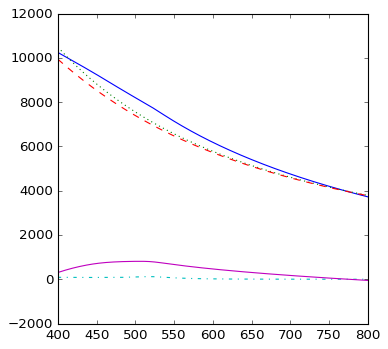

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 951.8814]) 217.0 1.2421058963738432]


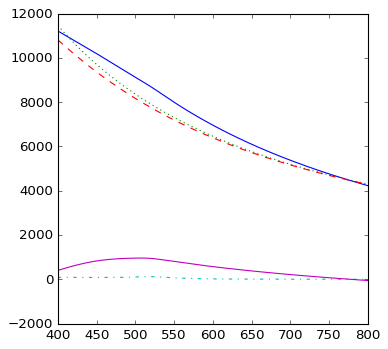

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 971.6356]) 218.0 1.2421058963738432]


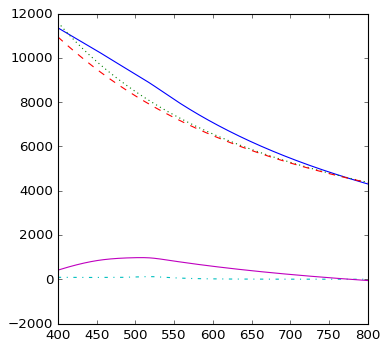

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 991.3487]) 219.0 1.2421058963738432]


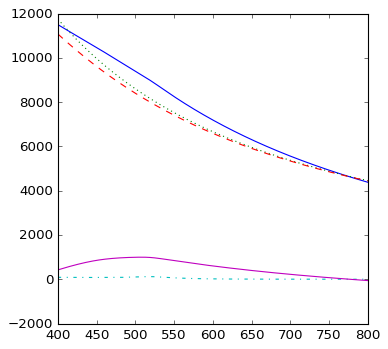

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1183.4257]) 230.0 1.2421058963738432]


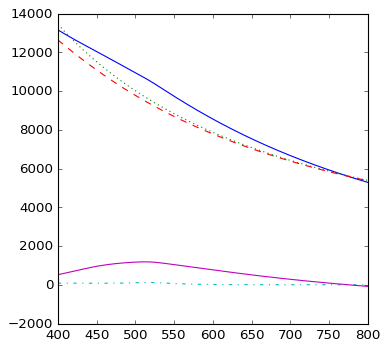

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 1477.719]) 260.0 1.2421058963738432]


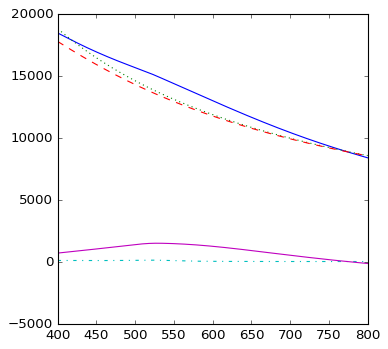

    516.93 ,	 [517.0, 123.38, 11.0, 1.25] 	 (-5.72, 18.883)	 0.808 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 123.37, 14.0, 1.25] 	 (-5.72, 18.888)	 0.808 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 123.37, 15.0, 1.25] 	 (-5.72, 18.891)	 0.808 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 123.37, 16.0, 1.25] 	 (-5.72, 18.896)	 0.808 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 123.37, 17.0, 1.25] 	 (-5.72, 18.903)	 0.808 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 123.37, 20.0, 1.25] 	 (-5.71, 18.937)	 0.808 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 123.36, 21.0, 1.25] 	 (-5.71, 18.956)	 0.808 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 123.36, 22.0, 1.25] 	 (-5.71, 18.980)	 0.808 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 123.36, 23.0, 1.25] 	 (-5.71, 19.009)	 0.808 	 (0.00, 1.00) 	 0.867
    516.93 ,	 [517.0, 123.35, 24.0, 1.25] 	 (-5.70, 19.046)	 0.807 	 (0.00, 1.00) 	 0.866
    516.93 ,	 [517.0, 123.34, 26.0, 1.25] 	 (-5.70, 19.145)	 0.807 	 (-9.21, 1.62) 	 0.865
    516.9

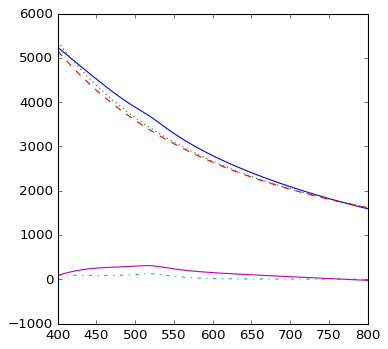

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 537.5032]) 200.0 1.2521058963738432]


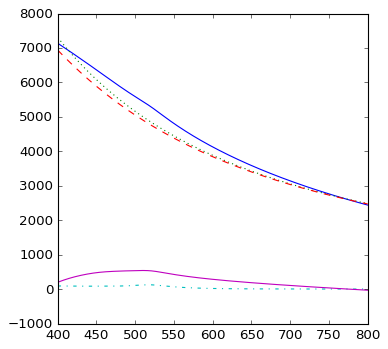

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 684.1159]) 210.0 1.2521058963738432]


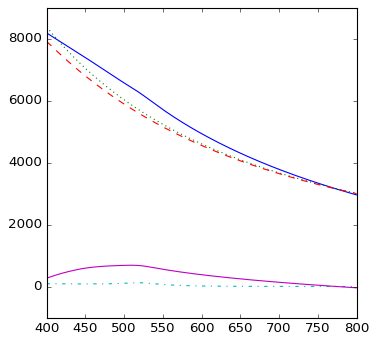

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 801.9181]) 217.0 1.2521058963738432]


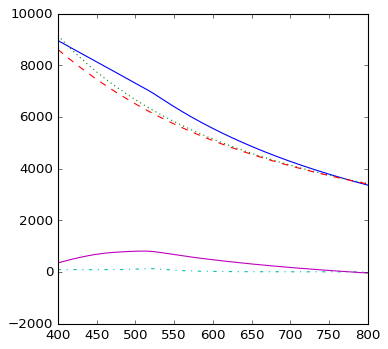

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 817.4278]) 218.0 1.2521058963738432]


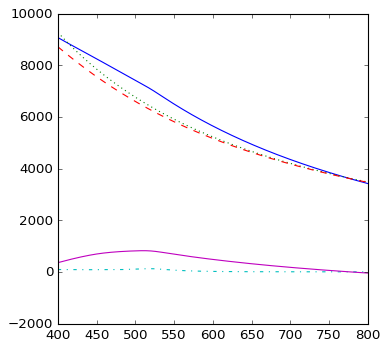

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 832.8394]) 219.0 1.2521058963738432]


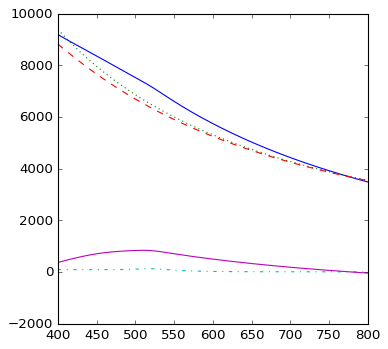

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 978.7251]) 230.0 1.2521058963738432]


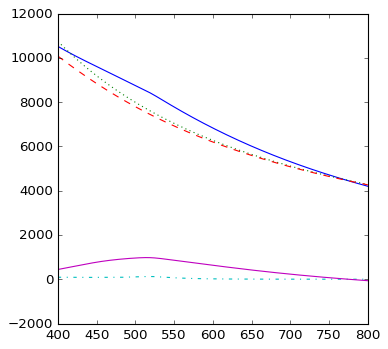

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1174.9776]) 260.0 1.2521058963738432]


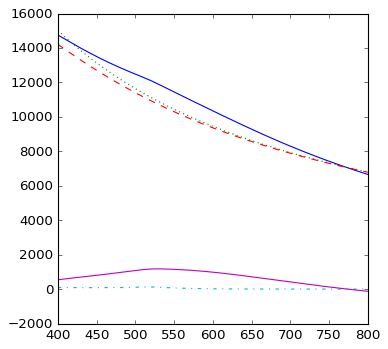

    516.93 ,	 [517.0, 128.41, 11.0, 1.26] 	 (-5.72, 19.653)	 0.841 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 128.41, 14.0, 1.26] 	 (-5.72, 19.657)	 0.841 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 128.41, 15.0, 1.26] 	 (-5.72, 19.660)	 0.841 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 128.41, 16.0, 1.26] 	 (-5.72, 19.664)	 0.841 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 128.41, 17.0, 1.26] 	 (-5.72, 19.669)	 0.841 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 128.41, 20.0, 1.26] 	 (-5.72, 19.695)	 0.841 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 128.41, 21.0, 1.26] 	 (-5.71, 19.710)	 0.841 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 128.4, 22.0, 1.26] 	 (-5.71, 19.728)	 0.841 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 128.4, 23.0, 1.26] 	 (-5.71, 19.750)	 0.841 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 128.4, 24.0, 1.26] 	 (-5.71, 19.778)	 0.840 	 (0.00, 1.00) 	 0.867
    516.93 ,	 [517.0, 128.38, 26.0, 1.26] 	 (-5.70, 19.854)	 0.840 	 (-10.01, 1.56) 	 0.866
    516.94 

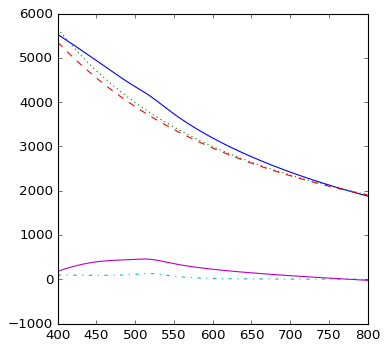

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 577.2076]) 210.0 1.2621058963738432]


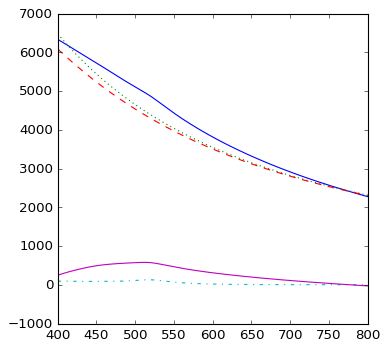

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 660.8381]) 217.0 1.2621058963738432]


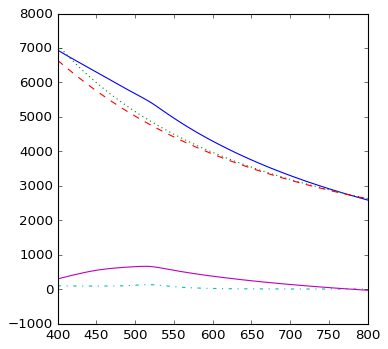

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 672.5143]) 218.0 1.2621058963738432]


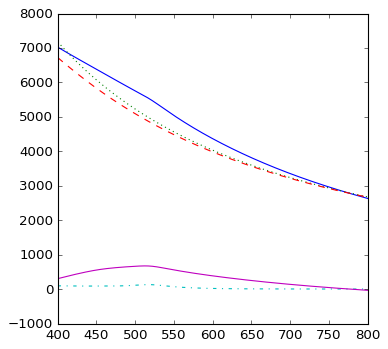

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 684.0705]) 219.0 1.2621058963738432]


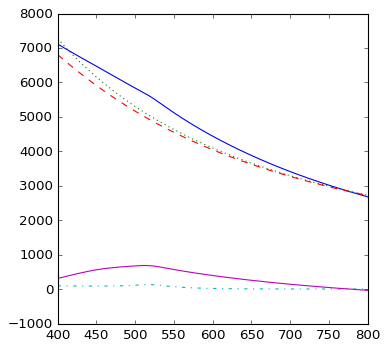

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 789.9025]) 230.0 1.2621058963738432]


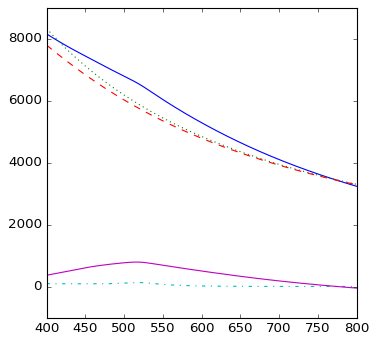

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 527.]) array([ 911.9303]) 260.0 1.2621058963738432]


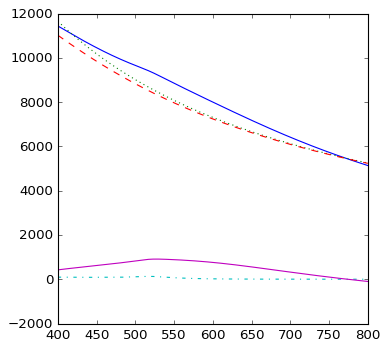

    516.93 ,	 [517.0, 133.62, 11.0, 1.27] 	 (-5.72, 20.449)	 0.875 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 133.62, 14.0, 1.27] 	 (-5.72, 20.452)	 0.875 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 133.62, 15.0, 1.27] 	 (-5.72, 20.454)	 0.875 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 133.62, 16.0, 1.27] 	 (-5.72, 20.457)	 0.875 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 133.62, 17.0, 1.27] 	 (-5.72, 20.461)	 0.875 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 133.61, 20.0, 1.27] 	 (-5.72, 20.480)	 0.875 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 133.61, 21.0, 1.27] 	 (-5.72, 20.491)	 0.875 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 133.61, 22.0, 1.27] 	 (-5.71, 20.504)	 0.875 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 133.61, 23.0, 1.27] 	 (-5.71, 20.521)	 0.875 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 133.6, 24.0, 1.27] 	 (-5.71, 20.541)	 0.875 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 133.6, 26.0, 1.27] 	 (-5.71, 20.597)	 0.875 	 (0.00, 1.00) 	 0.867
    516.94 ,

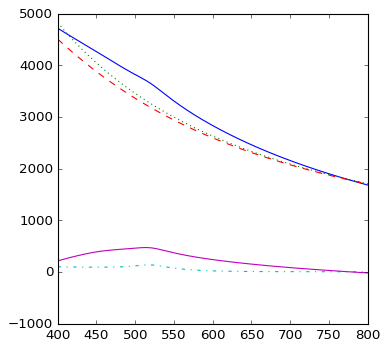

	* Warning *: large scattering cross section:  [ 515.      531.3446  217.        1.2721]


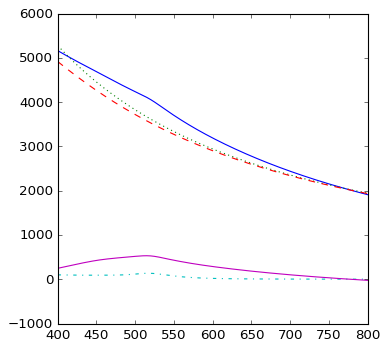

	* Warning *: large scattering cross section:  [ 515.      539.6445  218.        1.2721]


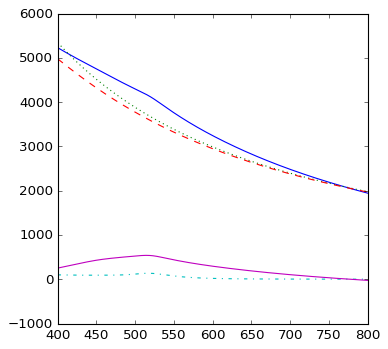

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 547.8165]) 219.0 1.2721058963738432]


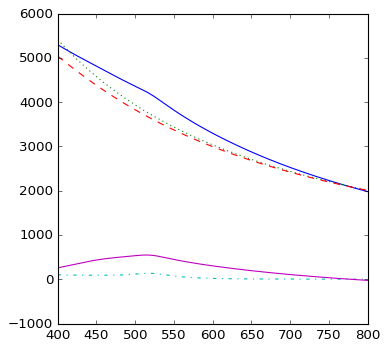

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 620.1744]) 230.0 1.2721058963738432]


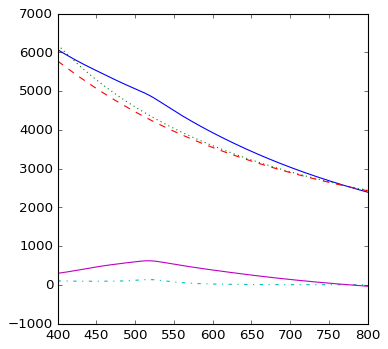

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 687.0461]) 260.0 1.2721058963738432]


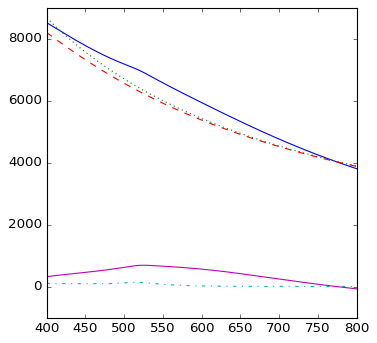

    516.93 ,	 [517.0, 138.99, 11.0, 1.28] 	 (-5.72, 21.271)	 0.910 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 138.99, 14.0, 1.28] 	 (-5.72, 21.273)	 0.910 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 138.99, 15.0, 1.28] 	 (-5.72, 21.274)	 0.910 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 138.99, 16.0, 1.28] 	 (-5.72, 21.276)	 0.910 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 138.99, 17.0, 1.28] 	 (-5.72, 21.279)	 0.910 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 138.98, 20.0, 1.28] 	 (-5.72, 21.292)	 0.910 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 138.98, 21.0, 1.28] 	 (-5.72, 21.300)	 0.910 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 138.98, 22.0, 1.28] 	 (-5.72, 21.309)	 0.910 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 138.98, 23.0, 1.28] 	 (-5.72, 21.320)	 0.910 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 138.98, 24.0, 1.28] 	 (-5.71, 21.335)	 0.910 	 (0.00, 1.00) 	 0.868
    516.93 ,	 [517.0, 138.97, 26.0, 1.28] 	 (-5.71, 21.373)	 0.910 	 (0.00, 1.00) 	 0.868
    516.93

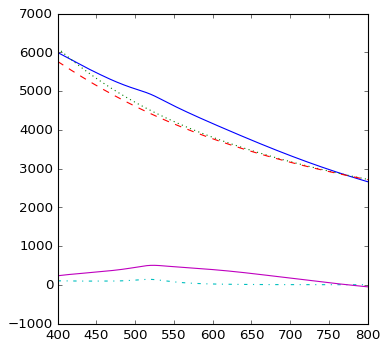

    523.59 ,	 [523.0, 502.87, 260.0, 1.28] 	 (-1.17, 4351.540)	 3.325 	 (-1.10, 4256.31) 	 0.517
    516.93 ,	 [517.0, 144.52, 11.0, 1.29] 	 (-5.72, 22.118)	 0.946 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 144.52, 14.0, 1.29] 	 (-5.72, 22.119)	 0.946 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 144.52, 15.0, 1.29] 	 (-5.72, 22.120)	 0.946 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 144.52, 16.0, 1.29] 	 (-5.72, 22.121)	 0.946 	 (0.00, 1.00) 	 0.870
    516.93 ,	 [517.0, 144.52, 17.0, 1.29] 	 (-5.72, 22.123)	 0.946 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 144.52, 20.0, 1.29] 	 (-5.72, 22.132)	 0.946 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 144.52, 21.0, 1.29] 	 (-5.72, 22.136)	 0.946 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 144.52, 22.0, 1.29] 	 (-5.72, 22.142)	 0.946 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 144.52, 23.0, 1.29] 	 (-5.72, 22.150)	 0.946 	 (0.00, 1.00) 	 0.869
    516.93 ,	 [517.0, 144.52, 24.0, 1.29] 	 (-5.72, 22.159)	 0.946 	 (0.00, 1.00) 	 0.869
   

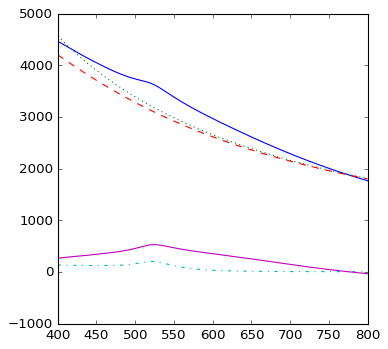

    524.47 ,	 [524.0, 527.62, 230.0, 1.38] 	 (-1.34, 3094.850)	 3.495 	 (-1.24, 2996.69) 	 0.516
	* Warning *: large scattering cross section:  [ 523.      501.8364  260.        1.3821]


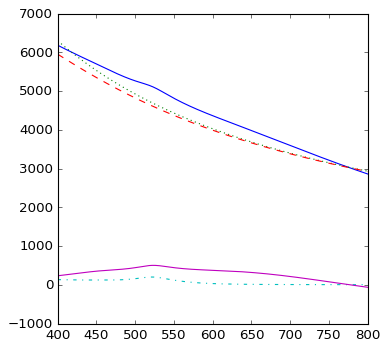

    523.61 ,	 [523.0, 501.84, 260.0, 1.38] 	 (-1.10, 4569.892)	 3.318 	 (-1.04, 4474.16) 	 0.524
    521.68 ,	 [522.0, 203.89, 11.0, 1.39] 	 (-5.51, 29.234)	 1.347 	 (0.00, 1.00) 	 0.967
    521.68 ,	 [522.0, 203.89, 14.0, 1.39] 	 (-5.51, 29.237)	 1.347 	 (0.00, 1.00) 	 0.967
    521.68 ,	 [522.0, 203.89, 15.0, 1.39] 	 (-5.51, 29.239)	 1.347 	 (0.00, 1.00) 	 0.967
    521.68 ,	 [522.0, 203.89, 16.0, 1.39] 	 (-5.51, 29.241)	 1.347 	 (0.00, 1.00) 	 0.967
    521.68 ,	 [522.0, 203.89, 17.0, 1.39] 	 (-5.51, 29.245)	 1.347 	 (0.00, 1.00) 	 0.967
    521.68 ,	 [522.0, 203.88, 20.0, 1.39] 	 (-5.51, 29.264)	 1.347 	 (0.00, 1.00) 	 0.967
    521.68 ,	 [522.0, 203.88, 21.0, 1.39] 	 (-5.51, 29.274)	 1.347 	 (0.00, 1.00) 	 0.967
    521.68 ,	 [522.0, 203.88, 22.0, 1.39] 	 (-5.51, 29.287)	 1.347 	 (0.00, 1.00) 	 0.967
    521.68 ,	 [522.0, 203.88, 23.0, 1.39] 	 (-5.51, 29.303)	 1.347 	 (0.00, 1.00) 	 0.966
    521.68 ,	 [522.0, 203.88, 24.0, 1.39] 	 (-5.51, 29.323)	 1.347 	 (0.00, 1.00) 	 0.966
   

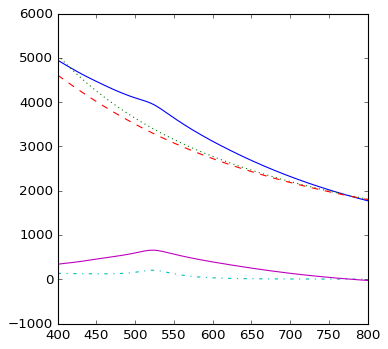

    522.4 ,	 [522.0, 657.34, 210.0, 1.39] 	 (-1.48, 3288.099)	 4.339 	 (-1.38, 3168.12) 	 0.508
	* Warning *: large scattering cross section:  [ 524.      681.7499  217.        1.3921]


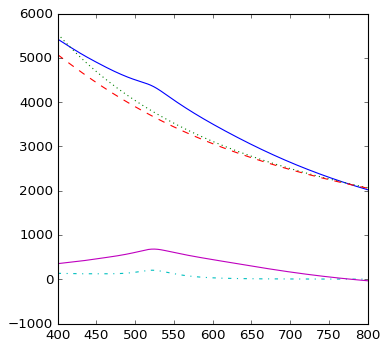

    523.91 ,	 [524.0, 681.75, 217.0, 1.39] 	 (-1.42, 3664.700)	 4.517 	 (-1.32, 3539.15) 	 0.509
	* Warning *: large scattering cross section:  [ 524.      677.7303  218.        1.3921]


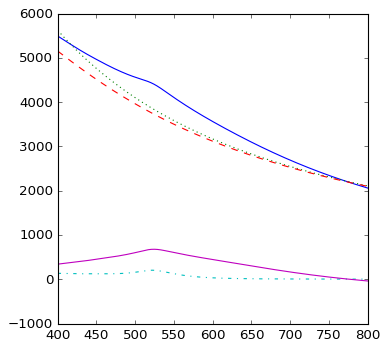

    524.17 ,	 [524.0, 677.73, 218.0, 1.39] 	 (-1.41, 3725.987)	 4.490 	 (-1.32, 3601.02) 	 0.510
	* Warning *: large scattering cross section:  [ 524.      679.7762  219.        1.3921]


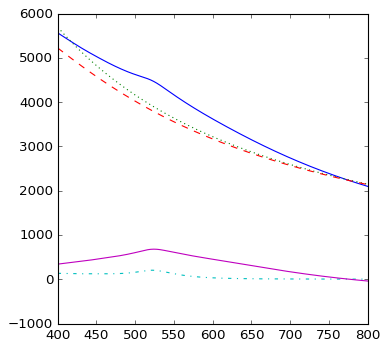

    524.37 ,	 [524.0, 679.78, 219.0, 1.39] 	 (-1.41, 3782.635)	 4.503 	 (-1.31, 3657.13) 	 0.510
	* Warning *: large scattering cross section:  [ 526.      687.2511  230.        1.3921]


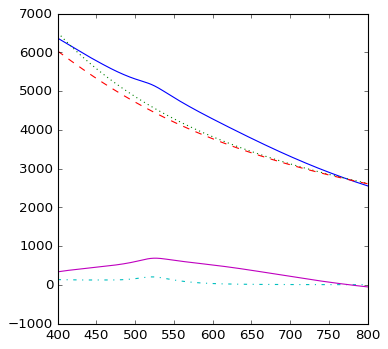

    526.23 ,	 [526.0, 687.25, 230.0, 1.39] 	 (-1.31, 4441.897)	 4.568 	 (-1.23, 4313.35) 	 0.511
	* Warning *: large scattering cross section:  [ 524.      652.5921  260.        1.3921]


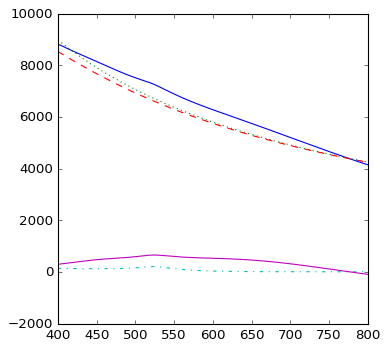

    524.29 ,	 [524.0, 652.59, 260.0, 1.39] 	 (-1.08, 6563.483)	 4.323 	 (-1.02, 6438.50) 	 0.523
    522.67 ,	 [523.0, 182.37, 11.0, 1.4] 	 (-5.47, 25.830)	 1.207 	 (0.00, 1.00) 	 0.989
    522.67 ,	 [523.0, 182.37, 14.0, 1.4] 	 (-5.47, 25.834)	 1.207 	 (0.00, 1.00) 	 0.989
    522.67 ,	 [523.0, 182.37, 15.0, 1.4] 	 (-5.47, 25.836)	 1.207 	 (0.00, 1.00) 	 0.989
    522.67 ,	 [523.0, 182.37, 16.0, 1.4] 	 (-5.47, 25.840)	 1.207 	 (0.00, 1.00) 	 0.989
    522.67 ,	 [523.0, 182.37, 17.0, 1.4] 	 (-5.47, 25.845)	 1.207 	 (0.00, 1.00) 	 0.989
    522.67 ,	 [523.0, 182.36, 20.0, 1.4] 	 (-5.47, 25.870)	 1.206 	 (0.00, 1.00) 	 0.988
    522.67 ,	 [523.0, 182.36, 21.0, 1.4] 	 (-5.47, 25.884)	 1.206 	 (0.00, 1.00) 	 0.988
    522.67 ,	 [523.0, 182.36, 22.0, 1.4] 	 (-5.47, 25.901)	 1.206 	 (-7.45, 0.10) 	 0.988
    522.67 ,	 [523.0, 182.36, 23.0, 1.4] 	 (-5.47, 25.923)	 1.206 	 (-6.65, 0.12) 	 0.988
    522.67 ,	 [523.0, 182.36, 24.0, 1.4] 	 (-5.46, 25.950)	 1.206 	 (-6.10, 0.15) 	 0.987
    522.67

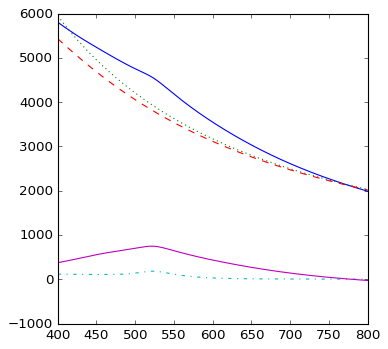

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 821.4644]) 210.0 1.4021058963738433]


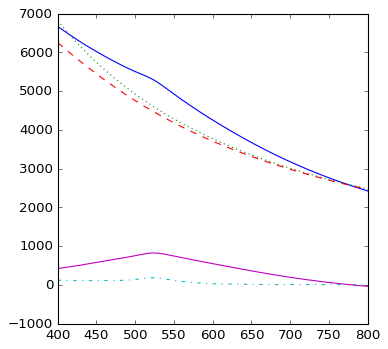

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 851.1414]) 217.0 1.4021058963738433]


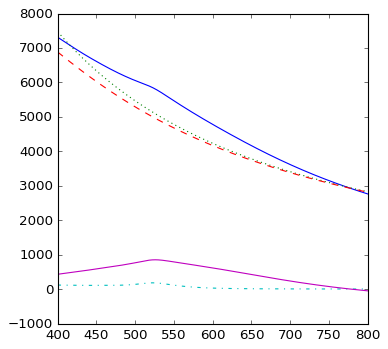

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 845.296]) 218.0 1.4021058963738433]


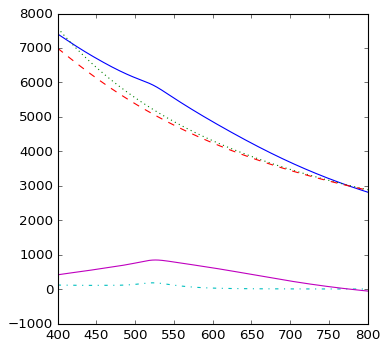

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 847.6553]) 219.0 1.4021058963738433]


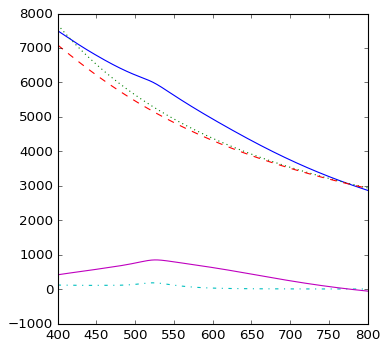

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 865.0442]) 230.0 1.4021058963738433]


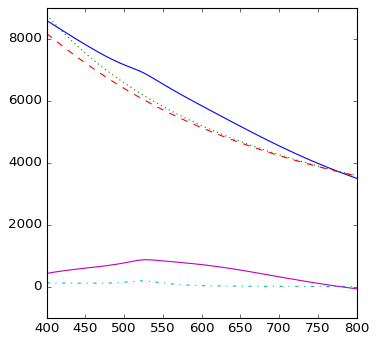

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 823.112]) 260.0 1.4021058963738433]


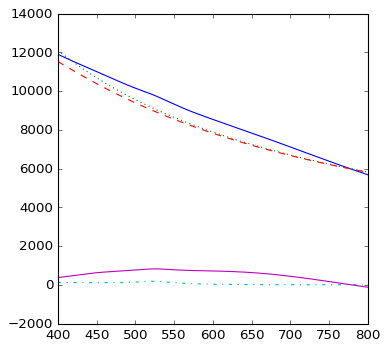

    523.16 ,	 [523.0, 187.31, 11.0, 1.41] 	 (-5.45, 26.369)	 1.239 	 (0.00, 1.00) 	 1.000
    523.16 ,	 [523.0, 187.31, 14.0, 1.41] 	 (-5.45, 26.374)	 1.239 	 (0.00, 1.00) 	 1.000
    523.16 ,	 [523.0, 187.31, 15.0, 1.41] 	 (-5.45, 26.377)	 1.239 	 (0.00, 1.00) 	 1.000
    523.16 ,	 [523.0, 187.31, 16.0, 1.41] 	 (-5.45, 26.382)	 1.239 	 (0.00, 1.00) 	 1.000
    523.16 ,	 [523.0, 187.31, 17.0, 1.41] 	 (-5.45, 26.388)	 1.239 	 (0.00, 1.00) 	 1.000
    523.16 ,	 [523.0, 187.3, 20.0, 1.41] 	 (-5.45, 26.421)	 1.239 	 (0.00, 1.00) 	 0.999
    523.16 ,	 [523.0, 187.3, 21.0, 1.41] 	 (-5.45, 26.439)	 1.239 	 (0.00, 1.00) 	 0.999
    523.16 ,	 [523.0, 187.3, 22.0, 1.41] 	 (-5.44, 26.462)	 1.239 	 (0.00, 1.00) 	 0.999
    523.16 ,	 [523.0, 187.3, 23.0, 1.41] 	 (-5.44, 26.490)	 1.239 	 (0.00, 1.00) 	 0.998
    523.16 ,	 [523.0, 187.29, 24.0, 1.41] 	 (-5.44, 26.525)	 1.239 	 (0.00, 1.00) 	 0.998
    523.16 ,	 [523.0, 187.28, 26.0, 1.41] 	 (-5.44, 26.620)	 1.239 	 (0.00, 1.00) 	 0.996
    523.16 ,	 

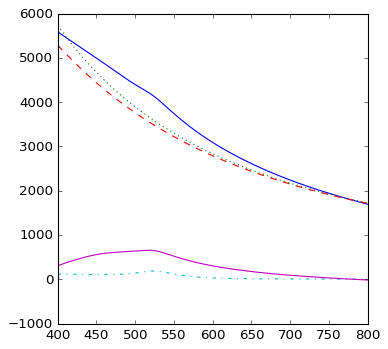

    516.35 ,	 [517.0, 656.38, 180.0, 1.41] 	 (-1.74, 3461.210)	 4.295 	 (-1.64, 3345.81) 	 0.481
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 947.3309]) 200.0 1.4121058963738433]


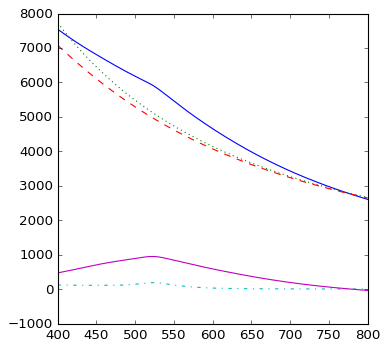

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 1035.7395]) 210.0 1.4121058963738433]


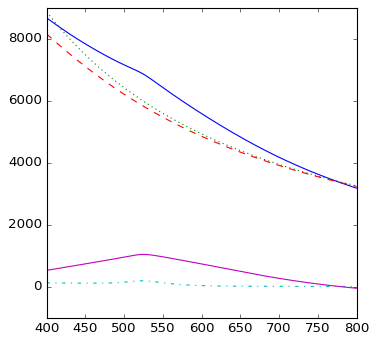

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 527.]) array([ 1069.3479]) 217.0 1.4121058963738433]


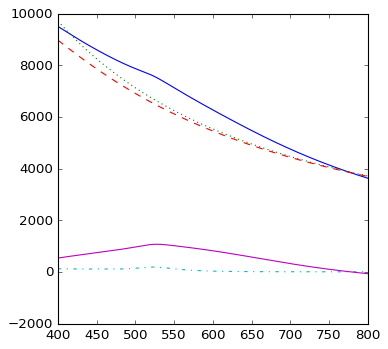

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1072.4417]) 218.0 1.4121058963738433]


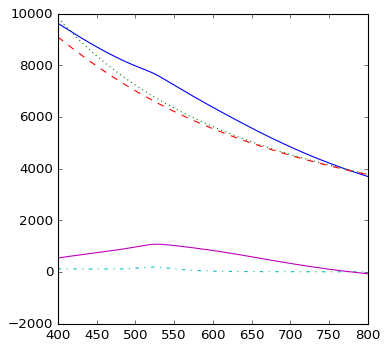

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1075.1104]) 219.0 1.4121058963738433]


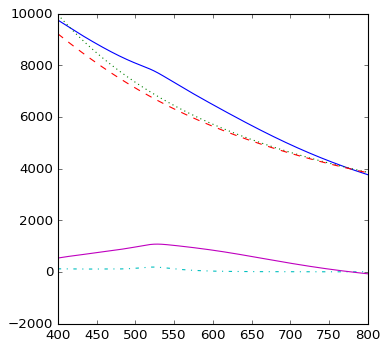

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 1081.9602]) 230.0 1.4121058963738433]


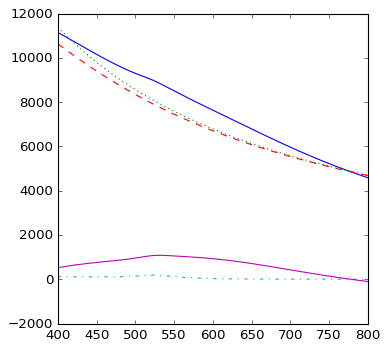

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 1031.2685]) 260.0 1.4121058963738433]


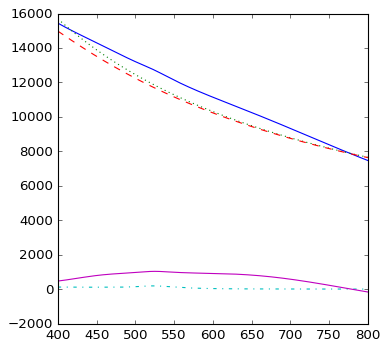

    523.67 ,	 [524.0, 192.36, 11.0, 1.42] 	 (-5.43, 26.919)	 1.275 	 (0.00, 1.00) 	 1.012
    523.67 ,	 [524.0, 192.36, 14.0, 1.42] 	 (-5.43, 26.925)	 1.275 	 (0.00, 1.00) 	 1.012
    523.67 ,	 [524.0, 192.36, 15.0, 1.42] 	 (-5.43, 26.929)	 1.275 	 (0.00, 1.00) 	 1.012
    523.67 ,	 [524.0, 192.36, 16.0, 1.42] 	 (-5.43, 26.935)	 1.275 	 (0.00, 1.00) 	 1.011
    523.67 ,	 [524.0, 192.36, 17.0, 1.42] 	 (-5.43, 26.943)	 1.275 	 (0.00, 1.00) 	 1.011
    523.67 ,	 [524.0, 192.36, 20.0, 1.42] 	 (-5.42, 26.985)	 1.275 	 (0.00, 1.00) 	 1.011
    523.67 ,	 [524.0, 192.36, 21.0, 1.42] 	 (-5.42, 27.007)	 1.275 	 (0.00, 1.00) 	 1.010
    523.67 ,	 [524.0, 192.35, 22.0, 1.42] 	 (-5.42, 27.036)	 1.275 	 (0.00, 1.00) 	 1.010
    523.67 ,	 [524.0, 192.35, 23.0, 1.42] 	 (-5.42, 27.072)	 1.275 	 (0.00, 1.00) 	 1.009
    523.67 ,	 [524.0, 192.34, 24.0, 1.42] 	 (-5.42, 27.116)	 1.275 	 (0.00, 1.00) 	 1.008
    523.67 ,	 [524.0, 192.33, 26.0, 1.42] 	 (-5.41, 27.235)	 1.275 	 (0.00, 1.00) 	 1.006
    523.68

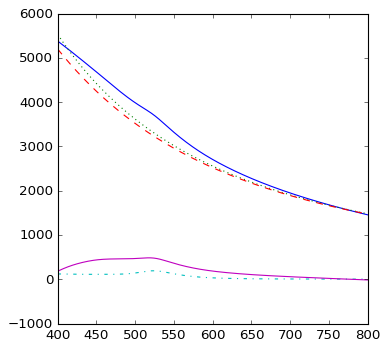

    516.78 ,	 [518.0, 484.03, 164.0, 1.42] 	 (-1.90, 3179.374)	 3.174 	 (-1.83, 3095.93) 	 0.448
	* Warning *: large scattering cross section:  [ 518.      501.66    165.        1.4221]


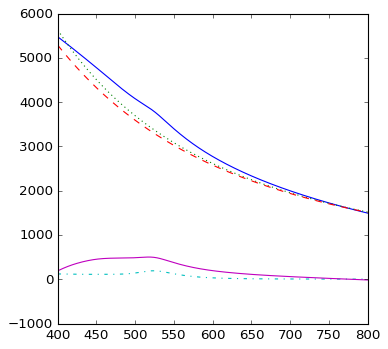

    516.51 ,	 [518.0, 501.66, 165.0, 1.42] 	 (-1.89, 3248.299)	 3.289 	 (-1.82, 3161.73) 	 0.452
	* Warning *: large scattering cross section:  [ 517.      525.3687  166.        1.4221]


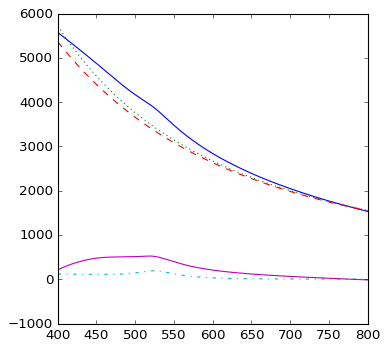

    516.0 ,	 [517.0, 525.37, 166.0, 1.42] 	 (-1.88, 3313.827)	 3.438 	 (-1.81, 3223.07) 	 0.454
	* Warning *: large scattering cross section:  [ 516.      603.239   170.        1.4221]


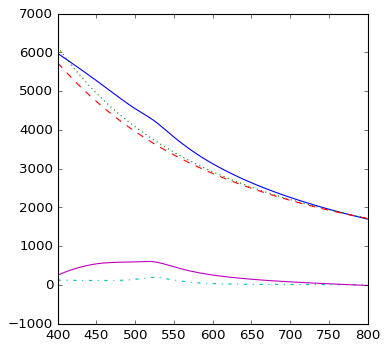

    515.08 ,	 [516.0, 603.24, 170.0, 1.42] 	 (-1.83, 3600.562)	 3.939 	 (-1.76, 3495.90) 	 0.463
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 821.9986]) 180.0 1.4221058963738433]


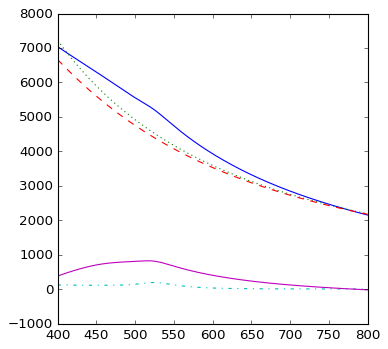

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 1176.7039]) 200.0 1.4221058963738433]


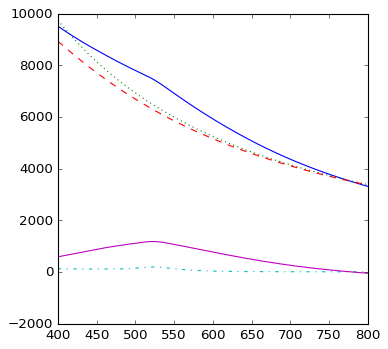

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 527.]) array([ 1278.2818]) 210.0 1.4221058963738433]


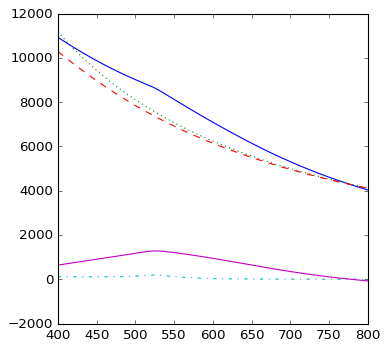

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 1314.9838]) 217.0 1.4221058963738433]


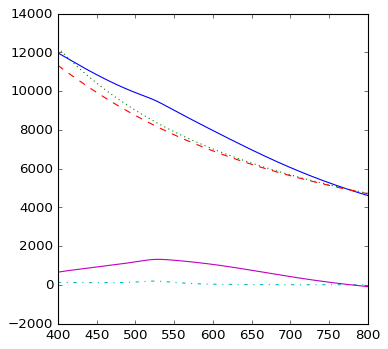

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 1318.1619]) 218.0 1.4221058963738433]


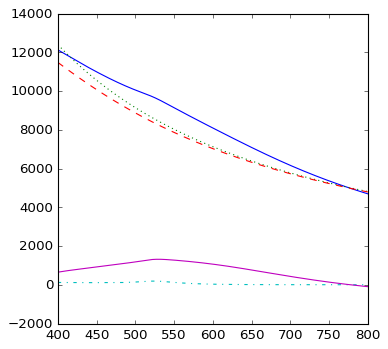

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 1320.8991]) 219.0 1.4221058963738433]


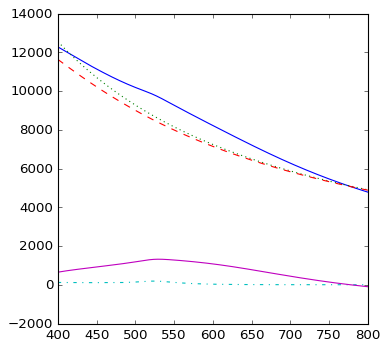

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 1323.2341]) 230.0 1.4221058963738433]


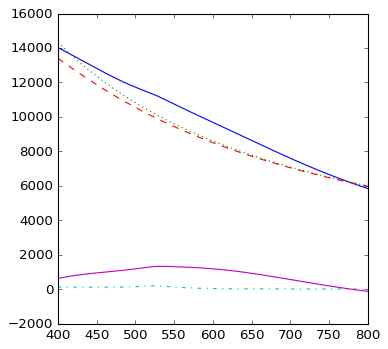

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 1266.9653]) 260.0 1.4221058963738433]


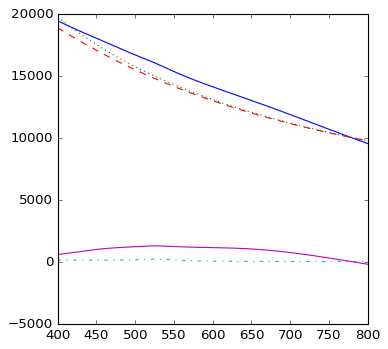

    524.17 ,	 [524.0, 197.43, 11.0, 1.43] 	 (-5.41, 27.463)	 1.308 	 (0.00, 1.00) 	 1.023
    524.17 ,	 [524.0, 197.43, 14.0, 1.43] 	 (-5.41, 27.470)	 1.308 	 (0.00, 1.00) 	 1.023
    524.17 ,	 [524.0, 197.43, 15.0, 1.43] 	 (-5.40, 27.475)	 1.308 	 (0.00, 1.00) 	 1.023
    524.17 ,	 [524.0, 197.43, 16.0, 1.43] 	 (-5.40, 27.482)	 1.308 	 (0.00, 1.00) 	 1.023
    524.17 ,	 [524.0, 197.43, 17.0, 1.43] 	 (-5.40, 27.492)	 1.308 	 (0.00, 1.00) 	 1.023
    524.17 ,	 [524.0, 197.42, 20.0, 1.43] 	 (-5.40, 27.543)	 1.308 	 (0.00, 1.00) 	 1.022
    524.17 ,	 [524.0, 197.42, 21.0, 1.43] 	 (-5.40, 27.571)	 1.308 	 (0.00, 1.00) 	 1.021
    524.17 ,	 [524.0, 197.41, 22.0, 1.43] 	 (-5.40, 27.606)	 1.308 	 (0.00, 1.00) 	 1.021
    524.17 ,	 [524.0, 197.41, 23.0, 1.43] 	 (-5.40, 27.650)	 1.308 	 (0.00, 1.00) 	 1.020
    524.17 ,	 [524.0, 197.4, 24.0, 1.43] 	 (-5.39, 27.704)	 1.308 	 (0.00, 1.00) 	 1.019
    524.17 ,	 [524.0, 197.39, 26.0, 1.43] 	 (-5.39, 27.851)	 1.308 	 (0.00, 1.00) 	 1.016
    524.17 

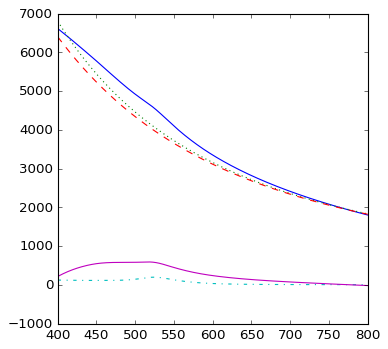

	* Warning *: large scattering cross section:  [ 516.      619.7891  165.        1.4321]


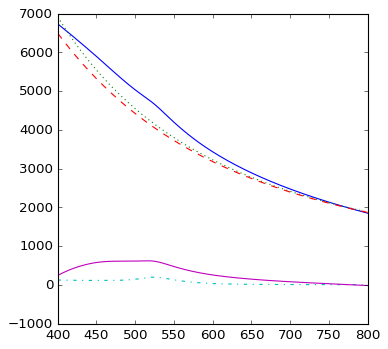

	* Warning *: large scattering cross section:  [ 521.      639.7025  166.        1.4321]


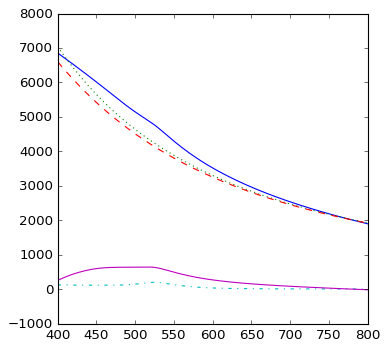

    515.38 ,	 [521.0, 639.7, 166.0, 1.43] 	 (-1.87, 4087.471)	 4.218 	 (-1.80, 3976.42) 	 0.456
	* Warning *: large scattering cross section:  [ 515.      743.6073  170.        1.4321]


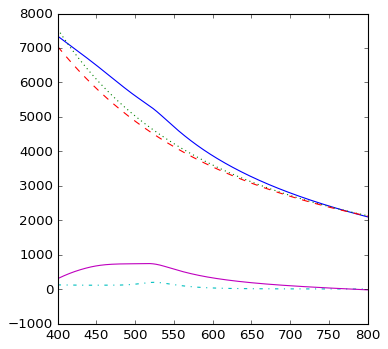

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 515.]) array([ 1016.2695]) 180.0 1.4321058963738433]


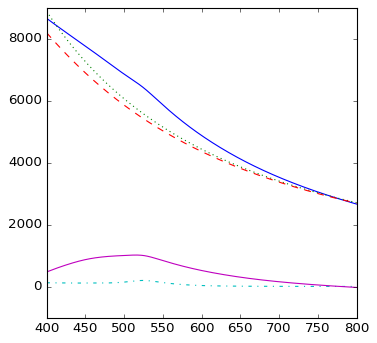

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 1435.1796]) 200.0 1.4321058963738433]


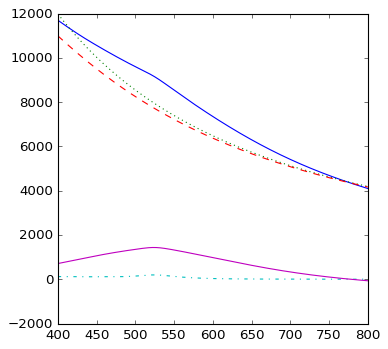

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1548.4803]) 210.0 1.4321058963738433]


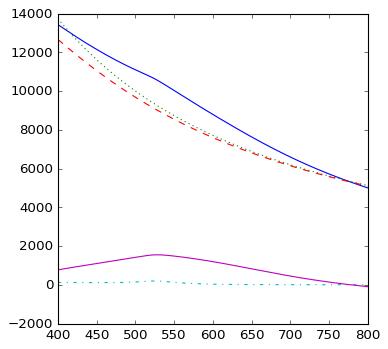

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 1587.3086]) 217.0 1.4321058963738433]


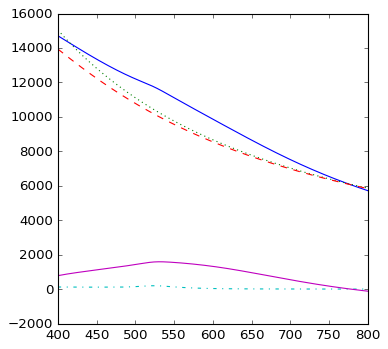

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 1590.545]) 218.0 1.4321058963738433]


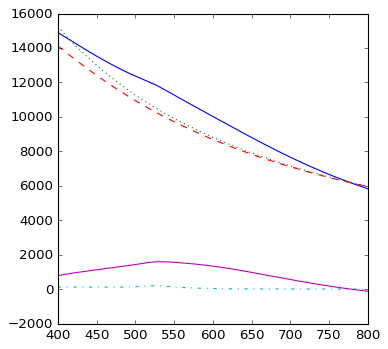

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 1593.2153]) 219.0 1.4321058963738433]


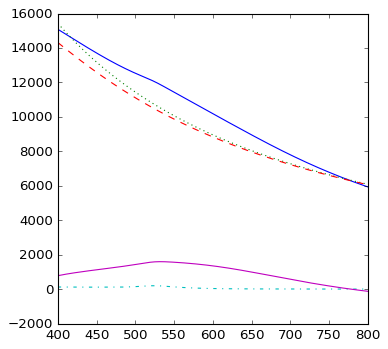

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 1591.3174]) 230.0 1.4321058963738433]


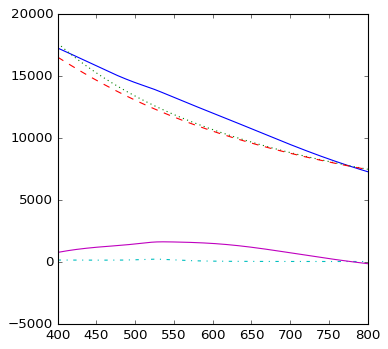

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 1530.7058]) 260.0 1.4321058963738433]


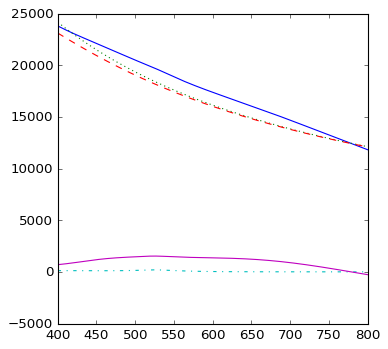

    524.7 ,	 [525.0, 202.59, 11.0, 1.44] 	 (-5.38, 28.017)	 1.345 	 (0.00, 1.00) 	 1.035
    524.7 ,	 [525.0, 202.59, 14.0, 1.44] 	 (-5.38, 28.026)	 1.345 	 (0.00, 1.00) 	 1.035
    524.7 ,	 [525.0, 202.59, 15.0, 1.44] 	 (-5.38, 28.032)	 1.345 	 (0.00, 1.00) 	 1.035
    524.7 ,	 [525.0, 202.59, 16.0, 1.44] 	 (-5.38, 28.040)	 1.345 	 (0.00, 1.00) 	 1.034
    524.7 ,	 [525.0, 202.59, 17.0, 1.44] 	 (-5.38, 28.052)	 1.345 	 (0.00, 1.00) 	 1.034
    524.7 ,	 [525.0, 202.58, 20.0, 1.44] 	 (-5.38, 28.114)	 1.345 	 (0.00, 1.00) 	 1.033
    524.7 ,	 [525.0, 202.58, 21.0, 1.44] 	 (-5.38, 28.147)	 1.345 	 (0.00, 1.00) 	 1.032
    524.7 ,	 [525.0, 202.57, 22.0, 1.44] 	 (-5.37, 28.190)	 1.345 	 (0.00, 1.00) 	 1.032
    524.7 ,	 [525.0, 202.57, 23.0, 1.44] 	 (-5.37, 28.242)	 1.345 	 (0.00, 1.00) 	 1.031
    524.7 ,	 [525.0, 202.56, 24.0, 1.44] 	 (-5.37, 28.308)	 1.345 	 (0.00, 1.00) 	 1.029
    524.7 ,	 [525.0, 202.54, 26.0, 1.44] 	 (-5.36, 28.485)	 1.344 	 (0.00, 1.00) 	 1.026
    524.7 ,	 [525.0, 

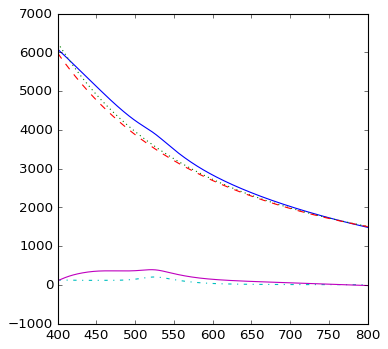

    520.08 ,	 [521.0, 390.16, 150.0, 1.44] 	 (-2.05, 3441.102)	 2.572 	 (-2.00, 3374.69) 	 0.415
	* Warning *: large scattering cross section:  [ 520.      721.4536  164.        1.4421]


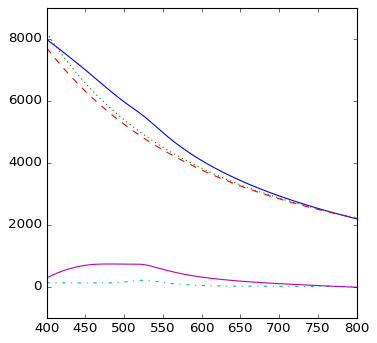

	* Warning *: large scattering cross section:  [ 520.      750.4367  165.        1.4421]


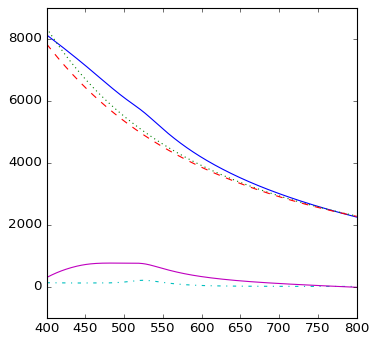

	* Warning *: large scattering cross section:  [ 520.      780.0502  166.        1.4421]


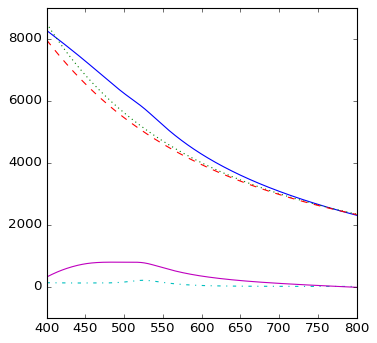

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 520.]) array([ 903.6387]) 170.0 1.4421058963738433]


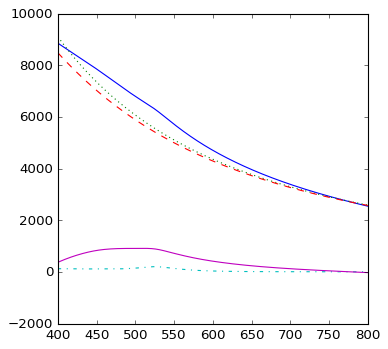

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 520.]) array([ 1236.3907]) 180.0 1.4421058963738433]


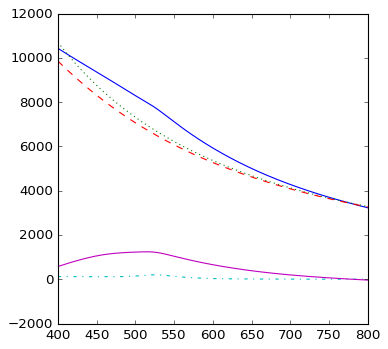

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 1722.4407]) 200.0 1.4421058963738433]


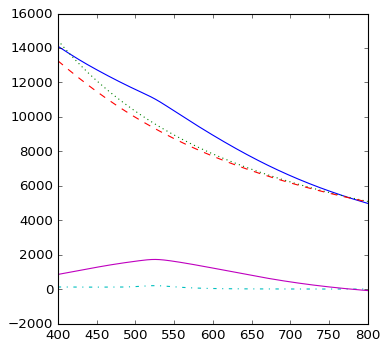

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 1845.806]) 210.0 1.4421058963738433]


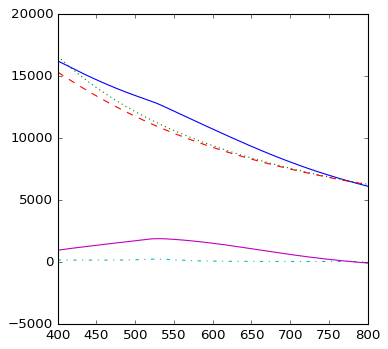

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 1886.0378]) 217.0 1.4421058963738433]


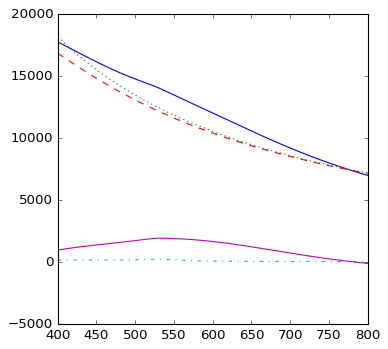

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 1886.3716]) 218.0 1.4421058963738433]


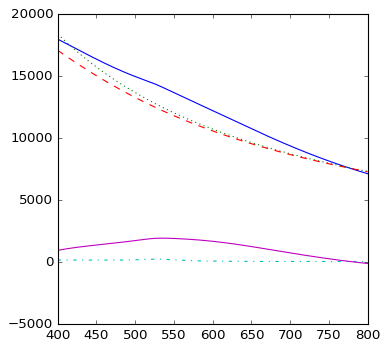

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 535.]) array([ 1889.0467]) 219.0 1.4421058963738433]


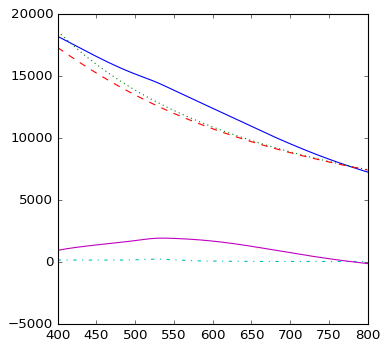

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 1883.7738]) 230.0 1.4421058963738433]


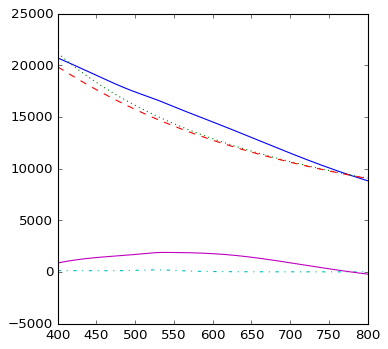

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 1823.3434]) 260.0 1.4421058963738433]


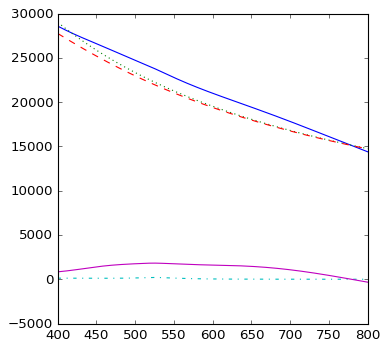

    525.21 ,	 [525.0, 207.79, 11.0, 1.45] 	 (-5.36, 28.568)	 1.379 	 (0.00, 1.00) 	 1.047
    525.21 ,	 [525.0, 207.79, 14.0, 1.45] 	 (-5.36, 28.579)	 1.379 	 (0.00, 1.00) 	 1.046
    525.21 ,	 [525.0, 207.79, 15.0, 1.45] 	 (-5.36, 28.586)	 1.379 	 (0.00, 1.00) 	 1.046
    525.21 ,	 [525.0, 207.79, 16.0, 1.45] 	 (-5.36, 28.596)	 1.379 	 (0.00, 1.00) 	 1.046
    525.21 ,	 [525.0, 207.79, 17.0, 1.45] 	 (-5.36, 28.610)	 1.379 	 (0.00, 1.00) 	 1.046
    525.21 ,	 [525.0, 207.78, 20.0, 1.45] 	 (-5.36, 28.683)	 1.379 	 (0.00, 1.00) 	 1.044
    525.21 ,	 [525.0, 207.78, 21.0, 1.45] 	 (-5.35, 28.723)	 1.379 	 (0.00, 1.00) 	 1.044
    525.21 ,	 [525.0, 207.77, 22.0, 1.45] 	 (-5.35, 28.773)	 1.379 	 (0.00, 1.00) 	 1.043
    525.21 ,	 [525.0, 207.76, 23.0, 1.45] 	 (-5.35, 28.836)	 1.379 	 (0.00, 1.00) 	 1.042
    525.21 ,	 [525.0, 207.76, 24.0, 1.45] 	 (-5.34, 28.913)	 1.379 	 (0.00, 1.00) 	 1.040
    525.21 ,	 [525.0, 207.74, 26.0, 1.45] 	 (-5.33, 29.124)	 1.379 	 (0.00, 1.00) 	 1.036
    525.21

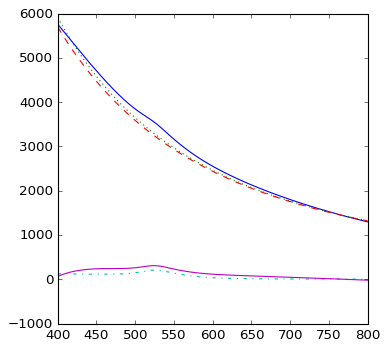

    523.87 ,	 [524.0, 308.02, 140.0, 1.45] 	 (-2.16, 3152.619)	 2.041 	 (-2.12, 3100.54) 	 0.392
	* Warning *: large scattering cross section:  [ 520.      452.434   150.        1.4521]


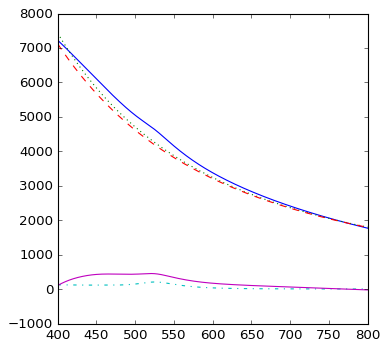

    518.86 ,	 [520.0, 452.43, 150.0, 1.45] 	 (-2.05, 4098.304)	 2.977 	 (-2.00, 4021.35) 	 0.416
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 519.]) array([ 873.2153]) 164.0 1.4521058963738434]


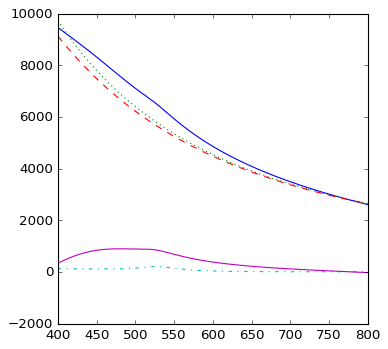

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 519.]) array([ 909.1051]) 165.0 1.4521058963738434]


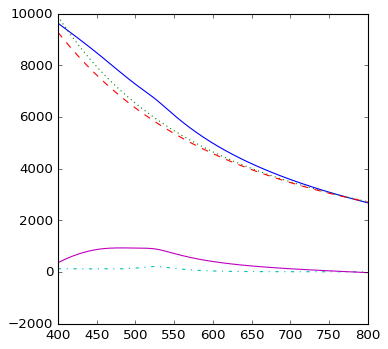

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 519.]) array([ 945.6328]) 166.0 1.4521058963738434]


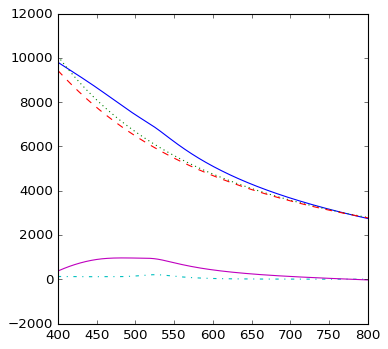

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 519.]) array([ 1107.0801]) 170.0 1.4521058963738434]


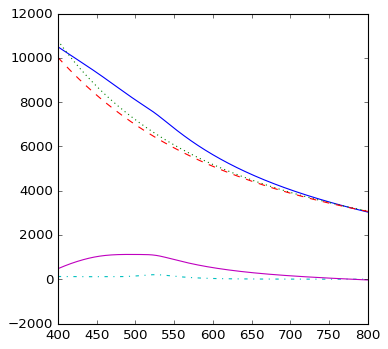

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 519.]) array([ 1491.9036]) 180.0 1.4521058963738434]


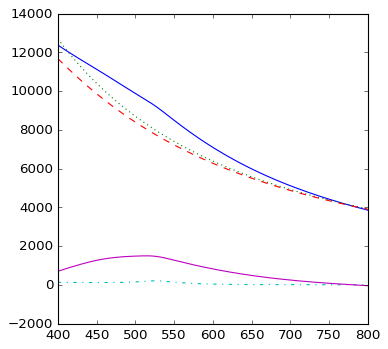

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 2037.7703]) 200.0 1.4521058963738434]


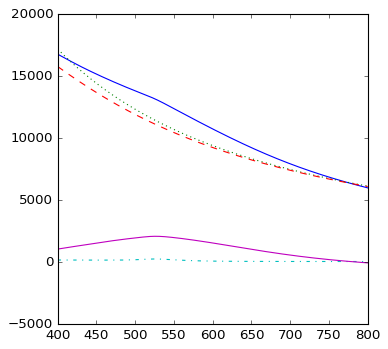

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 2169.545]) 210.0 1.4521058963738434]


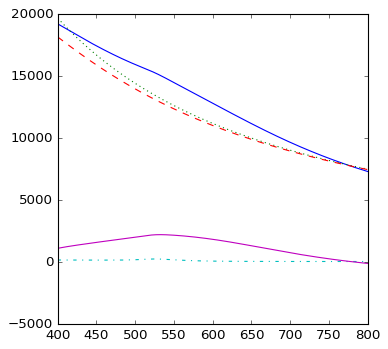

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 2206.5207]) 217.0 1.4521058963738434]


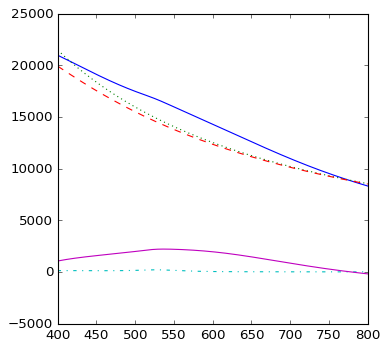

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 2210.0518]) 218.0 1.4521058963738434]


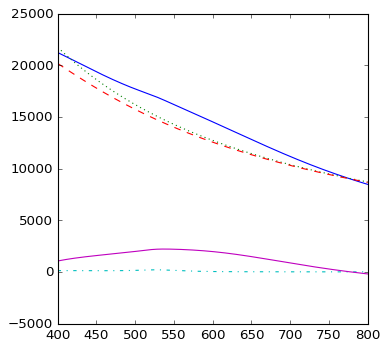

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 538.]) array([ 2212.3896]) 219.0 1.4521058963738434]


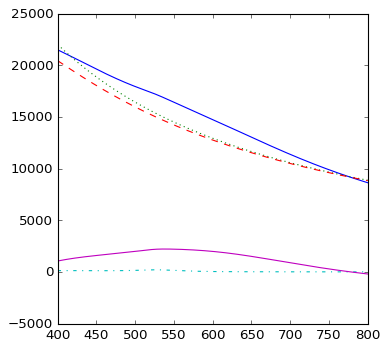

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 542.]) array([ 2227.8138]) 230.0 1.4521058963738434]


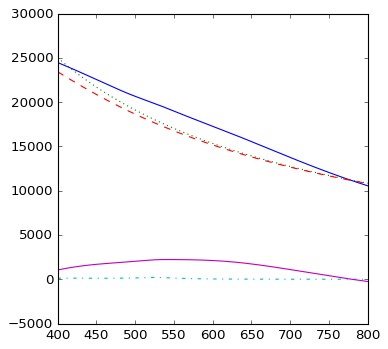

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 2145.1526]) 260.0 1.4521058963738434]


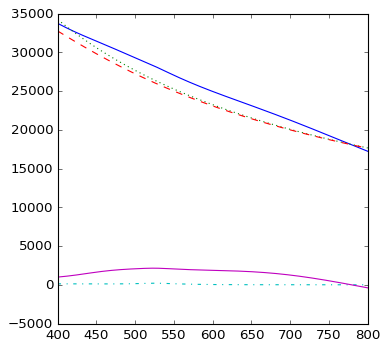

    525.74 ,	 [526.0, 213.01, 11.0, 1.46] 	 (-5.34, 29.120)	 1.416 	 (0.00, 1.00) 	 1.059
    525.74 ,	 [526.0, 213.01, 14.0, 1.46] 	 (-5.34, 29.132)	 1.416 	 (0.00, 1.00) 	 1.058
    525.74 ,	 [526.0, 213.01, 15.0, 1.46] 	 (-5.34, 29.141)	 1.416 	 (0.00, 1.00) 	 1.058
    525.74 ,	 [526.0, 213.01, 16.0, 1.46] 	 (-5.34, 29.153)	 1.416 	 (0.00, 1.00) 	 1.058
    525.74 ,	 [526.0, 213.01, 17.0, 1.46] 	 (-5.34, 29.169)	 1.416 	 (0.00, 1.00) 	 1.058
    525.74 ,	 [526.0, 213.0, 20.0, 1.46] 	 (-5.33, 29.254)	 1.416 	 (0.00, 1.00) 	 1.056
    525.74 ,	 [526.0, 212.99, 21.0, 1.46] 	 (-5.33, 29.301)	 1.416 	 (0.00, 1.00) 	 1.055
    525.74 ,	 [526.0, 212.99, 22.0, 1.46] 	 (-5.33, 29.359)	 1.416 	 (0.00, 1.00) 	 1.054
    525.74 ,	 [526.0, 212.98, 23.0, 1.46] 	 (-5.32, 29.432)	 1.416 	 (0.00, 1.00) 	 1.053
    525.75 ,	 [526.0, 212.97, 24.0, 1.46] 	 (-5.32, 29.523)	 1.416 	 (0.00, 1.00) 	 1.051
    525.75 ,	 [526.0, 212.95, 26.0, 1.46] 	 (-5.31, 29.769)	 1.416 	 (0.00, 1.00) 	 1.046
    525.75 

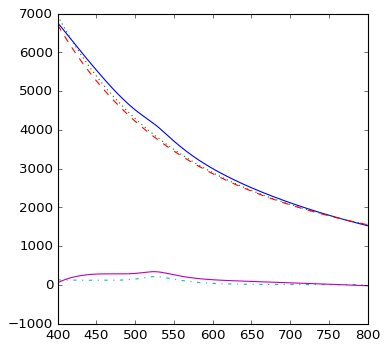

    523.7 ,	 [524.0, 338.95, 140.0, 1.46] 	 (-2.16, 3706.359)	 2.246 	 (-2.12, 3649.06) 	 0.391
	* Warning *: large scattering cross section:  [ 518.      536.1103  150.        1.4621]


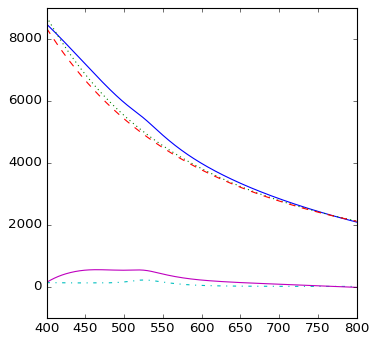

    516.59 ,	 [518.0, 536.11, 150.0, 1.46] 	 (-2.04, 4807.157)	 3.514 	 (-1.99, 4716.11) 	 0.420
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1053.2682]) 164.0 1.4621058963738434]


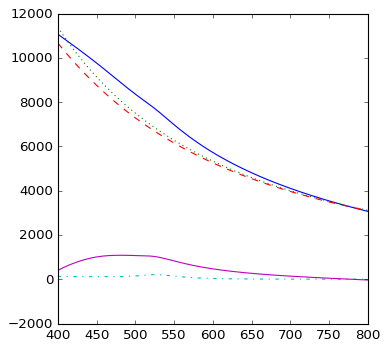

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1096.8435]) 165.0 1.4621058963738434]


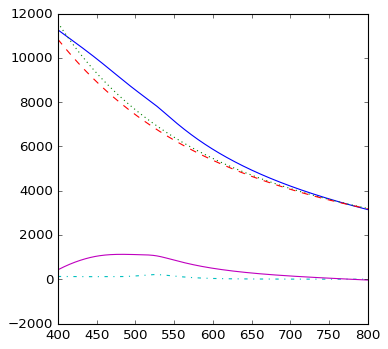

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1141.0019]) 166.0 1.4621058963738434]


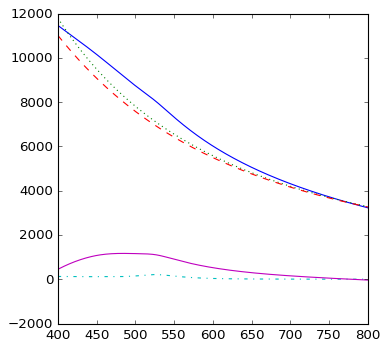

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1334.1787]) 170.0 1.4621058963738434]


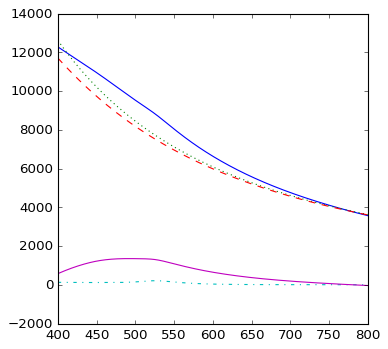

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1779.6768]) 180.0 1.4621058963738434]


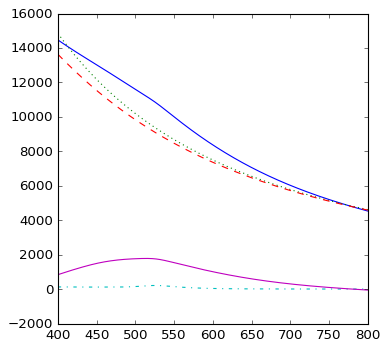

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 2380.6794]) 200.0 1.4621058963738434]


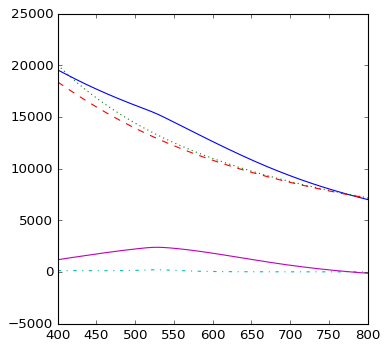

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 535.]) array([ 2519.1451]) 210.0 1.4621058963738434]


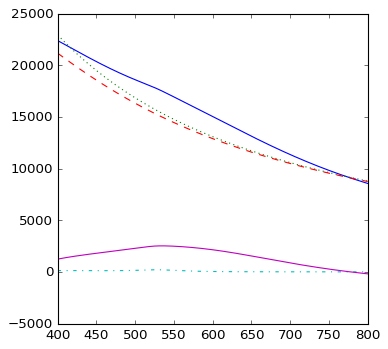

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 2583.4012]) 217.0 1.4621058963738434]


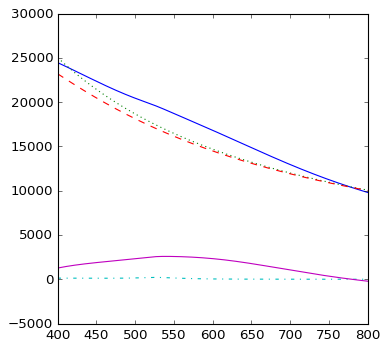

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 540.]) array([ 2586.4002]) 218.0 1.4621058963738434]


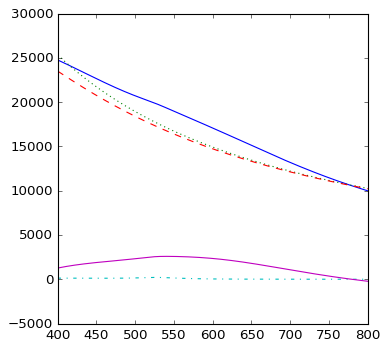

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 541.]) array([ 2588.6834]) 219.0 1.4621058963738434]


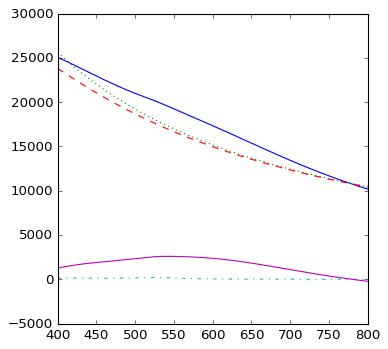

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 2574.1059]) 230.0 1.4621058963738434]


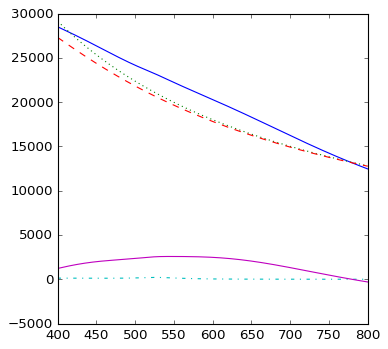

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 2531.7381]) 260.0 1.4621058963738434]


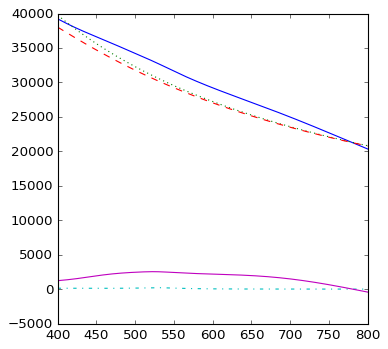

    526.27 ,	 [526.0, 218.34, 11.0, 1.47] 	 (-5.32, 29.680)	 1.451 	 (0.00, 1.00) 	 1.071
    526.27 ,	 [526.0, 218.33, 14.0, 1.47] 	 (-5.31, 29.695)	 1.451 	 (0.00, 1.00) 	 1.070
    526.27 ,	 [526.0, 218.33, 15.0, 1.47] 	 (-5.31, 29.704)	 1.451 	 (0.00, 1.00) 	 1.070
    526.27 ,	 [526.0, 218.33, 16.0, 1.47] 	 (-5.31, 29.718)	 1.451 	 (0.00, 1.00) 	 1.070
    526.27 ,	 [526.0, 218.33, 17.0, 1.47] 	 (-5.31, 29.736)	 1.451 	 (0.00, 1.00) 	 1.070
    526.27 ,	 [526.0, 218.32, 20.0, 1.47] 	 (-5.31, 29.835)	 1.451 	 (0.00, 1.00) 	 1.068
    526.27 ,	 [526.0, 218.32, 21.0, 1.47] 	 (-5.31, 29.889)	 1.451 	 (0.00, 1.00) 	 1.067
    526.27 ,	 [526.0, 218.31, 22.0, 1.47] 	 (-5.30, 29.956)	 1.451 	 (0.00, 1.00) 	 1.065
    526.27 ,	 [526.0, 218.3, 23.0, 1.47] 	 (-5.30, 30.041)	 1.451 	 (0.00, 1.00) 	 1.064
    526.27 ,	 [526.0, 218.29, 24.0, 1.47] 	 (-5.29, 30.146)	 1.451 	 (0.00, 1.00) 	 1.062
    526.27 ,	 [526.0, 218.27, 26.0, 1.47] 	 (-5.28, 30.430)	 1.451 	 (0.00, 1.00) 	 1.057
    526.27 

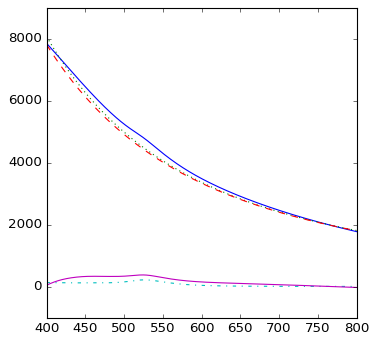

    523.35 ,	 [524.0, 374.93, 140.0, 1.47] 	 (-2.16, 4306.646)	 2.484 	 (-2.12, 4243.27) 	 0.391
	* Warning *: large scattering cross section:  [ 523.      621.6145  150.        1.4721]


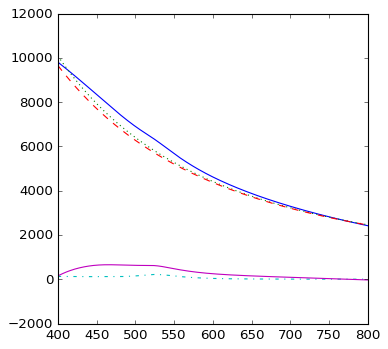

    516.29 ,	 [523.0, 621.61, 150.0, 1.47] 	 (-2.04, 5579.652)	 4.111 	 (-1.99, 5473.26) 	 0.423
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1260.3276]) 164.0 1.4721058963738434]


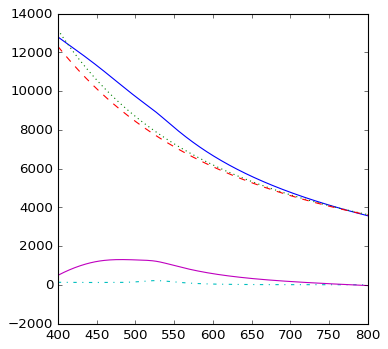

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1325.3247]) 165.0 1.4721058963738434]


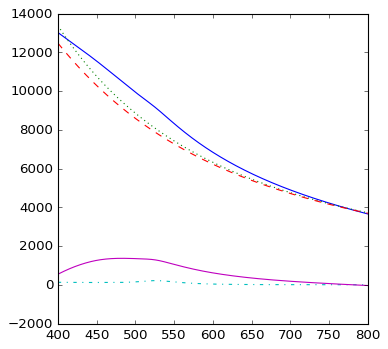

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1377.9697]) 166.0 1.4721058963738434]


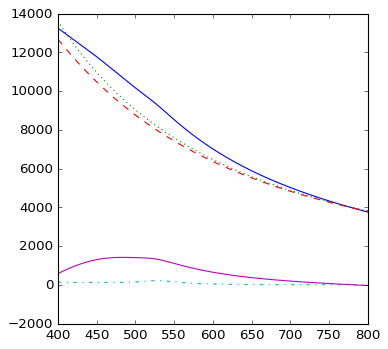

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 1590.7769]) 170.0 1.4721058963738434]


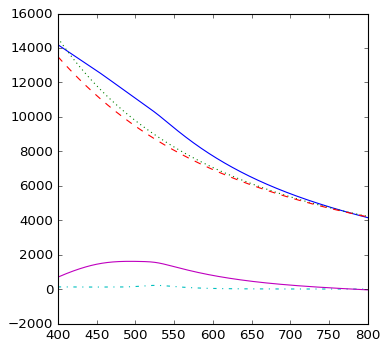

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 2097.0813]) 180.0 1.4721058963738434]


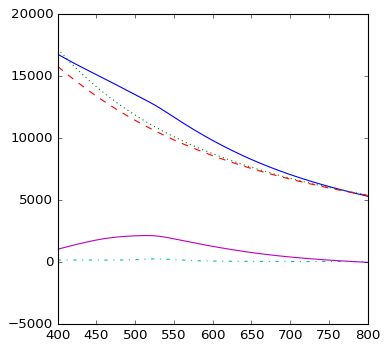

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 2750.3362]) 200.0 1.4721058963738434]


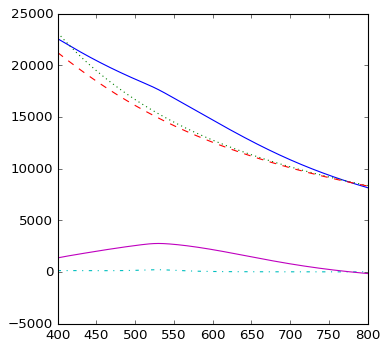

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 2918.8828]) 210.0 1.4721058963738434]


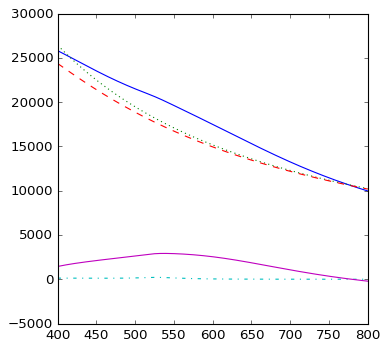

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 543.]) array([ 2961.0963]) 217.0 1.4721058963738434]


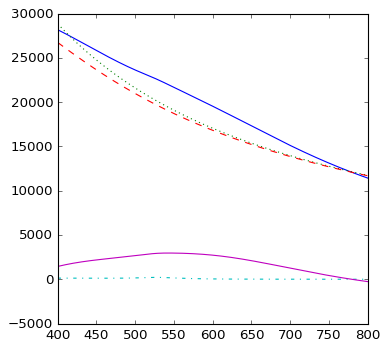

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 2963.6773]) 218.0 1.4721058963738434]


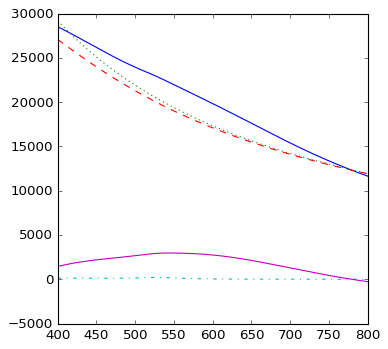

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 2966.0393]) 219.0 1.4721058963738434]


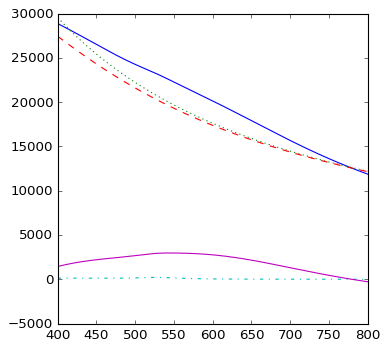

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 2781.8414]) 230.0 1.4721058963738434]


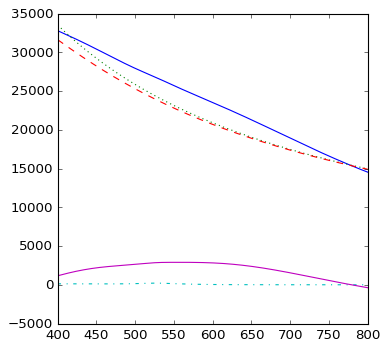

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 2917.812]) 260.0 1.4721058963738434]


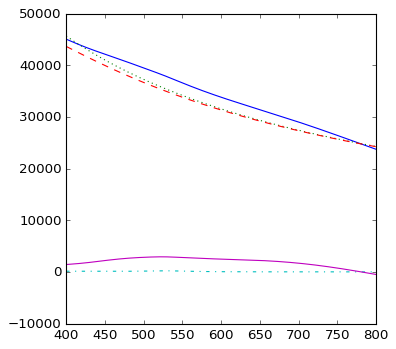

    527.36 ,	 [527.0, 223.84, 11.0, 1.48] 	 (-5.27, 30.098)	 1.490 	 (0.00, 1.00) 	 1.095
    527.36 ,	 [527.0, 223.84, 14.0, 1.48] 	 (-5.27, 30.114)	 1.490 	 (0.00, 1.00) 	 1.095
    527.36 ,	 [527.0, 223.84, 15.0, 1.48] 	 (-5.27, 30.125)	 1.490 	 (0.00, 1.00) 	 1.095
    527.36 ,	 [527.0, 223.84, 16.0, 1.48] 	 (-5.27, 30.141)	 1.490 	 (0.00, 1.00) 	 1.094
    527.36 ,	 [527.0, 223.84, 17.0, 1.48] 	 (-5.27, 30.162)	 1.490 	 (0.00, 1.00) 	 1.094
    527.36 ,	 [527.0, 223.83, 20.0, 1.48] 	 (-5.26, 30.275)	 1.490 	 (0.00, 1.00) 	 1.092
    527.36 ,	 [527.0, 223.82, 21.0, 1.48] 	 (-5.26, 30.336)	 1.490 	 (0.00, 1.00) 	 1.090
    527.36 ,	 [527.0, 223.82, 22.0, 1.48] 	 (-5.26, 30.413)	 1.490 	 (0.00, 1.00) 	 1.089
    527.36 ,	 [527.0, 223.81, 23.0, 1.48] 	 (-5.25, 30.510)	 1.490 	 (0.00, 1.00) 	 1.087
    527.36 ,	 [527.0, 223.8, 24.0, 1.48] 	 (-5.25, 30.629)	 1.490 	 (0.00, 1.00) 	 1.085
    527.36 ,	 [527.0, 223.77, 26.0, 1.48] 	 (-5.23, 30.953)	 1.490 	 (0.00, 1.00) 	 1.078
    527.36 

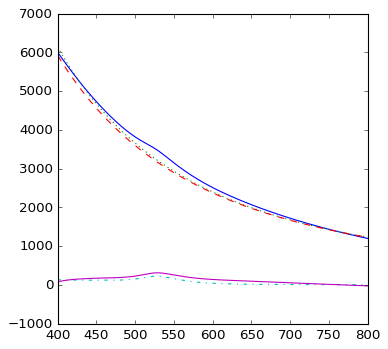

    528.62 ,	 [528.0, 309.03, 125.0, 1.48] 	 (-2.32, 3125.191)	 2.061 	 (-2.28, 3073.38) 	 0.367
	* Warning *: large scattering cross section:  [ 528.      308.3944  126.        1.4821]


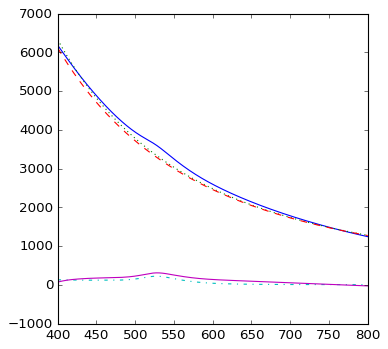

    528.54 ,	 [528.0, 308.39, 126.0, 1.48] 	 (-2.31, 3232.416)	 2.056 	 (-2.27, 3180.68) 	 0.369
	* Warning *: large scattering cross section:  [ 528.      308.2012  127.        1.4821]


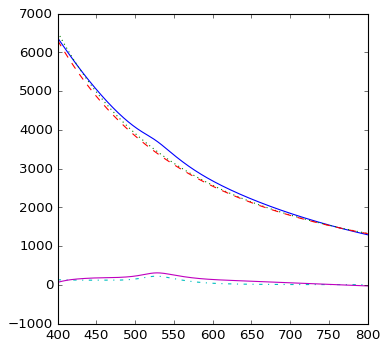

    528.44 ,	 [528.0, 308.2, 127.0, 1.48] 	 (-2.30, 3341.997)	 2.055 	 (-2.26, 3290.25) 	 0.369
	* Warning *: large scattering cross section:  [ 524.      426.835   140.        1.4821]


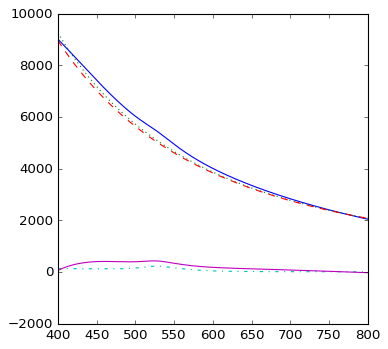

    523.1 ,	 [524.0, 426.84, 140.0, 1.48] 	 (-2.16, 4945.002)	 2.828 	 (-2.12, 4872.83) 	 0.391
	* Warning *: large scattering cross section:  [ 523.      725.8543  150.        1.4821]


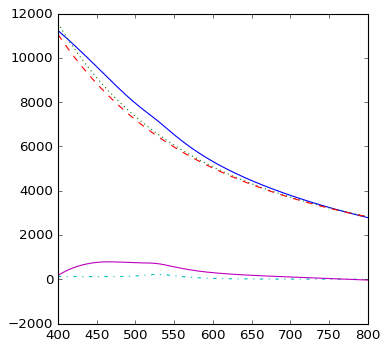

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 1477.0452]) 164.0 1.4821058963738434]


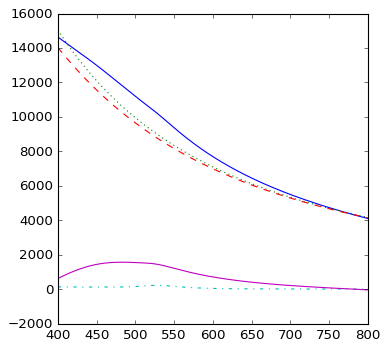

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 1537.7385]) 165.0 1.4821058963738434]


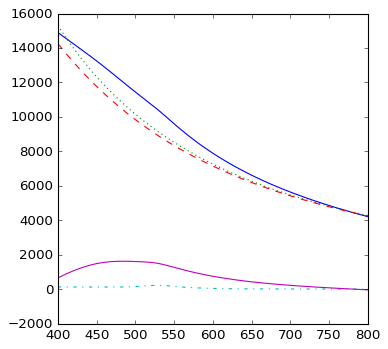

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 1598.9688]) 166.0 1.4821058963738434]


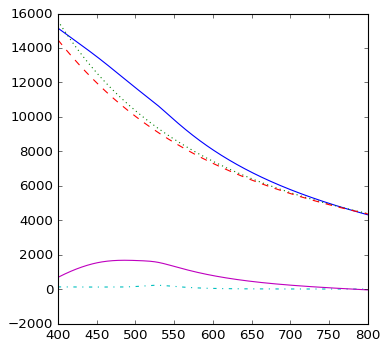

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 523.]) array([ 1847.5156]) 170.0 1.4821058963738434]


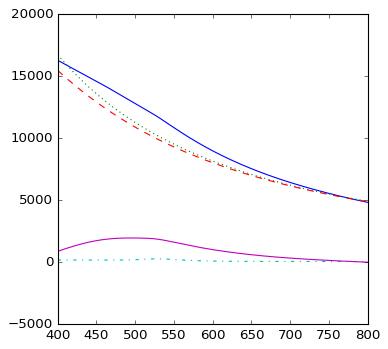

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 516.]) array([ 2443.3101]) 180.0 1.4821058963738434]


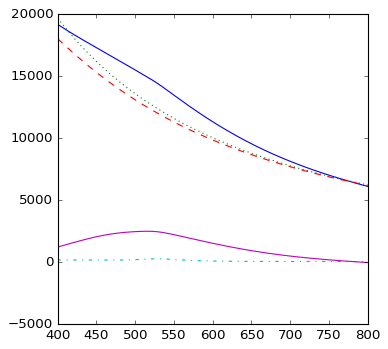

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 3177.6588]) 200.0 1.4821058963738434]


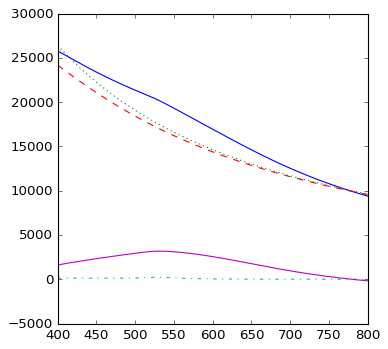

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 540.]) array([ 3325.5149]) 210.0 1.4821058963738434]


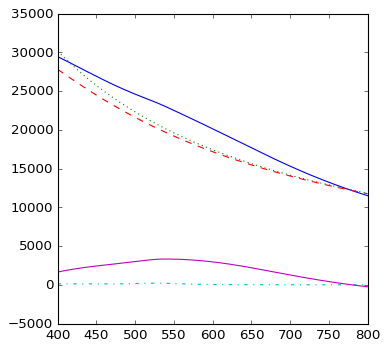

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 3366.0429]) 217.0 1.4821058963738434]


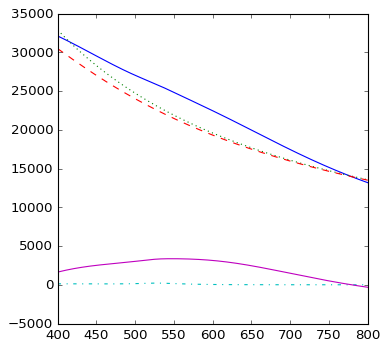

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 548.]) array([ 3368.097]) 218.0 1.4821058963738434]


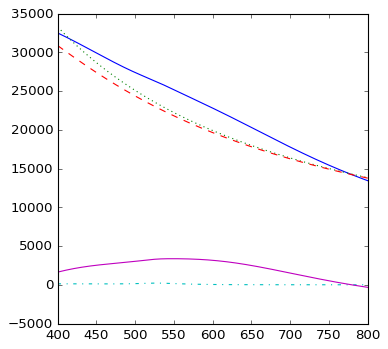

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 549.]) array([ 3369.8829]) 219.0 1.4821058963738434]


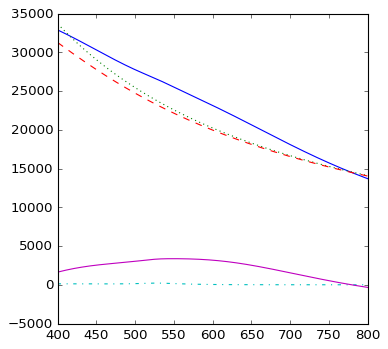

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 546.]) array([ 3368.8195]) 230.0 1.4821058963738434]


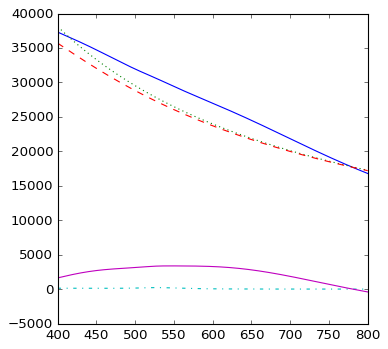

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 3334.3641]) 260.0 1.4821058963738434]


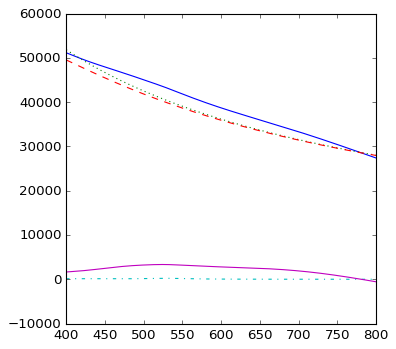

    527.92 ,	 [528.0, 229.21, 11.0, 1.49] 	 (-5.25, 30.653)	 1.529 	 (0.00, 1.00) 	 1.108
    527.92 ,	 [528.0, 229.21, 14.0, 1.49] 	 (-5.25, 30.672)	 1.529 	 (0.00, 1.00) 	 1.107
    527.92 ,	 [528.0, 229.21, 15.0, 1.49] 	 (-5.25, 30.684)	 1.529 	 (0.00, 1.00) 	 1.107
    527.92 ,	 [528.0, 229.21, 16.0, 1.49] 	 (-5.24, 30.702)	 1.529 	 (0.00, 1.00) 	 1.107
    527.92 ,	 [528.0, 229.21, 17.0, 1.49] 	 (-5.24, 30.725)	 1.529 	 (0.00, 1.00) 	 1.106
    527.92 ,	 [528.0, 229.19, 20.0, 1.49] 	 (-5.24, 30.853)	 1.529 	 (0.00, 1.00) 	 1.104
    527.92 ,	 [528.0, 229.19, 21.0, 1.49] 	 (-5.24, 30.923)	 1.529 	 (0.00, 1.00) 	 1.102
    527.92 ,	 [528.0, 229.18, 22.0, 1.49] 	 (-5.23, 31.010)	 1.529 	 (0.00, 1.00) 	 1.101
    527.92 ,	 [528.0, 229.17, 23.0, 1.49] 	 (-5.23, 31.120)	 1.528 	 (0.00, 1.00) 	 1.098
    527.92 ,	 [528.0, 229.16, 24.0, 1.49] 	 (-5.22, 31.255)	 1.528 	 (0.00, 1.00) 	 1.096
    527.93 ,	 [528.0, 229.13, 26.0, 1.49] 	 (-5.21, 31.622)	 1.528 	 (0.00, 1.00) 	 1.089
    527.93

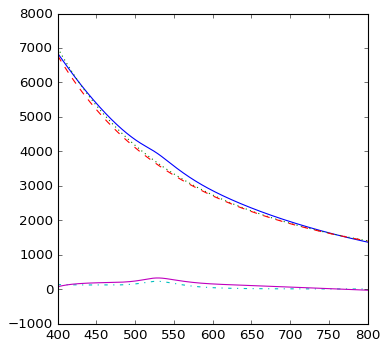

    529.23 ,	 [529.0, 323.7, 125.0, 1.49] 	 (-2.32, 3565.020)	 2.162 	 (-2.28, 3510.73) 	 0.365
	* Warning *: large scattering cross section:  [ 529.      323.2681  126.        1.4921]


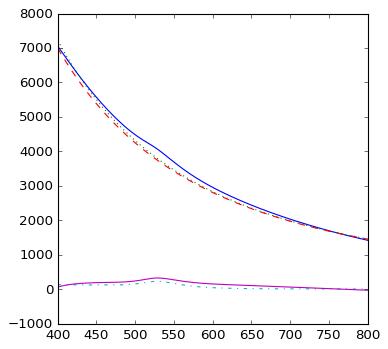

    529.12 ,	 [529.0, 323.27, 126.0, 1.49] 	 (-2.31, 3687.483)	 2.159 	 (-2.28, 3633.22) 	 0.365
	* Warning *: large scattering cross section:  [ 529.      323.4396  127.        1.4921]


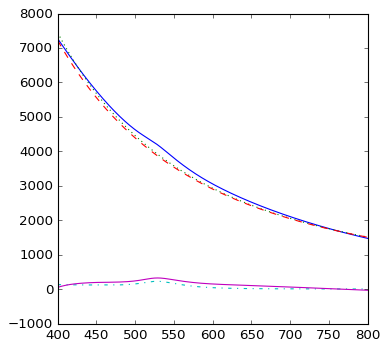

    528.97 ,	 [529.0, 323.44, 127.0, 1.49] 	 (-2.30, 3812.590)	 2.161 	 (-2.27, 3758.26) 	 0.366
	* Warning *: large scattering cross section:  [ 523.      477.9712  140.        1.4921]


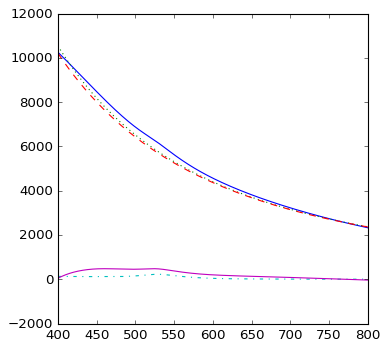

    522.08 ,	 [523.0, 477.97, 140.0, 1.49] 	 (-2.15, 5636.814)	 3.161 	 (-2.12, 5556.07) 	 0.393
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 864.6205]) 150.0 1.4921058963738434]


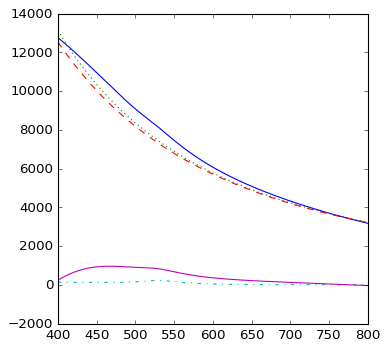

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 1745.3903]) 164.0 1.4921058963738434]


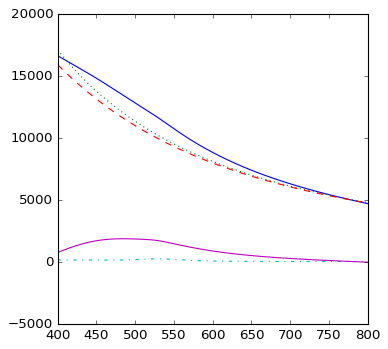

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 1815.5724]) 165.0 1.4921058963738434]


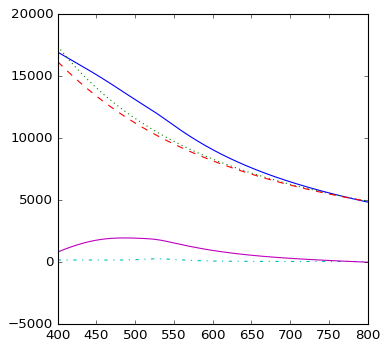

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 1886.0769]) 166.0 1.4921058963738434]


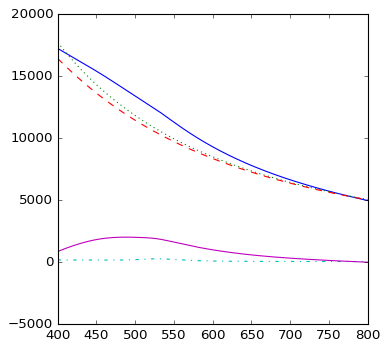

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 2168.6315]) 170.0 1.4921058963738434]


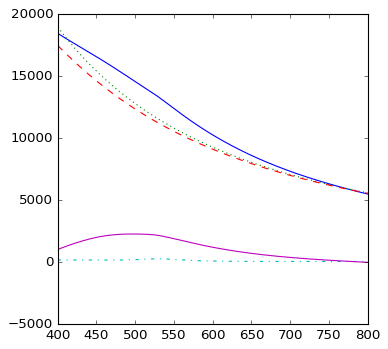

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 2820.9596]) 180.0 1.4921058963738434]


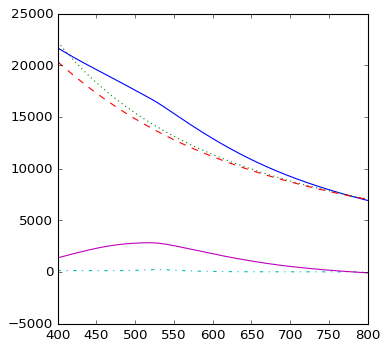

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 3603.3272]) 200.0 1.4921058963738434]


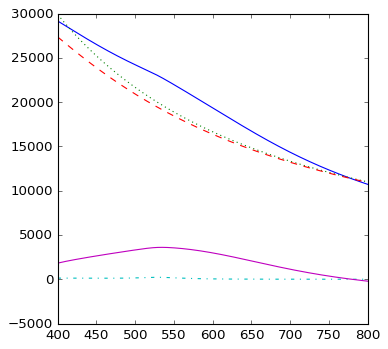

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 3753.2435]) 210.0 1.4921058963738434]


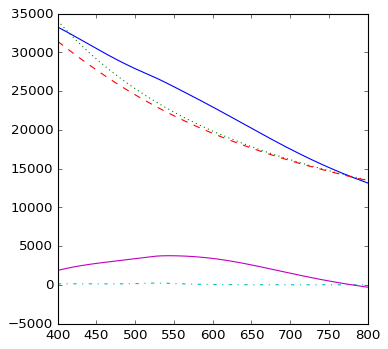

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 551.]) array([ 3791.0915]) 217.0 1.4921058963738434]


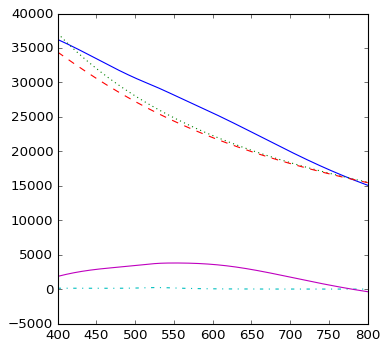

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 3616.2383]) 218.0 1.4921058963738434]


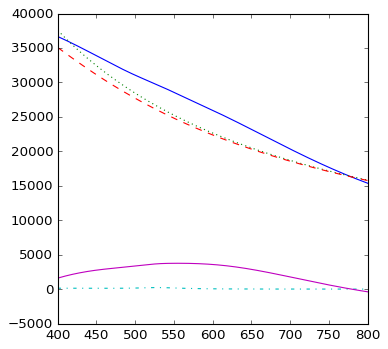

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 3616.4693]) 219.0 1.4921058963738434]


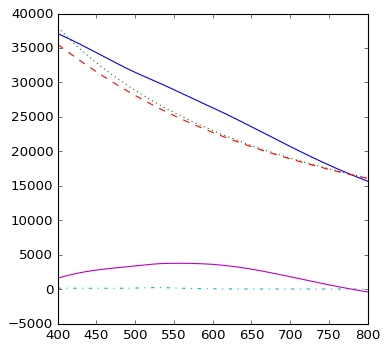

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 543.]) array([ 3779.2514]) 230.0 1.4921058963738434]


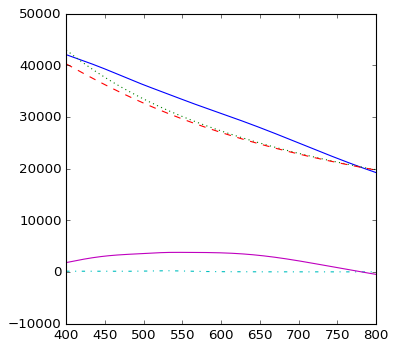

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 3781.2193]) 260.0 1.4921058963738434]


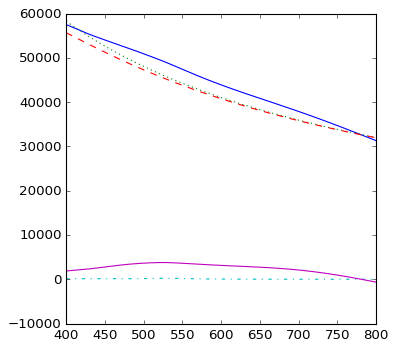

    528.48 ,	 [528.0, 234.61, 11.0, 1.5] 	 (-5.22, 31.218)	 1.564 	 (0.00, 1.00) 	 1.120
    528.48 ,	 [528.0, 234.61, 14.0, 1.5] 	 (-5.22, 31.239)	 1.564 	 (0.00, 1.00) 	 1.119
    528.48 ,	 [528.0, 234.6, 15.0, 1.5] 	 (-5.22, 31.253)	 1.564 	 (0.00, 1.00) 	 1.119
    528.48 ,	 [528.0, 234.6, 16.0, 1.5] 	 (-5.22, 31.272)	 1.564 	 (0.00, 1.00) 	 1.119
    528.48 ,	 [528.0, 234.6, 17.0, 1.5] 	 (-5.22, 31.299)	 1.564 	 (0.00, 1.00) 	 1.118
    528.48 ,	 [528.0, 234.59, 20.0, 1.5] 	 (-5.21, 31.443)	 1.564 	 (0.00, 1.00) 	 1.115
    528.48 ,	 [528.0, 234.58, 21.0, 1.5] 	 (-5.21, 31.521)	 1.564 	 (0.00, 1.00) 	 1.114
    528.48 ,	 [528.0, 234.57, 22.0, 1.5] 	 (-5.21, 31.619)	 1.564 	 (0.00, 1.00) 	 1.112
    528.48 ,	 [528.0, 234.56, 23.0, 1.5] 	 (-5.20, 31.742)	 1.564 	 (0.00, 1.00) 	 1.109
    528.48 ,	 [528.0, 234.55, 24.0, 1.5] 	 (-5.20, 31.894)	 1.564 	 (0.00, 1.00) 	 1.106
    528.48 ,	 [528.0, 234.52, 26.0, 1.5] 	 (-5.18, 32.307)	 1.564 	 (0.00, 1.00) 	 1.099
    528.49 ,	 [528.0, 23

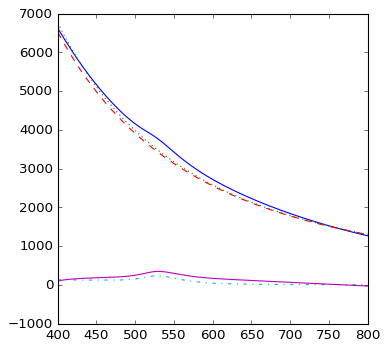

    530.11 ,	 [530.0, 346.45, 120.0, 1.5] 	 (-2.38, 3387.158)	 2.318 	 (-2.34, 3329.27) 	 0.360
	* Warning *: large scattering cross section:  [ 530.      338.3465  125.        1.5021]


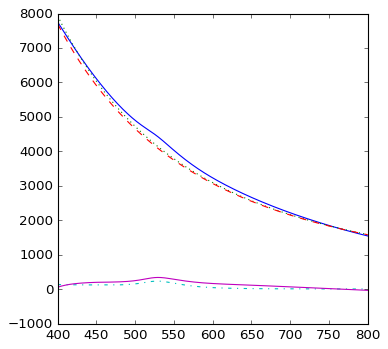

    529.82 ,	 [530.0, 338.35, 125.0, 1.5] 	 (-2.32, 4035.901)	 2.264 	 (-2.29, 3979.12) 	 0.361
	* Warning *: large scattering cross section:  [ 530.      338.2784  126.        1.5021]


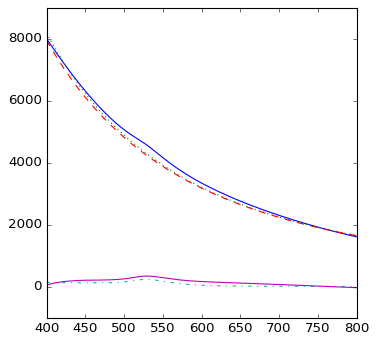

    529.66 ,	 [530.0, 338.28, 126.0, 1.5] 	 (-2.31, 4174.608)	 2.263 	 (-2.28, 4117.79) 	 0.362
	* Warning *: large scattering cross section:  [ 529.      339.0777  127.        1.5021]


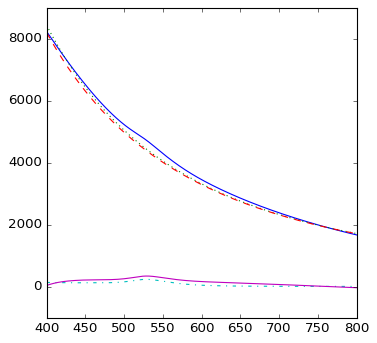

    529.44 ,	 [529.0, 339.08, 127.0, 1.5] 	 (-2.30, 4316.254)	 2.265 	 (-2.27, 4259.27) 	 0.364
	* Warning *: large scattering cross section:  [ 522.      538.5729  140.        1.5021]


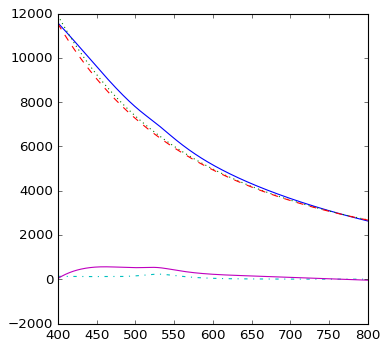

    520.51 ,	 [522.0, 538.57, 140.0, 1.5] 	 (-2.15, 6374.614)	 3.556 	 (-2.12, 6283.76) 	 0.396
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 1013.7902]) 150.0 1.5021058963738434]


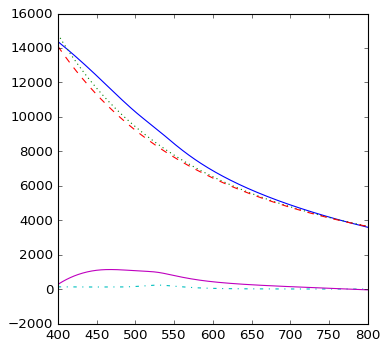

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 2047.8197]) 164.0 1.5021058963738434]


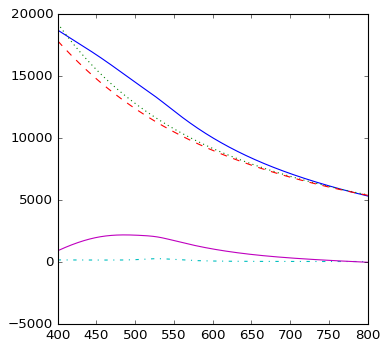

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 2127.7204]) 165.0 1.5021058963738434]


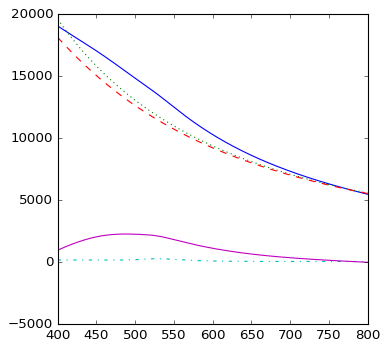

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 2207.6489]) 166.0 1.5021058963738434]


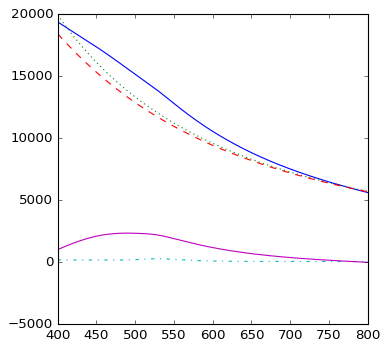

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 2523.8776]) 170.0 1.5021058963738434]


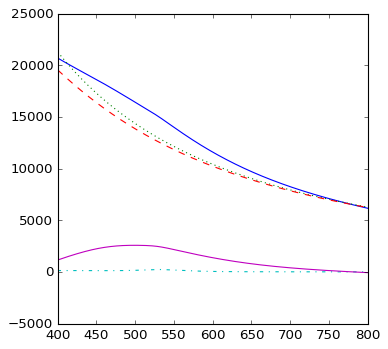

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 519.]) array([ 3228.5972]) 180.0 1.5021058963738434]


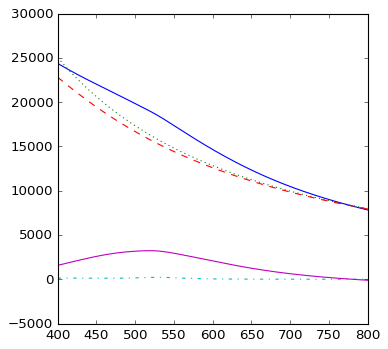

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 4053.8478]) 200.0 1.5021058963738434]


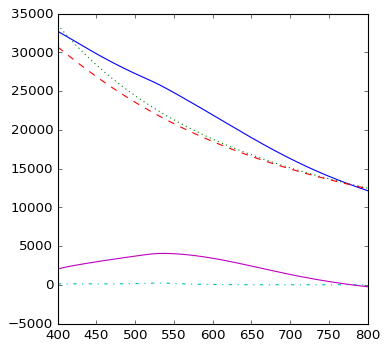

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 547.]) array([ 4204.1494]) 210.0 1.5021058963738434]


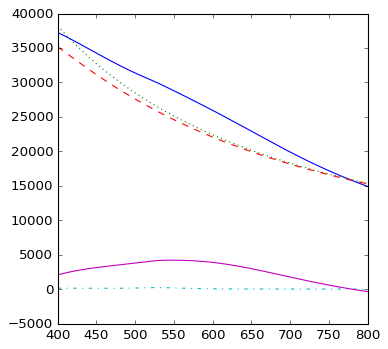

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 4063.5187]) 217.0 1.5021058963738434]


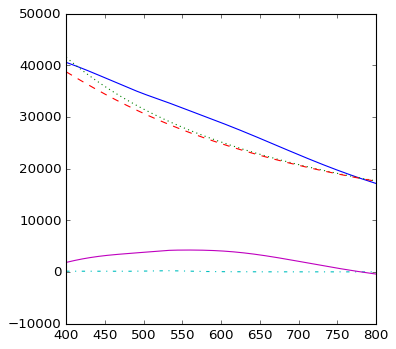

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 4065.6895]) 218.0 1.5021058963738434]


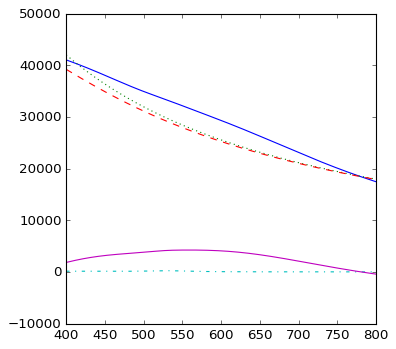

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 4068.094]) 219.0 1.5021058963738434]


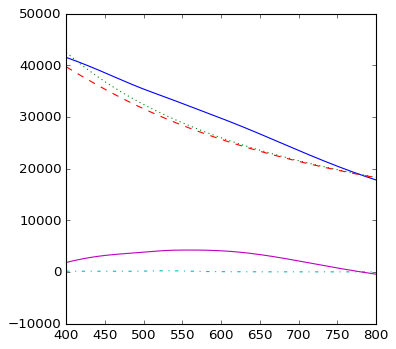

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 540.]) array([ 4212.5224]) 230.0 1.5021058963738434]


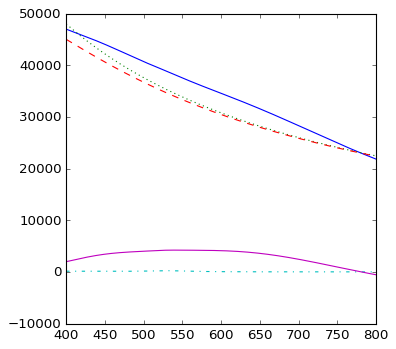

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 4259.9269]) 260.0 1.5021058963738434]


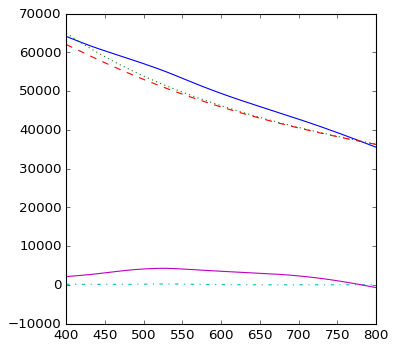

    529.07 ,	 [529.0, 240.02, 11.0, 1.51] 	 (-5.20, 31.769)	 1.603 	 (0.00, 1.00) 	 1.133
    529.07 ,	 [529.0, 240.01, 14.0, 1.51] 	 (-5.20, 31.793)	 1.603 	 (0.00, 1.00) 	 1.132
    529.07 ,	 [529.0, 240.01, 15.0, 1.51] 	 (-5.20, 31.808)	 1.603 	 (0.00, 1.00) 	 1.132
    529.07 ,	 [529.0, 240.01, 16.0, 1.51] 	 (-5.20, 31.830)	 1.603 	 (0.00, 1.00) 	 1.132
    529.07 ,	 [529.0, 240.01, 17.0, 1.51] 	 (-5.20, 31.860)	 1.603 	 (0.00, 1.00) 	 1.131
    529.07 ,	 [529.0, 240.0, 20.0, 1.51] 	 (-5.19, 32.020)	 1.603 	 (0.00, 1.00) 	 1.128
    529.07 ,	 [529.0, 239.99, 21.0, 1.51] 	 (-5.19, 32.107)	 1.603 	 (0.00, 1.00) 	 1.126
    529.07 ,	 [529.0, 239.98, 22.0, 1.51] 	 (-5.18, 32.217)	 1.603 	 (0.00, 1.00) 	 1.124
    529.07 ,	 [529.0, 239.97, 23.0, 1.51] 	 (-5.18, 32.354)	 1.603 	 (0.00, 1.00) 	 1.121
    529.07 ,	 [529.0, 239.96, 24.0, 1.51] 	 (-5.17, 32.524)	 1.603 	 (0.00, 1.00) 	 1.118
    529.07 ,	 [529.0, 239.92, 26.0, 1.51] 	 (-5.15, 32.985)	 1.603 	 (0.00, 1.00) 	 1.109
    529.08 

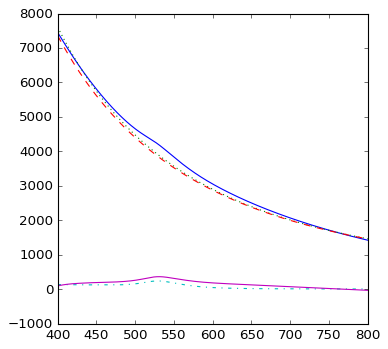

    530.83 ,	 [531.0, 360.85, 120.0, 1.51] 	 (-2.38, 3807.827)	 2.418 	 (-2.34, 3747.48) 	 0.357
	* Warning *: large scattering cross section:  [ 530.      353.0142  125.        1.5121]


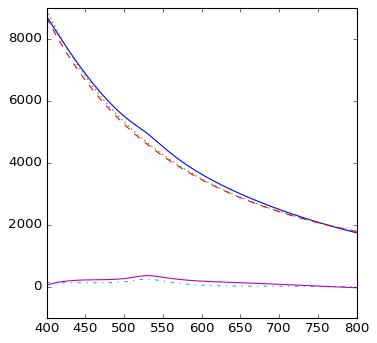

    530.35 ,	 [530.0, 353.01, 125.0, 1.51] 	 (-2.33, 4537.996)	 2.362 	 (-2.29, 4478.73) 	 0.360
	* Warning *: large scattering cross section:  [ 530.      353.6135  126.        1.5121]


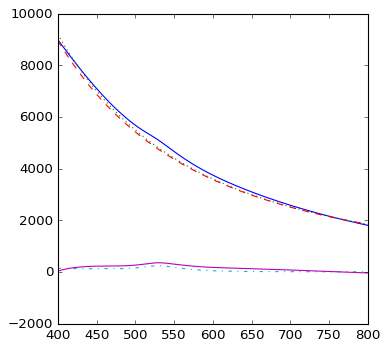

    530.14 ,	 [530.0, 353.61, 126.0, 1.51] 	 (-2.32, 4693.933)	 2.366 	 (-2.28, 4634.53) 	 0.360
	* Warning *: large scattering cross section:  [ 530.      355.2818  127.        1.5121]


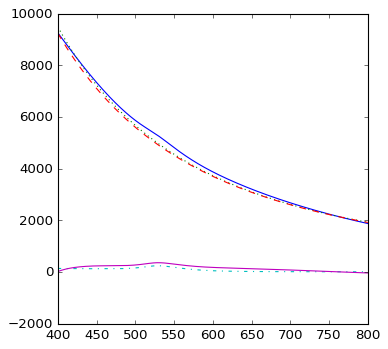

    529.88 ,	 [530.0, 355.28, 127.0, 1.51] 	 (-2.31, 4853.106)	 2.377 	 (-2.28, 4793.38) 	 0.361
	* Warning *: large scattering cross section:  [ 519.      625.04    140.        1.5121]


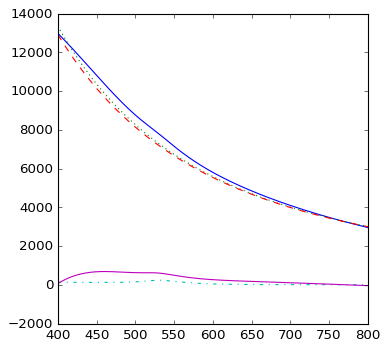

    516.72 ,	 [519.0, 625.04, 140.0, 1.51] 	 (-2.15, 7147.066)	 4.104 	 (-2.11, 7041.90) 	 0.402
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 1201.3428]) 150.0 1.5121058963738434]


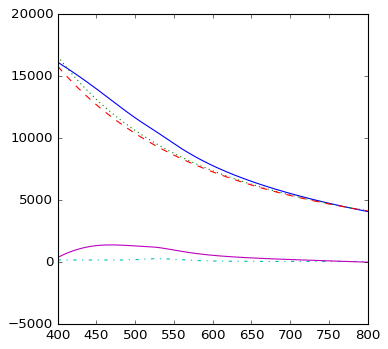

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 2405.1167]) 164.0 1.5121058963738434]


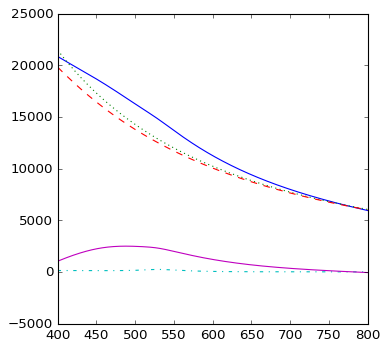

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 2494.1409]) 165.0 1.5121058963738434]


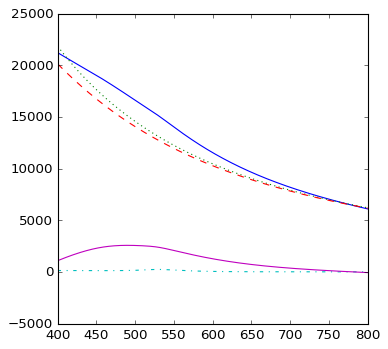

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 2582.6166]) 166.0 1.5121058963738434]


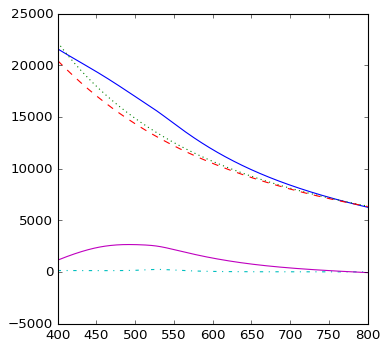

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 2926.9285]) 170.0 1.5121058963738434]


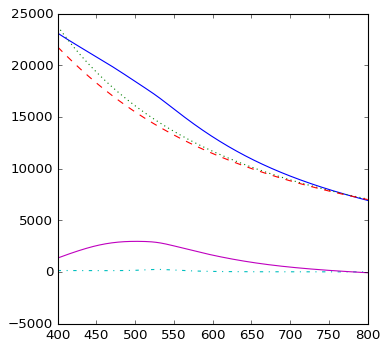

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 520.]) array([ 3665.5047]) 180.0 1.5121058963738434]


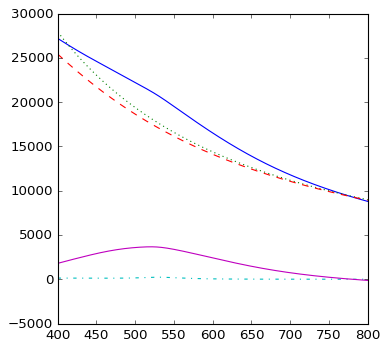

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 4521.7492]) 200.0 1.5121058963738434]


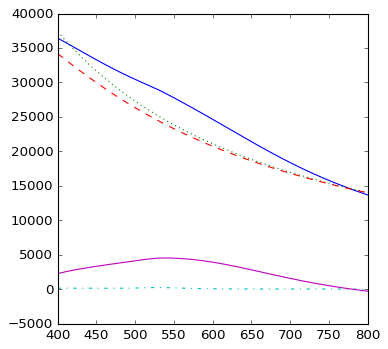

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 550.]) array([ 4722.3989]) 210.0 1.5121058963738434]


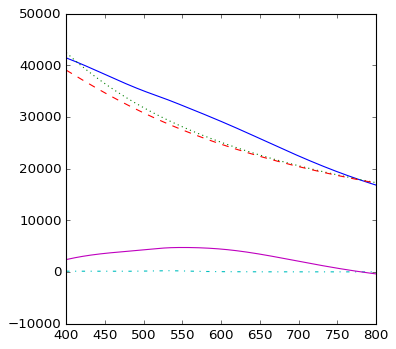

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 4439.7]) 217.0 1.5121058963738434]


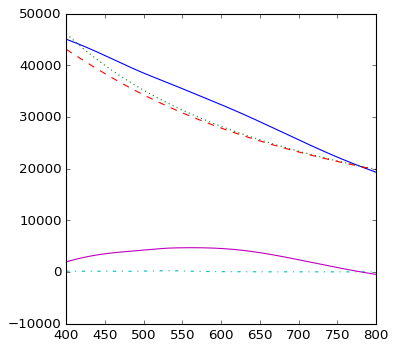

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 4445.4931]) 218.0 1.5121058963738434]


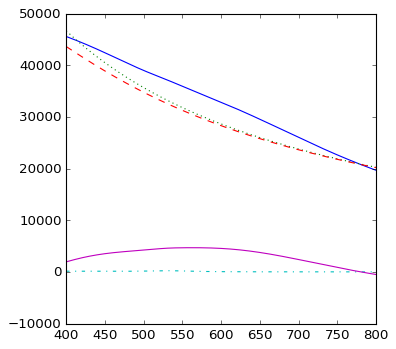

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 4451.7971]) 219.0 1.5121058963738434]


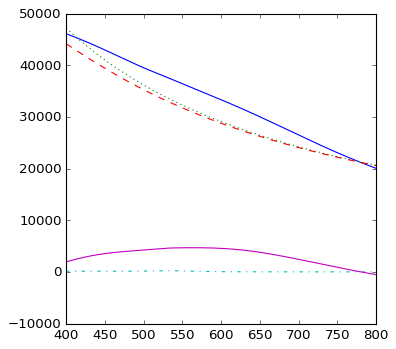

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 4675.3281]) 230.0 1.5121058963738434]


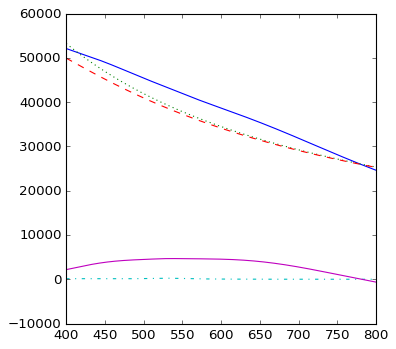

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 4771.8346]) 260.0 1.5121058963738434]


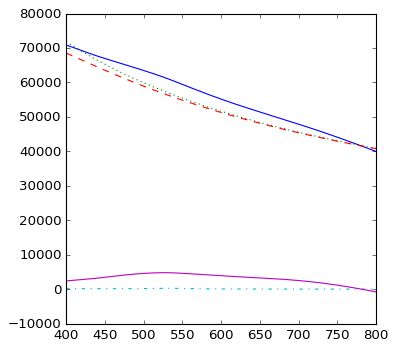

    529.66 ,	 [530.0, 245.46, 11.0, 1.52] 	 (-5.18, 32.334)	 1.642 	 (0.00, 1.00) 	 1.146
    529.66 ,	 [530.0, 245.46, 14.0, 1.52] 	 (-5.17, 32.360)	 1.642 	 (0.00, 1.00) 	 1.145
    529.66 ,	 [530.0, 245.46, 15.0, 1.52] 	 (-5.17, 32.378)	 1.642 	 (0.00, 1.00) 	 1.145
    529.66 ,	 [530.0, 245.46, 16.0, 1.52] 	 (-5.17, 32.402)	 1.642 	 (0.00, 1.00) 	 1.144
    529.66 ,	 [530.0, 245.46, 17.0, 1.52] 	 (-5.17, 32.435)	 1.642 	 (0.00, 1.00) 	 1.143
    529.66 ,	 [530.0, 245.44, 20.0, 1.52] 	 (-5.17, 32.613)	 1.642 	 (0.00, 1.00) 	 1.140
    529.66 ,	 [530.0, 245.44, 21.0, 1.52] 	 (-5.16, 32.709)	 1.642 	 (0.00, 1.00) 	 1.138
    529.66 ,	 [530.0, 245.43, 22.0, 1.52] 	 (-5.16, 32.831)	 1.642 	 (0.00, 1.00) 	 1.135
    529.66 ,	 [530.0, 245.42, 23.0, 1.52] 	 (-5.15, 32.983)	 1.642 	 (0.00, 1.00) 	 1.132
    529.66 ,	 [530.0, 245.4, 24.0, 1.52] 	 (-5.14, 33.172)	 1.642 	 (0.00, 1.00) 	 1.129
    529.66 ,	 [530.0, 245.37, 26.0, 1.52] 	 (-5.13, 33.683)	 1.642 	 (0.00, 1.00) 	 1.119
    529.67 

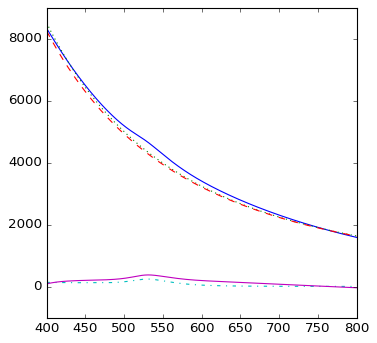

    531.53 ,	 [531.0, 374.83, 120.0, 1.52] 	 (-2.38, 4255.128)	 2.511 	 (-2.35, 4192.41) 	 0.354
	* Warning *: large scattering cross section:  [ 531.      368.0569  125.        1.5221]


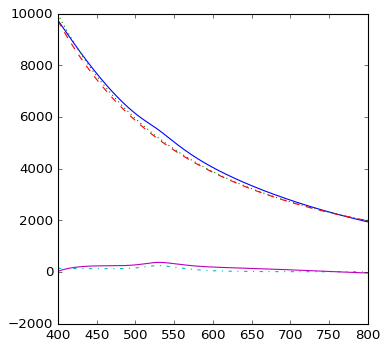

    530.87 ,	 [531.0, 368.06, 125.0, 1.52] 	 (-2.33, 5071.504)	 2.466 	 (-2.30, 5009.68) 	 0.357
	* Warning *: large scattering cross section:  [ 530.      369.5673  126.        1.5221]


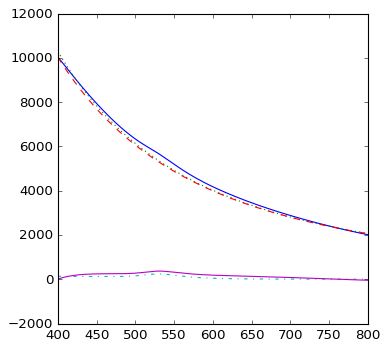

    530.56 ,	 [530.0, 369.57, 126.0, 1.52] 	 (-2.32, 5245.631)	 2.472 	 (-2.29, 5183.51) 	 0.357
	* Warning *: large scattering cross section:  [ 530.      372.5362  127.        1.5221]


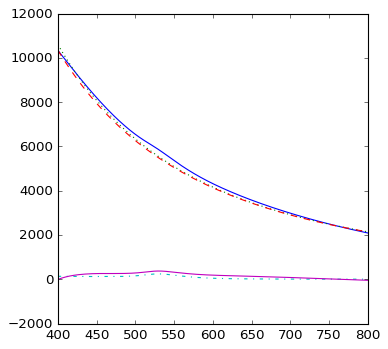

    530.22 ,	 [530.0, 372.54, 127.0, 1.52] 	 (-2.31, 5423.290)	 2.492 	 (-2.28, 5360.65) 	 0.360
	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 140.0 1.5221058963738434]


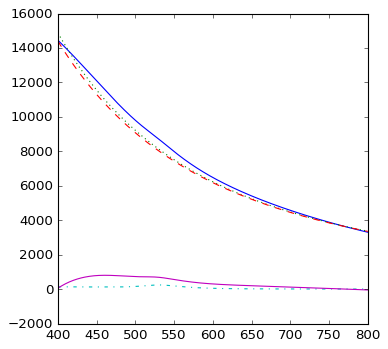

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 1322.5122]) 150.0 1.5221058963738434]


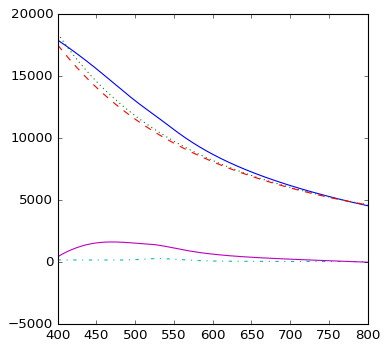

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 2638.9212]) 164.0 1.5221058963738434]


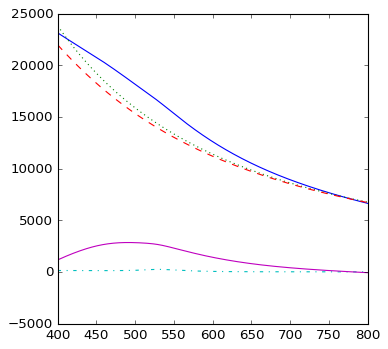

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 2740.1981]) 165.0 1.5221058963738434]


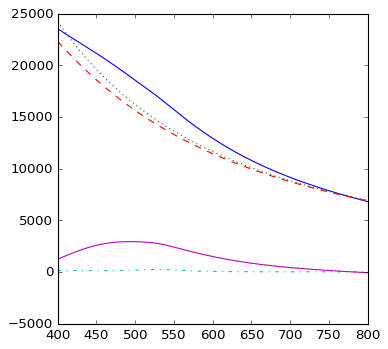

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5221058963738434]


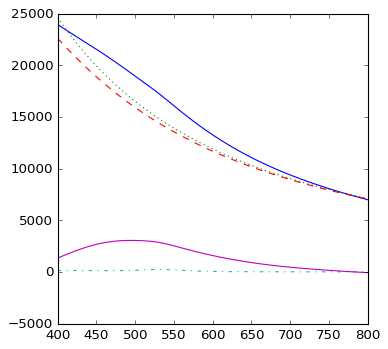

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 170.0 1.5221058963738434]


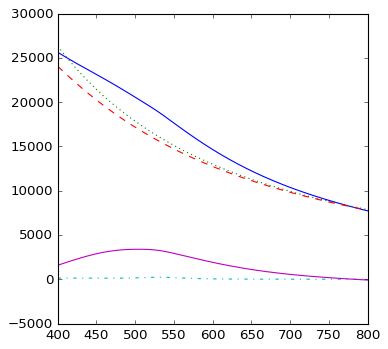

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 4130.8953]) 180.0 1.5221058963738434]


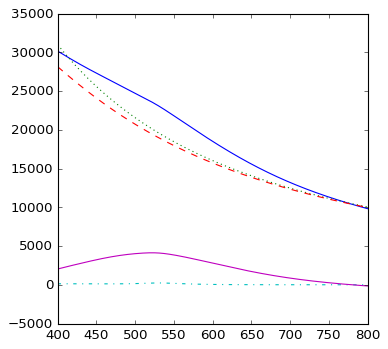

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 542.]) array([ 5018.5546]) 200.0 1.5221058963738434]


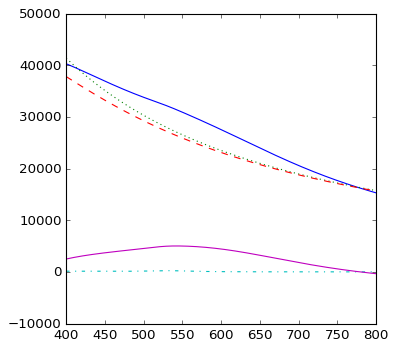

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5081.0008]) 210.0 1.5221058963738434]


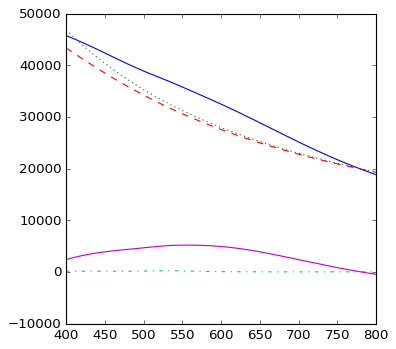

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5096.4966]) 217.0 1.5221058963738434]


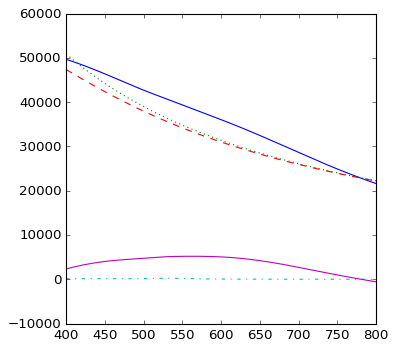

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5098.7896]) 218.0 1.5221058963738434]


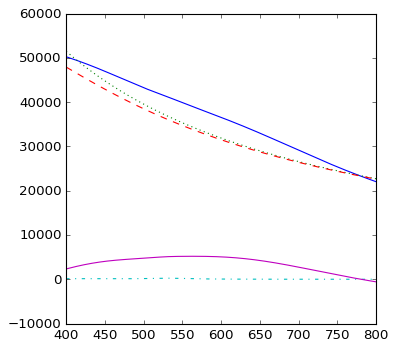

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5101.3734]) 219.0 1.5221058963738434]


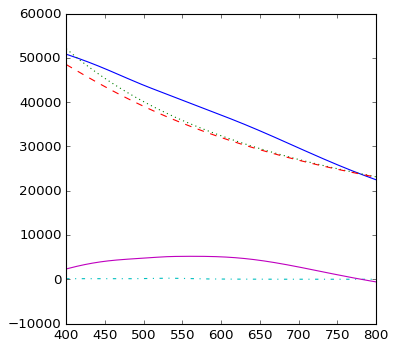

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 533.]) array([ 5221.7161]) 230.0 1.5221058963738434]


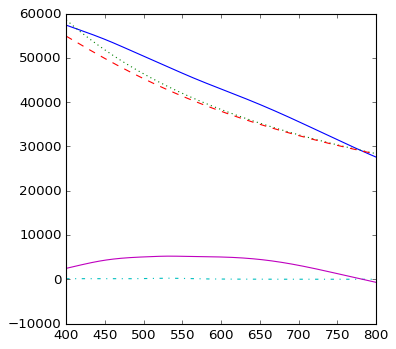

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 5319.681]) 260.0 1.5221058963738434]


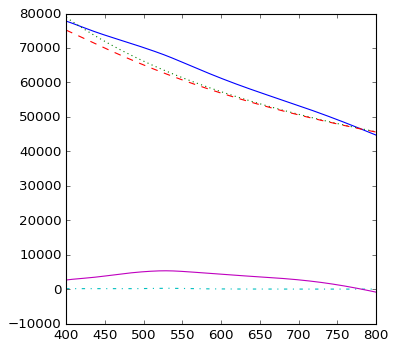

    530.25 ,	 [530.0, 250.99, 11.0, 1.53] 	 (-5.15, 32.899)	 1.679 	 (0.00, 1.00) 	 1.158
    530.25 ,	 [530.0, 250.99, 14.0, 1.53] 	 (-5.15, 32.928)	 1.679 	 (0.00, 1.00) 	 1.158
    530.25 ,	 [530.0, 250.98, 15.0, 1.53] 	 (-5.15, 32.947)	 1.679 	 (0.00, 1.00) 	 1.157
    530.25 ,	 [530.0, 250.98, 16.0, 1.53] 	 (-5.15, 32.974)	 1.679 	 (0.00, 1.00) 	 1.157
    530.25 ,	 [530.0, 250.98, 17.0, 1.53] 	 (-5.15, 33.011)	 1.679 	 (0.00, 1.00) 	 1.156
    530.25 ,	 [530.0, 250.97, 20.0, 1.53] 	 (-5.14, 33.207)	 1.679 	 (0.00, 1.00) 	 1.152
    530.25 ,	 [530.0, 250.96, 21.0, 1.53] 	 (-5.14, 33.313)	 1.679 	 (0.00, 1.00) 	 1.150
    530.25 ,	 [530.0, 250.95, 22.0, 1.53] 	 (-5.13, 33.448)	 1.679 	 (0.00, 1.00) 	 1.147
    530.25 ,	 [530.0, 250.94, 23.0, 1.53] 	 (-5.13, 33.616)	 1.679 	 (0.00, 1.00) 	 1.144
    530.25 ,	 [530.0, 250.92, 24.0, 1.53] 	 (-5.12, 33.823)	 1.679 	 (0.00, 1.00) 	 1.140
    530.25 ,	 [530.0, 250.88, 26.0, 1.53] 	 (-5.10, 34.387)	 1.678 	 (0.00, 1.00) 	 1.129
    530.26

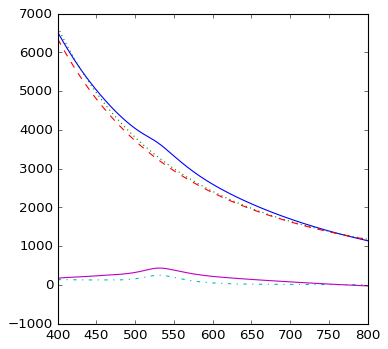

    531.38 ,	 [531.0, 432.22, 110.0, 1.53] 	 (-2.50, 3211.640)	 2.896 	 (-2.45, 3140.06) 	 0.355
	* Warning *: large scattering cross section:  [ 532.      388.2922  120.        1.5321]


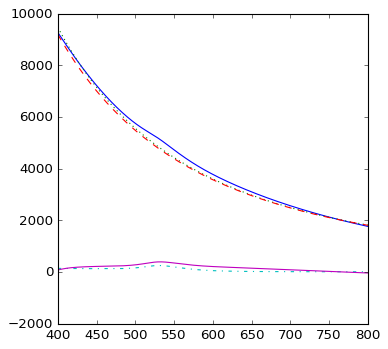

    532.26 ,	 [532.0, 388.29, 120.0, 1.53] 	 (-2.39, 4729.253)	 2.606 	 (-2.35, 4664.25) 	 0.351
	* Warning *: large scattering cross section:  [ 531.      383.6814  125.        1.5321]


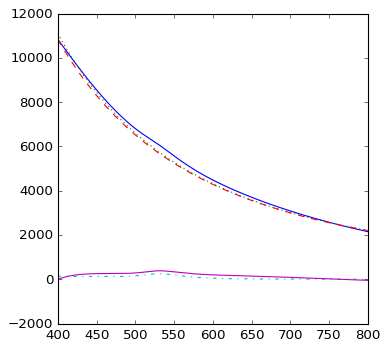

    531.3 ,	 [531.0, 383.68, 125.0, 1.53] 	 (-2.33, 5636.504)	 2.571 	 (-2.30, 5572.04) 	 0.355
	* Warning *: large scattering cross section:  [ 531.      386.5542  126.        1.5321]


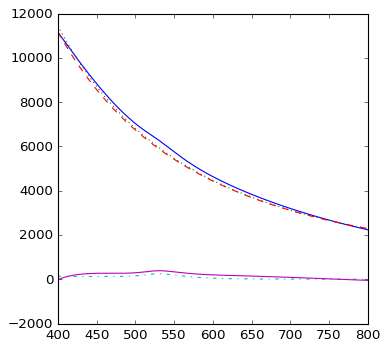

    530.94 ,	 [531.0, 386.55, 126.0, 1.53] 	 (-2.32, 5829.751)	 2.590 	 (-2.29, 5764.77) 	 0.356
	* Warning *: large scattering cross section:  [ 530.      391.1798  127.        1.5321]


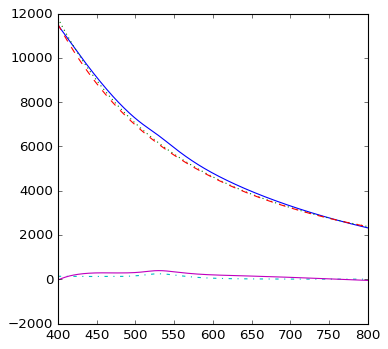

    530.47 ,	 [530.0, 391.18, 127.0, 1.53] 	 (-2.31, 6026.820)	 2.617 	 (-2.28, 5961.02) 	 0.359
	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 140.0 1.5321058963738434]


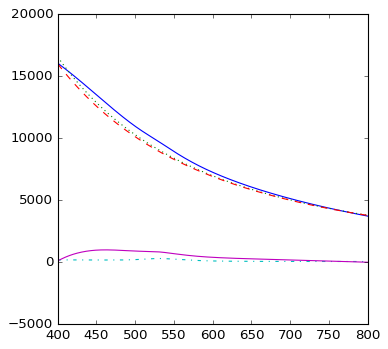

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 1534.646]) 150.0 1.5321058963738434]


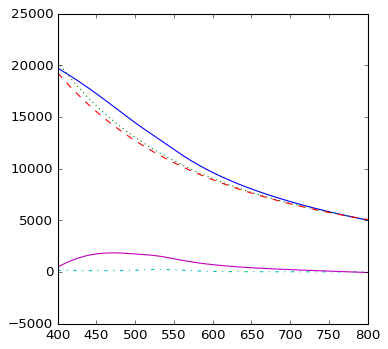

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 3054.8242]) 164.0 1.5321058963738434]


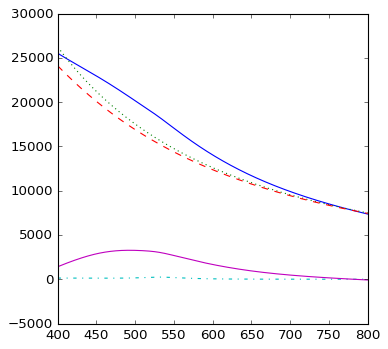

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 3167.5469]) 165.0 1.5321058963738434]


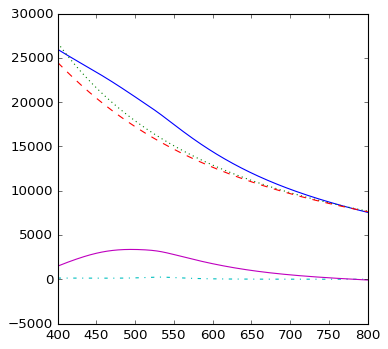

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5321058963738434]


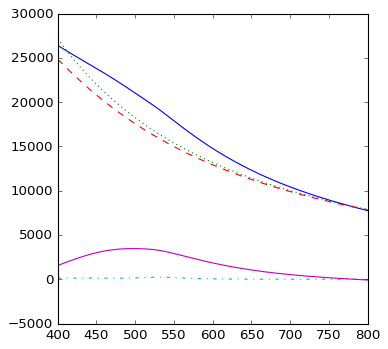

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 3720.6417]) 170.0 1.5321058963738434]


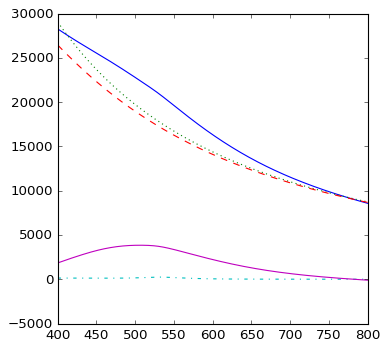

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 4623.7719]) 180.0 1.5321058963738434]


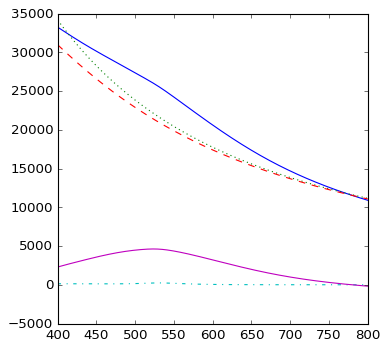

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 5587.4334]) 200.0 1.5321058963738434]


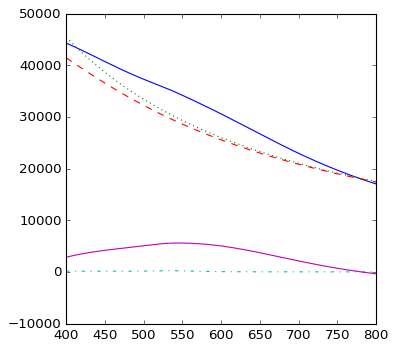

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5566.8734]) 210.0 1.5321058963738434]


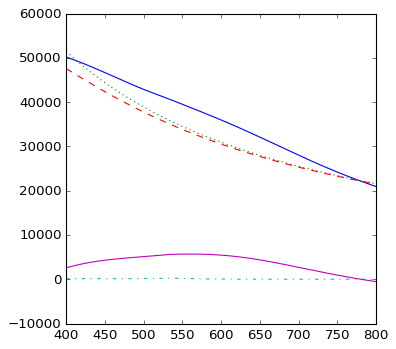

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5652.6078]) 217.0 1.5321058963738434]


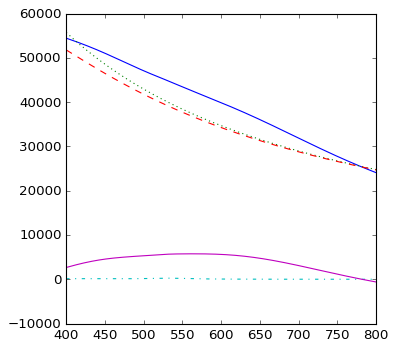

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5657.736]) 218.0 1.5321058963738434]


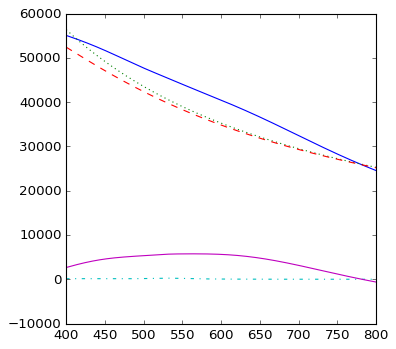

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5663.3088]) 219.0 1.5321058963738434]


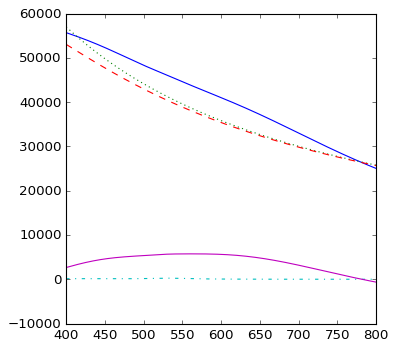

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5759.1692]) 230.0 1.5321058963738434]


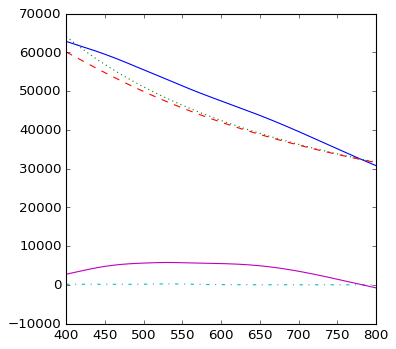

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 5906.6134]) 260.0 1.5321058963738434]


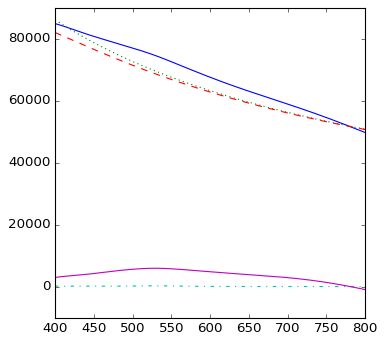

    530.87 ,	 [531.0, 256.44, 11.0, 1.54] 	 (-5.13, 33.456)	 1.718 	 (0.00, 1.00) 	 1.171
    530.87 ,	 [531.0, 256.44, 14.0, 1.54] 	 (-5.13, 33.488)	 1.718 	 (0.00, 1.00) 	 1.171
    530.87 ,	 [531.0, 256.44, 15.0, 1.54] 	 (-5.13, 33.509)	 1.718 	 (0.00, 1.00) 	 1.170
    530.87 ,	 [531.0, 256.44, 16.0, 1.54] 	 (-5.13, 33.538)	 1.718 	 (0.00, 1.00) 	 1.170
    530.87 ,	 [531.0, 256.43, 17.0, 1.54] 	 (-5.12, 33.578)	 1.718 	 (0.00, 1.00) 	 1.169
    530.87 ,	 [531.0, 256.42, 20.0, 1.54] 	 (-5.12, 33.794)	 1.718 	 (0.00, 1.00) 	 1.164
    530.87 ,	 [531.0, 256.41, 21.0, 1.54] 	 (-5.11, 33.910)	 1.718 	 (0.00, 1.00) 	 1.162
    530.87 ,	 [531.0, 256.4, 22.0, 1.54] 	 (-5.11, 34.058)	 1.718 	 (0.00, 1.00) 	 1.159
    530.87 ,	 [531.0, 256.39, 23.0, 1.54] 	 (-5.10, 34.242)	 1.718 	 (0.00, 1.00) 	 1.155
    530.87 ,	 [531.0, 256.37, 24.0, 1.54] 	 (-5.09, 34.470)	 1.718 	 (0.00, 1.00) 	 1.151
    530.87 ,	 [531.0, 256.33, 26.0, 1.54] 	 (-5.07, 35.089)	 1.718 	 (0.00, 1.00) 	 1.139
    530.88 

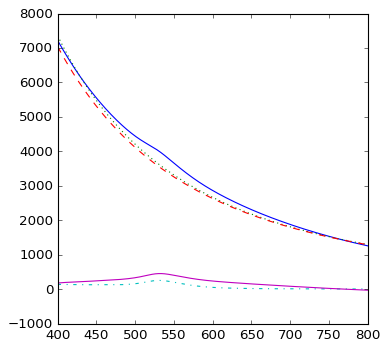

    532.18 ,	 [532.0, 451.32, 110.0, 1.54] 	 (-2.51, 3549.295)	 3.029 	 (-2.46, 3474.50) 	 0.351
	* Warning *: large scattering cross section:  [ 533.      386.7155  120.        1.5421]


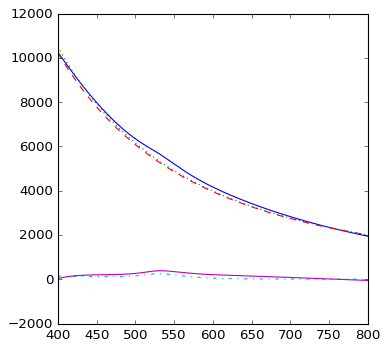

    533.15 ,	 [533.0, 386.72, 120.0, 1.54] 	 (-2.39, 5242.650)	 2.599 	 (-2.36, 5177.85) 	 0.348
	* Warning *: large scattering cross section:  [ 532.      400.1668  125.        1.5421]


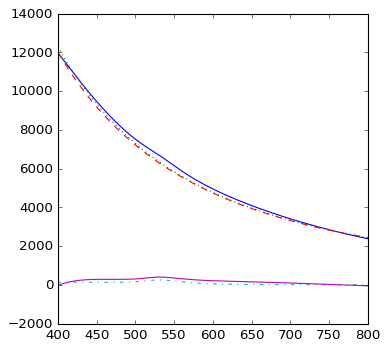

    531.69 ,	 [532.0, 400.17, 125.0, 1.54] 	 (-2.34, 6233.026)	 2.686 	 (-2.31, 6165.77) 	 0.353
	* Warning *: large scattering cross section:  [ 531.      404.8814  126.        1.5421]


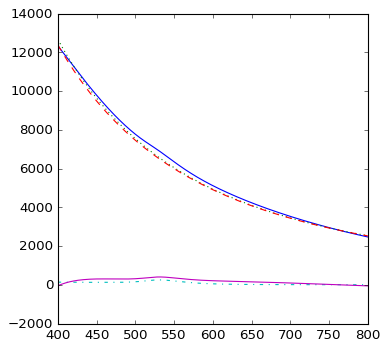

    531.19 ,	 [531.0, 404.88, 126.0, 1.54] 	 (-2.32, 6446.282)	 2.713 	 (-2.30, 6378.21) 	 0.355
	* Warning *: large scattering cross section:  [ 531.      411.7993  127.        1.5421]


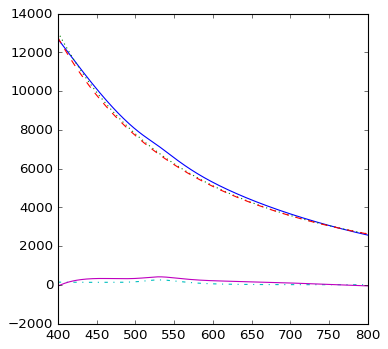

    530.63 ,	 [531.0, 411.8, 127.0, 1.54] 	 (-2.31, 6663.641)	 2.759 	 (-2.29, 6594.38) 	 0.357
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 903.424]) 140.0 1.5421058963738434]


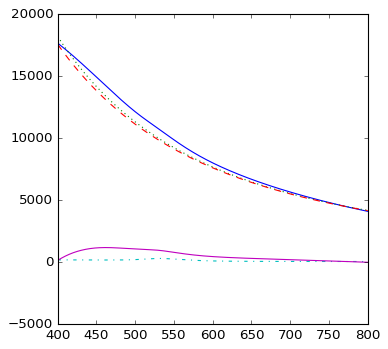

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 1761.7229]) 150.0 1.5421058963738434]


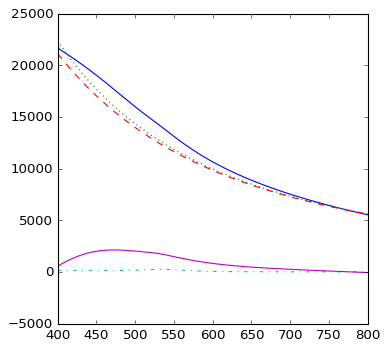

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 3468.6052]) 164.0 1.5421058963738434]


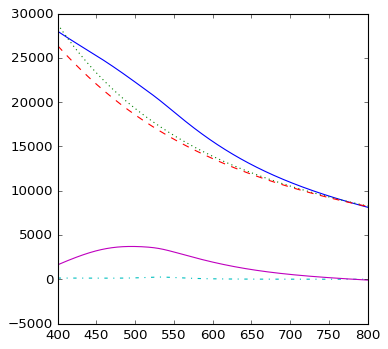

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5421058963738434]


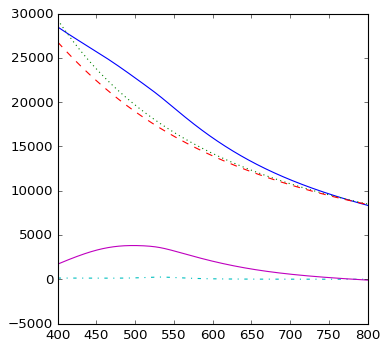

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5421058963738434]


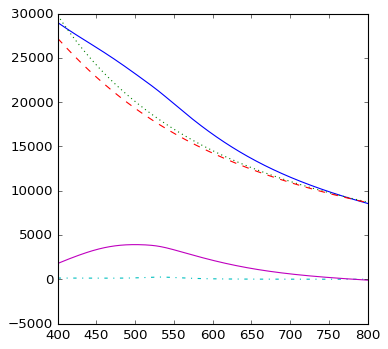

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 4193.0331]) 170.0 1.5421058963738434]


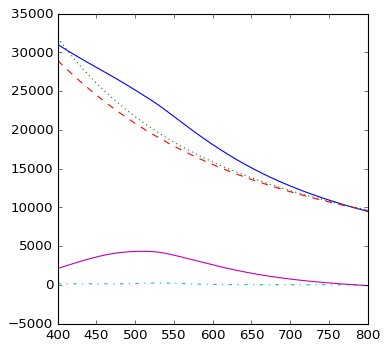

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 5143.3075]) 180.0 1.5421058963738434]


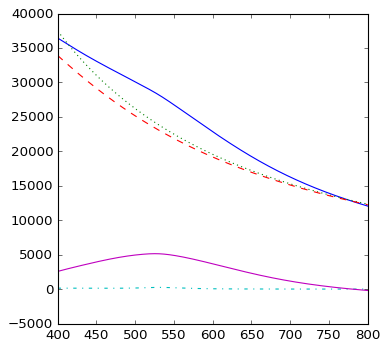

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 548.]) array([ 6134.1368]) 200.0 1.5421058963738434]


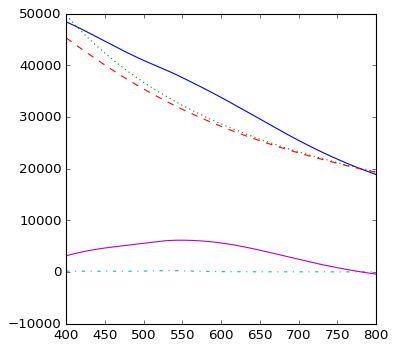

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 6149.1252]) 210.0 1.5421058963738434]


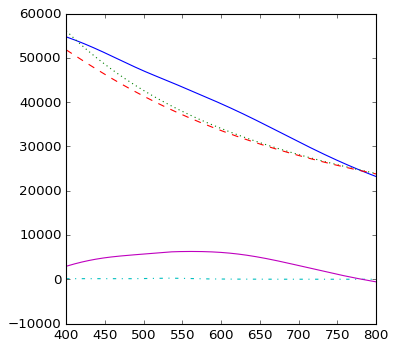

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 6189.0397]) 217.0 1.5421058963738434]


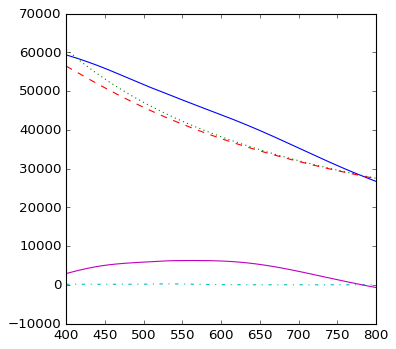

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 6196.4088]) 218.0 1.5421058963738434]


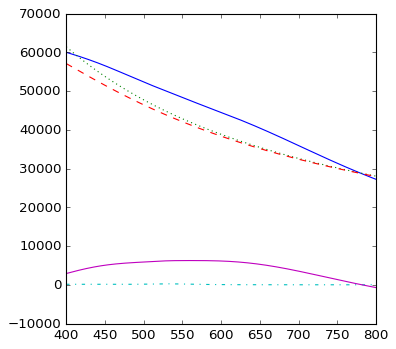

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 6204.3777]) 219.0 1.5421058963738434]


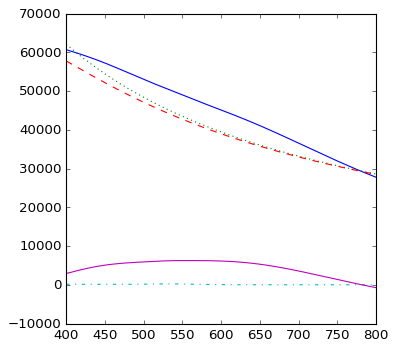

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 6334.1627]) 230.0 1.5421058963738434]


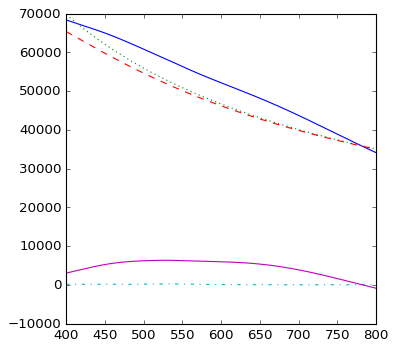

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 6536.7732]) 260.0 1.5421058963738434]


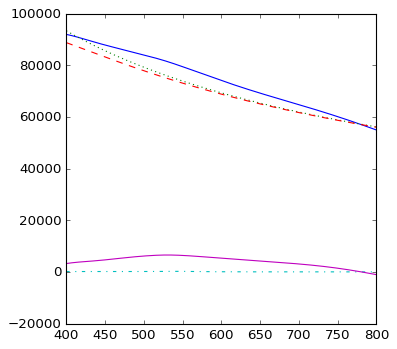

    531.48 ,	 [531.0, 261.94, 11.0, 1.55] 	 (-5.10, 34.024)	 1.755 	 (0.00, 1.00) 	 1.184
    531.48 ,	 [531.0, 261.94, 14.0, 1.55] 	 (-5.10, 34.058)	 1.755 	 (0.00, 1.00) 	 1.183
    531.48 ,	 [531.0, 261.94, 15.0, 1.55] 	 (-5.10, 34.081)	 1.755 	 (0.00, 1.00) 	 1.183
    531.48 ,	 [531.0, 261.93, 16.0, 1.55] 	 (-5.10, 34.113)	 1.755 	 (0.00, 1.00) 	 1.182
    531.48 ,	 [531.0, 261.93, 17.0, 1.55] 	 (-5.10, 34.157)	 1.755 	 (0.00, 1.00) 	 1.181
    531.48 ,	 [531.0, 261.91, 20.0, 1.55] 	 (-5.09, 34.392)	 1.755 	 (0.00, 1.00) 	 1.176
    531.48 ,	 [531.0, 261.91, 21.0, 1.55] 	 (-5.09, 34.520)	 1.755 	 (0.00, 1.00) 	 1.173
    531.48 ,	 [531.0, 261.9, 22.0, 1.55] 	 (-5.08, 34.681)	 1.755 	 (0.00, 1.00) 	 1.170
    531.48 ,	 [531.0, 261.88, 23.0, 1.55] 	 (-5.08, 34.882)	 1.755 	 (0.00, 1.00) 	 1.166
    531.49 ,	 [531.0, 261.87, 24.0, 1.55] 	 (-5.07, 35.132)	 1.754 	 (0.00, 1.00) 	 1.161
    531.49 ,	 [531.0, 261.82, 26.0, 1.55] 	 (-5.05, 35.808)	 1.754 	 (0.00, 1.00) 	 1.148
    531.49 

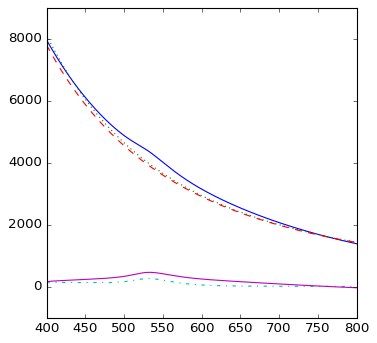

    533.11 ,	 [533.0, 458.78, 110.0, 1.55] 	 (-2.51, 3914.813)	 3.083 	 (-2.46, 3838.70) 	 0.347
	* Warning *: large scattering cross section:  [ 534.      398.1676  120.        1.5521]


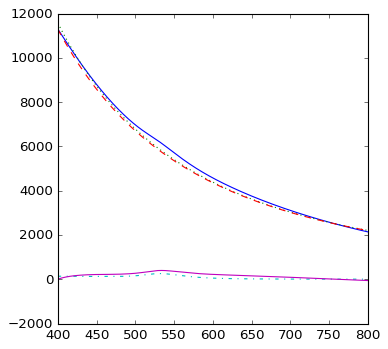

    533.87 ,	 [534.0, 398.17, 120.0, 1.55] 	 (-2.39, 5771.926)	 2.680 	 (-2.36, 5705.16) 	 0.345
	* Warning *: large scattering cross section:  [ 532.      418.209   125.        1.5521]


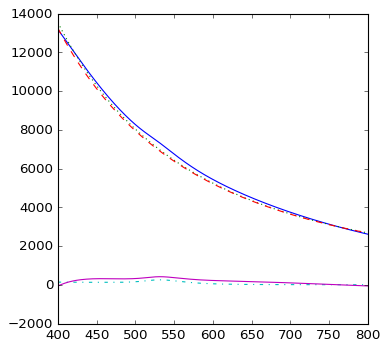

    531.95 ,	 [532.0, 418.21, 125.0, 1.55] 	 (-2.34, 6861.078)	 2.807 	 (-2.31, 6790.79) 	 0.352
	* Warning *: large scattering cross section:  [ 531.      425.2901  126.        1.5521]


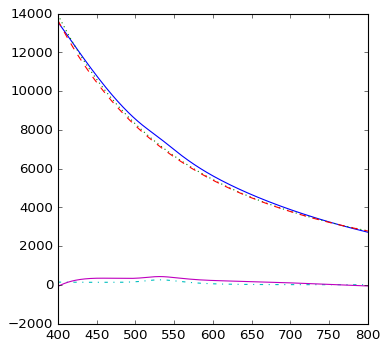

    531.33 ,	 [531.0, 425.29, 126.0, 1.55] 	 (-2.33, 7095.186)	 2.849 	 (-2.30, 7023.67) 	 0.355
	* Warning *: large scattering cross section:  [ 530.      452.6851  127.        1.5521]


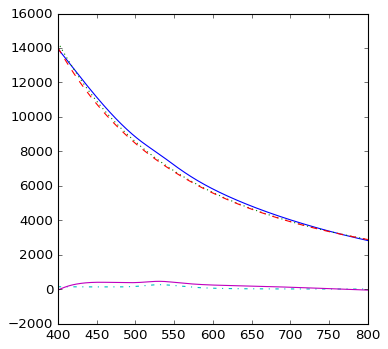

    530.34 ,	 [530.0, 452.69, 127.0, 1.55] 	 (-2.31, 7319.071)	 3.028 	 (-2.29, 7242.95) 	 0.358
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 1040.6468]) 140.0 1.5521058963738434]


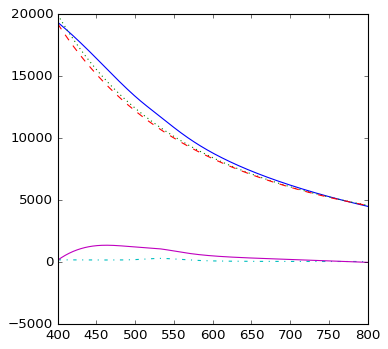

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 2069.7777]) 150.0 1.5521058963738434]


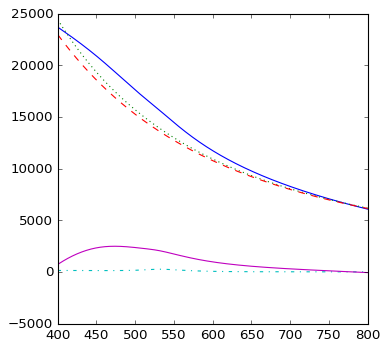

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5521058963738434]


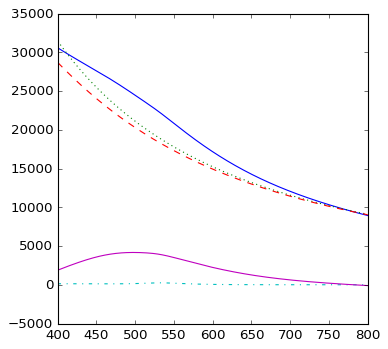

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5521058963738434]


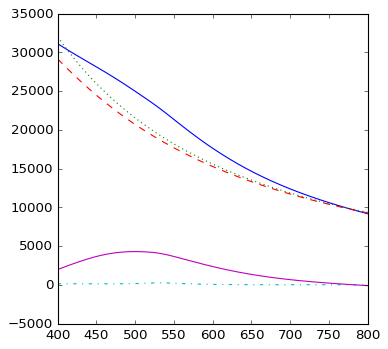

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5521058963738434]


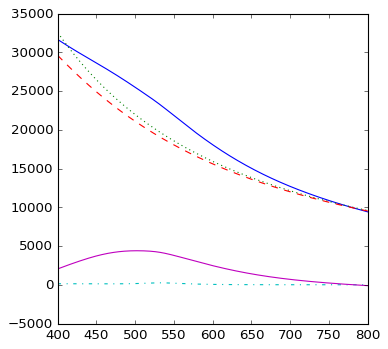

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 4724.4516]) 170.0 1.5521058963738434]


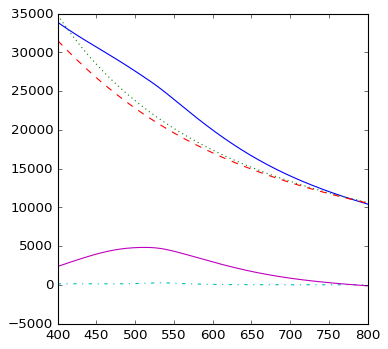

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 527.]) array([ 5733.023]) 180.0 1.5521058963738434]


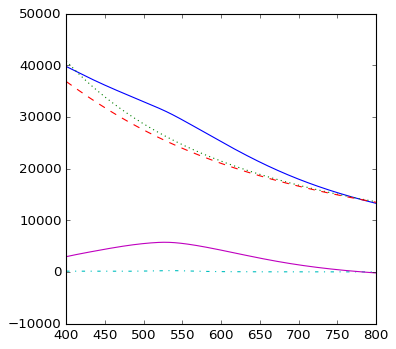

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 551.]) array([ 6700.9859]) 200.0 1.5521058963738434]


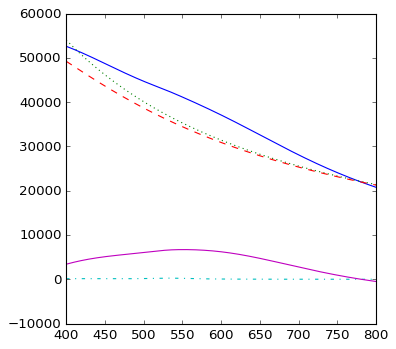

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 6668.0692]) 210.0 1.5521058963738434]


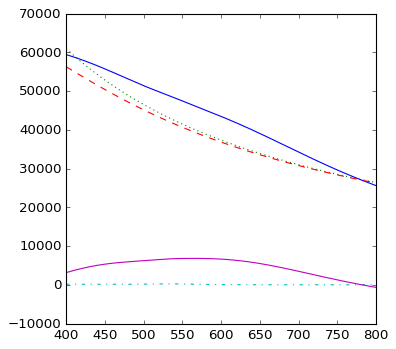

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 6732.0893]) 217.0 1.5521058963738434]


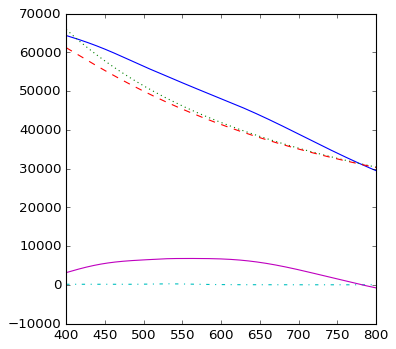

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 548.]) array([ 6827.4456]) 218.0 1.5521058963738434]


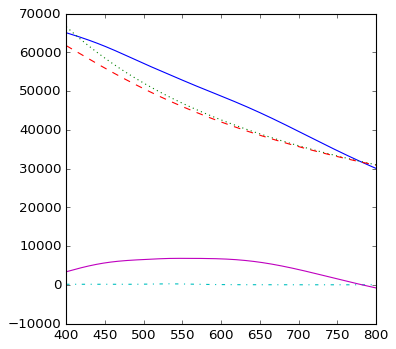

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 544.]) array([ 6817.7472]) 219.0 1.5521058963738434]


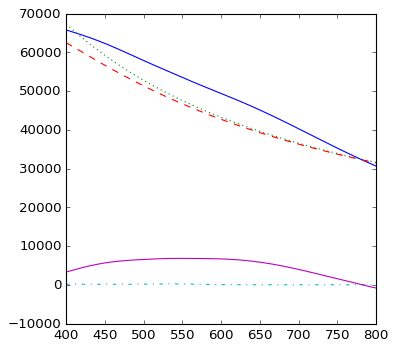

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 525.]) array([ 7007.6712]) 230.0 1.5521058963738434]


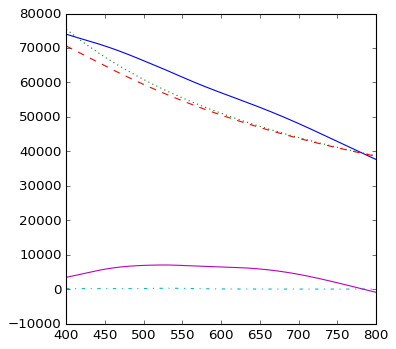

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 7215.3102]) 260.0 1.5521058963738434]


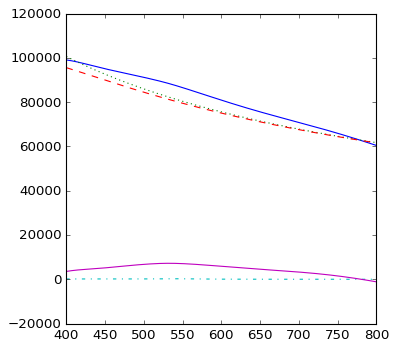

    532.79 ,	 [533.0, 267.65, 11.0, 1.56] 	 (-5.06, 34.460)	 1.799 	 (0.00, 1.00) 	 1.210
    532.79 ,	 [533.0, 267.65, 14.0, 1.56] 	 (-5.05, 34.498)	 1.799 	 (0.00, 1.00) 	 1.209
    532.79 ,	 [533.0, 267.65, 15.0, 1.56] 	 (-5.05, 34.523)	 1.799 	 (0.00, 1.00) 	 1.209
    532.79 ,	 [533.0, 267.64, 16.0, 1.56] 	 (-5.05, 34.558)	 1.799 	 (0.00, 1.00) 	 1.208
    532.79 ,	 [533.0, 267.64, 17.0, 1.56] 	 (-5.05, 34.605)	 1.799 	 (0.00, 1.00) 	 1.207
    532.79 ,	 [533.0, 267.62, 20.0, 1.56] 	 (-5.04, 34.860)	 1.799 	 (0.00, 1.00) 	 1.202
    532.79 ,	 [533.0, 267.62, 21.0, 1.56] 	 (-5.04, 34.999)	 1.799 	 (0.00, 1.00) 	 1.199
    532.79 ,	 [533.0, 267.61, 22.0, 1.56] 	 (-5.03, 35.174)	 1.799 	 (0.00, 1.00) 	 1.195
    532.79 ,	 [533.0, 267.59, 23.0, 1.56] 	 (-5.03, 35.393)	 1.799 	 (0.00, 1.00) 	 1.190
    532.79 ,	 [533.0, 267.58, 24.0, 1.56] 	 (-5.02, 35.663)	 1.799 	 (0.00, 1.00) 	 1.185
    532.79 ,	 [533.0, 267.54, 26.0, 1.56] 	 (-5.00, 36.398)	 1.798 	 (0.00, 1.00) 	 1.170
    532.79

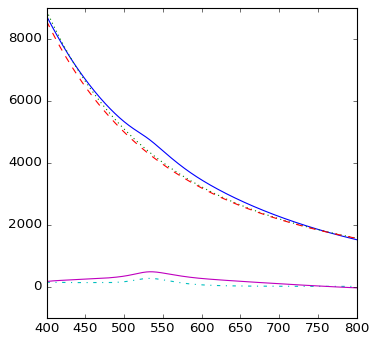

    534.57 ,	 [534.0, 477.03, 110.0, 1.56] 	 (-2.51, 4289.689)	 3.210 	 (-2.47, 4210.40) 	 0.342
	* Warning *: large scattering cross section:  [ 535.      410.5182  120.        1.5621]


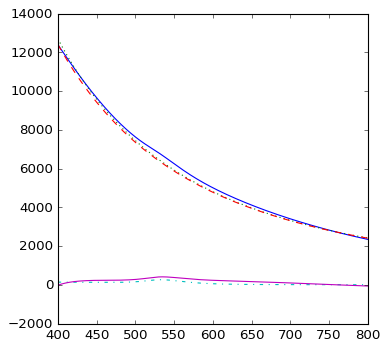

    535.2 ,	 [535.0, 410.52, 120.0, 1.56] 	 (-2.40, 6328.160)	 2.767 	 (-2.37, 6259.23) 	 0.342
	* Warning *: large scattering cross section:  [ 533.      438.7034  125.        1.5621]


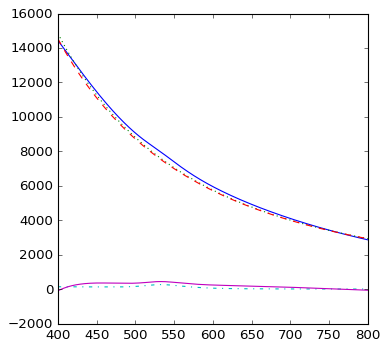

    532.78 ,	 [533.0, 438.7, 125.0, 1.56] 	 (-2.34, 7520.173)	 2.949 	 (-2.32, 7446.35) 	 0.350
	* Warning *: large scattering cross section:  [ 532.      467.1143  126.        1.5621]


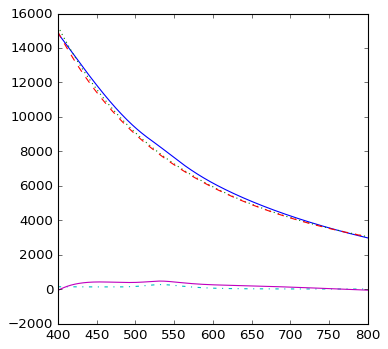

    531.72 ,	 [532.0, 467.11, 126.0, 1.56] 	 (-2.33, 7760.451)	 3.135 	 (-2.30, 7681.86) 	 0.353
	* Warning *: large scattering cross section:  [ 531.      481.6364  127.        1.5621]


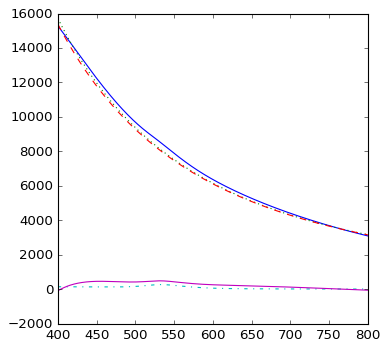

    530.79 ,	 [531.0, 481.64, 127.0, 1.56] 	 (-2.32, 8020.041)	 3.227 	 (-2.29, 7939.00) 	 0.356
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 1202.2583]) 140.0 1.5621058963738434]


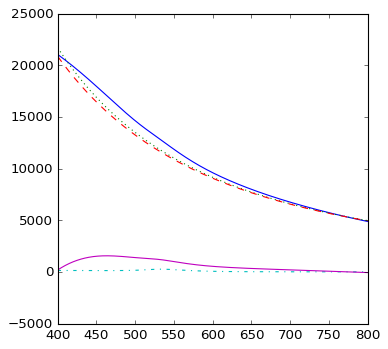

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 2359.7638]) 150.0 1.5621058963738434]


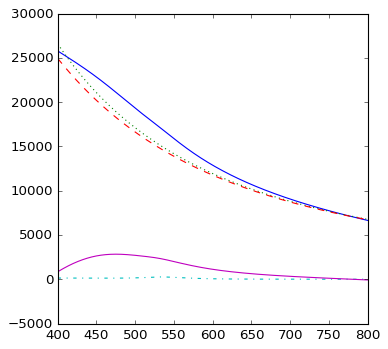

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5621058963738434]


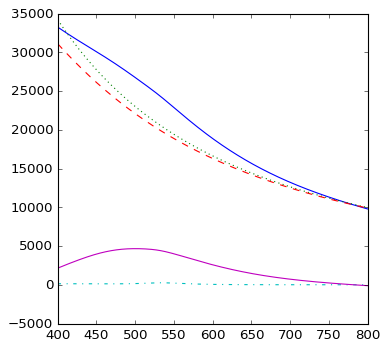

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 165.0 1.5621058963738434]


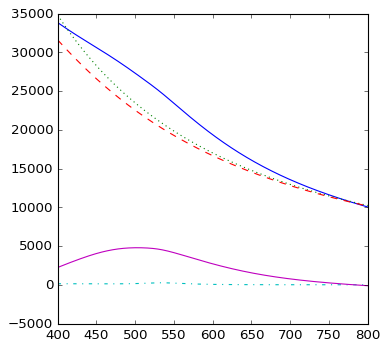

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 166.0 1.5621058963738434]


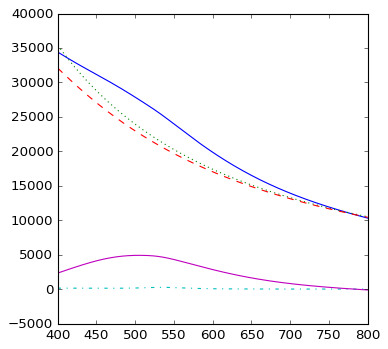

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 5261.8178]) 170.0 1.5621058963738434]


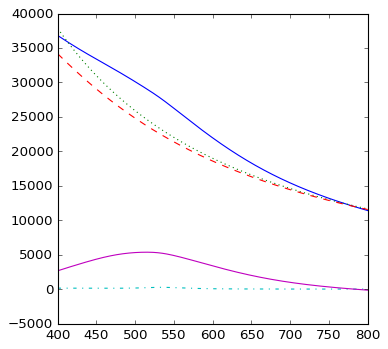

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 6307.3487]) 180.0 1.5621058963738434]


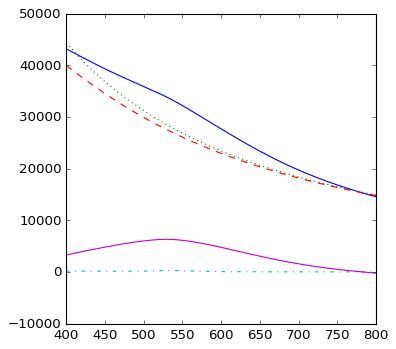

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 7144.392]) 200.0 1.5621058963738434]


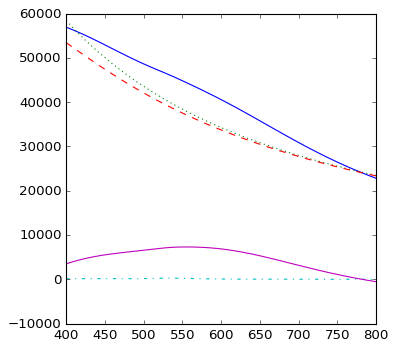

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 531.]) array([ 7237.7027]) 210.0 1.5621058963738434]


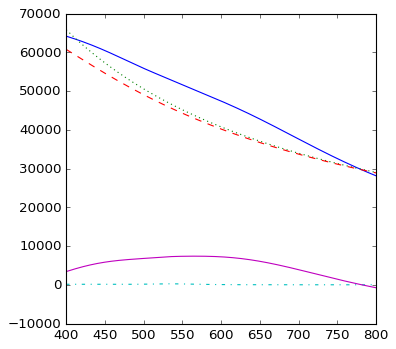

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 545.]) array([ 7457.5009]) 217.0 1.5621058963738434]


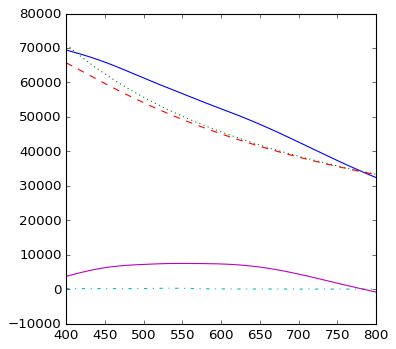

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 541.]) array([ 7455.9564]) 218.0 1.5621058963738434]


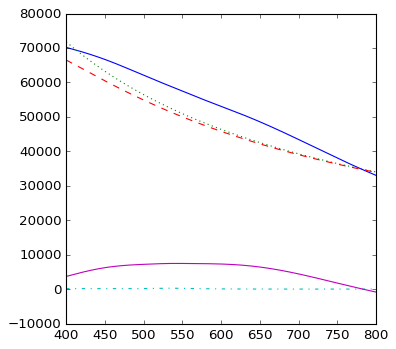

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 7459.0217]) 219.0 1.5621058963738434]


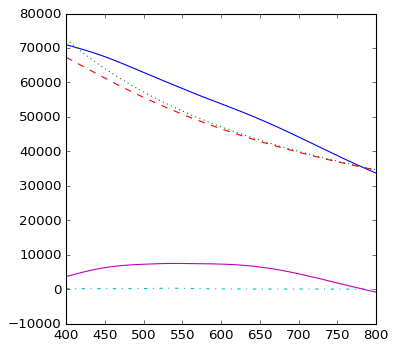

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 524.]) array([ 7655.1377]) 230.0 1.5621058963738434]


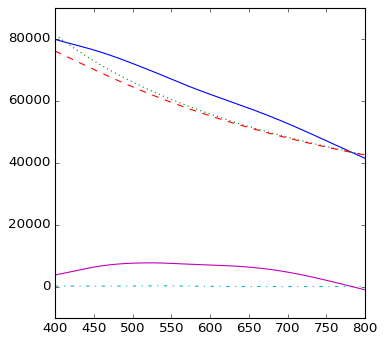

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 7949.6114]) 260.0 1.5621058963738434]


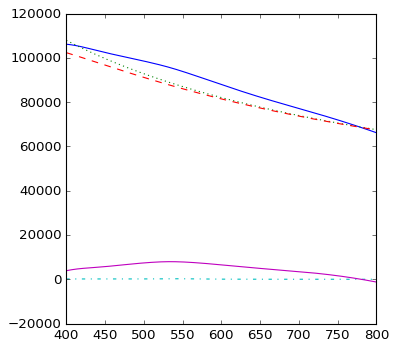

    533.44 ,	 [533.0, 273.31, 11.0, 1.57] 	 (-5.03, 34.957)	 1.837 	 (0.00, 1.00) 	 1.223
    533.44 ,	 [533.0, 273.31, 14.0, 1.57] 	 (-5.03, 34.997)	 1.837 	 (0.00, 1.00) 	 1.222
    533.44 ,	 [533.0, 273.3, 15.0, 1.57] 	 (-5.03, 35.024)	 1.837 	 (0.00, 1.00) 	 1.222
    533.44 ,	 [533.0, 273.3, 16.0, 1.57] 	 (-5.02, 35.062)	 1.837 	 (0.00, 1.00) 	 1.221
    533.44 ,	 [533.0, 273.3, 17.0, 1.57] 	 (-5.02, 35.113)	 1.837 	 (0.00, 1.00) 	 1.220
    533.44 ,	 [533.0, 273.19, 20.0, 1.57] 	 (-5.02, 35.468)	 1.836 	 (0.00, 1.00) 	 1.214
    533.44 ,	 [533.0, 273.18, 21.0, 1.57] 	 (-5.01, 35.618)	 1.836 	 (0.00, 1.00) 	 1.210
    533.44 ,	 [533.0, 273.17, 22.0, 1.57] 	 (-5.01, 35.808)	 1.836 	 (0.00, 1.00) 	 1.206
    533.44 ,	 [533.0, 273.15, 23.0, 1.57] 	 (-5.00, 36.045)	 1.836 	 (0.00, 1.00) 	 1.201
    533.44 ,	 [533.0, 273.14, 24.0, 1.57] 	 (-4.99, 36.338)	 1.836 	 (0.00, 1.00) 	 1.195
    533.44 ,	 [533.0, 273.1, 26.0, 1.57] 	 (-4.97, 37.135)	 1.835 	 (0.00, 1.00) 	 1.179
    533.45 ,	 

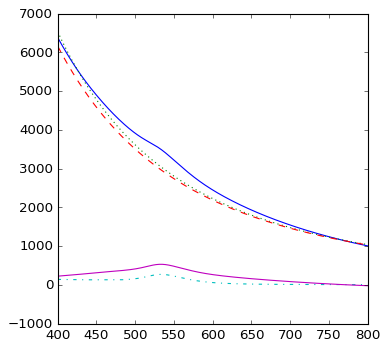

    533.08 ,	 [533.0, 529.5, 100.0, 1.57] 	 (-2.66, 3017.204)	 3.558 	 (-2.59, 2930.40) 	 0.348
	* Warning *: large scattering cross section:  [ 535.      493.5758  110.        1.5721]


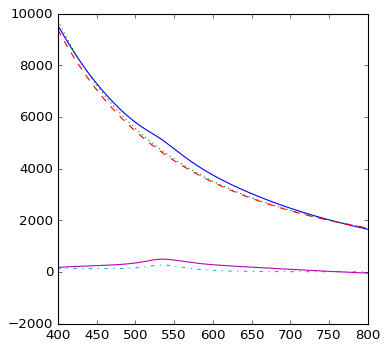

    535.47 ,	 [535.0, 493.58, 110.0, 1.57] 	 (-2.51, 4683.806)	 3.327 	 (-2.47, 4601.70) 	 0.340
	* Warning *: large scattering cross section:  [ 536.      421.5952  120.        1.5721]


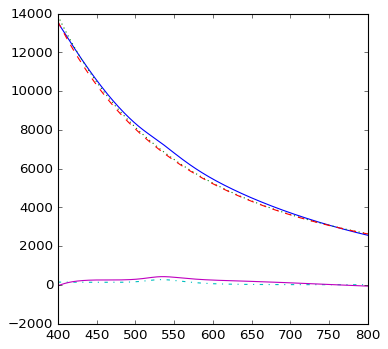

    535.88 ,	 [536.0, 421.6, 120.0, 1.57] 	 (-2.40, 6912.223)	 2.846 	 (-2.38, 6841.38) 	 0.340
	* Warning *: large scattering cross section:  [ 533.      480.698   125.        1.5721]


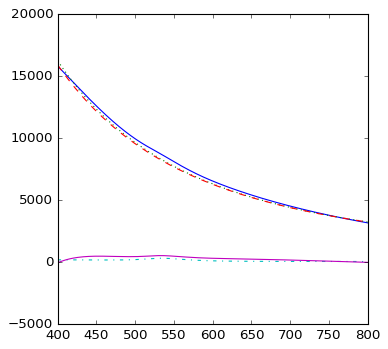

    532.5 ,	 [533.0, 480.7, 125.0, 1.57] 	 (-2.34, 8194.548)	 3.231 	 (-2.32, 8113.69) 	 0.351
	* Warning *: large scattering cross section:  [ 532.      495.7924  126.        1.5721]


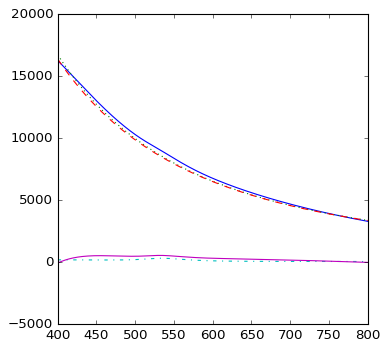

    531.5 ,	 [532.0, 495.79, 126.0, 1.57] 	 (-2.33, 8471.822)	 3.327 	 (-2.31, 8388.43) 	 0.354
	* Warning *: large scattering cross section:  [ 531.      515.1239  127.        1.5721]


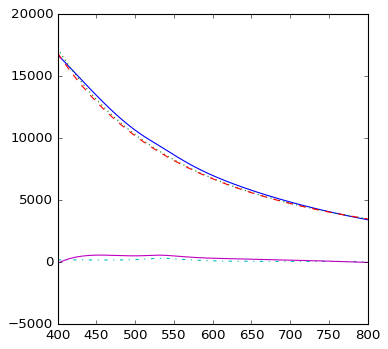

    530.33 ,	 [531.0, 515.12, 127.0, 1.57] 	 (-2.32, 8753.995)	 3.452 	 (-2.29, 8667.37) 	 0.357
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 1387.007]) 140.0 1.5721058963738435]


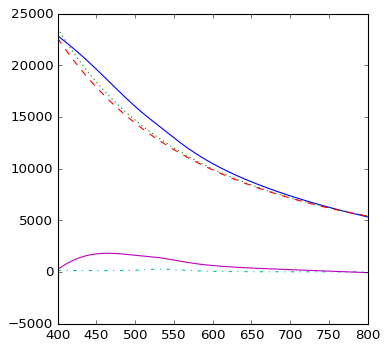

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 2720.1021]) 150.0 1.5721058963738435]


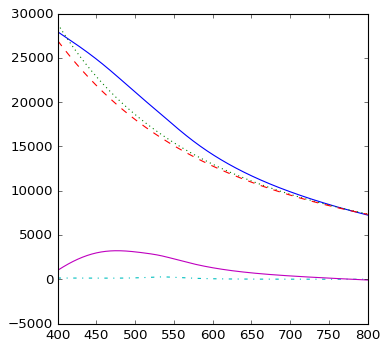

	* Error *: no peaks detected in range:  [array([], dtype=float64) array([], dtype=float64) 164.0 1.5721058963738435]


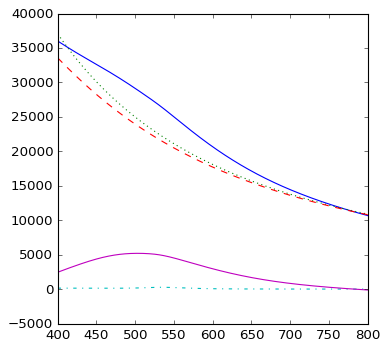

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5154.5367]) 165.0 1.5721058963738435]


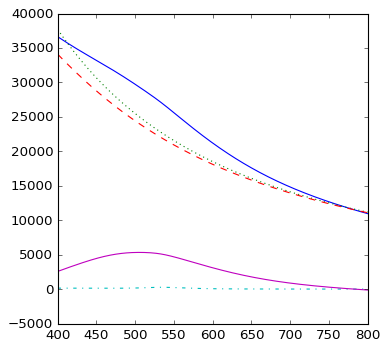

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 5301.9219]) 166.0 1.5721058963738435]


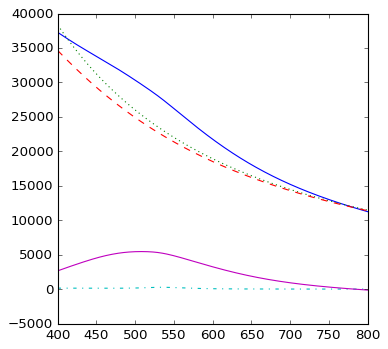

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 517.]) array([ 5907.8638]) 170.0 1.5721058963738435]


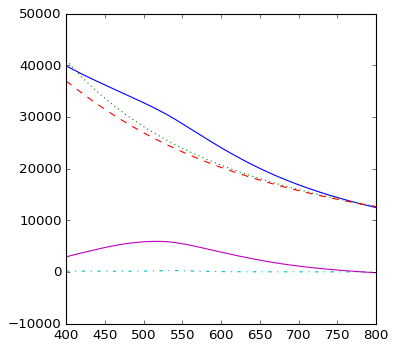

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 6906.2224]) 180.0 1.5721058963738435]


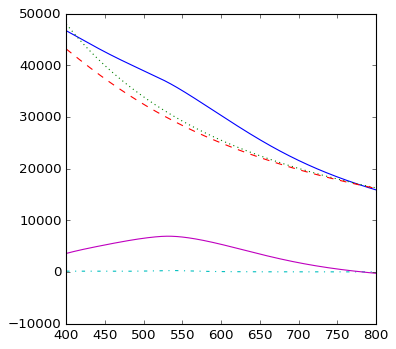

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 7684.1317]) 200.0 1.5721058963738435]


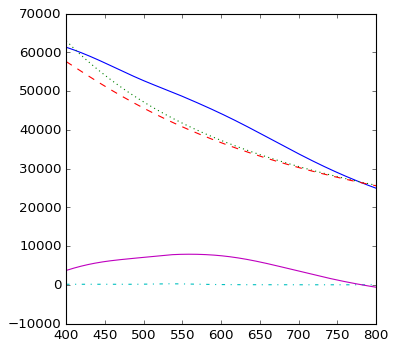

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 7879.702]) 210.0 1.5721058963738435]


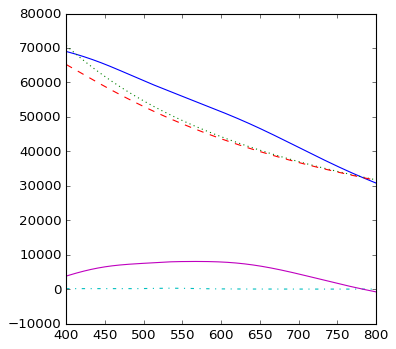

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 8045.1099]) 217.0 1.5721058963738435]


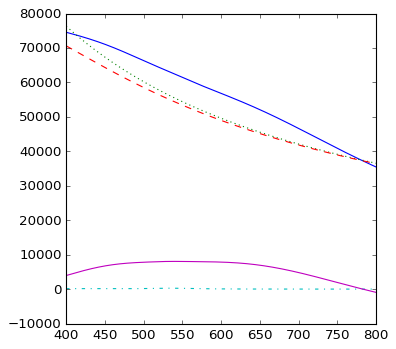

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 8055.1972]) 218.0 1.5721058963738435]


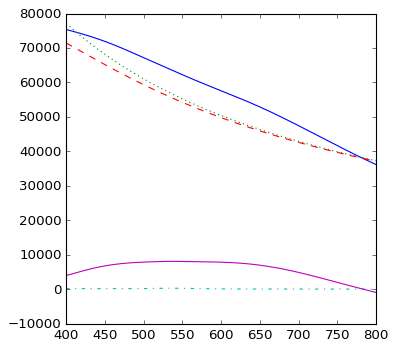

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 535.]) array([ 8057.501]) 219.0 1.5721058963738435]


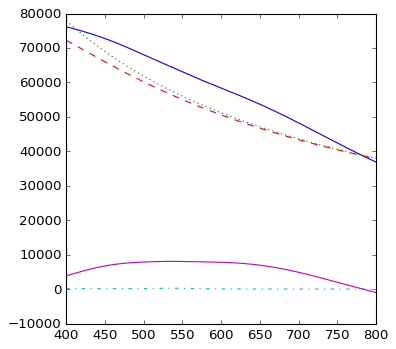

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 8340.919]) 230.0 1.5721058963738435]


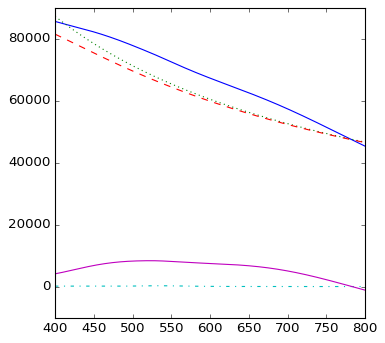

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 8742.86]) 260.0 1.5721058963738435]


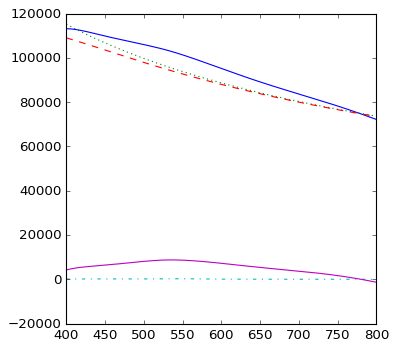

    534.13 ,	 [534.0, 278.86, 11.0, 1.58] 	 (-5.00, 35.522)	 1.877 	 (0.00, 1.00) 	 1.237
    534.13 ,	 [534.0, 278.86, 14.0, 1.58] 	 (-5.00, 35.565)	 1.877 	 (0.00, 1.00) 	 1.236
    534.13 ,	 [534.0, 278.86, 15.0, 1.58] 	 (-5.00, 35.595)	 1.877 	 (0.00, 1.00) 	 1.235
    534.13 ,	 [534.0, 278.85, 16.0, 1.58] 	 (-5.00, 35.635)	 1.877 	 (0.00, 1.00) 	 1.234
    534.13 ,	 [534.0, 278.85, 17.0, 1.58] 	 (-5.00, 35.691)	 1.877 	 (0.00, 1.00) 	 1.233
    534.13 ,	 [534.0, 278.74, 20.0, 1.58] 	 (-4.99, 36.069)	 1.876 	 (0.00, 1.00) 	 1.226
    534.13 ,	 [534.0, 278.73, 21.0, 1.58] 	 (-4.99, 36.232)	 1.876 	 (0.00, 1.00) 	 1.223
    534.13 ,	 [534.0, 278.72, 22.0, 1.58] 	 (-4.98, 36.436)	 1.876 	 (0.00, 1.00) 	 1.218
    534.13 ,	 [534.0, 278.71, 23.0, 1.58] 	 (-4.98, 36.692)	 1.876 	 (0.00, 1.00) 	 1.213
    534.13 ,	 [534.0, 278.69, 24.0, 1.58] 	 (-4.97, 37.009)	 1.876 	 (0.00, 1.00) 	 1.206
    534.13 ,	 [534.0, 278.65, 26.0, 1.58] 	 (-4.94, 37.869)	 1.876 	 (0.00, 1.00) 	 1.189
    534.14

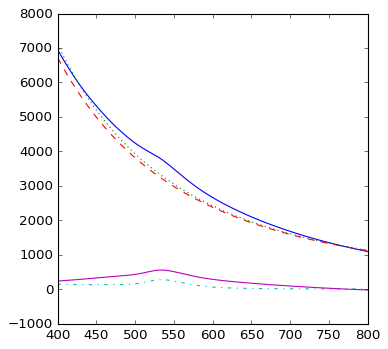

    533.82 ,	 [534.0, 553.91, 100.0, 1.58] 	 (-2.66, 3279.286)	 3.728 	 (-2.59, 3188.41) 	 0.345
	* Warning *: large scattering cross section:  [ 536.      509.1258  110.        1.5821]


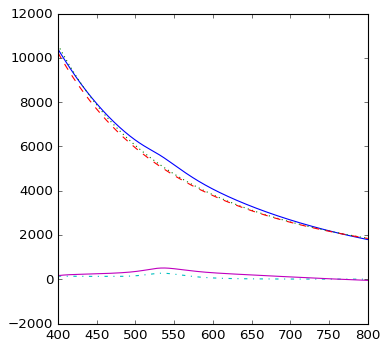

    536.41 ,	 [536.0, 509.13, 110.0, 1.58] 	 (-2.52, 5096.924)	 3.437 	 (-2.48, 5012.16) 	 0.336
	* Warning *: large scattering cross section:  [ 536.      432.8381  120.        1.5821]


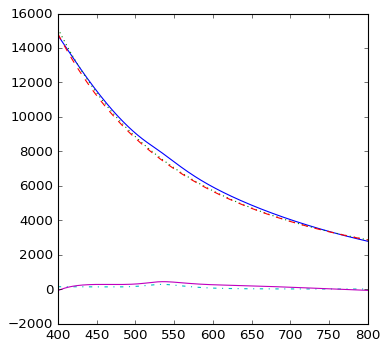

    536.48 ,	 [536.0, 432.84, 120.0, 1.58] 	 (-2.40, 7523.705)	 2.922 	 (-2.38, 7450.95) 	 0.339
	* Warning *: large scattering cross section:  [ 532.      509.0934  125.        1.5821]


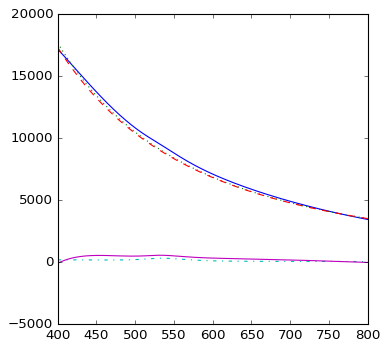

    532.25 ,	 [532.0, 509.09, 125.0, 1.58] 	 (-2.34, 8914.436)	 3.416 	 (-2.32, 8828.83) 	 0.351
	* Warning *: large scattering cross section:  [ 531.      529.2553  126.        1.5821]


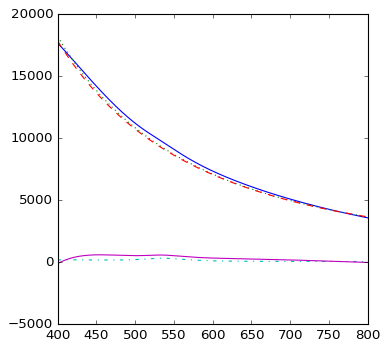

    530.99 ,	 [531.0, 529.26, 126.0, 1.58] 	 (-2.33, 9214.732)	 3.546 	 (-2.31, 9125.76) 	 0.354
	* Warning *: large scattering cross section:  [ 530.      575.4902  127.        1.5821]


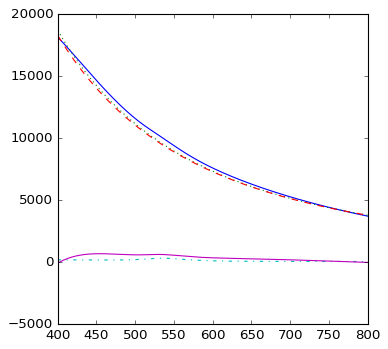

    529.11 ,	 [530.0, 575.49, 127.0, 1.58] 	 (-2.32, 9502.876)	 3.850 	 (-2.29, 9406.21) 	 0.359
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 1623.2323]) 140.0 1.5821058963738435]


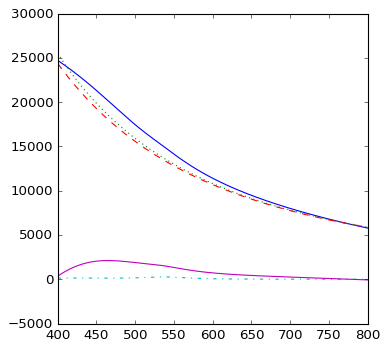

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 3149.2067]) 150.0 1.5821058963738435]


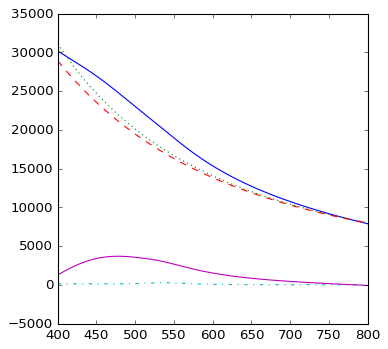

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 5591.8023]) 164.0 1.5821058963738435]


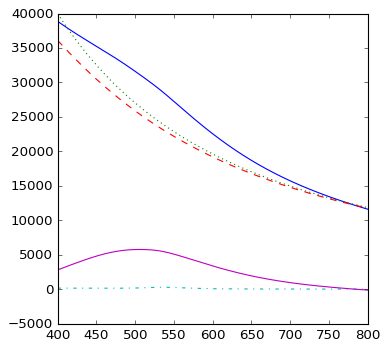

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 5749.3243]) 165.0 1.5821058963738435]


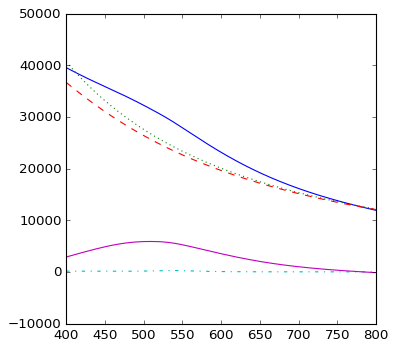

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 5902.7714]) 166.0 1.5821058963738435]


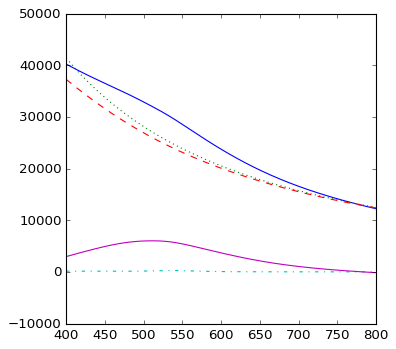

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 520.]) array([ 6499.2353]) 170.0 1.5821058963738435]


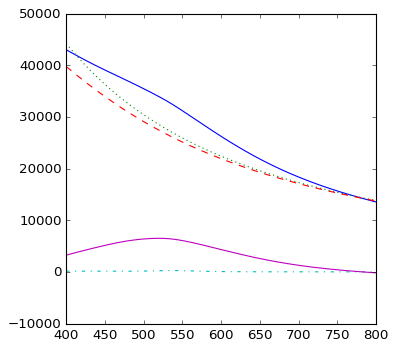

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 7528.0049]) 180.0 1.5821058963738435]


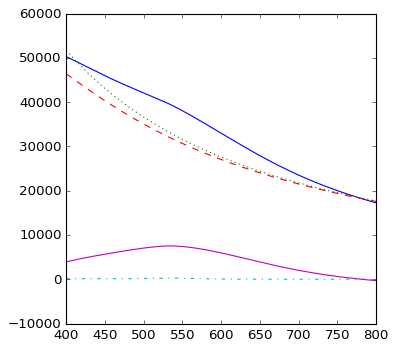

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 8235.8949]) 200.0 1.5821058963738435]


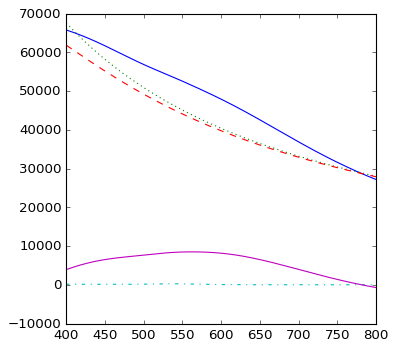

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 529.]) array([ 8478.1315]) 210.0 1.5821058963738435]


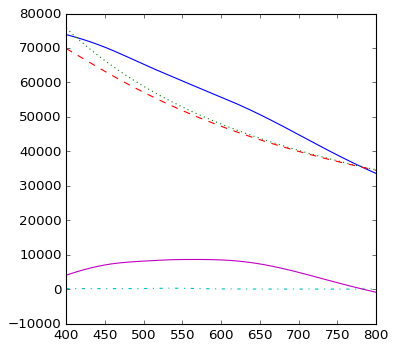

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 534.]) array([ 8659.4495]) 217.0 1.5821058963738435]


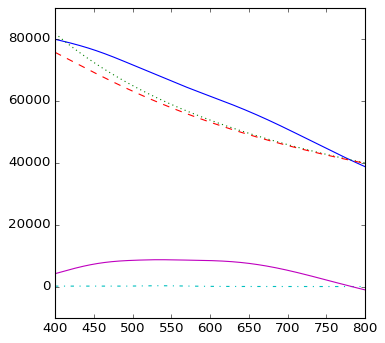

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 532.]) array([ 8684.3018]) 218.0 1.5821058963738435]


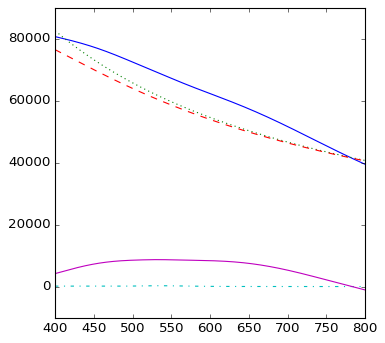

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 8712.0498]) 219.0 1.5821058963738435]


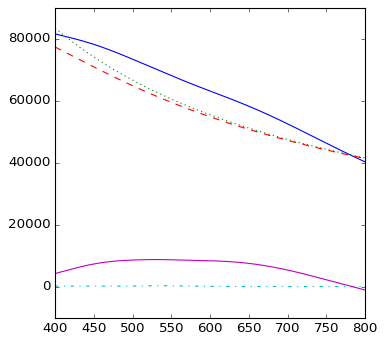

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 9144.5213]) 230.0 1.5821058963738435]


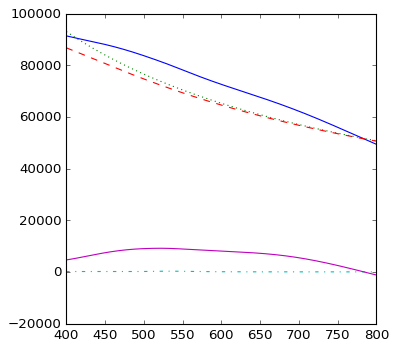

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 537.]) array([ 9706.7097]) 260.0 1.5821058963738435]


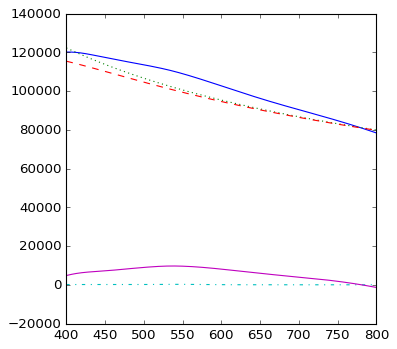

    534.83 ,	 [535.0, 284.38, 11.0, 1.59] 	 (-4.98, 36.090)	 1.917 	 (0.00, 1.00) 	 1.250
    534.83 ,	 [535.0, 284.38, 14.0, 1.59] 	 (-4.98, 36.137)	 1.917 	 (0.00, 1.00) 	 1.249
    534.83 ,	 [535.0, 284.38, 15.0, 1.59] 	 (-4.98, 36.168)	 1.917 	 (0.00, 1.00) 	 1.248
    534.83 ,	 [535.0, 284.37, 16.0, 1.59] 	 (-4.97, 36.212)	 1.917 	 (0.00, 1.00) 	 1.247
    534.83 ,	 [535.0, 284.37, 17.0, 1.59] 	 (-4.97, 36.272)	 1.917 	 (0.00, 1.00) 	 1.246
    534.83 ,	 [535.0, 284.26, 20.0, 1.59] 	 (-4.97, 36.675)	 1.916 	 (0.00, 1.00) 	 1.239
    534.83 ,	 [535.0, 284.25, 21.0, 1.59] 	 (-4.96, 36.850)	 1.916 	 (0.00, 1.00) 	 1.235
    534.83 ,	 [535.0, 284.24, 22.0, 1.59] 	 (-4.96, 37.070)	 1.916 	 (0.00, 1.00) 	 1.230
    534.83 ,	 [535.0, 284.22, 23.0, 1.59] 	 (-4.95, 37.346)	 1.916 	 (0.00, 1.00) 	 1.224
    534.83 ,	 [535.0, 284.21, 24.0, 1.59] 	 (-4.94, 37.687)	 1.916 	 (0.00, 1.00) 	 1.217
    534.84 ,	 [535.0, 284.16, 26.0, 1.59] 	 (-4.92, 38.613)	 1.916 	 (0.00, 1.00) 	 1.198
    534.84

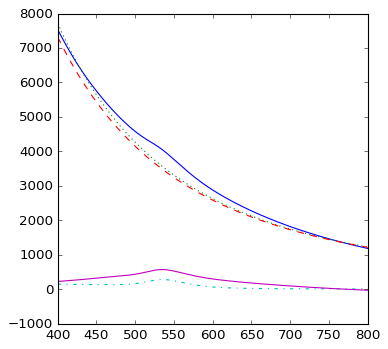

    534.7 ,	 [535.0, 567.73, 100.0, 1.59] 	 (-2.66, 3562.221)	 3.827 	 (-2.60, 3468.98) 	 0.341
	* Warning *: large scattering cross section:  [ 537.      523.6707  110.        1.5921]


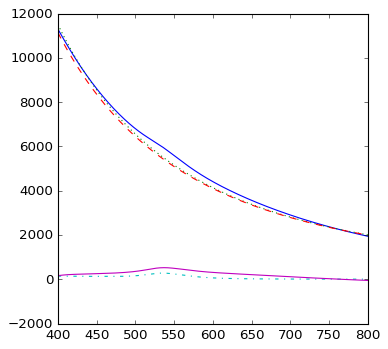

    537.38 ,	 [537.0, 523.67, 110.0, 1.59] 	 (-2.52, 5529.250)	 3.540 	 (-2.49, 5441.99) 	 0.333
	* Warning *: large scattering cross section:  [ 537.      465.8855  120.        1.5921]


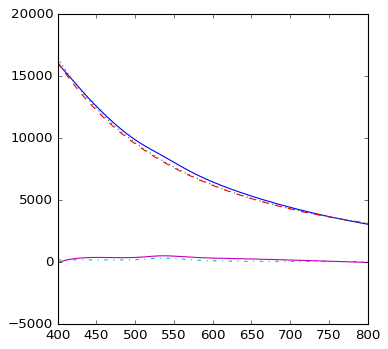

    536.78 ,	 [537.0, 465.89, 120.0, 1.59] 	 (-2.41, 8144.171)	 3.150 	 (-2.39, 8065.85) 	 0.336
	* Warning *: large scattering cross section:  [ 532.      542.4083  125.        1.5921]


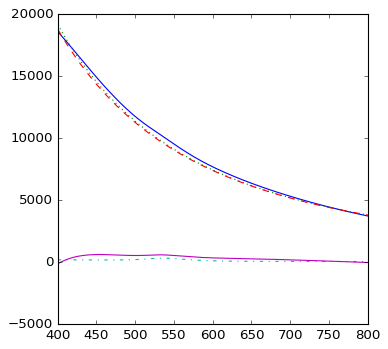

    531.75 ,	 [532.0, 542.41, 125.0, 1.59] 	 (-2.35, 9664.854)	 3.640 	 (-2.32, 9573.70) 	 0.351
	* Warning *: large scattering cross section:  [ 530.      590.7343  126.        1.5921]


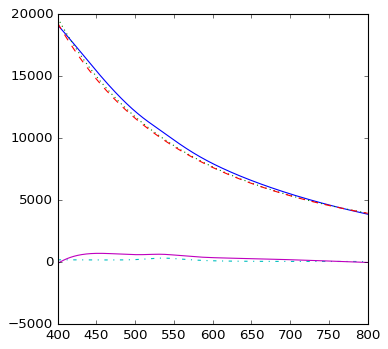

    529.71 ,	 [530.0, 590.73, 126.0, 1.59] 	 (-2.33, 9970.622)	 3.951 	 (-2.31, 9871.44) 	 0.356
	* Warning *: large scattering cross section:  [ 528.      625.0391  127.        1.5921]


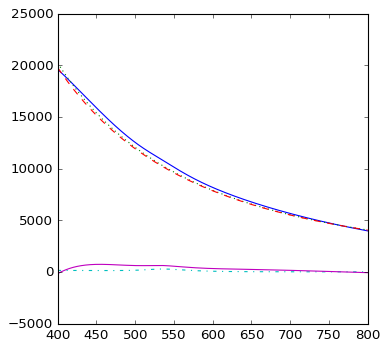

    527.58 ,	 [528.0, 625.04, 127.0, 1.59] 	 (-2.32, 10298.990)	 4.167 	 (-2.29, 10194.16) 	 0.361
	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 1870.2539]) 140.0 1.5921058963738435]


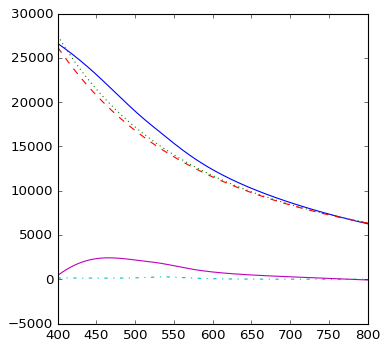

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 3595.4732]) 150.0 1.5921058963738435]


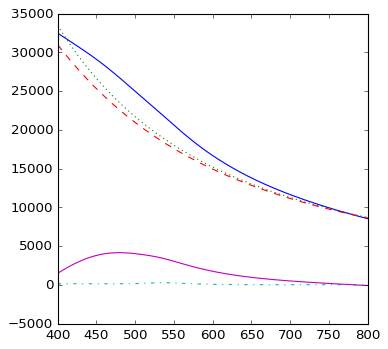

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 6210.3559]) 164.0 1.5921058963738435]


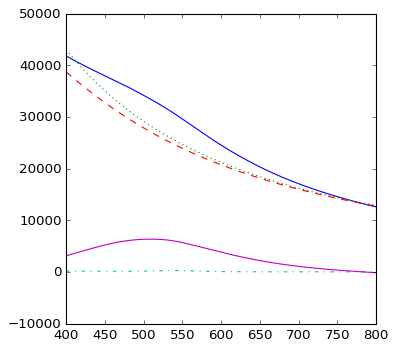

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 6373.3069]) 165.0 1.5921058963738435]


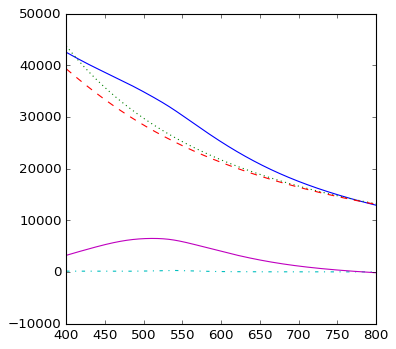

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 6531.2635]) 166.0 1.5921058963738435]


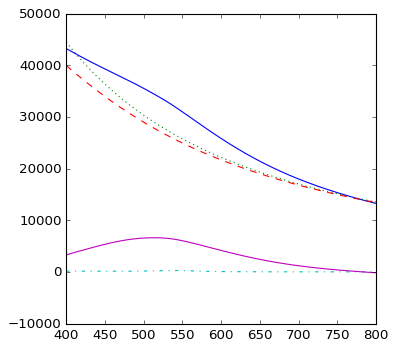

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 522.]) array([ 7114.2615]) 170.0 1.5921058963738435]


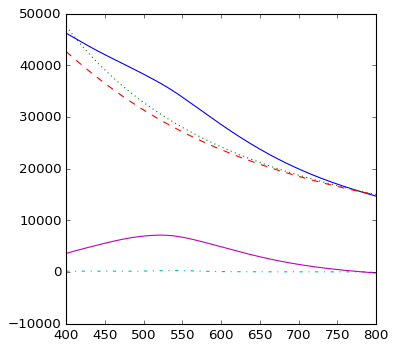

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 536.]) array([ 8171.7652]) 180.0 1.5921058963738435]


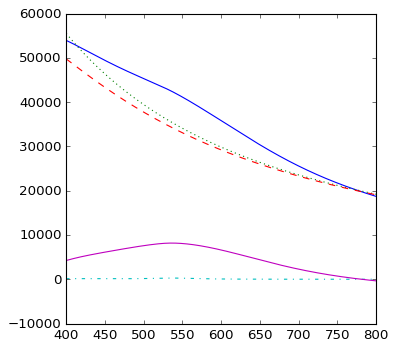

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 8884.9508]) 200.0 1.5921058963738435]


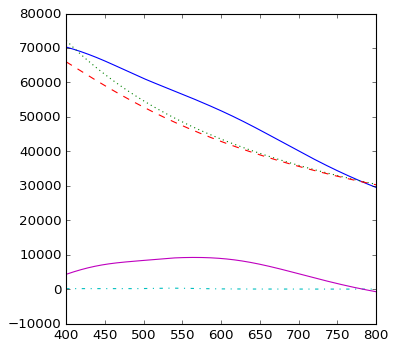

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 9106.9915]) 210.0 1.5921058963738435]


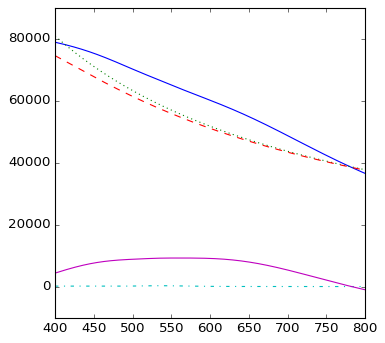

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 530.]) array([ 9424.7851]) 217.0 1.5921058963738435]


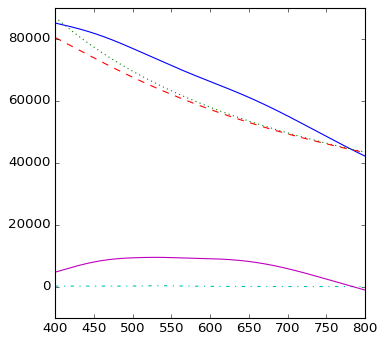

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 528.]) array([ 9461.2118]) 218.0 1.5921058963738435]


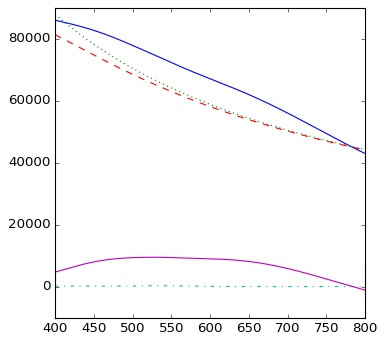

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 526.]) array([ 9499.7744]) 219.0 1.5921058963738435]


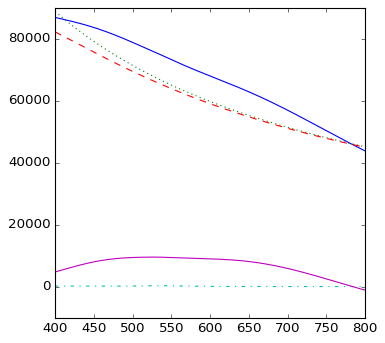

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 521.]) array([ 9902.1006]) 230.0 1.5921058963738435]


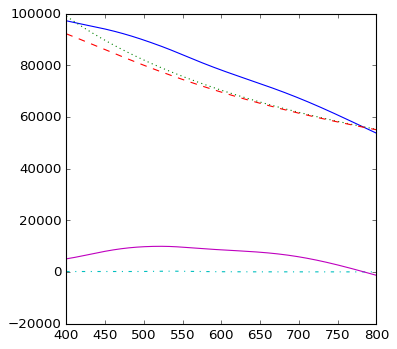

	* Error *: large difference between bare-core and subtracted core-shell models:  [array([ 539.]) array([ 10649.569]) 260.0 1.5921058963738435]


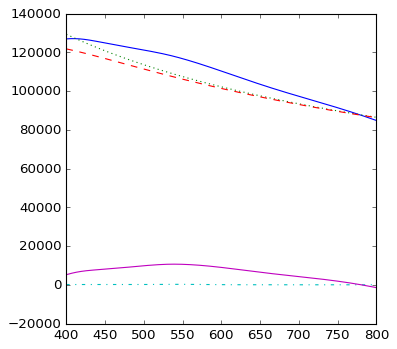

variable: 	 lsprAdjMiePowrPeakWLnmArray
  * output array format: 
    [ peak-wl-nm, gamma, rShell-nm, nShell ]
variable: 	 lsprAdjMiePowrBaselineList
  * output array format: 
    [ wl-nm-data, ext-orig-data, ext-scaling-factor, ext-corrected-data, baseline-correction-no-core-data, baseline-correction-data]
  * wavelength range: [ 400.0 , 800.0 ] x ( 401 values)
variable: 	 lsprAdjMiePowrBaselinenkList
  * output array format: 
    [ x0, n0, k0 ]


In [195]:
threshold = .25
wlExpectednm = 535
dwlExpectednm = 20
wlScatnm = 400
x0base = wlExpectednm
nPeaks = 1
wlMin0nm, wlMax0nm = 400, 800
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm


%config InlineBackend.figure_format = 'png'
%config InlineBackend.rc = {'figure.figsize': (3.5, 3.5)}

print('LSPR peak wavelengths')
print('=====================')
print('Core-shell nanoparticles')
print('  * power law baseline fit')
print('    - of the form ybase = k*(x/x0)^n')
print('    - using log-log/linear fitting with x0 =',x0base)
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('    - baseline correction range [', wlMin0nm, ',', wlMax0nm, '] nm')
print('Peaks detected: \n    wl-nm,\t [wl-nm, ext, rShell-nm, nShell]',
     '\t (n0, k0)', '\t scal.',  '\t (n, k)', '\t gamma')

lsprAdjMiePowrPeakWLnmList = []
lsprAdjMiePowrBaselineList = []
lsprAdjMiePowrBaselinenkList = []
x = []

gammaCoreRef = lsprMiePowrPeakWLnmCoreList[0][-1]

for nShell in nShellList:
    lsprPeakWLnmSubList = []
    for rShellnm in rShellListnm:
        xPeakPrev = wlExpectednm
        if len(lsprPeakWLnmSubList) > 0: xPeakPrev = lsprPeakWLnmSubList[-1][0]
        subdataArray = mieAdjCextCoreShellArray
        selection = (
            (subdataArray[:,0] >= wlMin0nm) 
            & (subdataArray[:,0] <= wlMax0nm) 
            & (subdataArray[:,1] == nShell)
            & (subdataArray[:,2] == rShellnm)
        )
        subdataArray = subdataArray[selection]
        sort = np.argsort(subdataArray[:,0])
        subdataArray = subdataArray[sort]
        minDist = int(subdataArray[:,0].size/(nPeaks+1))

        x, y = subdataArray[:,0], subdataArray[:,-1]
        yCore = subdataArray[:,-2]
        yOrig = y

        logx, logy = np.log(x/x0base), np.log(y)
        dlogx = min(np.abs(np.diff(logx)))
        loglogx = np.arange(min(logx), max(logx) + dlogx, dlogx)
        logy0base = 1.01*min(logy)
        loglogy = np.interp(loglogx, logx, logy - logy0base)

        loglogyLinBase = peakutils.baseline(loglogy, 1)
        logyLinBase = np.interp(logx, loglogx, loglogyLinBase) + logy0base
        loglogfit = np.polyfit(logx, logyLinBase, 1)
        basePowrn0, baseCoeffk0 = loglogfit[0], np.exp(loglogfit[1])

        yPowrBase = (np.exp(logyLinBase))
        y = y - yPowrBase
        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = anArray[selection][:,1].astype(int)
        # if no peaks:
        if (len(indexes) == 0): 
            selection = (x >= wlMinnm) & (x <= wlMaxnm)
            xzoom, yzoom = x[selection], y[selection]
            indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
            indexes = indexeszoom + int(wlMinnm - wlMin0nm)
            if (len(indexes) == 0): 
                indexes = np.argsort(np.abs(x - xPeakPrev))[[0]]
        xPeaks = x[indexes]

        selection = ( (x >= wlMin0nm)
                     & (x <= wlMax0nm)
                     )
        yCorePowrBase = np.asarray(lsprMiePowrBaselineCoreList[0][-1])[selection]
        yCorePeak = lsprMiePowrBaselineCoreList[0][2]
        scaling = 1*y[indexes][0]/yCorePeak
        y = y + yCorePowrBase*scaling

        # fit [(base) - (core base)] to power law
        yPowrBaseTotal = yPowrBase - yCorePowrBase*scaling
        logy = np.log(yPowrBaseTotal)
        if min(yPowrBaseTotal) > 0: 
            logy = np.log(yPowrBaseTotal)
            loglogfit = np.polyfit(logx, logy, 1)
        else: loglogfit = [0, 0]
        basePowrn, baseCoeffk = loglogfit[0], np.exp(loglogfit[1])

        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = anArray[selection][:,1].astype(int)
        # if no peaks:
        if (len(indexes) == 0): 
            selection = (x >= wlMinnm) & (x <= wlMaxnm)
            xzoom, yzoom = x[selection], y[selection]
            indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
            indexes = indexeszoom + int(wlMinnm - wlMin0nm)
            if (len(indexes) == 0): 
                indexes = np.argsort(np.abs(x - xPeakPrev))[[0]]
        xPeaks = x[indexes]

        # iterate 
        for i in range(3):
            oldScaling = scaling
            scaling = 1*(y[indexes[0]] - yCorePowrBase[indexes[0]]*scaling)/yCorePeak
            if ( abs(1-oldScaling/scaling) < 0.01 ): break

            y = yOrig - yPowrBase + yCorePowrBase*scaling
            indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
            xPeaks = x[indexes]
            anArray = (np.array([xPeaks, indexes])).T
            selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
            indexes = anArray[selection][:,1].astype(int)
            # if no peaks:
            if (len(indexes) == 0): 
                selection = (x >= wlMinnm) & (x <= wlMaxnm)
                xzoom, yzoom = x[selection], y[selection]
                indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
                indexes = indexeszoom + (wlMinnm - wlMin0nm)
            if (len(indexes) == 0): break

        yCoreMax = max(yCore)
        yMax = max(y)
        result = np.array([ x[indexes], y[indexes], rShellnm, nShell ])
        if ( (len(indexes) > 0) & (yMax/yCoreMax < 4) ): 
            result = np.array([ x[indexes[0]], y[indexes[0]], rShellnm, nShell ])
            
            # problems with large scattering cross sections
            if (baseCoeffk0 > 3e3): 
                print('\t* Warning *: large scattering cross section: ', result )
                pylab.cla()
                pylab.plot(x,yOrig,'-')
                pylab.plot(x,yPowrBase,':')
                pylab.plot(x,yPowrBase-yCorePowrBase*scaling,'--')
                pylab.plot(x, yCore, '-.')
                pylab.plot(x,y,'-')
                pylab.show()

            xPeaks = peakutils.interpolate(x, y, ind=indexes)
            xPeak = xPeaks[0]
            if ( (xPeak < wlMaxnm) & (xPeak > wlMinnm) ):
                select = (np.abs(x-xPeak) < 0.55)
                yPeak = yOrig[select][0]
                select = (np.abs(x-wlScatnm) < 0.55)
                yScat = yOrig[select][0]
                gamma = (yPeak/yScat)/gammaCoreRef

                print('   ', round(100*xPeak)/100,',\t',  
                      (np.round(100*result[:])/100).tolist(),
                      '\t ({0:.2f}, {1:.3f})\t {2:.3f}'.format(basePowrn0, baseCoeffk0, scaling),
                      '\t ({0:.2f}, {1:.2f})'.format(basePowrn, baseCoeffk),
                      '\t {0:.3f}'.format(gamma)
                     )

                result = [xPeak, gamma, rShellnm, nShell]
                lsprAdjMiePowrPeakWLnmList.append(result)
                lsprAdjMiePowrBaselineList.append([x, yOrig, scaling, y, yPowrBase, 
                                             yPowrBase-yCorePowrBase*scaling])
                lsprAdjMiePowrBaselinenkList.append([x0base, basePowrn0, baseCoeffk0])
                result = [xPeaks[0], result[-3], result[-2]]
                lsprPeakWLnmSubList.append(result)

        else: # if no peaks detected
            if (len(indexes) > 0): 
                print('\t* Error *: large difference between bare-core and subtracted core-shell models: ', result )
            else: print('\t* Error *: no peaks detected in range: ', result )
            pylab.cla()
            pylab.plot(x,yOrig,'-')
            pylab.plot(x,yPowrBase,':')
            pylab.plot(x,yPowrBase-yCorePowrBase*scaling,'--')
            pylab.plot(x, yCore, '-.')
            pylab.plot(x,y,'-')
            pylab.show()


if len(lsprPeakWLnmSubList) == 0: lsprPeakWLnmSubList.append( [0,0,0] )
lsprPeakWLnmSubList = np.asarray(lsprPeakWLnmSubList)

lsprAdjMiePowrPeakWLnmArray = np.asarray(lsprAdjMiePowrPeakWLnmList)
print('variable: \t lsprAdjMiePowrPeakWLnmArray')
print("  * output array format: \n    [ peak-wl-nm, gamma, rShell-nm, nShell ]")
print('variable: \t lsprAdjMiePowrBaselineList')
print("  * output array format: \n",
      "   [ wl-nm-data, ext-orig-data, ext-scaling-factor, ext-corrected-data,",
      "baseline-correction-no-core-data, baseline-correction-data]")
print('  * wavelength range: [',x[0],',',x[-1],'] x (',len(x), 'values)')
print('variable: \t lsprAdjMiePowrBaselinenkList')
print("  * output array format: \n    [ x0, n0, k0 ]")

%config InlineBackend.figure_format = 'svg'
%config InlineBackend.rc = {'font.size': 12, 'figure.figsize': (5.0, 5.0), 'figure.facecolor': 'white', 'savefig.dpi': 72, 'figure.subplot.bottom': 0.125, 'figure.edgecolor': 'white'}


## Remove Mie resonances and extrapolate near-field refractive index

### Peak wavelength plot: Simple, unformatted

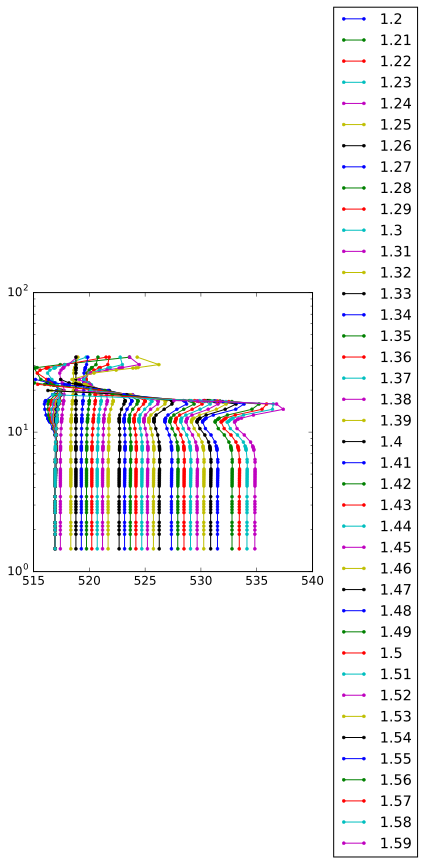

In [197]:
for nShell in nShellList:
        
    subdataArray = lsprAdjMiePowrPeakWLnmArray
    select = ( 
        (subdataArray[:,-1] == nShell) 
    )
    subdataArray = subdataArray[select]
    sort = np.argsort(subdataArray[:,2])
    subdataArray = subdataArray[sort]

    x, y = subdataArray[:,0], subdataArray[:,2]/rCorenm
    label = str(np.round(nShell,2))
    pylab.semilogy(x,y, '.-', label=label)


pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
pylab.show()

### Remove Mie shell resonances

In [199]:
anArray = lsprAdjMiePowrPeakWLnmArray
subanArray = []

print('Excluding range:')
print('\t nShell\t [rShell/rCore] \t [rShell*nShell/peak-wl]')

for nShell in nShellList:
    select = ( 
        (anArray[:,-1] == nShell) 
    )
    subArray = anArray[select]
    sort = np.argsort(subArray[:,2])
    subArray = subArray[sort]

    x = subArray[:,0]
    x0, y0 = subArray[:,[0,2]].T
    
    if (nShell > nShellList[0]):
        dx = (np.diff(x))
        DX = -.05
        while np.min(dx) <= DX:
            dx = np.concatenate((dx[[0]], dx))
            select = ( (x > 523) & (dx > DX) )
            subArray = subArray[select]
            x = subArray[:,0]
            dx = (np.diff(x))
                
        select = np.in1d(x0, x, invert=True) 
        notiny = np.sort(y0[select])
        if len(notiny) > 0: 
            y = np.log(subArray[:,2])
            dy = np.diff(y)
            i0 = (np.argsort(dy))[-1]
            y1, y2, y3, y4 = y[[(i0-1), i0, (i0 + 1), (i0+2)]]
            subArray = subArray[ ( (y < np.log(10*rCorenm)) 
                                  | ((y != y1) & (y != y2) & (y != y3) & (y != y4)) ) ]
            x = subArray[:,0]
            select = np.in1d(x0, x, invert=True) 
            notiny = np.sort(y0[select])[[0,-1]]
        
        xMean = np.mean(x)
        print('\t', nShell, '\t', notiny/rCorenm, '\t', notiny*nShell/xMean)
        
        subanArray = np.concatenate((subanArray,subArray))
        
    else: subanArray = subArray

lsprAdjMiePowrPeakWLnmSubArray = subanArray

print('')
print('* new variable: \"lsprAdjMiePowrPeakWLnmSubArray\"')
print('\t same format as \"lsprAdjMiePowrPeakWLnmArray\", but with Mie resonances removed.')

Excluding range:
	 nShell	 [rShell/rCore] 	 [rShell*nShell/peak-wl]


ValueError: zero-size array to reduction operation minimum which has no identity

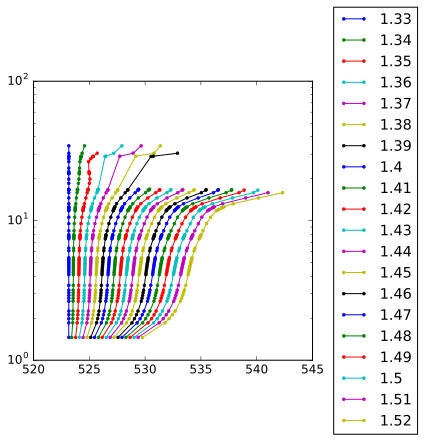

In [51]:
for nShell in nShellList:
        
    subdataArray = lsprMiePowrPeakWLnmSubArray
    select = ( 
        (subdataArray[:,-1] == nShell) 
    )
    subdataArray = subdataArray[select]
    sort = np.argsort(subdataArray[:,2])
    subdataArray = subdataArray[sort]

    x, y = subdataArray[:,0], subdataArray[:,2]/rCorenm
    label = str(np.round(nShell,2))
    pylab.semilogy(x,y, '.-', label=label)


pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
pylab.show()

### Interpolate refractive index of data

Interpolated near-field shell refractive index:



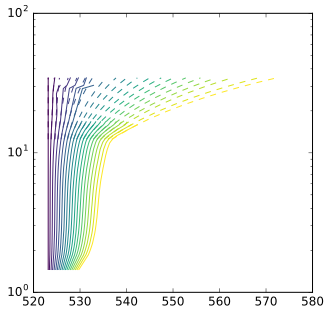

Sample	 Shell state	 [peak-wl-nm, rShell/rCore, nShell-Mie-fit]
L1 	 Collapsed 	 [ 524.962    2.09     1.372]
L1 	 Swollen 	 [ 523.751    2.858    1.344]
L2 	 Collapsed 	 [ 525.952    3.088    1.388]
L2 	 Swollen 	 [ 523.584    5.005    1.34 ]
L3 	 Collapsed 	 [ 527.046    4.539    1.406]
L3 	 Swollen 	 [ 524.609    7.599    1.358]
X1 	 Collapsed 	 [ 526.634    7.725    1.393]
X1 	 Swollen 	 [ 523.642   12.4      1.339]
X2 	 Collapsed 	 [ 528.15    11.936    1.405]
X2 	 Swollen 	 [ 525.446   21.82     1.354]
X3 	 Collapsed 	 [ 533.456   16.653    1.441]
X3 	 Swollen 	 [ 526.51    28.842    1.358]


In [88]:
print('Interpolated near-field shell refractive index:\n')

anArray = lsprMiePowrPeakWLnmSubArray
cutRatio0 = 12.5
cutRatio1 = 15.5

# first interpolate along contours of constant nShell
funcList = []
linearFuncList = []
for nShell in nShellList:
    select = ( 
        (anArray[:,-1] == nShell) 
    )
    subArray = anArray[select]
    sort = np.argsort(subArray[:,2])
    subArray = subArray[sort]

    x, y = subArray[:,[0,2]].T
    y = y/rCorenm
    func = interpolate.interp1d(y, x, 'cubic')
    funcList.append(func)
    
    color = cm.viridis( (nShell - min(nShellList))/(max(nShellList) - min(nShellList)) )
    pylab.semilogy(x, y, '-', color=color)
    
    select = ( y > cutRatio0 )
    x, y = x[select], y[select]
    #m, b = np.polyfit(np.log(y), x, 1)
    m, b = np.polyfit(y, x, 1)
    linearFuncList.append([m,b])
    
    y = np.linspace(cutRatio, max(anArray[:,2]/rCorenm), 10)
    #x = m*np.log(y) + b
    x = m*y + b
    pylab.semilogy(x, y, '--', color=color)

pylab.show()

print('Sample\t Shell state\t [peak-wl-nm, rShell/rCore, nShell-Mie-fit]')

lsprPowrRIList = []
for sampleNum in range(6):
    sampleID = ['L1', 'L2', 'L3', 'X1', 'X2', 'X3'][sampleNum]
    coreNum = 0
    if sampleNum > 2: coreNum = 1
    coreRnm = coreRnms[coreNum]
    
    for i in range(2):
        shellState = ['Collapsed', 'Swollen'][i]
        subdataArray = lsprPowrPeakWLnmArray
        select = (subdataArray[:,-1] == sampleNum)
        subdataArray = subdataArray[select]
        select = np.argsort(subdataArray[:,-2])[:2]
        if i > 0: select = np.argsort(subdataArray[:,-2])[-2:]
        subdataArray = subdataArray[select]
        x, y = subdataArray[:,0], subdataArray[:,-2]/coreRnm
        x, y = np.mean(x), np.mean(y)
        
        # interpolate along constant rCore/rShell
        xCalcList = []
        if (y < cutRatio1 ): 
            for func in funcList:
                xCalcList.append(func(y).tolist())
        else: 
            for mb in linearFuncList:
                m, b = mb
                #xCalcList.append(m*np.log(y) + b)
                xCalcList.append(m*y + b)
        
        func = interpolate.interp1d(xCalcList, nShellList)
        
        z = func(x)
        result = [x, y, z]
        print(sampleID, '\t', shellState, '\t', np.array(result))
        lsprPowrRIList.append(result)

lsprPowrRIArray = np.array(lsprPowrRIList)


## Plots

### Formatted

Exported to:
 graphics/20170304_mie_Ro-ratio-vs-lspr.svg


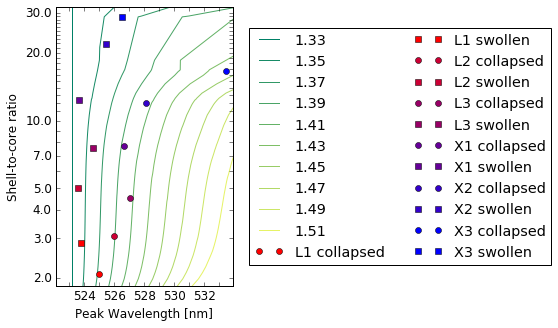

In [99]:
pylab.cla()

for nShell in nShellList[0:-1:2]:

    subdataArray = lsprMiePowrPeakWLnmSubArray
    select = ( 
        (subdataArray[:,-1] == nShell) 
    )
    subdataArray = subdataArray[select]
    sort = np.argsort(subdataArray[:,2])
    subdataArray = subdataArray[sort]

    x, y = subdataArray[:,0], subdataArray[:,2]/rCorenm
    
    if (nShell > nShellList[0]):
        dx = np.diff(x)
        DX = 0
        while np.min(dx) <= DX:
            dx = np.concatenate((dx[[0]],dx))
            select = ( (x > 523) & (dx > DX) )
            x, y = x[select], y[select]
            dx = np.diff(x)

    label = str(np.round(nShell,2)) 
    colorFactor = (nShell-nShellList[0])/(nShellList[-1]-nShellList[0])
    color = cm.summer( 0.95*colorFactor )
    marker = '-'

    pylab.plot(x,np.log(y), marker, label=label, color=color)

for sampleNum in range(6):
    coreNum = 0
    if sampleNum > 2: coreNum = 1
    coreRnm = coreRnms[coreNum]
    
    for i in range(2):
        subdataArray = lsprPowrPeakWLnmArray
        select = (subdataArray[:,-1] == sampleNum)
        subdataArray = subdataArray[select]
        select = np.argsort(subdataArray[:,-2])[:2]
        if i > 0: select = np.argsort(subdataArray[:,-2])[-2:]
        subdataArray = subdataArray[select]
        x, y = subdataArray[:,0], subdataArray[:,-2]/coreRnm
        x, y = [np.mean(x)], [np.mean(y)]
        
        label = ['L1', 'L2', 'L3', 'X1', 'X2', 'X3'][sampleNum] + [' collapsed', ' swollen'][i]
        color = (['#ff0000','#cc0035','#990066','#660099','#3300cc','#0000ff'][sampleNum])
        marker = ['o','s'][i]

        pylab.plot(x,np.log(y), marker, label=label, color=color)

pylab.xlabel('Peak Wavelength [nm]')
pylab.ylabel('Shell-to-core ratio')
xlim = [522.1, 533.9]
pylab.xlim(xlim)
ylim = np.log(np.array([1.85,32.0]))
pylab.ylim(ylim)
xticks = np.arange(523, 534, 1)
xticklabels = []
for xtick in xticks: 
    if (np.mod(xtick,2) == 0): xticklabels.append(str(xtick))
    else: xticklabels.append('')
pylab.xticks(xticks, xticklabels)
yticks = np.arange(2, 30.5, 1)
yticklabels = []
for ytick in yticks: 
    if (ytick < 6) | (ytick == 7) | (np.mod(ytick,10) == 0): yticklabels.append(str(ytick))
    else: yticklabels.append('')
pylab.yticks(np.log(yticks), yticklabels)
pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=2)
aspect_ratio = 1.997/3.151
aspect = ( (xlim[1]-xlim[0])/(ylim[1]-ylim[0]) )/aspect_ratio
pylab.axes().set_aspect(aspect, adjustable='box')

## Save and display
timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.svg'
filename = ("graphics/" + timestamp 
            + "_mie_Ro-ratio-vs-lspr" 
            + exportFormat
            )
pylab.savefig(filename); print("Exported to:\n", filename)

pylab.show()

### Interpolated refractive index

In [208]:
anArray = lsprMiePowrPeakWLnmArray
subanArray = []

for nShell in nShellList:
    select = ( 
        (anArray[:,-1] == nShell) 
    )
    subArray = anArray[select]
    sort = np.argsort(subArray[:,2])
    subArray = subArray[sort]

    x = subArray[:,0]
    
    if (nShell > nShellList[0]):
        dx = np.diff(x)
        DX = 0
        while np.min(dx) <= DX:
            dx = np.concatenate((dx[[0]],dx))
            select = ( (x > 523) & (dx > DX) )
            subArray = subArray[select]
            x = subArray[:,0]
            dx = np.diff(x)
        subanArray = np.concatenate((subanArray,subArray))
    else: subanArray = subArray

x, y, z = subanArray[:,0], subanArray[:,2]/rCorenm, subanArray[:,3] # wl, Ro-ratio, nShell

nShellF = interpolate.interp2d(x, y, z, kind='linear')

nShellFuncList = []
for sampleNum in range(6):
    coreNum = 0
    if sampleNum > 2: coreNum = 1
    coreRnm = coreRnms[coreNum]
    
    for i in range(2):
        subdataArray = lsprPowrPeakWLnmArray
        select = (subdataArray[:,-1] == sampleNum)
        subdataArray = subdataArray[select]
        select = np.argsort(subdataArray[:,-2])[:2]
        if i > 0: select = np.argsort(subdataArray[:,-2])[-2:]
        subdataArray = subdataArray[select]
        x, y = subdataArray[:,0], subdataArray[:,-2]/coreRnm
        x, y = np.mean(x), np.mean(y)
        z = nShellF(x, y)[0]
        print([sampleNum, x, y, z])
        if z > nShellList[0]: nShellFuncList.append([x, y, z])
nShellFuncArray = np.array(nShellFuncList)


[0, 524.96186934697448, 2.0901960784313722, 1.3720018824356441]
[0, 523.75081509009078, 2.8581699346405234, 1.3441831538420619]
[1, 525.9517161434585, 3.087581699346404, 1.3880637603765071]
[1, 523.58413844298605, 5.0052287581699328, 1.3402424296652751]
[2, 527.04641646584355, 4.5385620915032678, 1.4060713586188751]
[2, 524.60920415699582, 7.5986928104575178, 1.3578125312109406]
[3, 526.63448799047671, 7.7252955952244093, 1.3927713184951529]
[3, 523.64168005692648, 12.399615627339923, 1.3385718074845769]
[4, 528.14997778975362, 11.935621826956559, 1.4046953113868557]
[4, 525.44586722019528, 21.819807598937377, 1.36796844793418]
[5, 533.45566554353945, 16.653316981136818, 1.4419166757576716]
[5, 526.51013616745865, 28.842140354583464, 0.87973575897401668]


C:\Users\fit\Anaconda3\lib\site-packages\scipy\interpolate\fitpack.py:975: RuntimeWarning: No more knots can be added because the number of B-spline
coefficients already exceeds the number of data points m.
Probable causes: either s or m too small. (fp>s)
	kx,ky=1,1 nx,ny=28,30 m=721 fp=0.000004 s=0.000000
  warnings.warn(RuntimeWarning(_iermess2[ierm][0] + _mess))


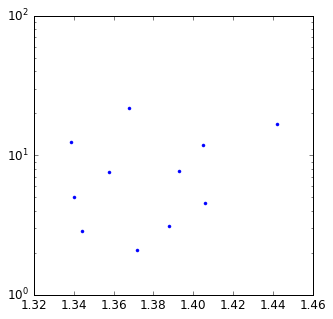

In [209]:
pylab.semilogy(nShellFuncArray[:,-1], nShellFuncArray[:,1], '.')
pylab.show()

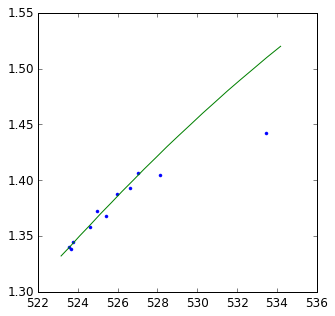

In [210]:
pylab.plot(nShellFuncArray[:,0], nShellFuncArray[:,-1], '.')
pylab.plot(lsprMieCorePeakWLnmArray[:,0], lsprMieCorePeakWLnmArray[:,-1], '-')
pylab.show()

## Peak vs LSPR wavelength plot

### Simple, unformatted

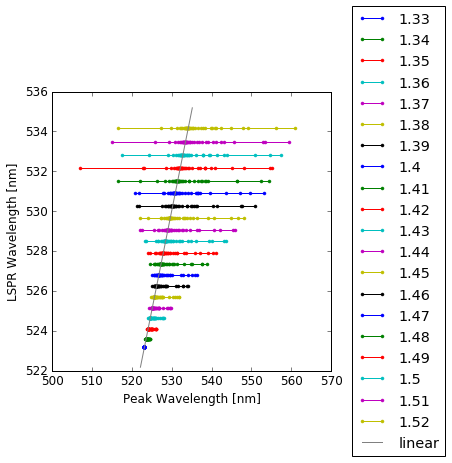

In [172]:
for nShell in nShellList:

    subdataArray = lsprMiePowrPeakWLnmArray
    select = ( 
        (subdataArray[:,-1] == nShell) 
    )
    subdataArray = subdataArray[select]
    sort = np.argsort(subdataArray[:,2])
    subdataArray = subdataArray[sort]

    x = subdataArray[:,0]

    subdataArray = lsprMieCorePeakWLnmArray
    select = ( 
        (subdataArray[:,-1] == nShell) 
    )
    subdataArray = subdataArray[select]
    sort = np.argsort(subdataArray[:,2])
    subdataArray = subdataArray[sort]

    y0 = subdataArray[0,0]
    y = np.ones_like(x)*y0

    label = str(np.round(nShell,2))
    pylab.plot(x,y, '.-', label=label)


x = np.unique(lsprMieCorePeakWLnmArray[:,0])
x = np.linspace(x[0]-1,x[-1]+1,5)
pylab.plot(x, x, '-', label='linear', color='gray')

pylab.xlabel('Peak Wavelength [nm]')
pylab.ylabel('LSPR Wavelength [nm]')

pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
pylab.show()

### Formatted, vs wavelength

Exported to:
 graphics/20170303_mie_Ro-ratio-vs-lspr_with-core-lspr.svg


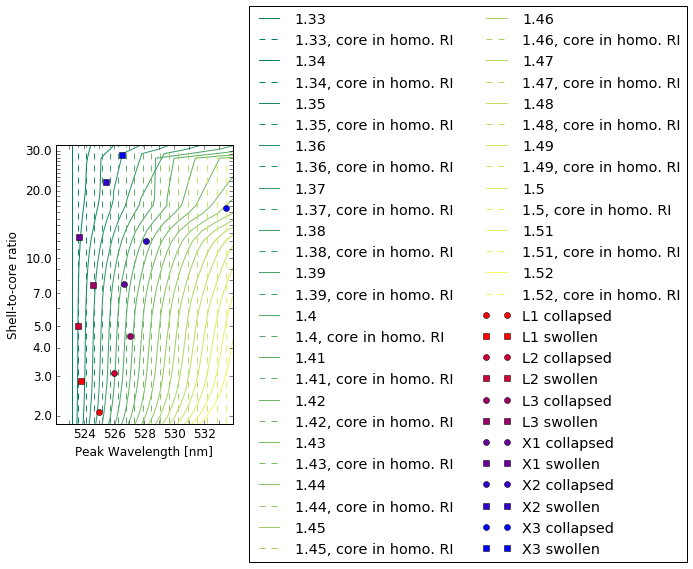

In [173]:
pylab.cla()

for nShell in nShellList:
    subdataArray = lsprMiePowrPeakWLnmArray
    select = ( 
        (subdataArray[:,-1] == nShell) 
    )
    subdataArray = subdataArray[select]
    sort = np.argsort(subdataArray[:,2])
    subdataArray = subdataArray[sort]

    x, y = subdataArray[:,0], subdataArray[:,2]/rCorenm
    
    if (nShell > nShellList[0]):
        dx = np.diff(x)
        while np.min(dx) <= 0.0:
            dx = np.concatenate((dx[[0]],dx))
            select = ( (x > 523) & (dx > 0.0) )
            x, y = x[select], y[select]
            dx = np.diff(x)

    label = str(np.round(nShell,2)) 
    colorFactor = (nShell-nShellList[0])/(nShellList[-1]-nShellList[0])
    color = cm.summer( 0.95*colorFactor )
    marker = '-'

    pylab.plot(x,np.log(y), marker, label=label, color=color)
    
    subdataArray = lsprMieCorePeakWLnmArray
    select = ( 
        (subdataArray[:,-1] == nShell) 
    )
    subdataArray = subdataArray[select]
    x = np.ones_like(x)*subdataArray[0,0]
    marker = '--'
    label = str(np.round(nShell,2)) + ', core in homo. RI'

    pylab.plot(x,np.log(y), marker, label=label, color=color)
    

for sampleNum in range(6):
    coreNum = 0
    if sampleNum > 2: coreNum = 1
    coreRnm = coreRnms[coreNum]
    
    for i in range(2):
        subdataArray = lsprPowrPeakWLnmArray
        select = (subdataArray[:,-1] == sampleNum)
        subdataArray = subdataArray[select]
        select = np.argsort(subdataArray[:,-2])[:2]
        if i > 0: select = np.argsort(subdataArray[:,-2])[-2:]
        subdataArray = subdataArray[select]
        x, y = subdataArray[:,0], subdataArray[:,-2]/coreRnm
        x, y = [np.mean(x)], [np.mean(y)]
        
        label = ['L1', 'L2', 'L3', 'X1', 'X2', 'X3'][sampleNum] + [' collapsed', ' swollen'][i]
        color = (['#ff0000','#cc0035','#990066','#660099','#3300cc','#0000ff'][sampleNum])
        marker = ['o','s'][i]

        pylab.plot(x,np.log(y), marker, label=label, color=color)


pylab.xlabel('Peak Wavelength [nm]')
pylab.ylabel('Shell-to-core ratio')
xlim = [522.1, 533.9]
pylab.xlim(xlim)
ylim = np.log(np.array([1.85,32.0]))
pylab.ylim(ylim)
xticks = np.arange(523, 534, 1)
xticklabels = []
for xtick in xticks: 
    if (np.mod(xtick,2) == 0): xticklabels.append(str(xtick))
    else: xticklabels.append('')
pylab.xticks(xticks, xticklabels)
yticks = np.arange(2, 30.5, 1)
yticklabels = []
for ytick in yticks: 
    if (ytick < 6) | (ytick == 7) | (np.mod(ytick,10) == 0): yticklabels.append(str(ytick))
    else: yticklabels.append('')
pylab.yticks(np.log(yticks), yticklabels)
pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=2)
aspect_ratio = 1.997/3.151
aspect = ( (xlim[1]-xlim[0])/(ylim[1]-ylim[0]) )/aspect_ratio
pylab.axes().set_aspect(aspect, adjustable='box')

## Save and display
timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.svg'
filename = ("graphics/" + timestamp 
            + "_mie_Ro-ratio-vs-lspr_with-core-lspr" 
            + exportFormat
            )
pylab.savefig(filename); print("Exported to:\n", filename)

pylab.show()